<img src="https://logos-download.com/wp-content/uploads/2016/11/NHS_logo_logotype.png" alt="NHS logo" width="200"/>

# National Health Service (NHS) Integrated Care Boards (ICB) Diagnostic Analysis using Python

# Table of Contents

1. [Introduction](#Introduction)
2. [Key information from the metadata](#Key-information_from_the_metadata)
3. [Setting up the Notebook workflow](#Setting-up-the-Notebook-workflow)
    1. [Imports](#Imports)
    2. [Configuration settings and constants](#Configuration-settings-and-constants)
    3. [Functions to load and save data](#Functions-to-load-and-save-data)
4. [Sense Checking Raw Data](#Sense-Checking-Raw-Data)
    1. [Sense checking - results](#Sense-checking-results)
4. [Data Cleaning](#Data-Cleaning)
5. [Exploratory Data Analysis (EDA), Statistics, data normalisation and standardisation](#Exploratory-Data-Analysis-(EDA)-Statistics-data-normalisation-and-standardisation)
6. [Data Visualizations](#Data-Visualisations)
    1. [Exploratory Data Visualization](#Exploratory-Data-Visualization)
7. [Answering business questions](#Answering-business-questions)
    1. [Question 1: What is the number of locations, service settings, context types, national categories, and appointment statuses in the data sets?](#Question-1)
    2. [Question 2: What is the date range of the provided data sets, and which service settings reported the most appointments for a specific period?](#Question-2)
    3. [Question 3: What is the number of appointments and records per month?](#Question-3)
    4. [Question 4: What monthly and seasonal trends are evident, based on the number of appointments for service settings, context types, and national categories?](#Question-4)
    5. [Question 5: What are the top trending hashtags (#) on the supplied Twitter data set and how can this be used in the decision-making process?](#Question-5)
    6. [Question 6: Was there adequate staff and capacity in the networks?](#Question-6)
    7. [Question 7: What was the actual utilisation of resources?](#Question-7)
    8. [Question 8: What insights can be gained by looking at missed appointments?](#Question-8)
    9. [Question 9: What other patterns are visible in the data relating to the use case?](#Question-9)
8. [Geographical Analysis](#Geographical-Analysis)
    1. [Regional Analysis](#Regional-Analysis)
    2. [Regional Predictive Analysis](#Regional-Predictive-Analysis)
    1. [Geographical analysis of the 42 ICBs](#Geographical-analysis-of-the-42-ICBs)
8. [COVID-19 Insights](#COVID-19-Insights)
9. [Weather analysis](#Weather-analysis)
8. [Recommendations](#Recommendations)
7. [Version log](#Version-log)
9. [Conclusion](#Conclusion)
10. [References](#References)

<a id="Introduction"></a>
# Introduction

This notebook is designed to address critical business problems faced by NHS Integrated Care Boards (ICBs). The following sections outline the business problems and key questions that this analysis aims to answer. A brief overview of the provided datasets is also included. Subsequently, the notebook conducts a comprehensive analysis of the data to provide actionable insights and solutions.

<a id="Key-information_from_the_metadata"></a>
### Key information from the metadata:

#### Overall information
- sub_icb_location_code - This code uniquely identifies a Sub-Integrated Care Board (Sub-ICB) location. It is used to aggregate and analyze data at the Sub-ICB level. There are 106 sub-ICB locations
- sub_icb_location_name - This field provides the name of the Sub-ICB location. It is a human-readable name corresponding to the sub_icb_location_code.
- sub_icb_location_ons_code - The Office for National Statistics (ONS) code for the Sub-ICB location. This is a standardized code used across various datasets for consistent geographical referencing.
- icb_ons_code - The ONS code for the Integrated Care Board (ICB). This code uniquely identifies an ICB, which is a higher-level aggregation compared to Sub-ICB locations. There are 42 ICB locations
- region_ons_code - The ONS code for the NHS region. This is a broader geographical code that encompasses multiple ICBs. (It is important to note that the region ONS code doesn't cover the same geographic locations as the NHS Regions, therefore they were not relied upon in the analysis.)

- Hierarchical Relationship: region_ons_code > icb_ons_code > sub_icb_location_ons_code This represents a hierarchical structure from the broadest geographical unit (NHS region) to the most specific (Sub-ICB location).

#### actual_duration.csv
- Actual Duration: The length in minutes of the consultation that took place. This is recorded differently depending on the practice’s system supplier. Any appointments with a null duration or a duration of less than one minute or greater than 60 minutes have been grouped into an ‘Unknown / Data Quality Issue’ category.

#### appointments_regional.csv
- Appointment Status: Indicates whether the appointment is available, booked, attended, or cancelled. Some appointments remain in the 'Booked' status and are reported as 'Unknown'.
- Healthcare Professional Type (hcp_type): The only consistently collected type is 'GP', with others reported as 'Other Practice Staff'.
- Appointment Mode: The setting of the consultation (e.g., face-to-face, telephone). Some modes may not be accurately represented due to local practice settings.
- Time from Booking to Appointment: Factors affecting this include appointment availability, patient availability, and urgency.

#### national_categories.xlsx 
- Context Type: Describes whether an appointment is a direct patient care encounter or an activity part of patient care where the patient is not involved.
- National Categories: Within each context type, practices can choose predefined categories or a ‘Does Not Fit’ category.
- Service Setting: Describes the provision of care in which the appointment was delivered (e.g., General Practice, Primary Care Network, Extended Access Provision).

#### Calculation of total counts of appointments:
An example of this calculation for November 2019 is shown below:
Open, active practices in England – 6,837
Number of practices included in the data collection – 6,538
Percentage of practices included in the data collection – 95.6%
Registered patients at open, active practices – 60,198,781
Registered patients at practices included in the data collection – 58,042,831
Percentage of patients included in the data collection – 96.4%
Total number of appointments – 26,448,308
Calculation = total number of 
appointments divided by 
percentage of patients included
in the data collection          – 26,448,308 / 0.964
Calculation result – 27,430,707.18
Estimated England total count of appointments - 27,430,000


#### Summary for All CSV Files:
- Data Quality: Data collected from GP systems designed for everyday use, not for analysis, leading to variations in data quality.
- Data Coverage: The data is collected over a 30-month reporting period, aggregated to daily or monthly counts at the Sub-ICB Location level, including NHS Geographies.
- Important Notes: Variations in data collection and reporting practices affect the quality and consistency of the data across different practices and regions.

<a id="Setting-up-the-Notebook-workflow"></a>
# Setting up the Notebook workflow

<a id="Imports"></a>
## Imports

In [9]:
# Standard library imports:
import os
import sys
import logging
import subprocess
import warnings
import re

# Third-party library imports:
# Note you may need to install these prior to the import in the Anaconda prompt:
# pip install pandas numpy matplotlib seaborn ipython geopandas folium / 
# contextily requests pillow matplotlib-venn textblob 
# pip install spacy geopy
# python -m spacy download en_core_web_sm
from datetime import datetime
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib_venn import venn3
import seaborn as sns
from matplotlib.backends.backend_pdf import PdfPages
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error
from statsmodels.tsa.seasonal import STL
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
from scipy.stats import ttest_ind, f_oneway
from IPython.display import display, Markdown, HTML
import geopandas as gpd
import folium
import contextily as ctx
import requests
from PIL import Image
from io import BytesIO
from textblob import TextBlob
import spacy
from geopy.geocoders import Nominatim

# Local application/library-specific imports:

<a id="Configuration-settings-and-constants"></a>
## Configuration settings and constants

In [11]:
# To print your directory
current_directory = os.getcwd()
print("Current Directory:", current_directory)

Current Directory: C:\Users\beata\OneDrive\Beata\DA Career Accelerator\Assignment 2 -python\assignment_final


In [12]:
# Configuration settings and constants

# Suppress FutureWarning
warnings.filterwarnings("ignore")

# Suppress informational messages
logging.getLogger('matplotlib').setLevel(logging.WARNING)

# Insert your own directory where data files are stored. Use \\
# sign to separate in the path. 
DATA_PATH = (
    'OneDrive\\Beata\\DA Career Accelerator\\Assignment 2 -python\\assignment_final')  
# Directory path where output files will be saved
OUTPUT_PATH = DATA_PATH
# Ensure the directories exist
LOG_FILE = os.path.join(OUTPUT_PATH, 'analysis.log')  # Log file path

os.makedirs(DATA_PATH, exist_ok=True)
os.makedirs(OUTPUT_PATH, exist_ok=True)

# Set up logging
logging.basicConfig(level=logging.INFO,
                    format='%(asctime)s - %(levelname)s - %(message)s', handlers=[
    logging.FileHandler(LOG_FILE),
    logging.StreamHandler()
])

# Version information
__version__ = "1.0.0"

# Print version
print(f"Current version: {__version__}")

print("Configuration settings:")
print(f"DATA_PATH: {DATA_PATH}")
print(f"OUTPUT_PATH: {OUTPUT_PATH}")
print(f"Output path exists: {os.path.exists(OUTPUT_PATH)}")
print(f"Output path is writable: {os.access(OUTPUT_PATH, os.W_OK)}")
print(f"LOG_FILE: {LOG_FILE}")

Current version: 1.0.0
Configuration settings:
DATA_PATH: OneDrive\Beata\DA Career Accelerator\Assignment 2 -python\assignment_final
OUTPUT_PATH: OneDrive\Beata\DA Career Accelerator\Assignment 2 -python\assignment_final
Output path exists: True
Output path is writable: True
LOG_FILE: OneDrive\Beata\DA Career Accelerator\Assignment 2 -python\assignment_final\analysis.log


<a id="Functions-to-load-and-save-data"></a>
## Functions to load and save data

In [14]:
# Define a function to load data
def load_data(file_path, file_type='csv'):
    try:
        if file_type == 'csv':
            df = pd.read_csv(file_path)
        elif file_type == 'excel':
            df = pd.read_excel(file_path)
        logging.info(f"Data loaded successfully from {file_path}")
        return df
    except Exception as e:
        logging.error(f"Error loading data from {file_path}: {str(e)}")
        return None

# Function to save results
def save_results(df, file_path):
    if df is None:
        logging.error(f"Cannot save results to {file_path}: DataFrame is None")
        return
    try:
        logging.info(f'Saving results to {file_path}')
        df.to_csv(file_path, index=False)
        logging.info(f'Successfully saved results to {file_path}')
    except Exception as e:
        logging.error(f"Error saving file to {file_path}: {str(e)}")
        raise
        
# Optional, to save it to pickle for faster file handling
# def save_to_pickle(df, file_path):
    #logging.info(f'Saving DataFrame to {file_path}')
    #df.to_pickle(file_path)

# def load_from_pickle(file_path):
    #logging.info(f'Loading DataFrame from {file_path}')
    #return pd.read_pickle(file_path)

# Utility function to save plots
def save_plot(filename):
    plt.savefig(filename, bbox_inches='tight')
    print(f"Plot saved to {filename}")

<a id="Sense-Checking-Raw-Data"></a>
# Sense Checking Raw Data

2024-08-12 12:01:46,333 - INFO - Data loaded successfully from actual_duration.csv
2024-08-12 12:01:46,333 - INFO - Sense checking data for actual_duration.csv
2024-08-12 12:01:46,333 - INFO - 
actual_duration.csv - Data Info:

2024-08-12 12:01:46,412 - INFO - 
actual_duration.csv - Data Shape: (137793, 8)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 137793 entries, 0 to 137792
Data columns (total 8 columns):
 #   Column                     Non-Null Count   Dtype 
---  ------                     --------------   ----- 
 0   sub_icb_location_code      137793 non-null  object
 1   sub_icb_location_ons_code  137793 non-null  object
 2   sub_icb_location_name      137793 non-null  object
 3   icb_ons_code               137793 non-null  object
 4   region_ons_code            137793 non-null  object
 5   appointment_date           137793 non-null  object
 6   actual_duration            137793 non-null  object
 7   count_of_appointments      137793 non-null  int64 
dtypes: int64(1), object(7)
memory usage: 8.4+ MB


,sub_icb_location_code,sub_icb_location_ons_code,sub_icb_location_name,icb_ons_code,region_ons_code,appointment_date,actual_duration,count_of_appointments
0,00L,E38000130,NHS North East and North Cumbria ICB - 00L,E54000050,E40000012,01-Dec-21,31-60 Minutes,364
1,00L,E38000130,NHS North East and North Cumbria ICB - 00L,E54000050,E40000012,01-Dec-21,21-30 Minutes,619
2,00L,E38000130,NHS North East and North Cumbria ICB - 00L,E54000050,E40000012,01-Dec-21,6-10 Minutes,1698
3,00L,E38000130,NHS North East and North Cumbria ICB - 00L,E54000050,E40000012,01-Dec-21,Unknown / Data Quality,1277
4,00L,E38000130,NHS North East and North Cumbria ICB - 00L,E54000050,E40000012,01-Dec-21,16-20 Minutes,730


,sub_icb_location_code,sub_icb_location_ons_code,sub_icb_location_name,icb_ons_code,region_ons_code,appointment_date,actual_duration,count_of_appointments
137788,X2C4Y,E38000254,NHS West Yorkshire ICB - X2C4Y,E54000054,E40000012,30-Jun-22,31-60 Minutes,430
137789,X2C4Y,E38000254,NHS West Yorkshire ICB - X2C4Y,E54000054,E40000012,30-Jun-22,21-30 Minutes,751
137790,X2C4Y,E38000254,NHS West Yorkshire ICB - X2C4Y,E54000054,E40000012,30-Jun-22,16-20 Minutes,921
137791,X2C4Y,E38000254,NHS West Yorkshire ICB - X2C4Y,E54000054,E40000012,30-Jun-22,11-15 Minutes,1439
137792,X2C4Y,E38000254,NHS West Yorkshire ICB - X2C4Y,E54000054,E40000012,30-Jun-22,1-5 Minutes,1739


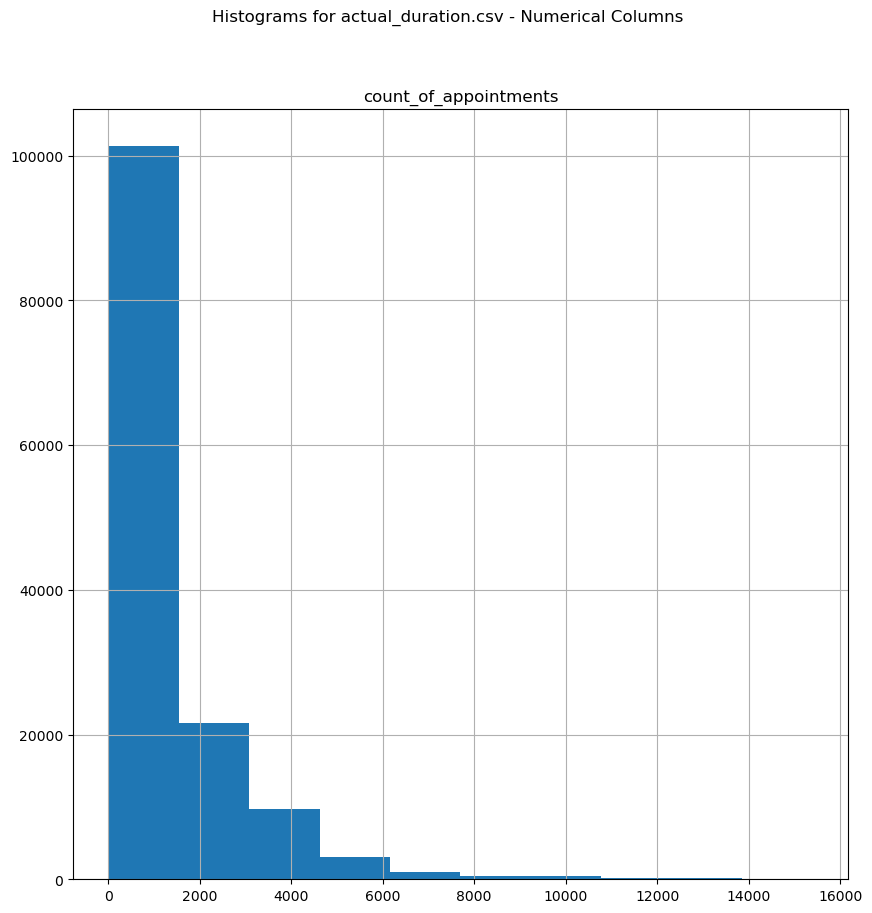

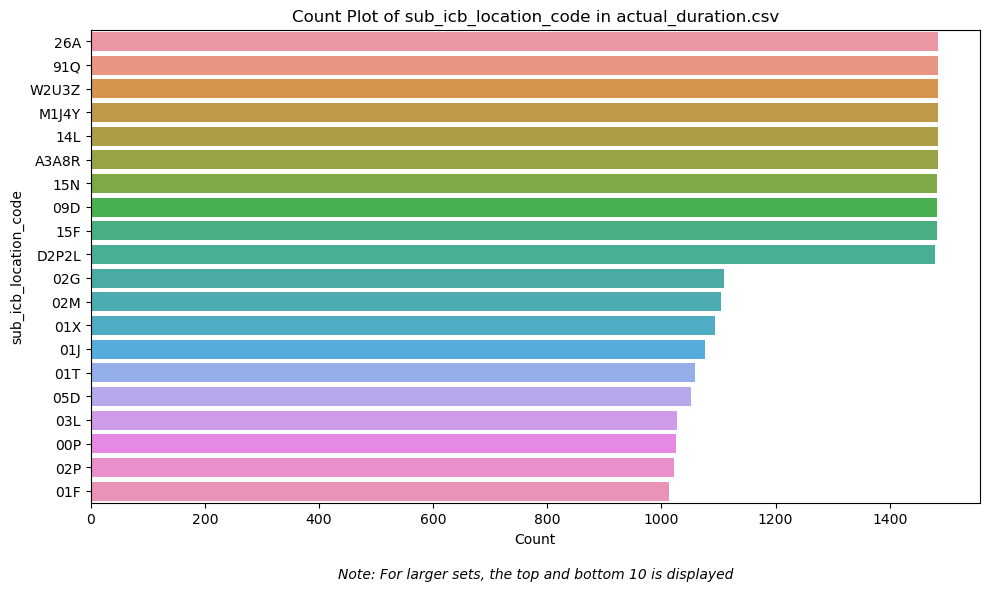

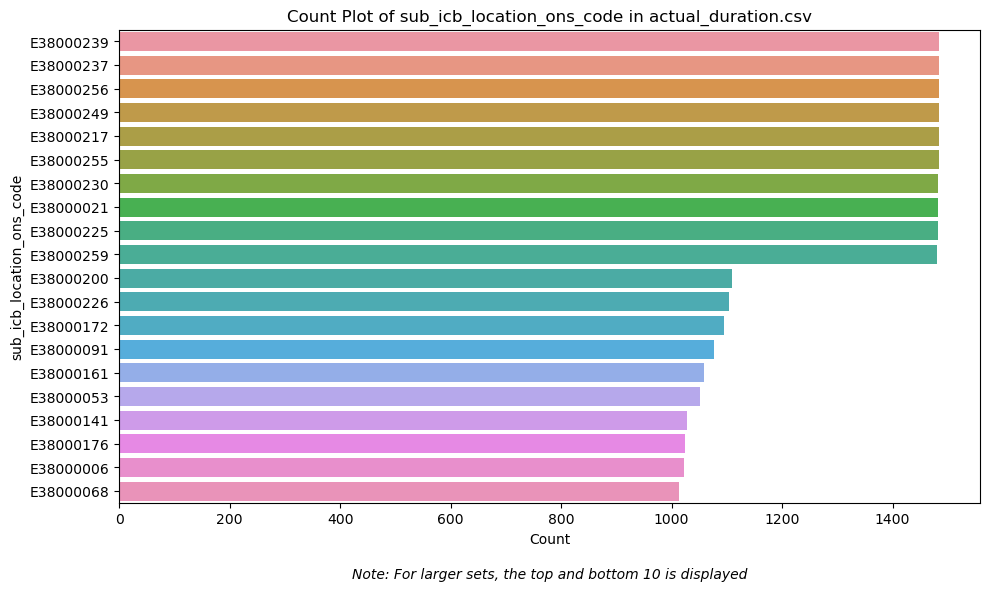

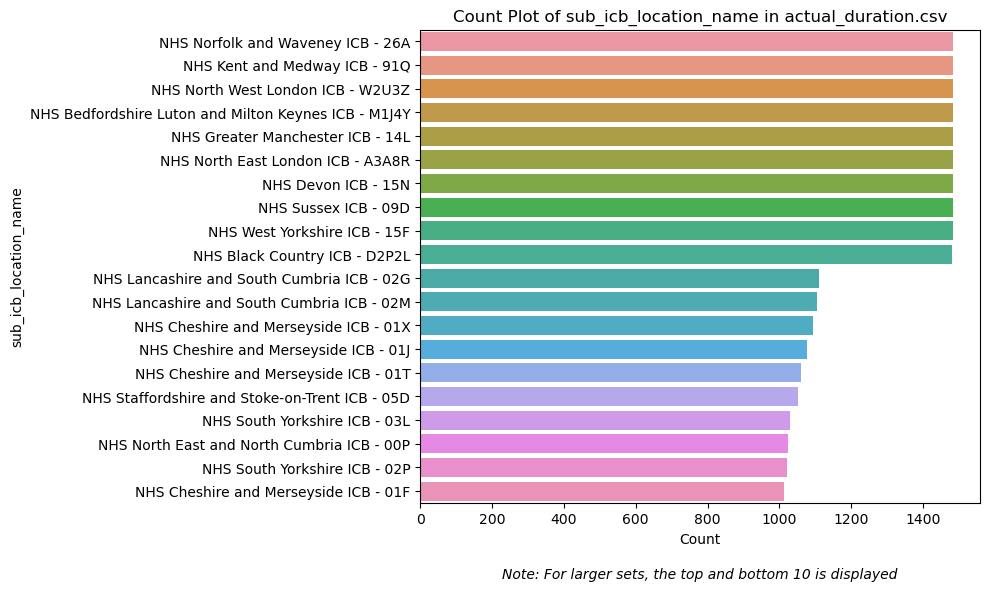

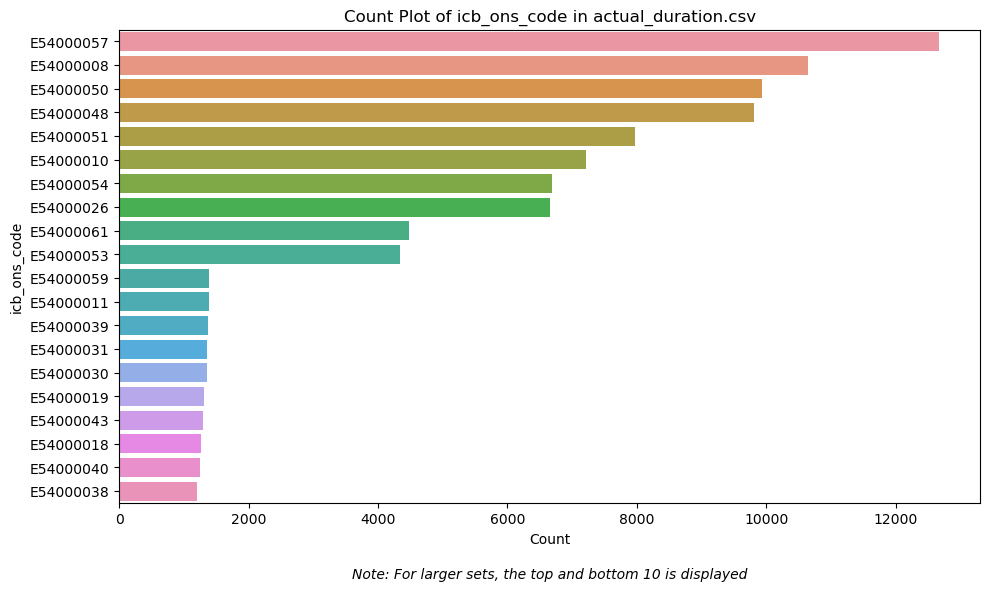

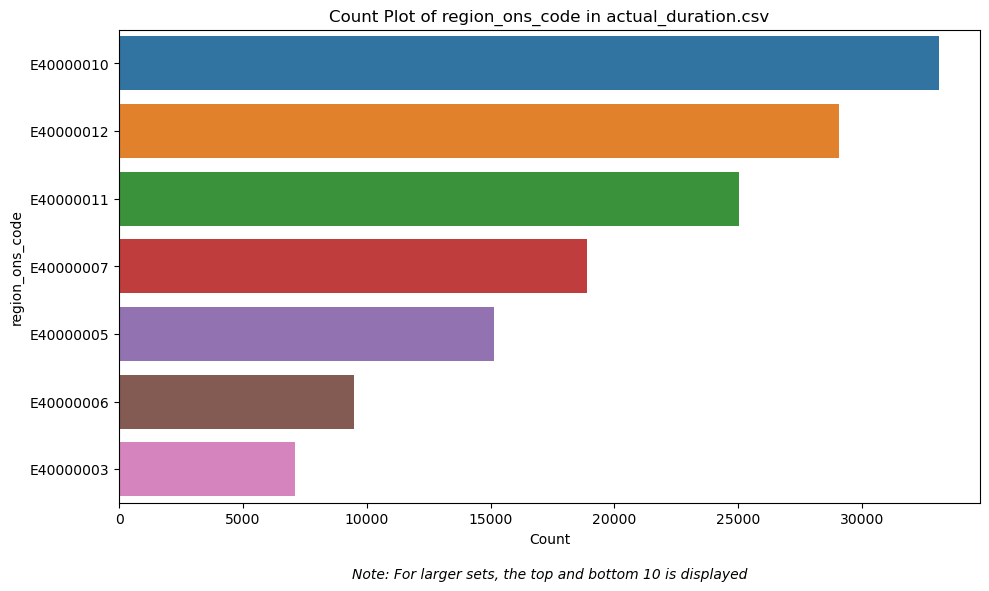

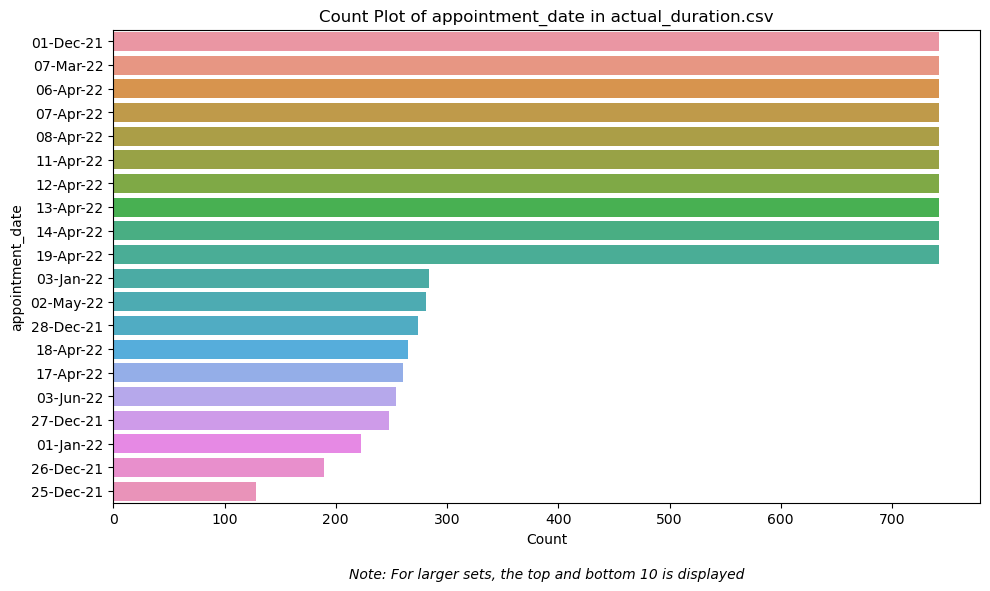

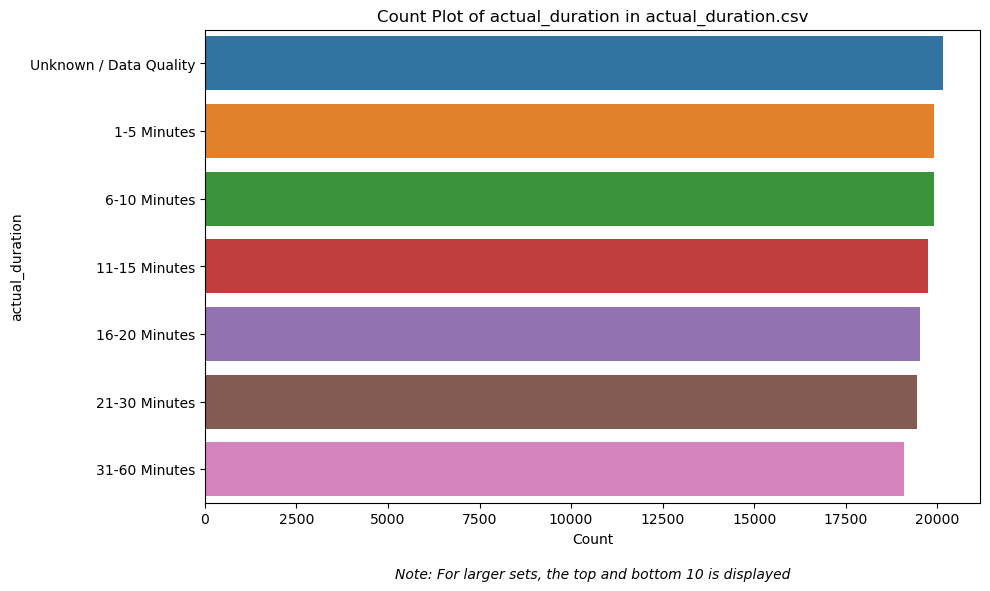

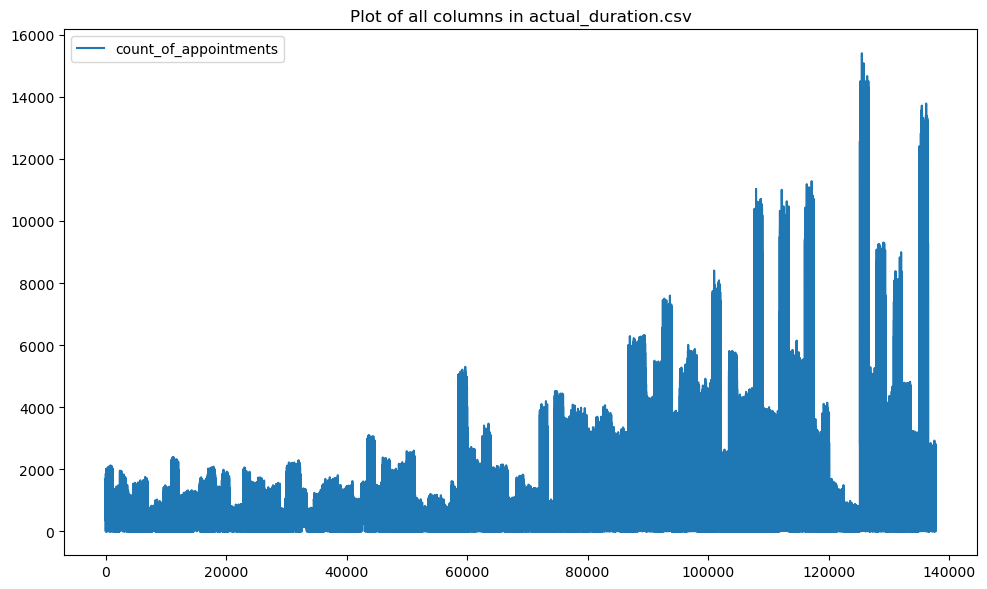

2024-08-12 12:01:53,718 - INFO - Data loaded successfully from appointments_regional.csv
2024-08-12 12:01:53,718 - INFO - Sense checking data for appointments_regional.csv
2024-08-12 12:01:53,718 - INFO - 
appointments_regional.csv - Data Info:

2024-08-12 12:01:53,922 - INFO - 
appointments_regional.csv - Data Shape: (596821, 7)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 596821 entries, 0 to 596820
Data columns (total 7 columns):
 #   Column                             Non-Null Count   Dtype 
---  ------                             --------------   ----- 
 0   icb_ons_code                       596821 non-null  object
 1   appointment_month                  596821 non-null  object
 2   appointment_status                 596821 non-null  object
 3   hcp_type                           596821 non-null  object
 4   appointment_mode                   596821 non-null  object
 5   time_between_book_and_appointment  596821 non-null  object
 6   count_of_appointments              596821 non-null  int64 
dtypes: int64(1), object(6)
memory usage: 31.9+ MB


,icb_ons_code,appointment_month,appointment_status,hcp_type,appointment_mode,time_between_book_and_appointment,count_of_appointments
0,E54000034,2020-01,Attended,GP,Face-to-Face,1 Day,8107
1,E54000034,2020-01,Attended,GP,Face-to-Face,15 to 21 Days,6791
2,E54000034,2020-01,Attended,GP,Face-to-Face,2 to 7 Days,20686
3,E54000034,2020-01,Attended,GP,Face-to-Face,22 to 28 Days,4268
4,E54000034,2020-01,Attended,GP,Face-to-Face,8 to 14 Days,11971


,icb_ons_code,appointment_month,appointment_status,hcp_type,appointment_mode,time_between_book_and_appointment,count_of_appointments
596816,E54000050,2022-06,Unknown,Unknown,Unknown,2 to 7 Days,21
596817,E54000050,2022-06,Unknown,Unknown,Unknown,22 to 28 Days,8
596818,E54000050,2022-06,Unknown,Unknown,Unknown,8 to 14 Days,28
596819,E54000050,2022-06,Unknown,Unknown,Unknown,More than 28 Days,17
596820,E54000050,2022-06,Unknown,Unknown,Unknown,Same Day,10


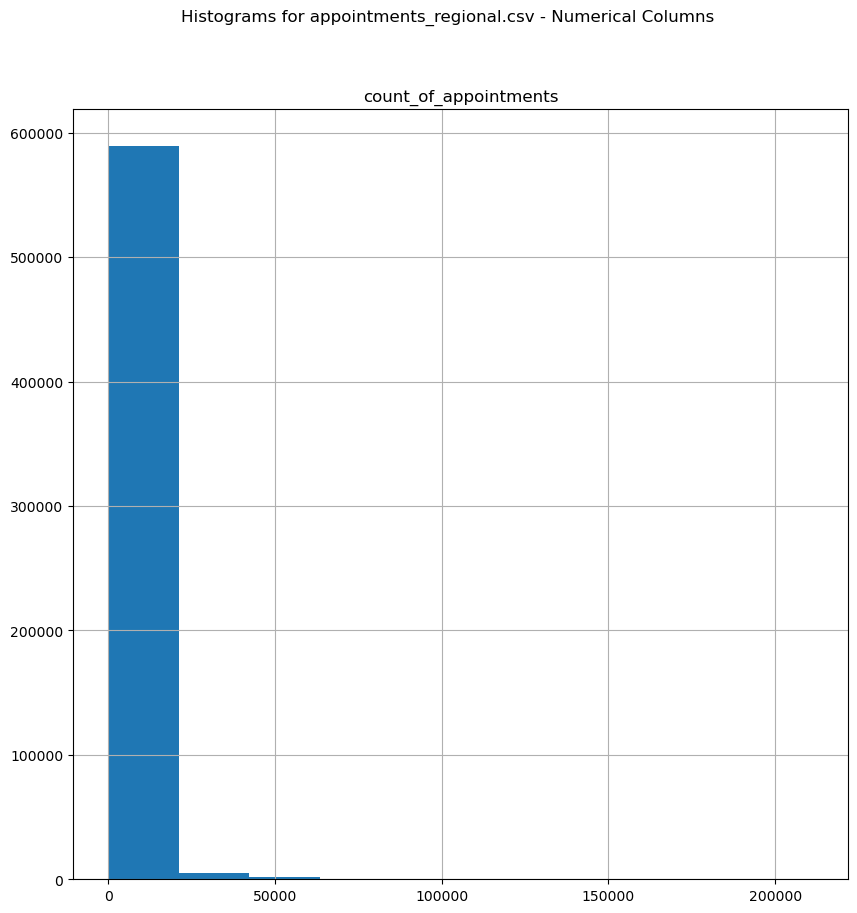

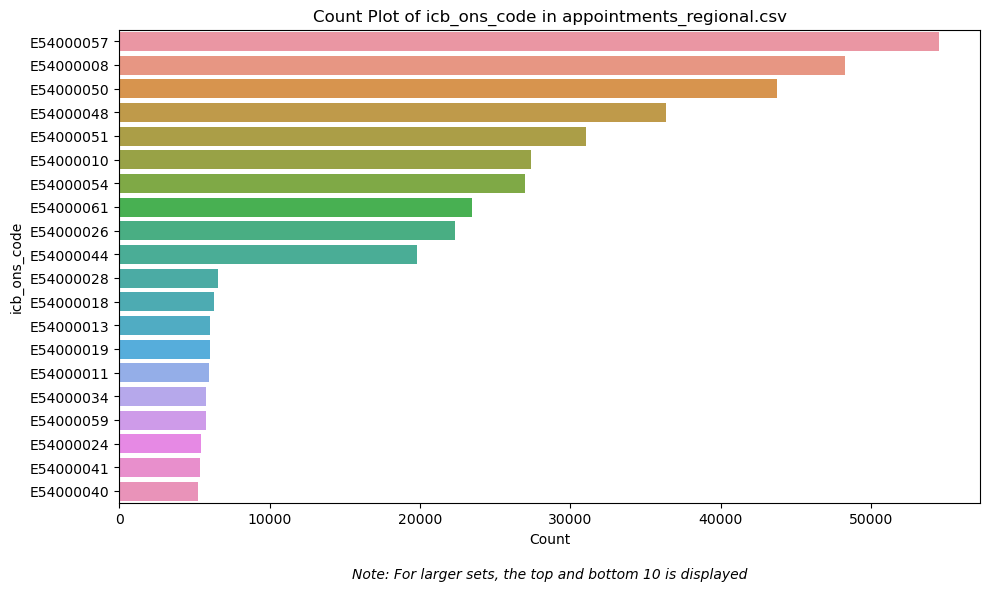

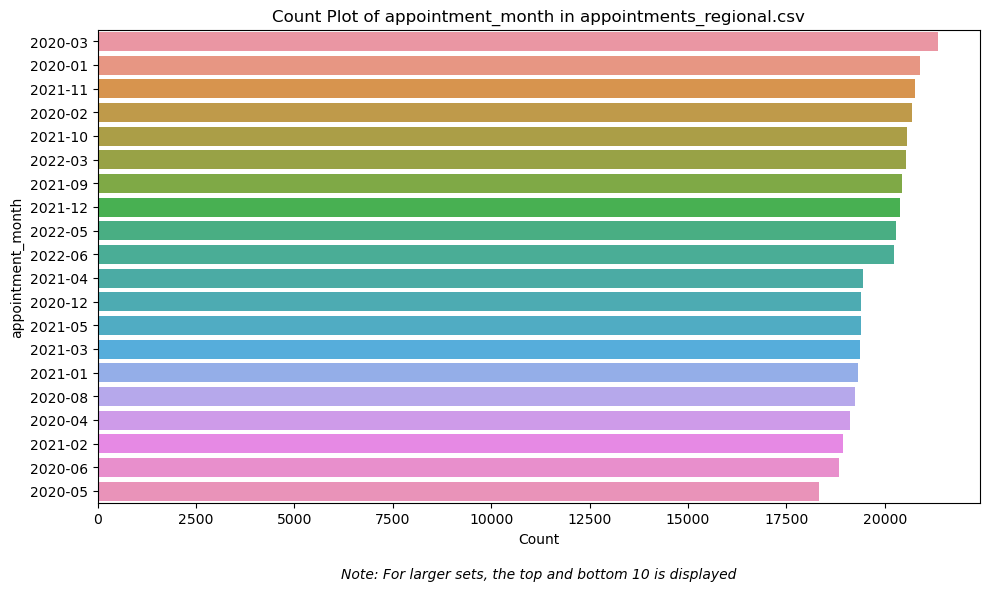

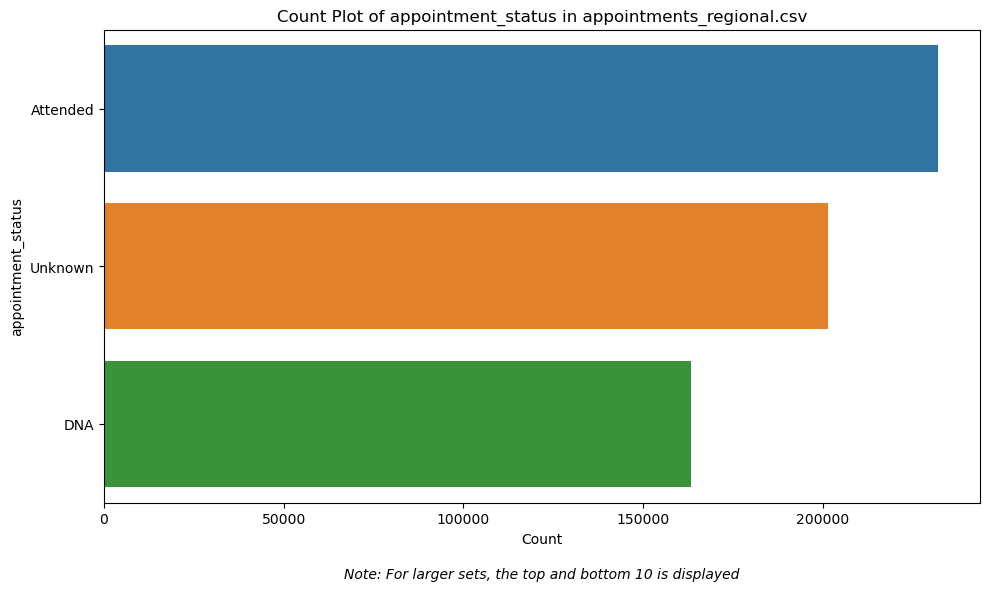

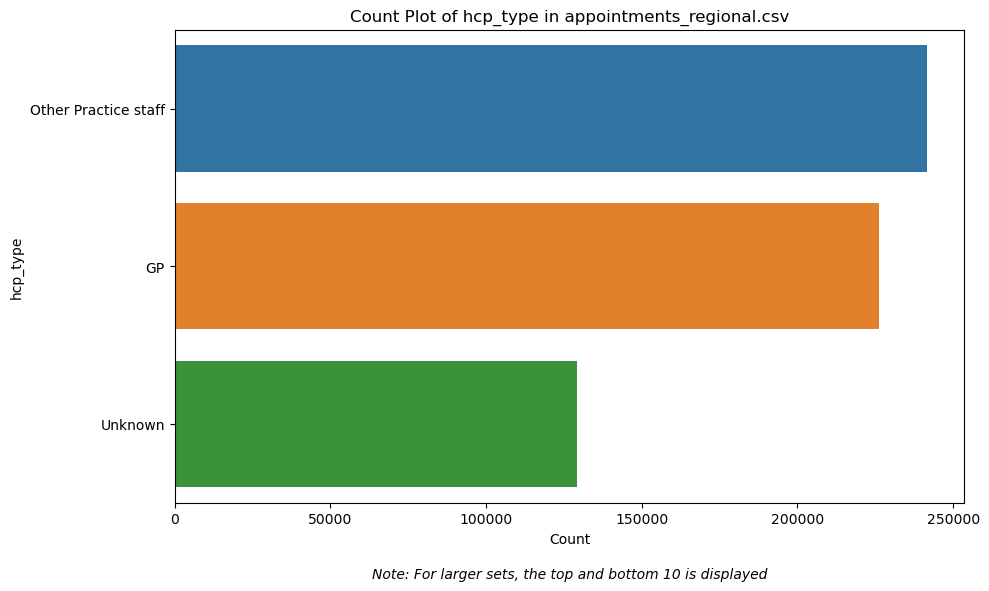

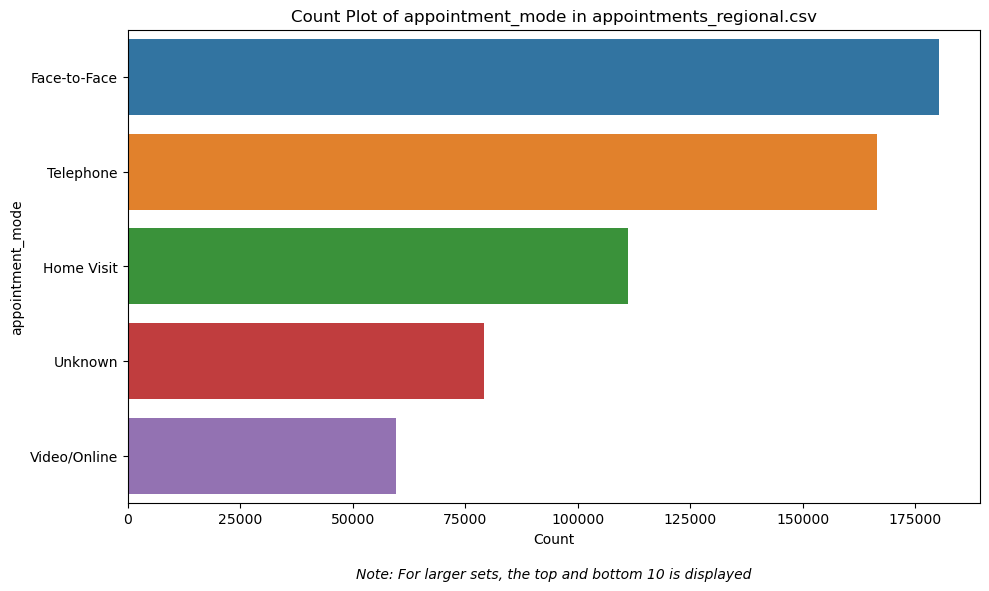

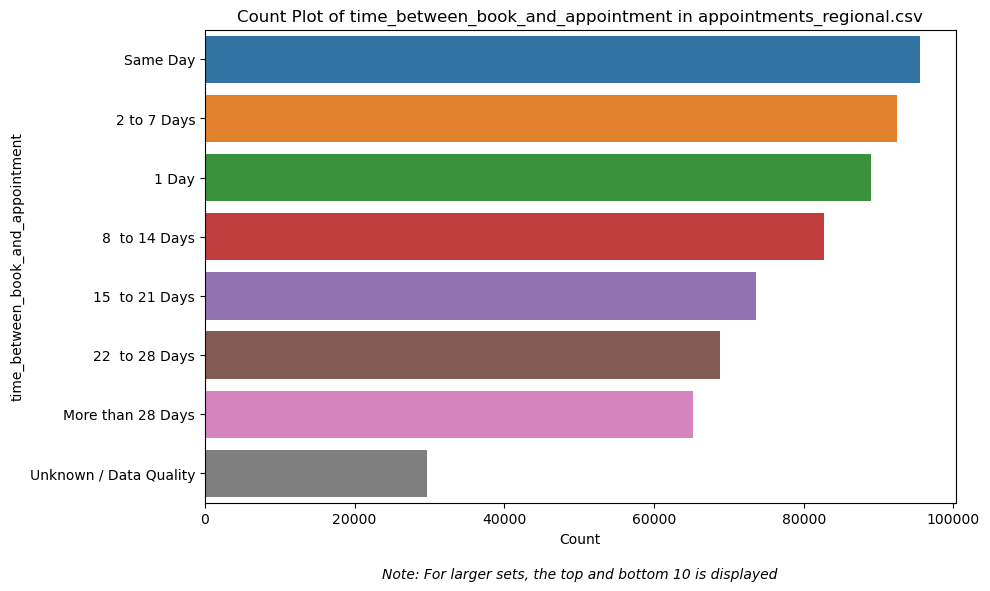

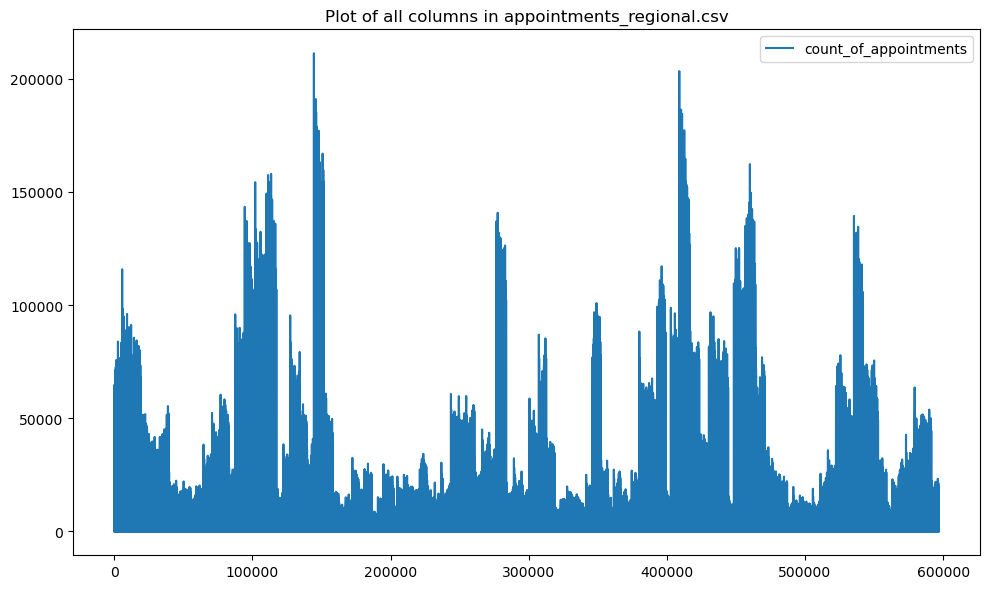

2024-08-12 12:04:59,518 - INFO - Data loaded successfully from national_categories.xlsx
2024-08-12 12:04:59,518 - INFO - Sense checking data for national_categories.xlsx
2024-08-12 12:04:59,534 - INFO - 
national_categories.xlsx - Data Info:

2024-08-12 12:04:59,818 - INFO - 
national_categories.xlsx - Data Shape: (817394, 8)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 817394 entries, 0 to 817393
Data columns (total 8 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   appointment_date       817394 non-null  datetime64[ns]
 1   icb_ons_code           817394 non-null  object        
 2   sub_icb_location_name  817394 non-null  object        
 3   service_setting        817394 non-null  object        
 4   context_type           817394 non-null  object        
 5   national_category      817394 non-null  object        
 6   count_of_appointments  817394 non-null  int64         
 7   appointment_month      817394 non-null  object        
dtypes: datetime64[ns](1), int64(1), object(6)
memory usage: 49.9+ MB


,appointment_date,icb_ons_code,sub_icb_location_name,service_setting,context_type,national_category,count_of_appointments,appointment_month
0,2021-08-02,E54000050,NHS North East and North Cumbria ICB - 00L,Primary Care Network,Care Related Encounter,Patient contact during Care Home Round,3,2021-08
1,2021-08-02,E54000050,NHS North East and North Cumbria ICB - 00L,Other,Care Related Encounter,Planned Clinics,7,2021-08
2,2021-08-02,E54000050,NHS North East and North Cumbria ICB - 00L,General Practice,Care Related Encounter,Home Visit,79,2021-08
3,2021-08-02,E54000050,NHS North East and North Cumbria ICB - 00L,General Practice,Care Related Encounter,General Consultation Acute,725,2021-08
4,2021-08-02,E54000050,NHS North East and North Cumbria ICB - 00L,General Practice,Care Related Encounter,Structured Medication Review,2,2021-08


,appointment_date,icb_ons_code,sub_icb_location_name,service_setting,context_type,national_category,count_of_appointments,appointment_month
817389,2022-06-30,E54000054,NHS West Yorkshire ICB - X2C4Y,Extended Access Provision,Care Related Encounter,Unplanned Clinical Activity,12,2022-06
817390,2022-06-30,E54000054,NHS West Yorkshire ICB - X2C4Y,Extended Access Provision,Care Related Encounter,Planned Clinics,4,2022-06
817391,2022-06-30,E54000054,NHS West Yorkshire ICB - X2C4Y,Extended Access Provision,Care Related Encounter,Planned Clinical Procedure,92,2022-06
817392,2022-06-30,E54000054,NHS West Yorkshire ICB - X2C4Y,Extended Access Provision,Care Related Encounter,General Consultation Routine,4,2022-06
817393,2022-06-30,E54000054,NHS West Yorkshire ICB - X2C4Y,Extended Access Provision,Care Related Encounter,General Consultation Acute,19,2022-06


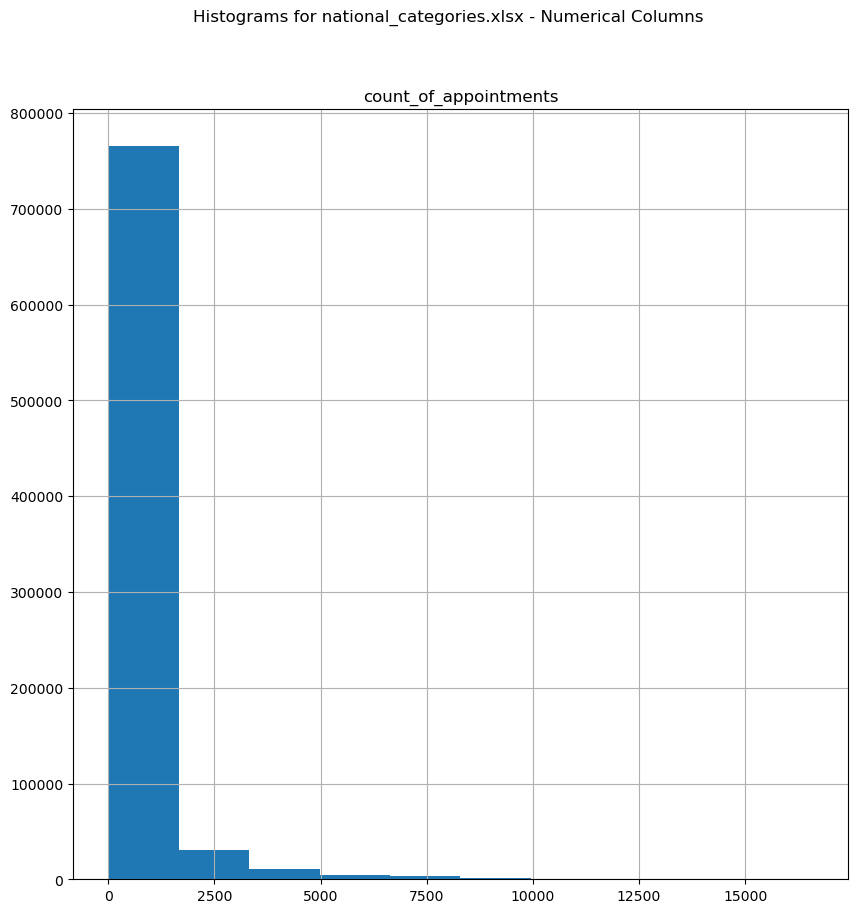

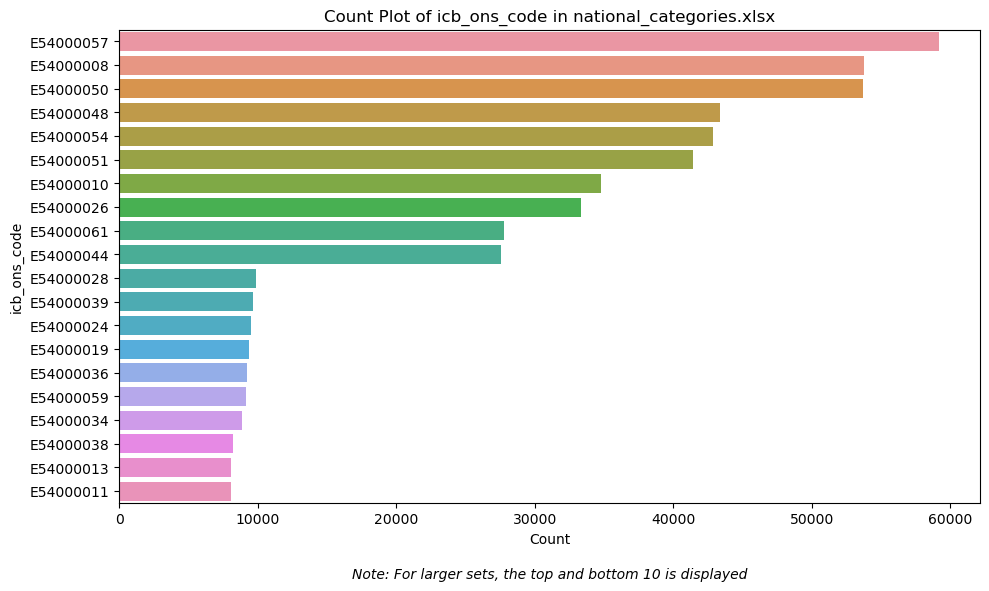

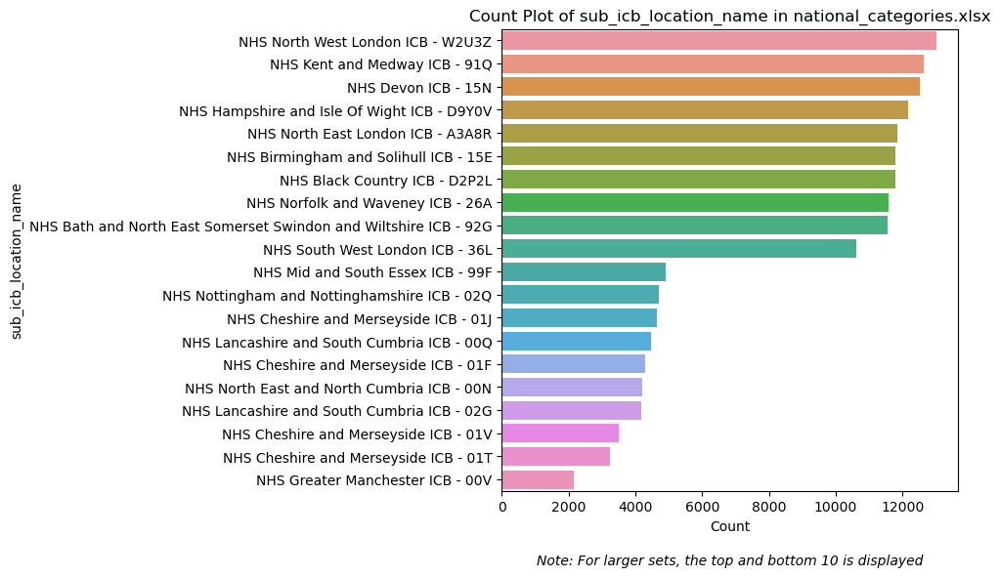

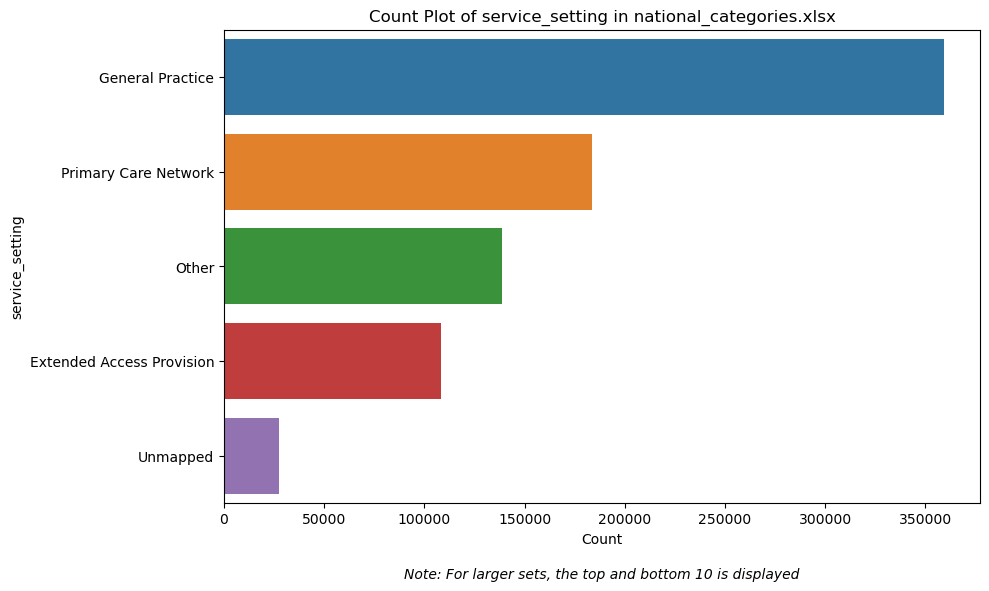

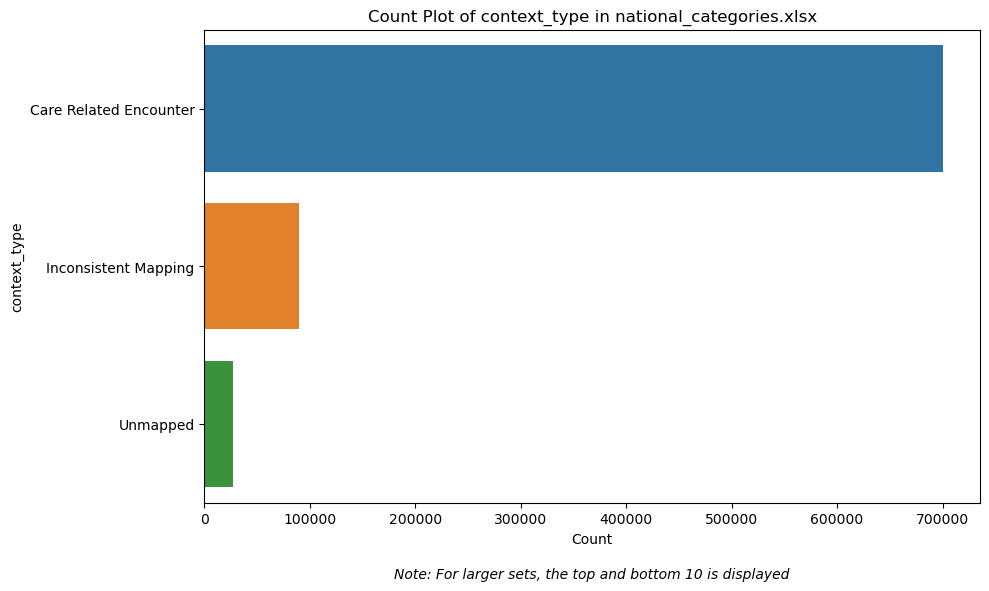

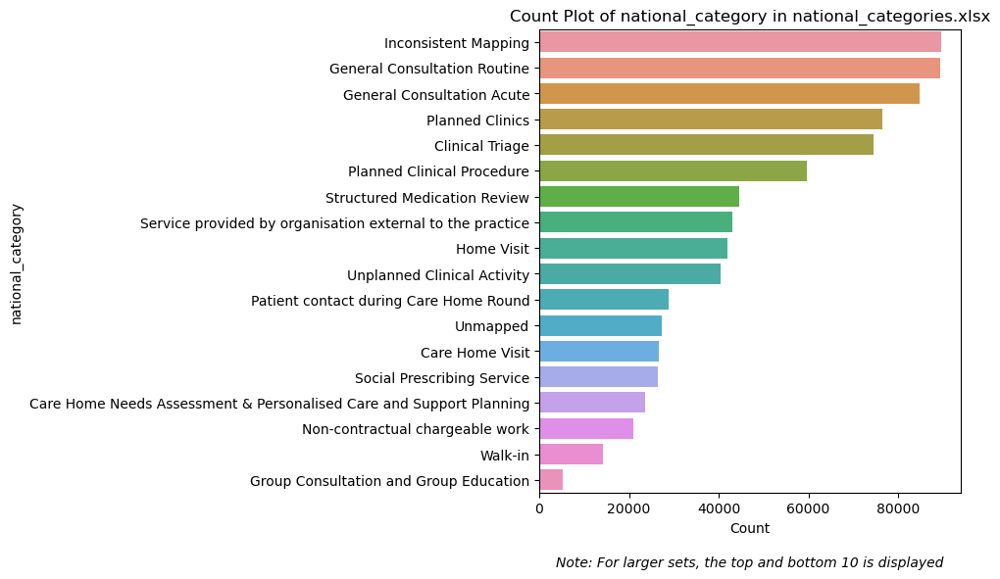

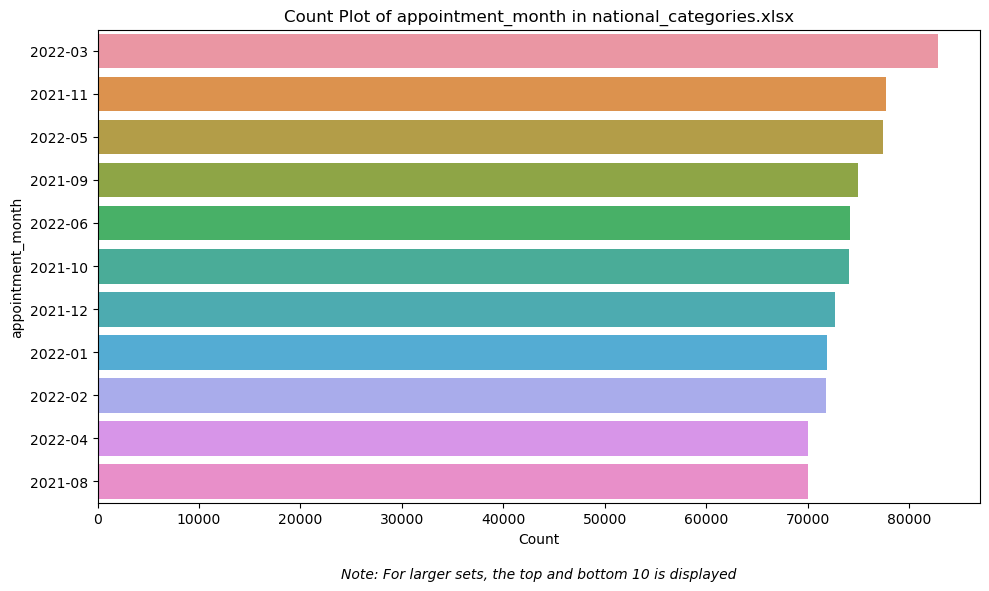

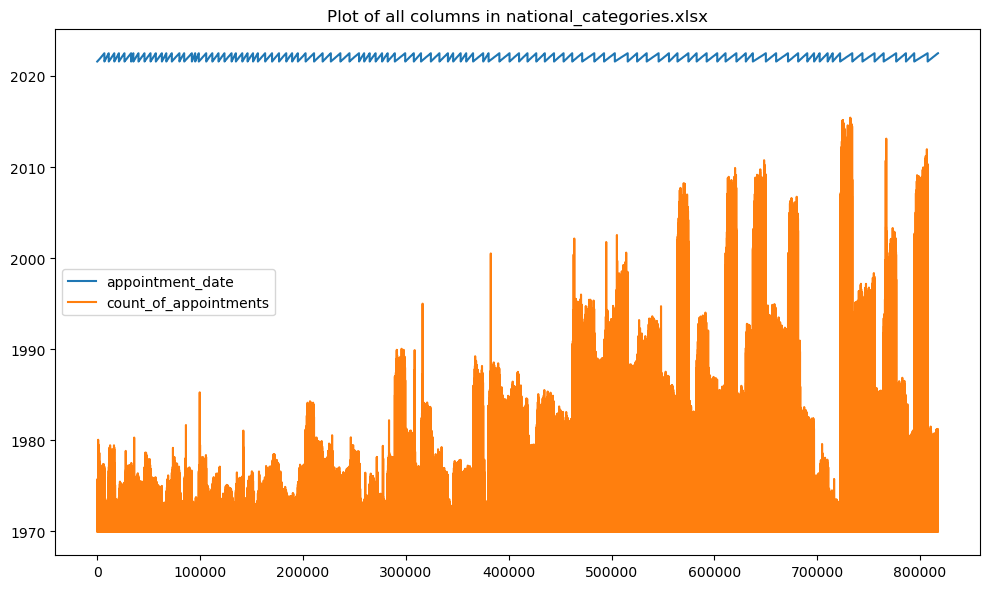

In [16]:
# Function to sense check data
def sense_check_data(df, file_name):
    try:
        logging.info(f"Sense checking data for {file_name}")
        logging.info(f"\n{file_name} - Data Info:\n")
        df.info()
        logging.info(f"\n{file_name} - Data Shape: {df.shape}")
        # logging.info(f"\n{file_name} - Data Description:\n{df.describe(include='all')}") 
        # If you would like to include the statistical description at this stage too.
        
        display(df.head())
        display(df.tail())

        # Plot histograms for numerical columns
        numerical_cols = df.select_dtypes(include=[np.number]).columns.tolist()
        if numerical_cols:
            df[numerical_cols].hist(figsize=(10, 10))
            plt.suptitle(f'Histograms for {file_name} - Numerical Columns')
            plt.show()

        # Plot count plots for non-numerical columns
        categorical_cols = df.select_dtypes(include=['object', 'category']).columns.tolist()
        if categorical_cols:
            for col in categorical_cols:
                # Get top 10 and bottom 10 unique values
                value_counts = df[col].value_counts()
                if len(value_counts) > 20:
                    top_10 = value_counts.nlargest(10)      # adjust the number if you want to see less or more value points in the visualisations
                    bottom_10 = value_counts.nsmallest(10).sort_values(ascending=False)
                    value_counts = pd.concat([top_10, bottom_10])

                plt.figure(figsize=(10, 6))
                sns.countplot(y=df[col], order=value_counts.index)
                plt.title(f'Count Plot of {col} in {file_name}')
                plt.xlabel('Count')
                plt.ylabel(col)
                
                # Add subtitle below the title
                plt.text(0.5, -0.15, 'Note: For larger sets, the top and bottom 10 is displayed',
                         ha='center', va='center', transform=plt.gca().transAxes, fontsize=10, style='italic')

                plt.tight_layout()
                plt.show()

        # Plot all columns
        df.plot(figsize=(10, 6))
        plt.title(f'Plot of all columns in {file_name}')
        plt.tight_layout()
        plt.show()

    except Exception as e:
        logging.error(f"Error during sense check for {file_name}: {str(e)}")

# Main workflow
def main():
    file_names = ['actual_duration.csv', 'appointments_regional.csv', 'national_categories.xlsx']

    for file_name in file_names:
        file_type = 'excel' if file_name.endswith('.xlsx') else 'csv'
        df = load_data(file_name, file_type=file_type)
        if df is not None:
            sense_check_data(df, file_name)

if __name__ == "__main__":
    main()

<a id="Sense-checking-results"></a>
#### Sense checking - results:
- There are no missing values in the dataset.
- The appointment_month and appointment_date columns are not formatted correctly as date
- time_between_book_and_appointment and actual duration columns can be transformed to represent just the numeric categories - these can be added as an extra column
- sub_icb_location_name includes the location code at the end. These can be separated, as they are actually the IBC location names.
- The actual_duration.csv has 137793 rows and 8 columns
- appointments_regional.csv has 596821 rows and 7 columns
- national_categories_csv.csv has 817394 rows and 8 columns
- an ERD was created based on the three tables. See Report for details. icb_ons_code is present in all three files.

<a id="Data-Cleaning"></a>
# Data Cleaning

When cleaning data, it's essential to consider several dimensions to ensure high-quality data. These dimensions include data accuracy, completeness, validity, timeliness, uniqueness, and consistency. This methodology derives from best practices in data quality management and governance frameworks.

#### Dimensions of Data Quality:

- Data Accuracy: Ensures that the data correctly represents the real-world entities it is supposed to model. Methods: Validation checks, comparing with trusted sources, correcting inaccuracies.

- Data Completeness: Ensures that all required data is present and no critical data is missing. Methods: Checking for missing values, filling in gaps, ensuring mandatory fields are populated.

- Data Validity: Ensures that data conforms to the defined formats and standards. Methods: Using regex patterns, data type checks, and range validations.

- Data Timeliness: Ensures that data is up-to-date and available when needed. Methods: Timestamp checks, ensuring data updates are within acceptable timeframes.

- Data Uniqueness: Ensures that each record is unique and there are no duplicate entries. Methods: Removing duplicates, enforcing unique constraints.

- Data Consistency: Ensures that data is consistent across different systems and datasets. Methods: Cross-validation between systems, ensuring referential integrity.

- References: ISO 8000-1:2022, DAMADMBOK, Gartner Data Quality Framework 

In [20]:
# Data Cleaning Functions
# Function to remove blank spaces in the data
def clean_data(df, file_name):
    try:
        logging.info(f'\nCleaning data in {file_name}')
        logging.info(f"Shape before cleaning: {df.shape}")
        df.columns = df.columns.str.strip()
        df = df.apply(lambda x: x.str.strip() if x.dtype == "object" else x)
        logging.info(f"Shape after cleaning: {df.shape}")
        return df
    except Exception as e:
        logging.error(f"Error cleaning data for {file_name}: {str(e)}")
        return df 
        
# Function to check missing values
def check_missing_values(df, file_name):
    logging.info(f'\nChecking for missing values in {file_name}')
    missing_values = df.isnull().sum()
    logging.info(f'\nMissing values in {file_name}:\n{missing_values}\n')
    return missing_values

# Function to correct date and format appointment_date columns
def correct_date_types(df, date_columns, file_name):
    logging.info(f'\nCorrecting date types in {file_name} for columns: {date_columns}')
    for column in date_columns:
        original_non_null = df[column].notnull().sum()
        df[column] = pd.to_datetime(df[column], errors='coerce')
        converted_non_null = df[column].notnull().sum()
        logging.info(f'{column} - Converted {converted_non_null} out of {original_non_null} non-null values')
    logging.info(f'Data types after conversion in {file_name}:\n{df.dtypes}\n')
   # If 'appointment_date' column is in the date_columns, create 'appointment_month' column
    if 'appointment_date' in date_columns:
        df['appointment_month'] = df['appointment_date'].dt.to_period('M').dt.to_timestamp()
        logging.info(f'Created appointment_month column in {file_name}')   
    return df

# Function to correct and format appointment_month column
def format_appointment_month(df, column, file_name):
    logging.info(f'\nFormatting {column} in {file_name}')
    original_non_null = df[column].notnull().sum()
    df[column] = pd.to_datetime(df[column], errors='coerce').dt.to_period('M')
    converted_non_null = df[column].notnull().sum()
    logging.info(f'{column} - Converted {converted_non_null} out of {original_non_null} non-null values')
    logging.info(f'Formatted {column} in {file_name}:\n{df[column].head()}\n')
    return df
    
# Function to create an icb_location_name columns in ad
def create_new_icb_location_name(df, column_name, file_name):
    logging.info(f'Creating new icb_location_name column from {column_name} in {file_name}')
    # Split the string based on 'ICB - ' and retain the full ICB name
    df['icb_location_name'] = df[column_name].str.split('ICB - ').str[0] + 'ICB'
    return df
    # Reorder columns to place the new columns next to each other
    new_column_order = ['icb_ons_code', 'sub_icb_location_ons_code','sub_icb_location_name', 
                        'icb_location_name', 'region_ons_code', 'appointment_date',
                        'appointment_month', 'actual_duration',
                        'count_of_appointments']
    df = df[new_column_order]
    return df

# Function to create a new icb_location_name and sub_icb_location_code columns in nc
def split_code_after_hyphen_and_reorder_columns(df, column_name, file_name):
    logging.info(f'Splitting code after hyphen in {column_name} in {file_name}')
    # Split the string based on 'ICB - ' and retain the full ICB name
    split_columns = df[column_name].str.split('ICB - ', n=1, expand=True)
    df['sub_icb_location_code'] = split_columns[1].str.strip()
    df['icb_location_name'] = split_columns[0].str.strip() + ' ICB'
    # Reorder columns to place the new columns next to each other
    new_column_order = ['icb_ons_code', 'sub_icb_location_code','sub_icb_location_name',
                        'icb_location_name', 'appointment_date', 
                        'appointment_month', 'service_setting', 
                        'context_type', 'national_category',
                        'count_of_appointments']
    df = df[new_column_order]
    return df

# Checking for duplicate values, adding a new column, where 1=duplicate, 0=not duplicate
def add_duplicate_flag(df, file_name):
    logging.info(f"Adding duplicate flag. DataFrame shape before: {df.shape}")
    try:
        df['duplicate_flag'] = 0  # Initialize the flag column with 0
        df.loc[df.duplicated(keep=False), 'duplicate_flag'] = 1
        logging.info(f"Duplicate flag added. DataFrame shape after: {df.shape}")
        return df
    except Exception as e:
        logging.error(f"Error adding duplicate flag: {str(e)}")
        return df  # Return the original DataFrame if the operation fails
        
# Function to categorize the actual_duration column
def convert_duration(actual_duration):
    if pd.isna(actual_duration):
        return np.nan
    if '1-5' in actual_duration:
        return '1-5'
    elif '6-10' in actual_duration:
        return '6-10'
    elif '11-15' in actual_duration:
        return '11-15'
    elif '16-20' in actual_duration:
        return '16-20'
    elif '21-30' in actual_duration:
        return '21-30'
    elif '31-60' in actual_duration:
        return '31-60'
    elif 'Unknown' in actual_duration or 'Data Quality' in actual_duration:
        return 'Unknown'
    else:
        return 'Unknown'

# Function to categorize the time_between_book_and_appointment column
def convert_duration_day(time_between_book_and_appointment):
    if pd.isna(time_between_book_and_appointment):
        return 'Unknown'
    time_between_book_and_appointment = ' '.join(time_between_book_and_appointment.split()).lower()
    if time_between_book_and_appointment == 'same day':
        return '0'
    elif time_between_book_and_appointment == '1 day':
        return '1'
    elif time_between_book_and_appointment == '2 to 7 days':
        return '2-7'
    elif time_between_book_and_appointment == '8 to 14 days':
        return '8-14'
    elif time_between_book_and_appointment == '15 to 21 days':
        return '15-21'
    elif time_between_book_and_appointment == '22 to 28 days':
        return '22-28'
    elif time_between_book_and_appointment == 'more than 28 days':
        return '28+'
    elif time_between_book_and_appointment == 'unknown / data quality':
        return 'Unknown'
    else:
        return 'Unknown'

# Function to display DataFrame
def display_dataframe(df, name, num_rows=5):
    if df is not None:
        logging.info(f'Displaying the first {num_rows} rows of {name}:')
        display(Markdown(f"### First {num_rows} rows of {name}:"))
        display(df.head(num_rows))
        display(Markdown("<br><br>"))
    else:
        logging.error(f"DataFrame {name} is None and cannot be displayed")
    

In [21]:
# Main workflow
def main():
    file_names = ['actual_duration.csv', 'appointments_regional.csv', 'national_categories.xlsx']
    dataframes = {}
    
    for file_name in file_names:
        file_type = 'excel' if file_name.endswith('.xlsx') else 'csv'
        df = load_data(file_name, file_type=file_type)
        if df is not None:
            dataframes[file_name] = df
    
    ad = dataframes.get('actual_duration.csv')
    ar = dataframes.get('appointments_regional.csv')
    nc = dataframes.get('national_categories.xlsx')

    # Log the shapes of the loaded data
    logging.info(f"Shape of ad after loading: {ad.shape if ad is not None else 'None'}")
    logging.info(f"Shape of ar after loading: {ar.shape if ar is not None else 'None'}")
    logging.info(f"Shape of nc after loading: {nc.shape if nc is not None else 'None'}")

    # Ensure data is loaded before proceeding
    if ad is None or ar is None or nc is None:
        logging.error("Failed to load one or more data files. Exiting.")
        return

    # Clean data
    ad = clean_data(ad, 'actual_duration.csv')
    ar = clean_data(ar, 'appointments_regional.csv')
    nc = clean_data(nc, 'national_categories.xlsx')

    # Log the shapes of the cleaned data
    logging.info(f"Shape of ad after cleaning: {ad.shape if ad is not None else 'None'}")
    logging.info(f"Shape of ar after cleaning: {ar.shape if ar is not None else 'None'}")
    logging.info(f"Shape of nc after cleaning: {nc.shape if nc is not None else 'None'}")
   
    # Check if any DataFrame is None after cleaning
    if ad is None or ar is None or nc is None:
        logging.error("One or more DataFrames became None after cleaning. Exiting.")
        return

    # Format appointment_date columns
    ad = correct_date_types(ad, ['appointment_date'], 'actual_duration.csv')
    nc = correct_date_types(nc, ['appointment_date'], 'national_categories.xlsx')

    # Format appointment_month columns
    ar = format_appointment_month(ar, 'appointment_month', 'appointments_regional.csv')
    nc = format_appointment_month(nc, 'appointment_month', 'national_categories.xlsx')

    # Check missing values
    check_missing_values(ad, 'actual_duration.csv')
    check_missing_values(ar, 'appointments_regional.csv')
    check_missing_values(nc, 'national_categories.xlsx')

    # Format sub_icb_location_name columns in ad
    ad = create_new_icb_location_name(ad, 'sub_icb_location_name', 'actual_duration.csv')

    # Format sub_icb_location_name columns in nc
    nc = split_code_after_hyphen_and_reorder_columns(nc, 'sub_icb_location_name', 'national_categories.xlsx')

    # Process data
    ad['actual_duration_minutes'] = ad['actual_duration'].apply(convert_duration)
    ar['days_between_booking_and_appointment'] = ar['time_between_book_and_appointment'].apply(convert_duration_day)

    ad = add_duplicate_flag(ad, 'actual_duration.csv')
    ar = add_duplicate_flag(ar, 'appointments_regional.csv')
    nc = add_duplicate_flag(nc, 'national_categories.xlsx')

    # Display cleaned data
    display_dataframe(ad, 'cleaned_actual_duration')
    display_dataframe(ar, 'cleaned_appointments_regional')
    display_dataframe(nc, 'cleaned_national_categories')

    # Save results
    OUTPUT_PATH = './'  # Define your output path here
    save_results(ad, os.path.join(OUTPUT_PATH, 'cleaned_actual_duration.csv'))
    save_results(ar, os.path.join(OUTPUT_PATH, 'cleaned_appointments_regional.csv'))
    save_results(nc, os.path.join(OUTPUT_PATH, 'cleaned_national_categories.csv'))

    logging.info("Data cleaning completed successfully.")

if __name__ == "__main__":
    main()

2024-08-12 12:05:16,812 - INFO - Data loaded successfully from actual_duration.csv
2024-08-12 12:05:17,880 - INFO - Data loaded successfully from appointments_regional.csv
2024-08-12 12:08:16,952 - INFO - Data loaded successfully from national_categories.xlsx
2024-08-12 12:08:16,952 - INFO - Shape of ad after loading: (137793, 8)
2024-08-12 12:08:16,952 - INFO - Shape of ar after loading: (596821, 7)
2024-08-12 12:08:16,952 - INFO - Shape of nc after loading: (817394, 8)
2024-08-12 12:08:16,952 - INFO - 
Cleaning data in actual_duration.csv
2024-08-12 12:08:16,952 - INFO - Shape before cleaning: (137793, 8)
2024-08-12 12:08:17,406 - INFO - Shape after cleaning: (137793, 8)
2024-08-12 12:08:17,406 - INFO - 
Cleaning data in appointments_regional.csv
2024-08-12 12:08:17,406 - INFO - Shape before cleaning: (596821, 7)
2024-08-12 12:08:19,018 - INFO - Shape after cleaning: (596821, 7)
2024-08-12 12:08:19,018 - INFO - 
Cleaning data in national_categories.xlsx
2024-08-12 12:08:19,018 - INFO

### First 5 rows of cleaned_actual_duration:

,sub_icb_location_code,sub_icb_location_ons_code,sub_icb_location_name,icb_ons_code,region_ons_code,appointment_date,actual_duration,count_of_appointments,appointment_month,icb_location_name,actual_duration_minutes,duplicate_flag
0,00L,E38000130,NHS North East and North Cumbria ICB - 00L,E54000050,E40000012,2021-12-01,31-60 Minutes,364,2021-12-01,NHS North East and North Cumbria ICB,31-60,0
1,00L,E38000130,NHS North East and North Cumbria ICB - 00L,E54000050,E40000012,2021-12-01,21-30 Minutes,619,2021-12-01,NHS North East and North Cumbria ICB,21-30,0
2,00L,E38000130,NHS North East and North Cumbria ICB - 00L,E54000050,E40000012,2021-12-01,6-10 Minutes,1698,2021-12-01,NHS North East and North Cumbria ICB,6-10,0
3,00L,E38000130,NHS North East and North Cumbria ICB - 00L,E54000050,E40000012,2021-12-01,Unknown / Data Quality,1277,2021-12-01,NHS North East and North Cumbria ICB,Unknown,0
4,00L,E38000130,NHS North East and North Cumbria ICB - 00L,E54000050,E40000012,2021-12-01,16-20 Minutes,730,2021-12-01,NHS North East and North Cumbria ICB,16-20,0


<br><br>

2024-08-12 12:08:40,735 - INFO - Displaying the first 5 rows of cleaned_appointments_regional:


### First 5 rows of cleaned_appointments_regional:

,icb_ons_code,appointment_month,appointment_status,hcp_type,appointment_mode,time_between_book_and_appointment,count_of_appointments,days_between_booking_and_appointment,duplicate_flag
0,E54000034,2020-01,Attended,GP,Face-to-Face,1 Day,8107,1,0
1,E54000034,2020-01,Attended,GP,Face-to-Face,15 to 21 Days,6791,15-21,0
2,E54000034,2020-01,Attended,GP,Face-to-Face,2 to 7 Days,20686,2-7,0
3,E54000034,2020-01,Attended,GP,Face-to-Face,22 to 28 Days,4268,22-28,0
4,E54000034,2020-01,Attended,GP,Face-to-Face,8 to 14 Days,11971,8-14,0


<br><br>

2024-08-12 12:08:40,766 - INFO - Displaying the first 5 rows of cleaned_national_categories:


### First 5 rows of cleaned_national_categories:

,icb_ons_code,sub_icb_location_code,sub_icb_location_name,icb_location_name,appointment_date,appointment_month,service_setting,context_type,national_category,count_of_appointments,duplicate_flag
0,E54000050,00L,NHS North East and North Cumbria ICB - 00L,NHS North East and North Cumbria ICB,2021-08-02,2021-08,Primary Care Network,Care Related Encounter,Patient contact during Care Home Round,3,0
1,E54000050,00L,NHS North East and North Cumbria ICB - 00L,NHS North East and North Cumbria ICB,2021-08-02,2021-08,Other,Care Related Encounter,Planned Clinics,7,0
2,E54000050,00L,NHS North East and North Cumbria ICB - 00L,NHS North East and North Cumbria ICB,2021-08-02,2021-08,General Practice,Care Related Encounter,Home Visit,79,0
3,E54000050,00L,NHS North East and North Cumbria ICB - 00L,NHS North East and North Cumbria ICB,2021-08-02,2021-08,General Practice,Care Related Encounter,General Consultation Acute,725,0
4,E54000050,00L,NHS North East and North Cumbria ICB - 00L,NHS North East and North Cumbria ICB,2021-08-02,2021-08,General Practice,Care Related Encounter,Structured Medication Review,2,0


<br><br>

2024-08-12 12:08:40,797 - INFO - Saving results to ./cleaned_actual_duration.csv
2024-08-12 12:08:43,120 - INFO - Successfully saved results to ./cleaned_actual_duration.csv
2024-08-12 12:08:43,120 - INFO - Saving results to ./cleaned_appointments_regional.csv
2024-08-12 12:08:52,238 - INFO - Successfully saved results to ./cleaned_appointments_regional.csv
2024-08-12 12:08:52,238 - INFO - Saving results to ./cleaned_national_categories.csv
2024-08-12 12:09:10,897 - INFO - Successfully saved results to ./cleaned_national_categories.csv
2024-08-12 12:09:10,897 - INFO - Data cleaning completed successfully.


<a id="Exploratory-Data-Analysis-(EDA)-Statistics-data-normalisation-and-standardisation"></a>
# Stage 2 - Exploratory Data Analysis - Statistics, data normalisation and standardisation

In [23]:
# Functions for EDA
# Function to generate summary statistics
def generate_summary_statistics(df, file_name):
    logging.info(f'Summary statistics for {file_name}:')
    numerical_cols = df.select_dtypes(include=[np.number]).columns.tolist()
    categorical_cols = df.select_dtypes(exclude=[np.number]).columns.tolist()
    if numerical_cols:
        logging.info(f'\nNumerical summary statistics for {file_name}:\n{df[numerical_cols].describe()}\n')
    if categorical_cols:
        logging.info(f'\nCategorical summary statistics for {file_name}:\n{df[categorical_cols].describe(include=["object", "category"])}\n')

# Function to detect outlier values
def detect_outlier_values(df, column, file_name):
    """
    Detects outliers in a specified numerical column of a DataFrame using the IQR method and adds a flag column.

    Parameters:
    - df: DataFrame to analyze.
    - column: Column name to detect outliers.
    - file_name: Name of the file or dataset for logging purposes.

    Returns:
    - Dictionary with IQRLower, IQRUpper, and the number of outliers.
    """
    logging.info(f'\nOutlier detection for {file_name} - {column}:')
    
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    IQRLower = Q1 - 1.5 * IQR
    IQRUpper = Q3 + 1.5 * IQR
    
    outliers = df[(df[column] < IQRLower) | (df[column] > IQRUpper)]
    logging.info(f'Column: {column}')
    logging.info(f'Q1: {Q1}, Q3: {Q3}, IQR: {IQR}')
    logging.info(f'IQRLower: {IQRLower}, IQRUpper: {IQRUpper}')
    logging.info(f'Number of outliers: {outliers.shape[0]}')
    
    # Add outlier flag column
    outlier_flag_column = f'outlier_flag'
    df[outlier_flag_column] = 0
    df.loc[(df[column] < IQRLower) | (df[column] > IQRUpper), outlier_flag_column] = 1
    
    return {
        'IQRLower': IQRLower,
        'IQRUpper': IQRUpper,
        'num_outliers': outliers.shape[0]
    }


# Function to display distinct categories and their counts
def display_distinct_categories(df, file_name):
    print(f"\nDistinct categories and their counts in {file_name}:")
    for column in df.columns:
        distinct_counts = df[column].value_counts()
        print(f"\nDistinct Categories in '{column}':")
        print(distinct_counts)

# Function to perform absolute max scaling
def absolute_max_scaling(df, column):
    max_value = df[column].abs().max()
    abs_max_scaled_column = df[column] / max_value
    return abs_max_scaled_column

# Function to perform min-max scaling
def min_max_scaling(df, column):
    min_value = df[column].min()
    max_value = df[column].max()
    min_max_scaled_column = (df[column] - min_value) / (max_value - min_value)
    return min_max_scaled_column

# Function to perform z-score normalization
def z_score_normalization(df, column):
    z_score_scaled_column = (df[column] - df[column].mean()) / df[column].std()
    return z_score_scaled_column

In [24]:
# Main workflow for EDA
def main():
    try:
        # Load cleaned data
        ad = load_data('cleaned_actual_duration.csv')
        ar = load_data('cleaned_appointments_regional.csv')
        nc = load_data('cleaned_national_categories.csv')

        # Ensure data is loaded before proceeding
        if ad is None or ar is None or nc is None:
            logging.error("Failed to load one or more data files. Exiting.")
            return

        # Generate summary statistics
        generate_summary_statistics(ad, 'cleaned_actual_duration')
        generate_summary_statistics(ar, 'cleaned_appointments_regional')
        generate_summary_statistics(nc, 'cleaned_national_categories')

        # Outlier detection
        num_outliers_ad = detect_outlier_values(ad, 
                                                'count_of_appointments', 
                                                'cleaned_actual_duration')
        num_outliers_ar = detect_outlier_values(ar,
                                                'count_of_appointments',
                                                'cleaned_appointments_regional')
        num_outliers_nc = detect_outlier_values(nc, 
                                                'count_of_appointments', 
                                                'cleaned_national_categories')

        logging.info(f"Number of outliers in cleaned_actual_duration: {num_outliers_ad['num_outliers']}")
        logging.info(f"Number of outliers in cleaned_appointments_regional: {num_outliers_ar['num_outliers']}")
        logging.info(f"Number of outliers in cleaned_national_categories: {num_outliers_nc['num_outliers']}")

        # Display distinct categories for ad
        display_distinct_categories(ad, 'cleaned_actual_duration')
        # Display distinct categories for ar
        display_distinct_categories(ar, 'cleaned_appointments_regional')
        # Display distinct categories for nc
        display_distinct_categories(nc, 'cleaned_national_categories')

        # Perform absolute max scaling
        ad['max_scaled_appointments'] = absolute_max_scaling(ad, 'count_of_appointments')
        ar['max_scaled_appointments'] = absolute_max_scaling(ar, 'count_of_appointments')
        nc['max_scaled_appointments'] = absolute_max_scaling(nc, 'count_of_appointments')

        logging.info("Performed absolute max scaling on count_of_appointments for all datasets.")

        # Perform min-max scaling
        ad['min_max_scaled_appointments'] = min_max_scaling(ad, 'count_of_appointments')
        ar['min_max_scaled_appointments'] = min_max_scaling(ar, 'count_of_appointments')
        nc['min_max_scaled_appointments'] = min_max_scaling(nc, 'count_of_appointments')

        logging.info("Performed min-max scaling on count_of_appointments for all datasets.")

        # Perform z-score normalization
        ad['z_score_scaled_appointments'] = z_score_normalization(ad,
                                                                  'count_of_appointments')
        ar['z_score_scaled_appointments'] = z_score_normalization(ar, 
                                                                  'count_of_appointments')
        nc['z_score_scaled_appointments'] = z_score_normalization(nc, 
                                                                  'count_of_appointments')

        logging.info("Performed z-score normalization on count_of_appointments for all datasets.")

        # Based on the metadata calculation add the estimated total appointments to ar
        # Define the percentage of patients included in the data collection
        percentage_of_patients_included = 0.964  # 96.4%

        # Calculate the estimated total number of appointments for England
        ar['estimated_total_appointments'] = (
            ar['count_of_appointments'] / percentage_of_patients_included)
        
        # Save results
        save_results(ad, 'scaled_actual_duration.csv')
        save_results(ar, 'scaled_appointments_regional.csv')
        save_results(nc, 'scaled_national_categories.csv')

        logging.info("EDA completed successfully.")

    except Exception as e:
        logging.exception("An error occurred during EDA")

if __name__ == "__main__":
    main()

2024-08-12 12:09:11,954 - INFO - Data loaded successfully from cleaned_actual_duration.csv
2024-08-12 12:09:13,391 - INFO - Data loaded successfully from cleaned_appointments_regional.csv
2024-08-12 12:09:16,844 - INFO - Data loaded successfully from cleaned_national_categories.csv
2024-08-12 12:09:16,844 - INFO - Summary statistics for cleaned_actual_duration:
2024-08-12 12:09:16,922 - INFO - 
Numerical summary statistics for cleaned_actual_duration:
       count_of_appointments  duplicate_flag
count          137793.000000        137793.0
mean             1219.080011             0.0
std              1546.902956             0.0
min                 1.000000             0.0
25%               194.000000             0.0
50%               696.000000             0.0
75%              1621.000000             0.0
max             15400.000000             0.0

2024-08-12 12:09:17,283 - INFO - 
Categorical summary statistics for cleaned_actual_duration:
       sub_icb_location_code sub_icb_locatio


Distinct categories and their counts in cleaned_actual_duration:

Distinct Categories in 'sub_icb_location_code':
sub_icb_location_code
26A      1484
91Q      1484
W2U3Z    1484
M1J4Y    1484
14L      1484
         ... 
05D      1051
03L      1028
00P      1025
02P      1022
01F      1013
Name: count, Length: 106, dtype: int64

Distinct Categories in 'sub_icb_location_ons_code':
sub_icb_location_ons_code
E38000239    1484
E38000237    1484
E38000256    1484
E38000249    1484
E38000217    1484
             ... 
E38000053    1051
E38000141    1028
E38000176    1025
E38000006    1022
E38000068    1013
Name: count, Length: 106, dtype: int64

Distinct Categories in 'sub_icb_location_name':
sub_icb_location_name
NHS Norfolk and Waveney ICB - 26A                       1484
NHS Kent and Medway ICB - 91Q                           1484
NHS North West London ICB - W2U3Z                       1484
NHS Bedfordshire Luton and Milton Keynes ICB - M1J4Y    1484
NHS Greater Manchester ICB - 14L       

2024-08-12 12:09:23,379 - INFO - Performed absolute max scaling on count_of_appointments for all datasets.
2024-08-12 12:09:23,426 - INFO - Performed min-max scaling on count_of_appointments for all datasets.
2024-08-12 12:09:23,474 - INFO - Performed z-score normalization on count_of_appointments for all datasets.
2024-08-12 12:09:23,489 - INFO - Saving results to scaled_actual_duration.csv



Distinct Categories in 'context_type':
context_type
Care Related Encounter    700481
Inconsistent Mapping       89494
Unmapped                   27419
Name: count, dtype: int64

Distinct Categories in 'national_category':
national_category
Inconsistent Mapping                                                   89494
General Consultation Routine                                           89329
General Consultation Acute                                             84874
Planned Clinics                                                        76429
Clinical Triage                                                        74539
Planned Clinical Procedure                                             59631
Structured Medication Review                                           44467
Service provided by organisation external to the practice              43095
Home Visit                                                             41850
Unplanned Clinical Activity                                       

2024-08-12 12:09:26,554 - INFO - Successfully saved results to scaled_actual_duration.csv
2024-08-12 12:09:26,554 - INFO - Saving results to scaled_appointments_regional.csv
2024-08-12 12:09:39,363 - INFO - Successfully saved results to scaled_appointments_regional.csv
2024-08-12 12:09:39,363 - INFO - Saving results to scaled_national_categories.csv
2024-08-12 12:09:59,318 - INFO - Successfully saved results to scaled_national_categories.csv
2024-08-12 12:09:59,318 - INFO - EDA completed successfully.


Results: 
- Outliers:
    - Number of outliers in cleaned_actual_duration: 9291
    - Number of outliers in cleaned_appointments_regional: 9734
    - Number of outliers in cleaned_national_categories: 147958

- Duplicates: There were no duplicates in ad in and nc files, but ar had duplicates, cross-checking below if they are just due to the data aggregation by month. During further analysiow it became aparent that nc and ar have identical number of appointments on a monthly level, but cover different time periods. Therefore the duplicate rows were checked accordingly

In [26]:
# Load the datasets
ar = pd.read_csv('cleaned_appointments_regional.csv')
ad = pd.read_csv('cleaned_actual_duration.csv')
nc = pd.read_csv('cleaned_national_categories.csv')

# Ensure the date columns are in datetime format
ad['appointment_date'] = pd.to_datetime(ad['appointment_date'], errors='coerce')
nc['appointment_date'] = pd.to_datetime(nc['appointment_date'], errors='coerce')

# Aggregate actual_duration and national_categories by month
ad_monthly = (
    ad.groupby(ad['appointment_date'].dt.to_period('M'))['count_of_appointments']
    .sum().reset_index())
nc_monthly = (
    nc.groupby(nc['appointment_date'].dt.to_period('M'))['count_of_appointments']
    .sum().reset_index())

# Ensure appointment_month columns are in the same format
ad_monthly['appointment_date'] = ad_monthly['appointment_date'].dt.to_timestamp()
nc_monthly['appointment_date'] = nc_monthly['appointment_date'].dt.to_timestamp()

# Convert appointment_month to string format for merging
ad_monthly['appointment_date'] = ad_monthly['appointment_date'].dt.strftime('%Y-%m')
nc_monthly['appointment_date'] = nc_monthly['appointment_date'].dt.strftime('%Y-%m')
ar['appointment_month'] = (
    pd.to_datetime(ar['appointment_month'], errors='coerce')
    .dt.strftime('%Y-%m'))

# Filter AR dataset to match AD and NC date ranges
ar_filtered = ar[ar['appointment_month'].isin(ad_monthly['appointment_date'])]

# Prepare the aggregated data for comparison
ad_monthly.rename(columns={'appointment_date': 'appointment_month', 
                           'count_of_appointments': 'count_of_appointments_ad'}, 
                  inplace=True)
nc_monthly.rename(columns={'appointment_date': 'appointment_month', 
                           'count_of_appointments': 'count_of_appointments_nc'}, 
                  inplace=True)
ar_monthly = (
    ar_filtered.groupby('appointment_month')['count_of_appointments']
    .sum().reset_index())
ar_monthly.rename(columns={'count_of_appointments': 'count_of_appointments_ar'}, 
                  inplace=True)

# Merge the dataframes on appointment_month
comparison = pd.merge(ar_monthly, ad_monthly, on='appointment_month', how='left')
comparison = pd.merge(comparison, nc_monthly, on='appointment_month', how='left')

# Calculate percentage differences
comparison['percentage_difference_ar_ad'] = (comparison['count_of_appointments_ar'] - comparison['count_of_appointments_ad']) / comparison['count_of_appointments_ad'] * 100
comparison['percentage_difference_ar_nc'] = (comparison['count_of_appointments_ar'] - comparison['count_of_appointments_nc']) / comparison['count_of_appointments_nc'] * 100

# Display the results
comparison[['appointment_month', 'count_of_appointments_ar', 'count_of_appointments_ad', 'count_of_appointments_nc', 'percentage_difference_ar_ad', 'percentage_difference_ar_nc']]


,appointment_month,count_of_appointments_ar,count_of_appointments_ad,count_of_appointments_nc,percentage_difference_ar_ad,percentage_difference_ar_nc
0,2021-12,25140776,22853483,25140776,10.008509,0.0
1,2022-01,25635474,23597196,25635474,8.637797,0.0
2,2022-02,25355260,23351939,25355260,8.578821,0.0
3,2022-03,29595038,27170002,29595038,8.925417,0.0
4,2022-04,23913060,21948814,23913060,8.949212,0.0
5,2022-05,27495508,25343941,27495508,8.489473,0.0
6,2022-06,25828078,23715317,25828078,8.908846,0.0


In [27]:
# Duplicate data cross-checking
# Load the cleaned data
ar = pd.read_csv('cleaned_appointments_regional.csv')

# Convert the appointment_month column to datetime
ar['appointment_month'] = pd.to_datetime(ar['appointment_month'], format='%Y-%m')

# Filter the data into two subsets: before and after 01/08/2021
ar_before_aug_2021 = ar[ar['appointment_month'] < '2021-08-01']
ar_after_aug_2021 = ar[ar['appointment_month'] >= '2021-08-01']

# Check for duplicates in both subsets
duplicates_before_aug_2021 = ar_before_aug_2021[ar_before_aug_2021.duplicated(keep=False)]
duplicates_after_aug_2021 = ar_after_aug_2021[ar_after_aug_2021.duplicated(keep=False)]

# Calculate the number of unique months in each subset
unique_months_before_aug_2021 = ar_before_aug_2021['appointment_month'].nunique()
unique_months_after_aug_2021 = ar_after_aug_2021['appointment_month'].nunique()

# Calculate the ratio of duplicates to months
ratio_duplicates_before_aug_2021 = (
    duplicates_before_aug_2021.shape[0] / unique_months_before_aug_2021)
ratio_duplicates_after_aug_2021 = (
    duplicates_after_aug_2021.shape[0] / unique_months_after_aug_2021)

# Display the results
print(f'Total duplicates before 01/08/2021: {duplicates_before_aug_2021.shape[0]}')
print(f'Total unique months before 01/08/2021: {unique_months_before_aug_2021}')
print(f'Ratio of duplicates to months before 01/08/2021: {ratio_duplicates_before_aug_2021:.2f}')

print(f'Total duplicates after 01/08/2021: {duplicates_after_aug_2021.shape[0]}')
print(f'Total unique months after 01/08/2021: {unique_months_after_aug_2021}')
print(f'Ratio of duplicates to months after 01/08/2021: {ratio_duplicates_after_aug_2021:.2f}')

Total duplicates before 01/08/2021: 25279
Total unique months before 01/08/2021: 19
Ratio of duplicates to months before 01/08/2021: 1330.47
Total duplicates after 01/08/2021: 14856
Total unique months after 01/08/2021: 11
Ratio of duplicates to months after 01/08/2021: 1350.55


Results: knowing that nc is and ar is identical on a monthly level, the identified duplicates are a result of the daily appointments being aggregated into a monthly level. The average monthly duplicates are similar before the dates nc covers and for the dates nc covers, so it can be inferred that the flagged duplicate data in ar in fact are not duplicates, but are a result of the monthly aggregation

In [29]:
# Code to remove duplicate flag columns as they are no longer needed.
# Load the cleaned data
ad = load_data('cleaned_actual_duration.csv')
ar = load_data('cleaned_appointments_regional.csv')
nc = load_data('cleaned_national_categories.csv')

# Drop the duplicate_flag column
ad.drop(columns=['duplicate_flag'], inplace=True)
ar.drop(columns=['duplicate_flag'], inplace=True)
nc.drop(columns=['duplicate_flag'], inplace=True)

# Save the modified DataFrame back to a CSV file
ad.to_csv('cleaned_actual_duration.csv', index=False)
ar.to_csv('cleaned_appointments_regional.csv', index=False)
nc.to_csv('cleaned_national_categories.csv', index=False)

print("Files saved successfully")

2024-08-12 12:10:35,591 - INFO - Data loaded successfully from cleaned_actual_duration.csv
2024-08-12 12:10:36,919 - INFO - Data loaded successfully from cleaned_appointments_regional.csv
2024-08-12 12:10:40,333 - INFO - Data loaded successfully from cleaned_national_categories.csv


Files saved successfully


In [30]:
# Code to remove duplicate flags from the scaled files columns as they
# are no longer needed.
# Load the cleaned data
ad = load_data('scaled_actual_duration.csv')
ar = load_data('scaled_appointments_regional.csv')
nc = load_data('scaled_national_categories.csv')

# Drop the duplicate_flag column
ad.drop(columns=['duplicate_flag'], inplace=True)
ar.drop(columns=['duplicate_flag'], inplace=True)
nc.drop(columns=['duplicate_flag'], inplace=True)

# Save the modified DataFrame back to a CSV file
ad.to_csv('scaled_actual_duration.csv', index=False)
ar.to_csv('scaled_appointments_regional.csv', index=False)
nc.to_csv('scaled_national_categories.csv', index=False)

print("Files saved successfully")

2024-08-12 12:10:55,517 - INFO - Data loaded successfully from scaled_actual_duration.csv
2024-08-12 12:10:57,833 - INFO - Data loaded successfully from scaled_appointments_regional.csv
2024-08-12 12:11:01,914 - INFO - Data loaded successfully from scaled_national_categories.csv


Files saved successfully


In [31]:
# Create a separate data set, where outlier values are removed for easier comparison
# Load the scaled data
ad_scaled = pd.read_csv('scaled_actual_duration.csv')
ar_scaled = pd.read_csv('scaled_appointments_regional.csv')
nc_scaled = pd.read_csv('scaled_national_categories.csv')

# Define a function to filter out the outliers
def filter_data(df):
    # Remove outliers
    df = df[df['outlier_flag'] == 0]
    return df

# Filter the datasets
ad_filtered = filter_data(ad_scaled)
ar_filtered = filter_data(ar_scaled)
nc_filtered = filter_data(nc_scaled)

# Save the filtered datasets to new CSV files
ad_filtered.to_csv('filtered_actual_duration.csv', index=False)
ar_filtered.to_csv('filtered_appointments_regional.csv', index=False)
nc_filtered.to_csv('filtered_national_categories.csv', index=False)

print("Filtered data saved successfully.")

Filtered data saved successfully.


<a id="Data-Visualisations"></a>
# Data Visualisations

<a id="Exploratory-Data-Visualization"></a>
## Exploratory Data Visualisation

2024-08-12 12:12:14,547 - INFO - Data loaded successfully from scaled_actual_duration.csv
2024-08-12 12:12:14,547 - INFO - Attempting to plot histogram for count_of_appointments in scaled_actual_duration.csv


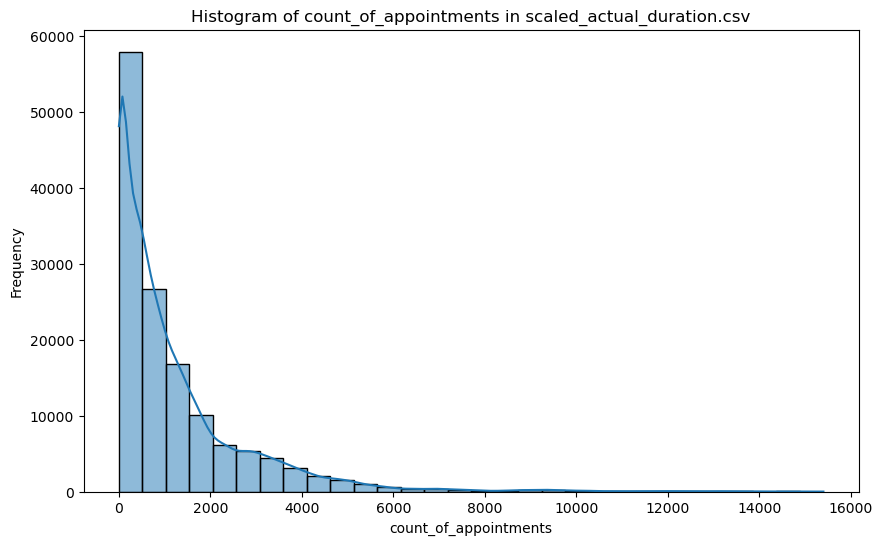

2024-08-12 12:12:17,978 - INFO - Plotting correlation matrix for scaled_actual_duration.csv


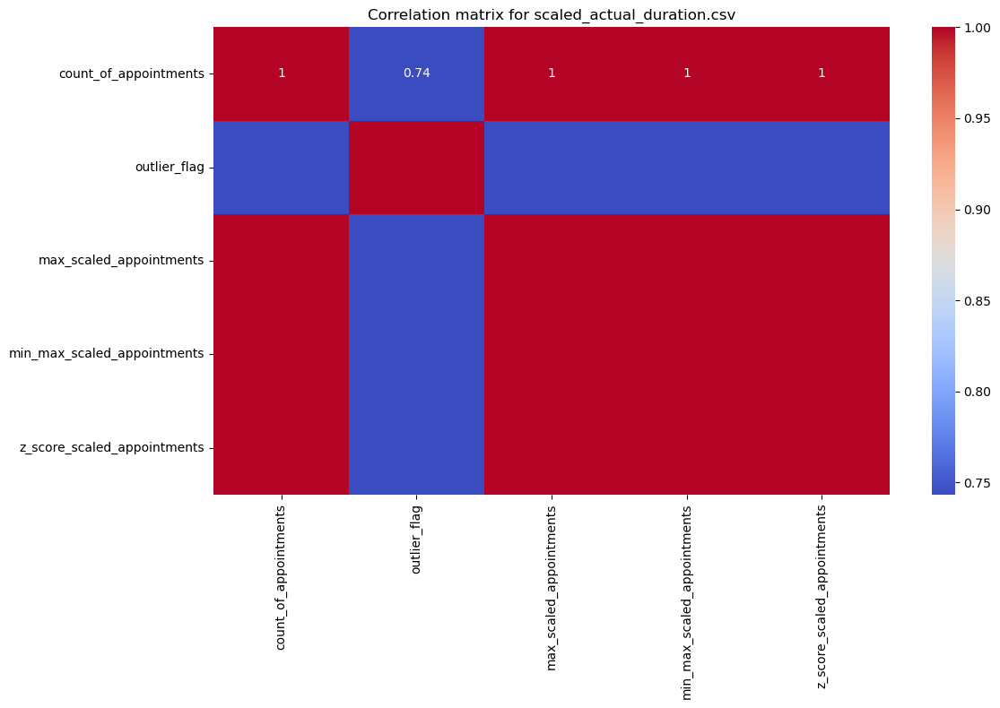

2024-08-12 12:12:18,995 - INFO - Finished plotting correlation matrix for scaled_actual_duration.csv


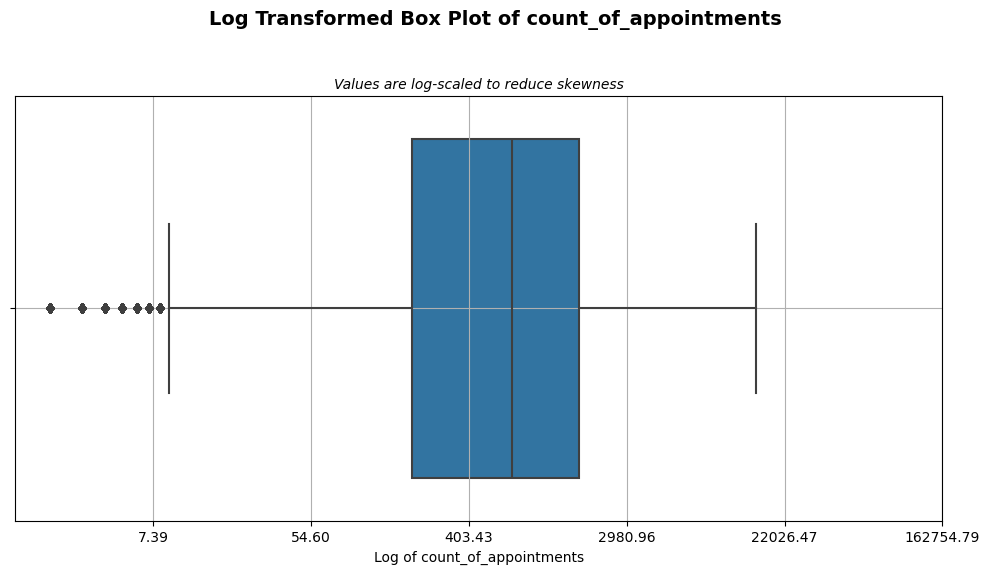

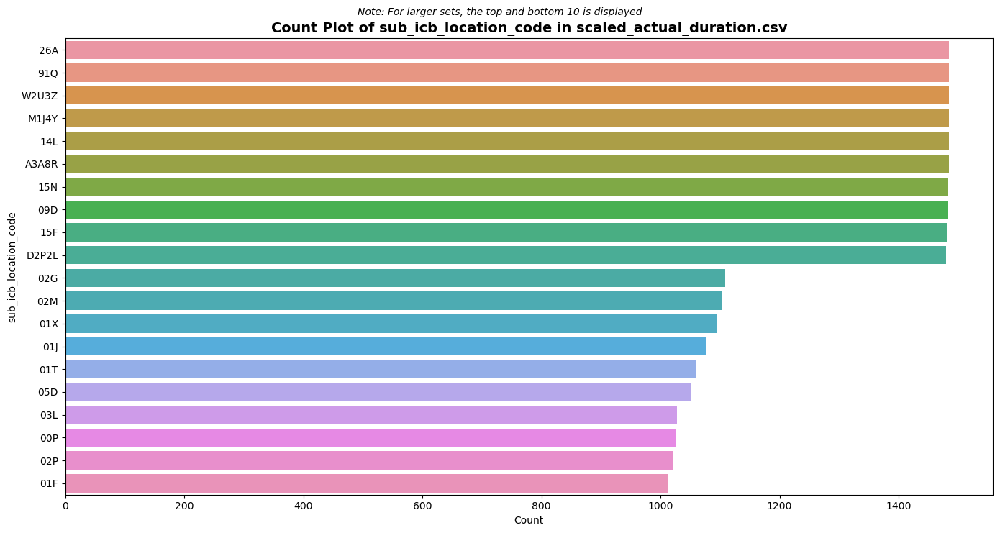

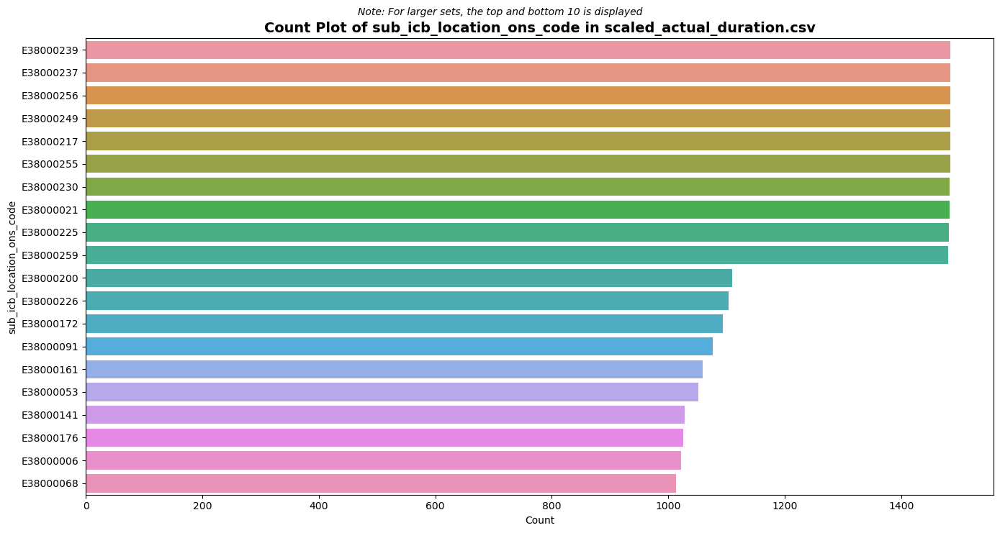

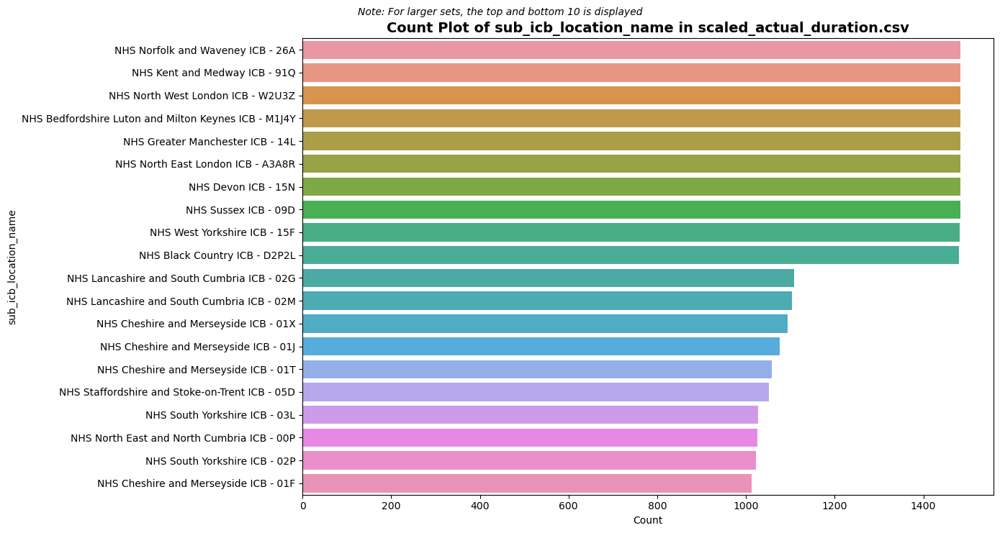

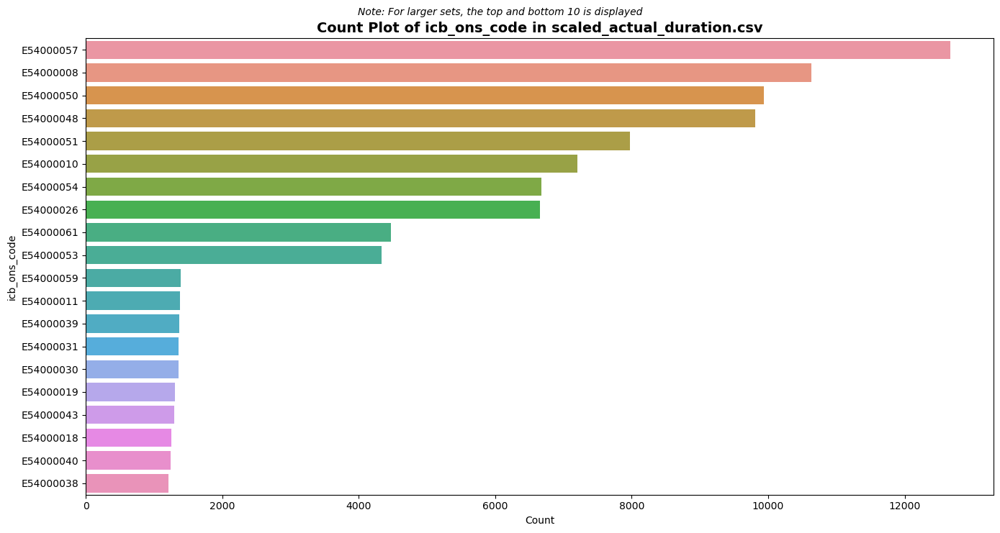

...

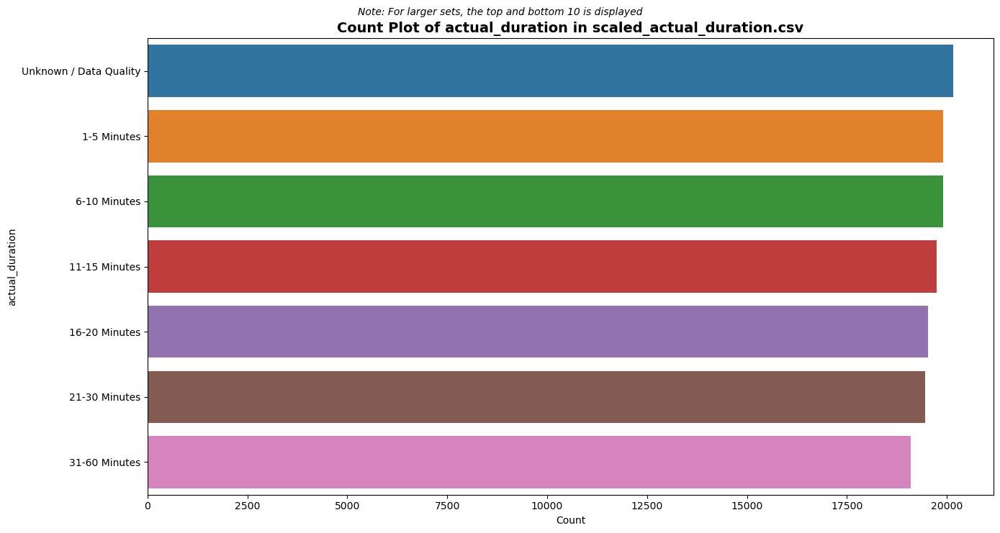

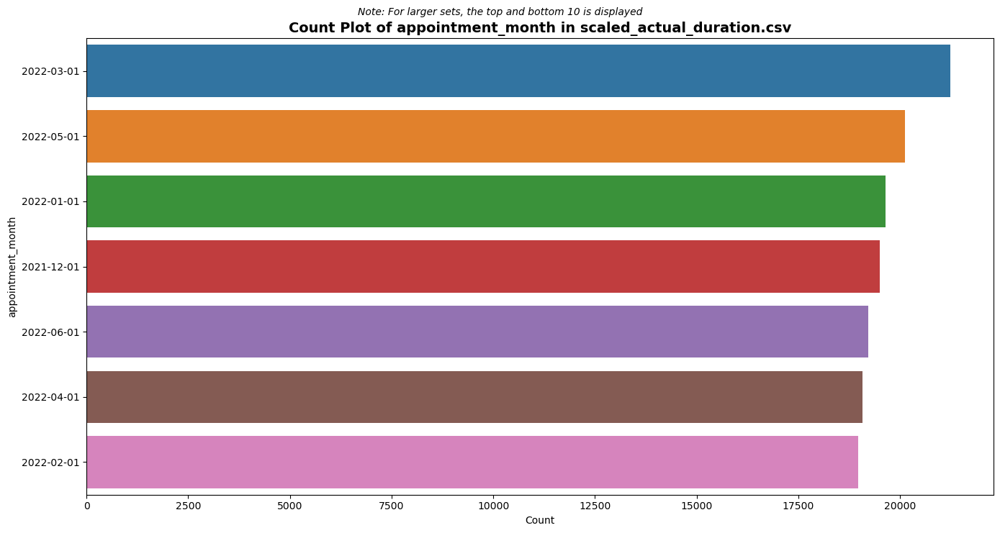

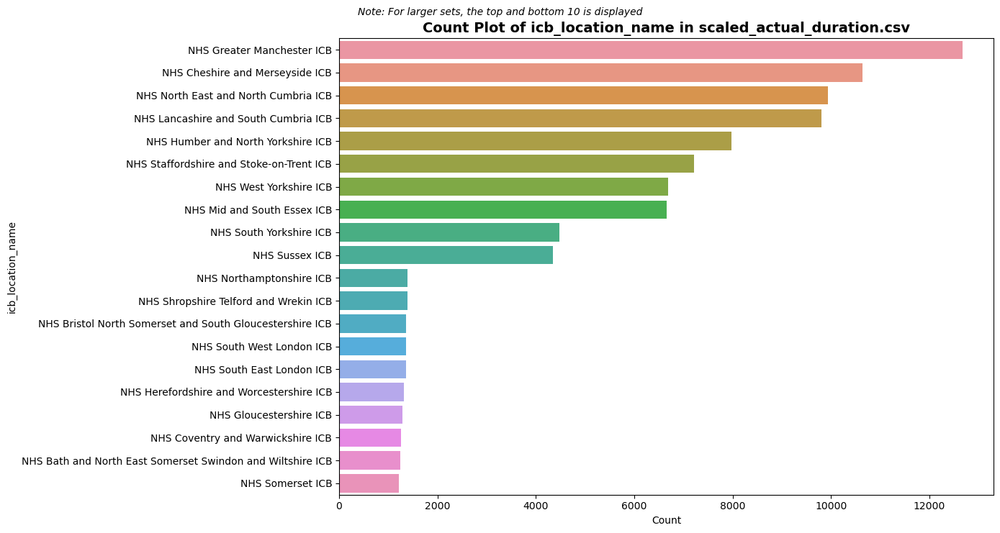

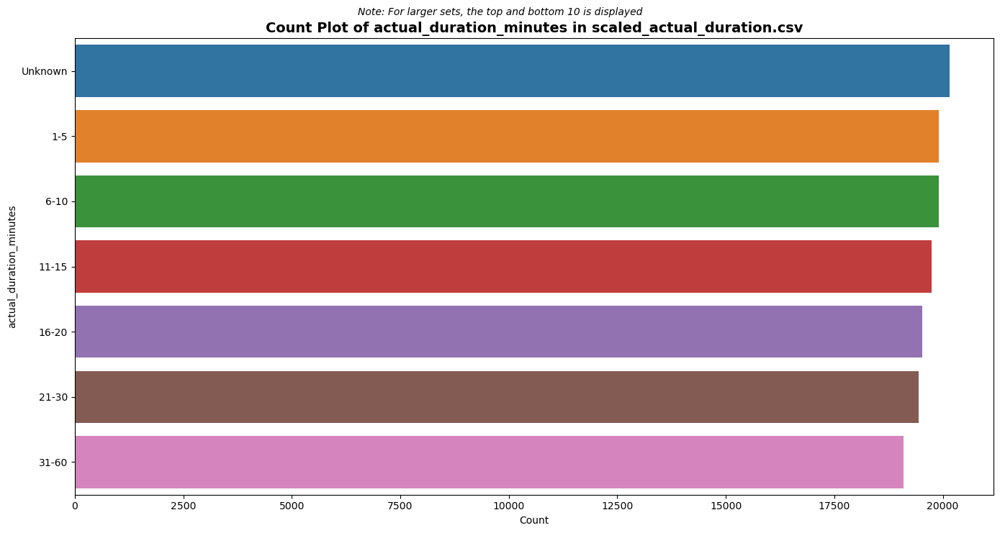

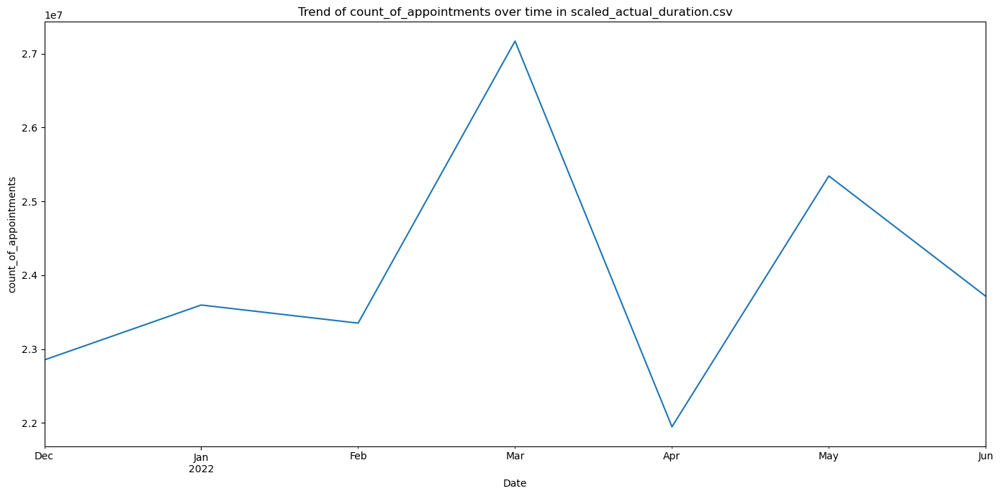

2024-08-12 12:12:33,988 - INFO - Data loaded successfully from scaled_appointments_regional.csv
2024-08-12 12:12:34,004 - INFO - Attempting to plot histogram for count_of_appointments in scaled_appointments_regional.csv


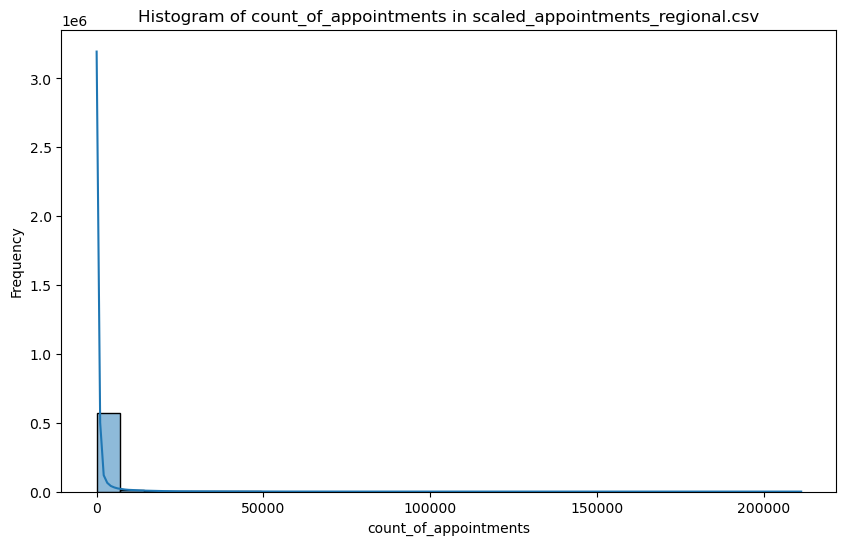

2024-08-12 12:12:49,405 - INFO - Plotting correlation matrix for scaled_appointments_regional.csv


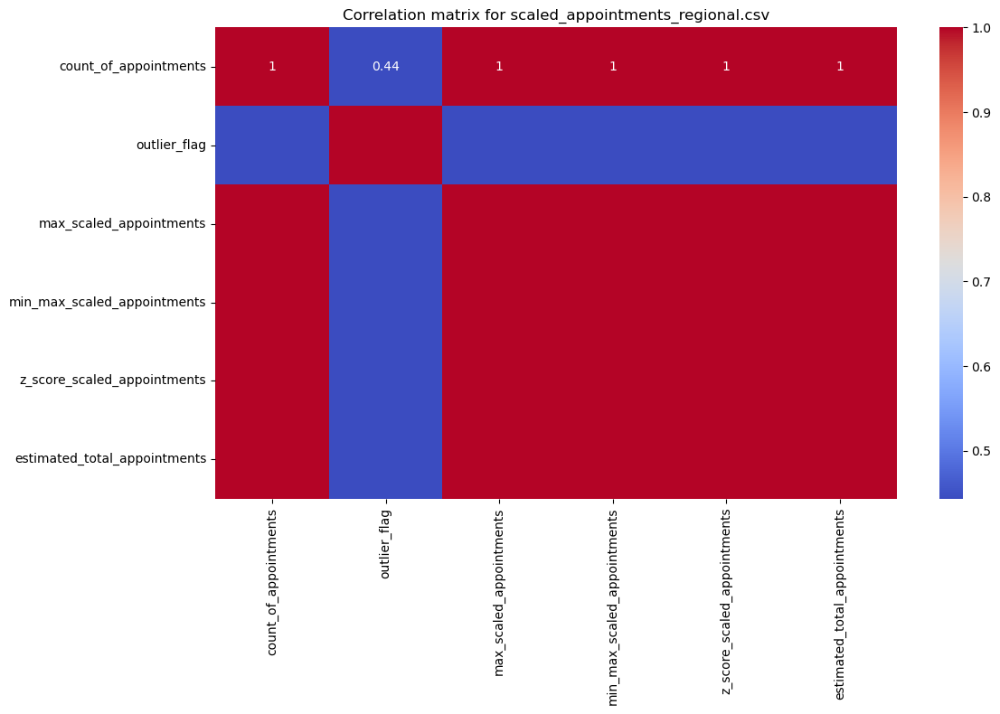

2024-08-12 12:12:50,536 - INFO - Finished plotting correlation matrix for scaled_appointments_regional.csv


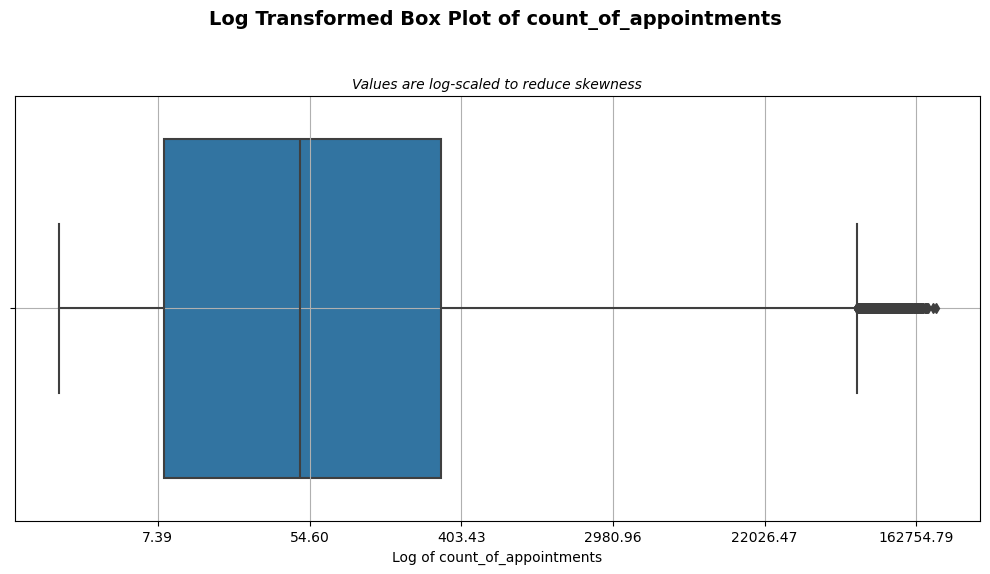

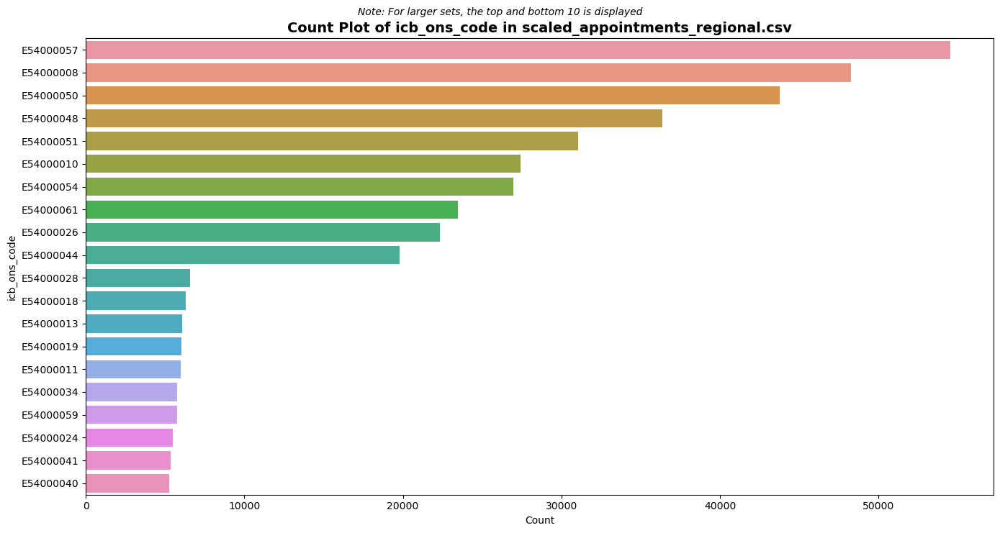

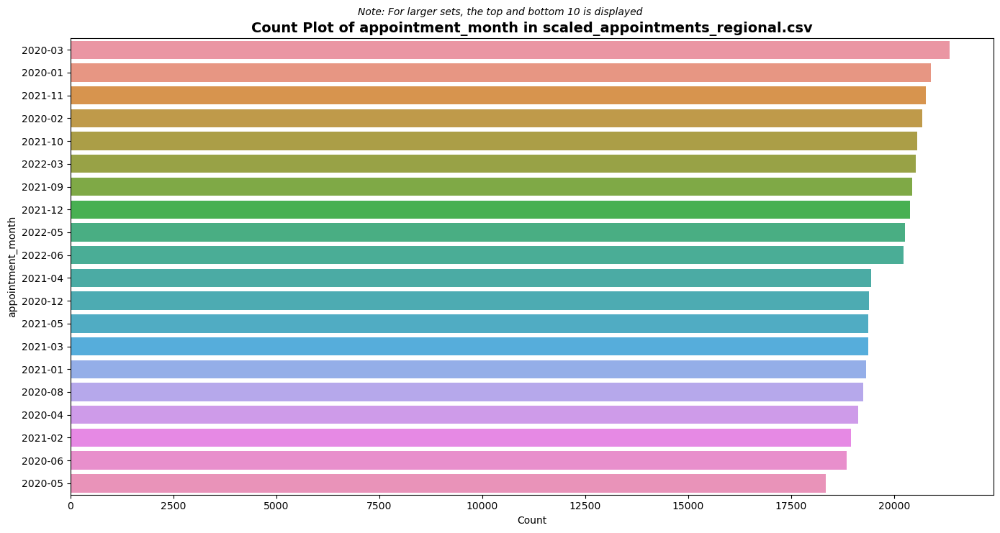

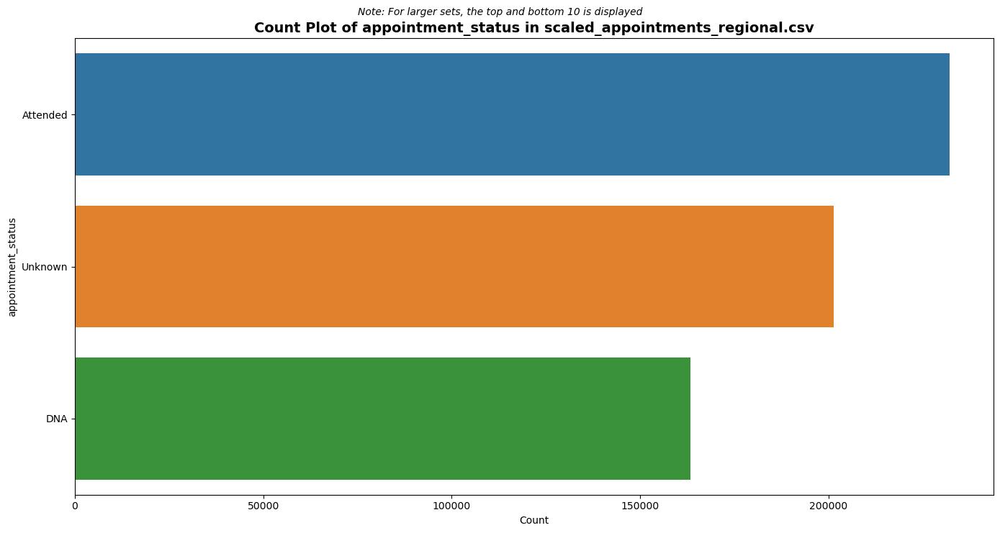

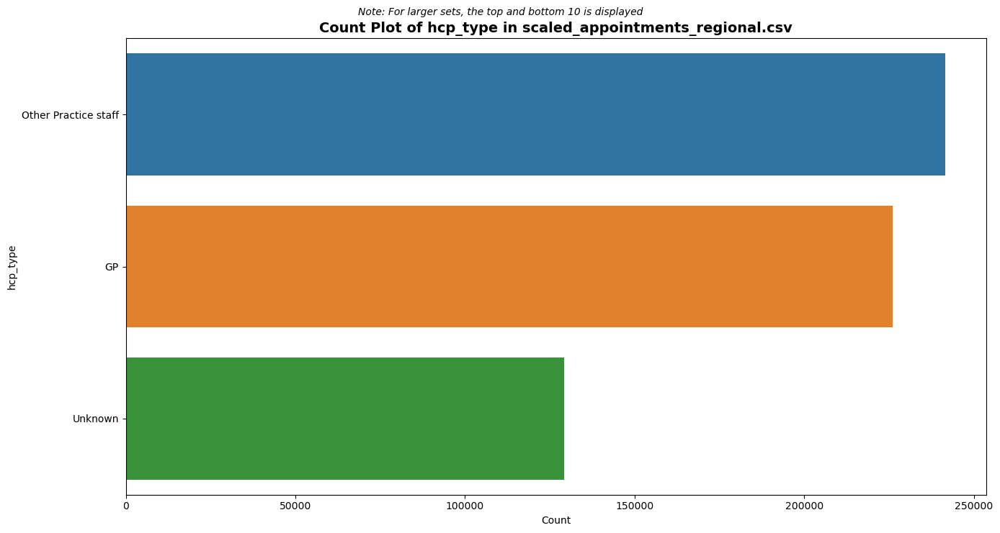

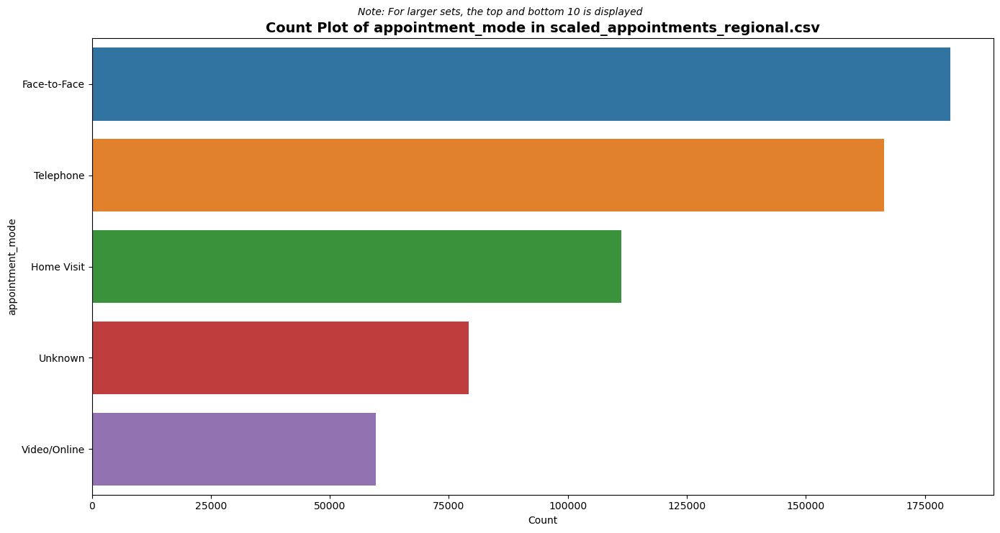

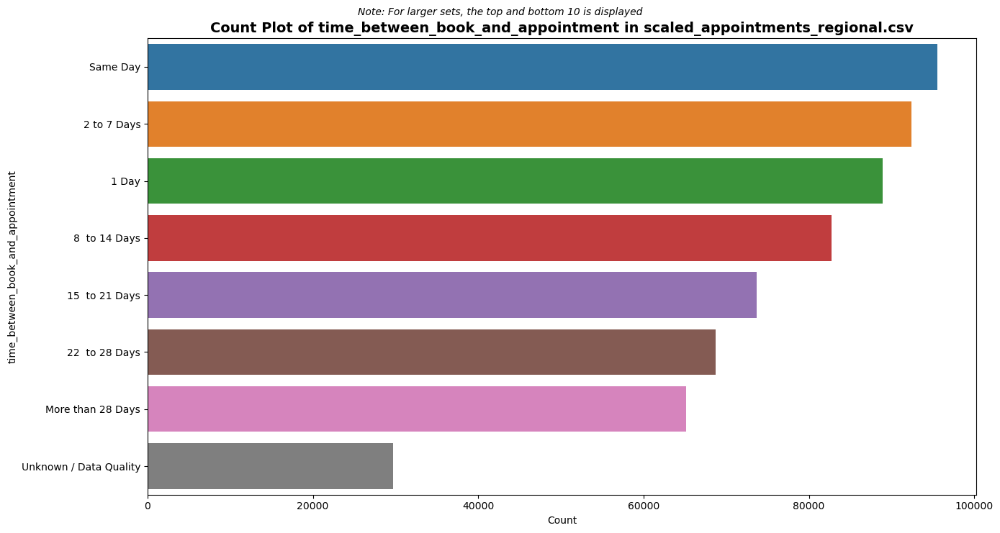

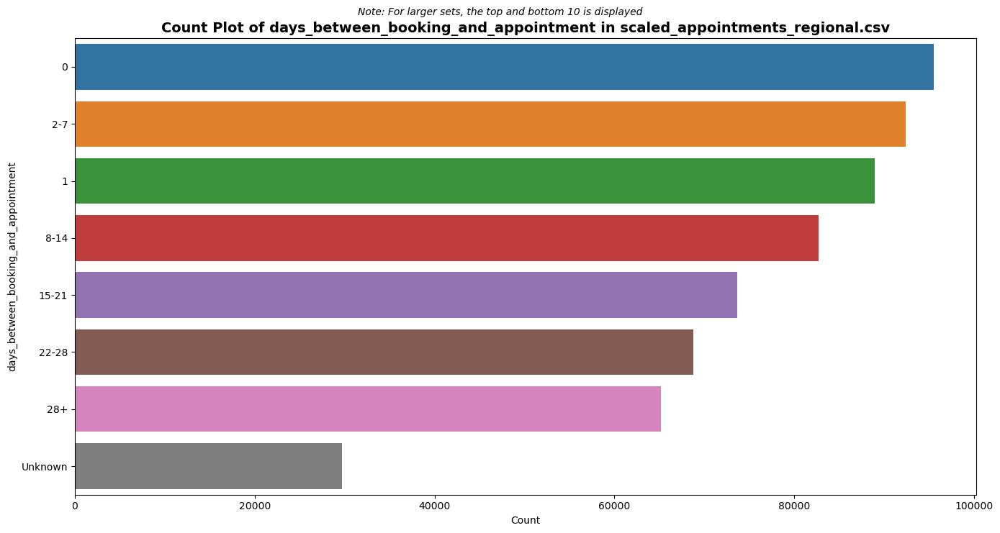

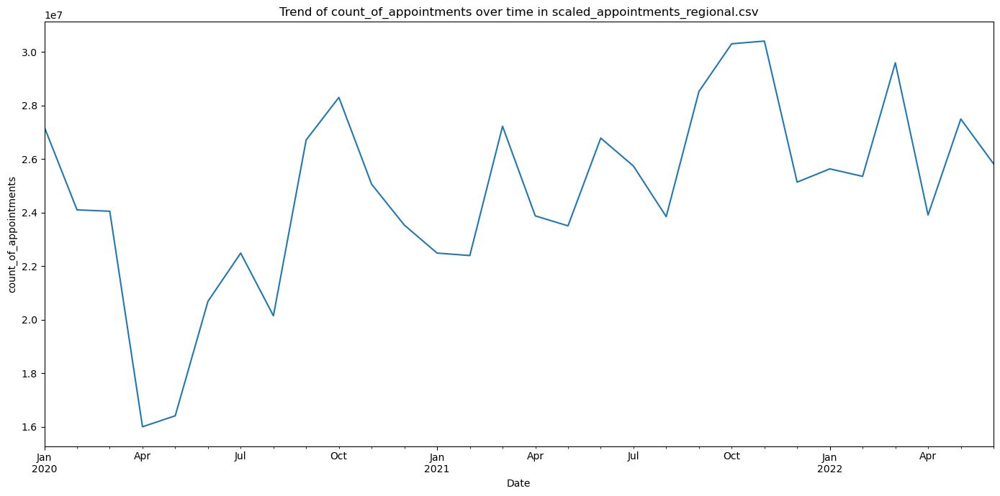

2024-08-12 12:13:07,232 - INFO - Data loaded successfully from scaled_national_categories.csv
2024-08-12 12:13:07,263 - INFO - Attempting to plot histogram for count_of_appointments in scaled_national_categories.csv


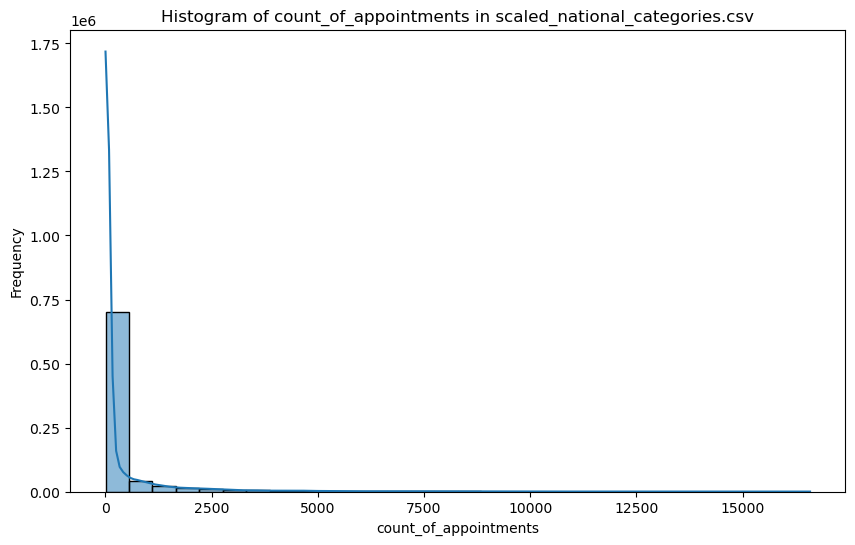

2024-08-12 12:13:28,769 - INFO - Plotting correlation matrix for scaled_national_categories.csv


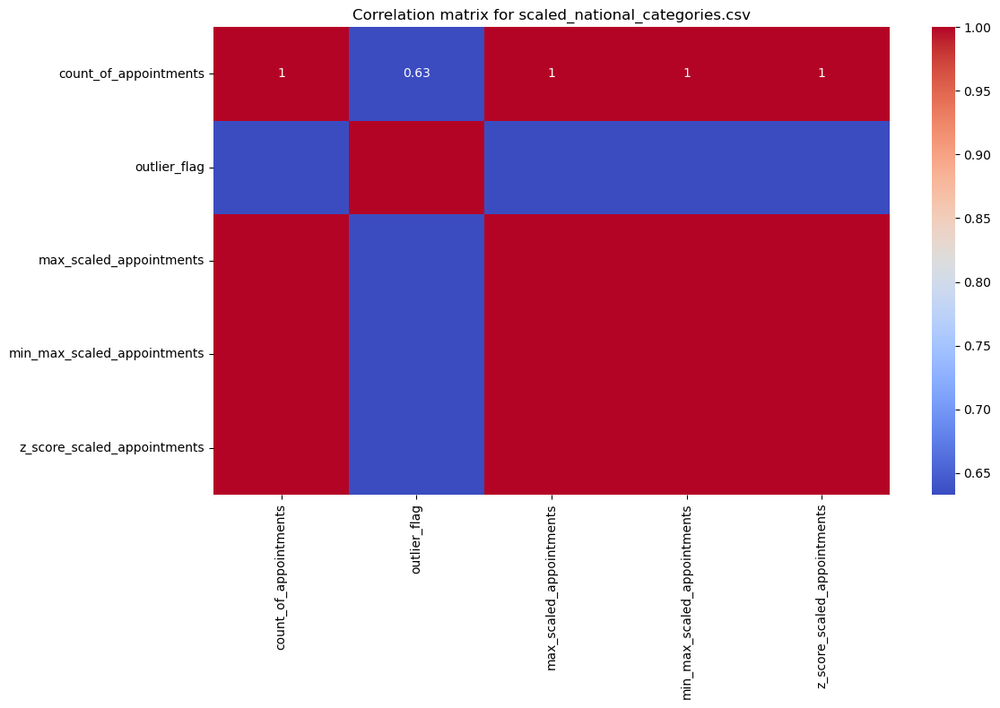

2024-08-12 12:13:30,116 - INFO - Finished plotting correlation matrix for scaled_national_categories.csv


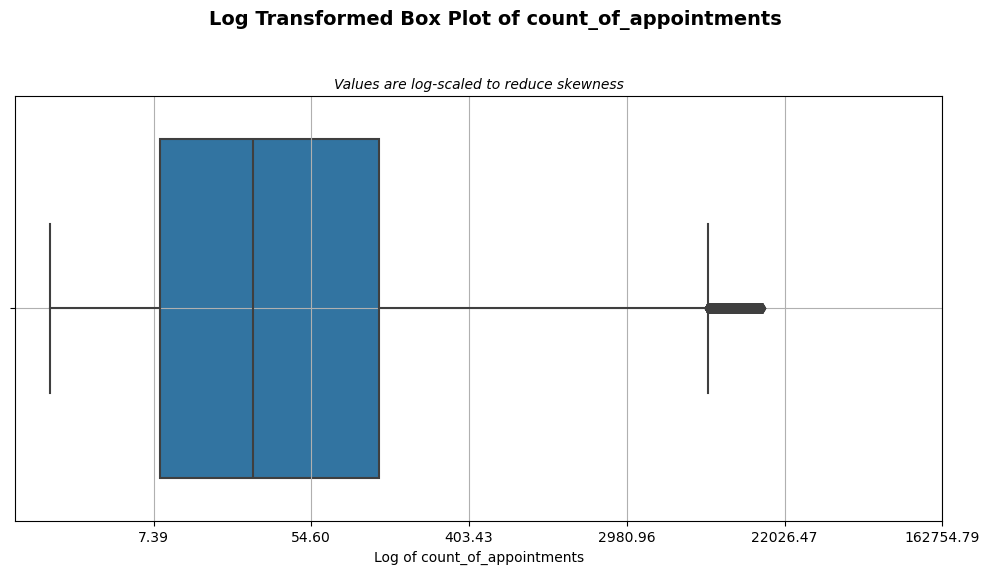

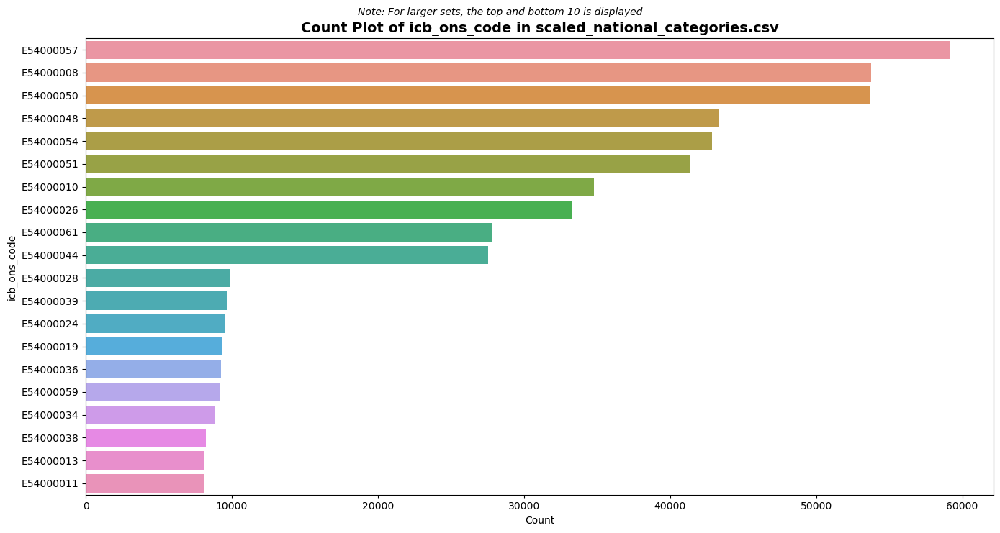

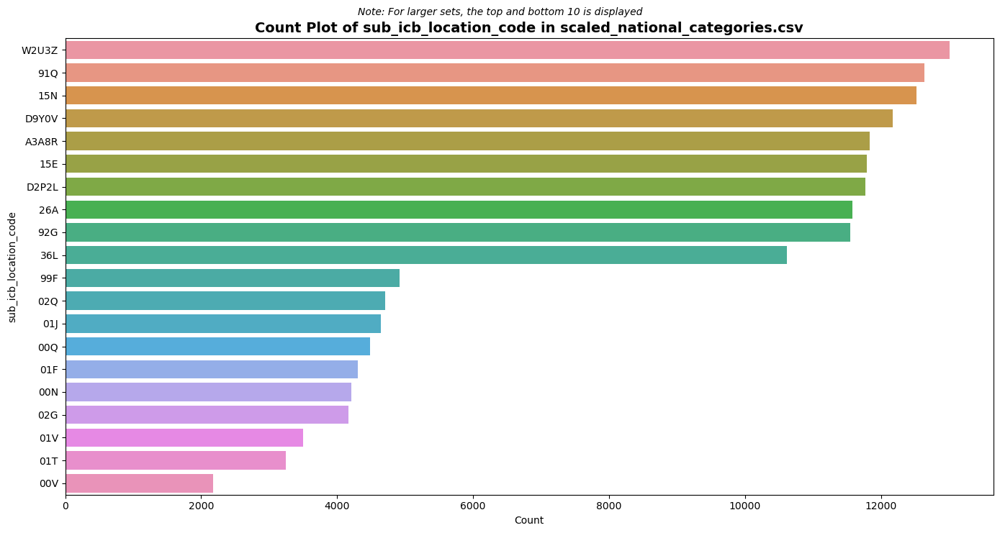

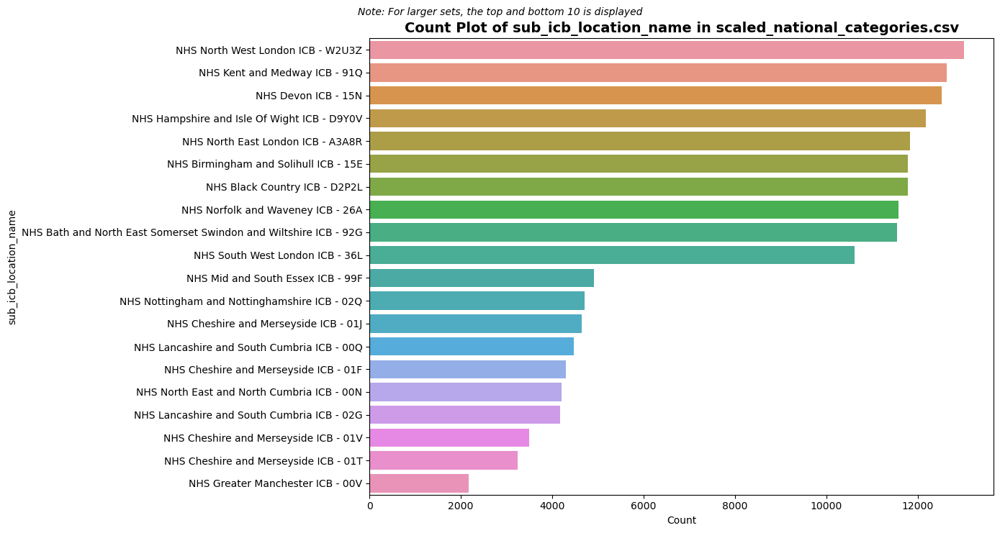

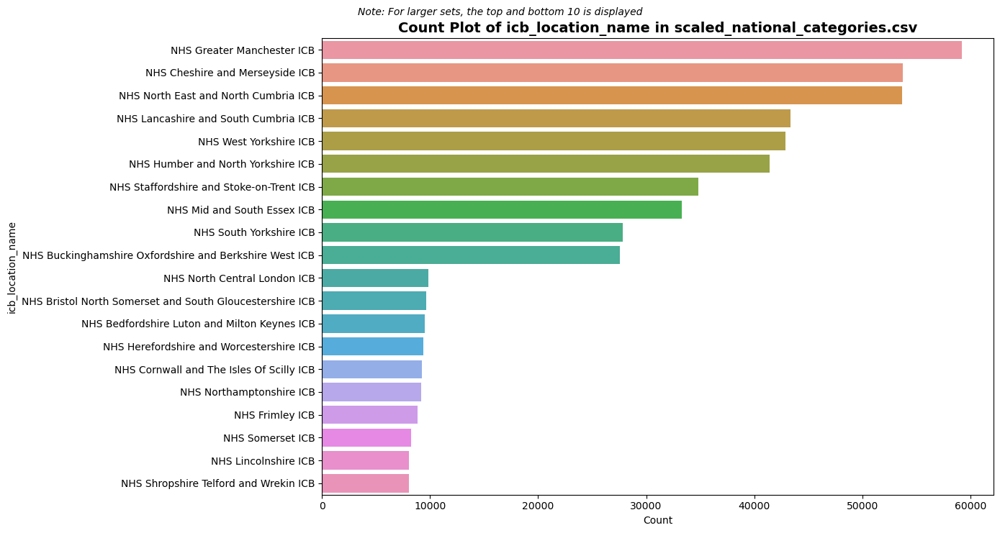

...

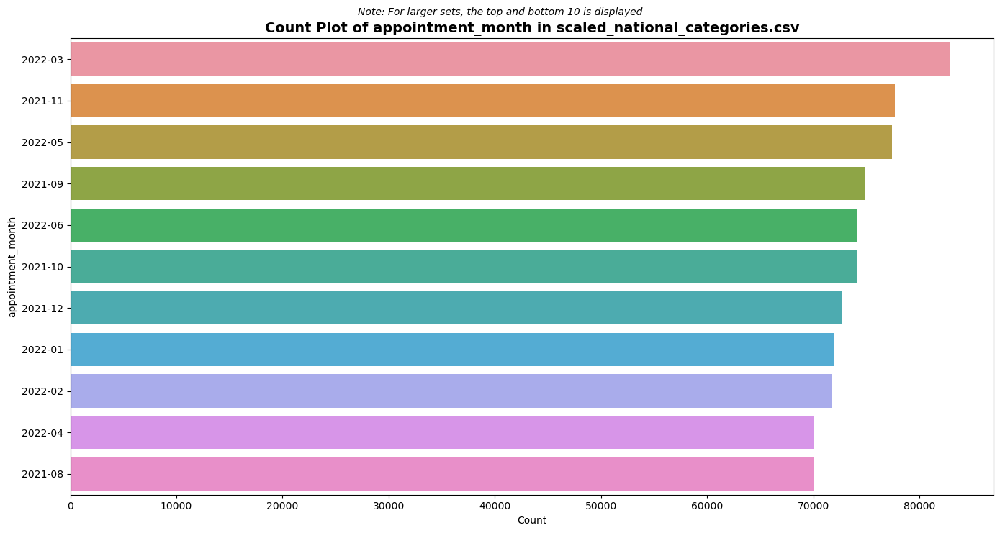

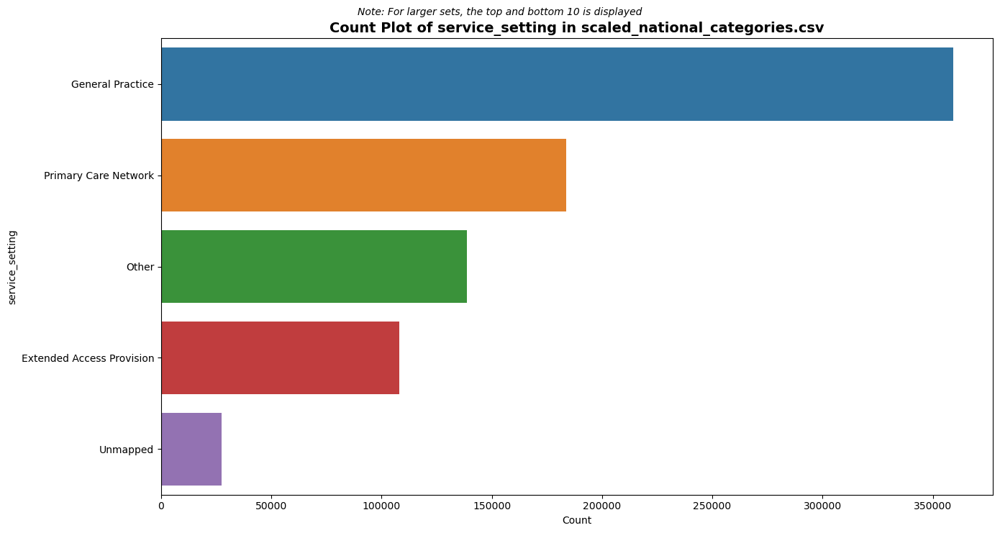

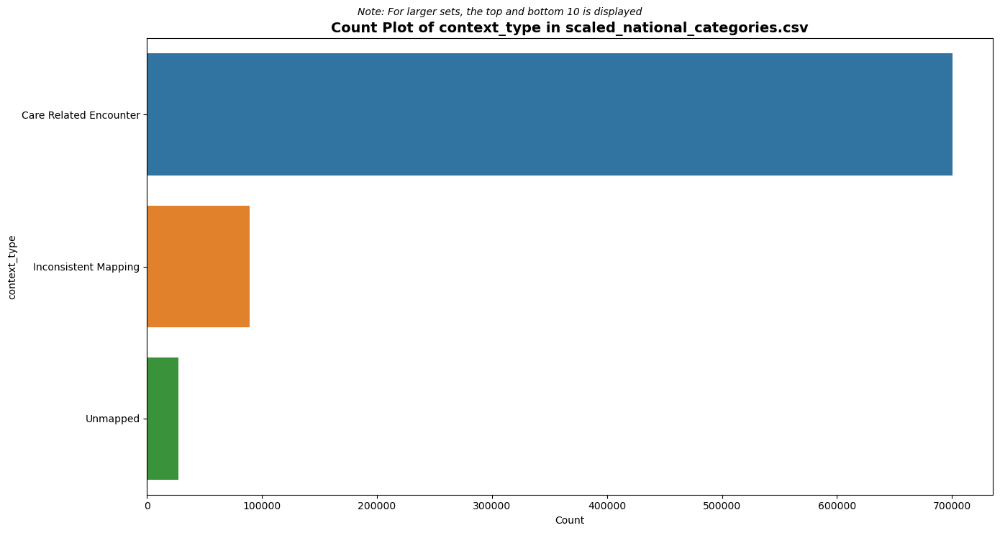

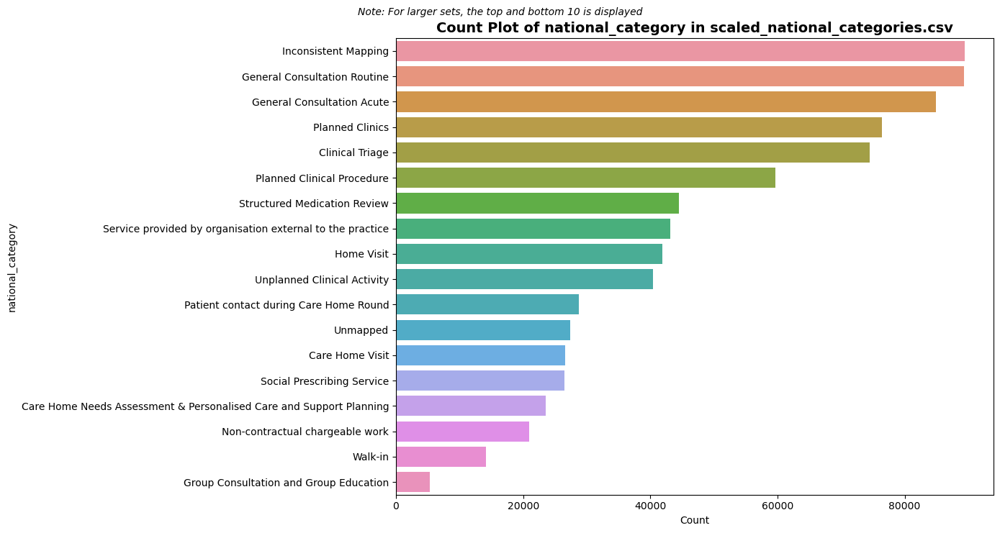

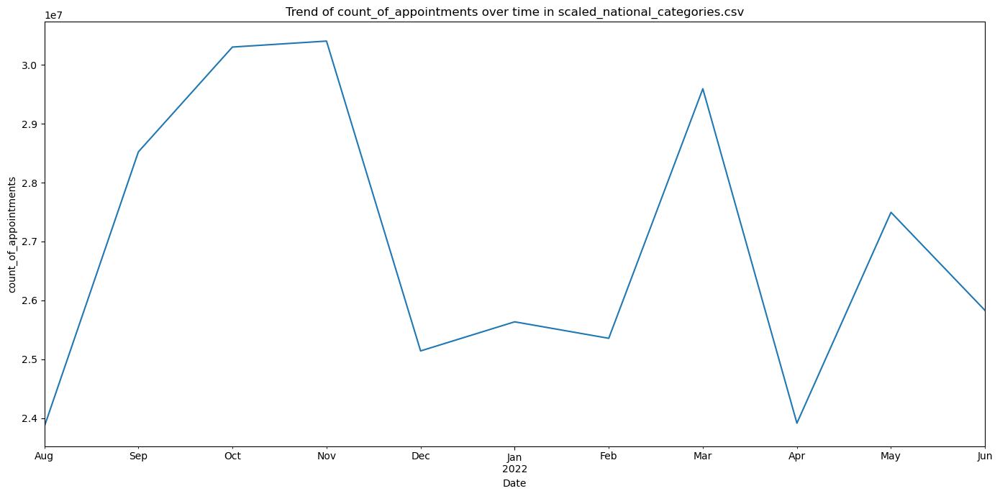

2024-08-12 12:13:48,572 - INFO - Data visualization completed successfully.


In [34]:
# Histogram chart function
def plot_histograms(df, columns, file_name, pdf):
    for column in columns:
        try:
            logging.info(f"Attempting to plot histogram for {column} in {file_name}")
            plt.figure(figsize=(10, 6))
            sns.histplot(df[column], kde=True, bins=30)
            plt.title(f'Histogram of {column} in {file_name}')
            plt.xlabel(column)
            plt.ylabel('Frequency')
            pdf.savefig()
            plt.show()
        except KeyError:
            logging.error(f"{column} not found in DataFrame for {file_name}")
        except Exception as e:
            logging.error(f"Error while plotting histogram for {column} in {file_name}: {str(e)}")

# Function for correlation matrix
def plot_correlation_matrix(df, file_name, pdf):
    try:
        logging.info(f"Plotting correlation matrix for {file_name}")
        plt.figure(figsize=(12, 8))
        numeric_df = df.select_dtypes(include=[np.number])
        correlation_matrix = numeric_df.corr()
        sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
        plt.title(f'Correlation matrix for {file_name}')
        plt.tight_layout()
        pdf.savefig()
        plt.show()
        logging.info(f"Finished plotting correlation matrix for {file_name}")
    except Exception as e:
        logging.exception(f"An error occurred while plotting correlation matrix for {file_name}")

# Function to create countplot visualization
def plot_countplot(df, column, file_name, pdf):
    plt.figure(figsize=(14, 8))
    value_counts = df[column].value_counts()
    if len(value_counts) > 20:
        top_10 = value_counts.nlargest(10)
        bottom_10 = value_counts.nsmallest(10).sort_values(ascending=False)
        value_counts = pd.concat([top_10, bottom_10])

    sns.countplot(y=df[column], order=value_counts.index)
    plt.title(f'Count Plot of {column} in {file_name}', fontsize=14, fontweight='bold')
    plt.suptitle('Note: For larger sets, the top and bottom 10 is displayed',
                 fontsize=10, style='italic', y=0.92)
    plt.xlabel('Count')
    plt.ylabel(column)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    pdf.savefig()
    plt.show()

# Function to create a visualization showing trends over time
def plot_trends_over_time(df, date_column, value_column, file_name, pdf):
    plt.figure(figsize=(14, 7))
    df[date_column] = pd.to_datetime(df[date_column])
    df.set_index(date_column)[value_column].resample('M').sum().plot()
    plt.title(f'Trend of {value_column} over time in {file_name}')
    plt.xlabel('Date')
    plt.ylabel(value_column)
    plt.tight_layout()
    pdf.savefig()
    plt.show()

# Function to plot box plots with log transformation and enhanced annotations
def plot_boxplots(df, column, file_name, pdf):
    plt.figure(figsize=(10, 6))
    try:
        # Apply a logarithmic transformation to data; add a small constant to avoid log(0)
        data = np.log(df[column] + 1)
        sns.boxplot(x=data)
        
        # Main title and subtitle
        plt.suptitle(f'Log Transformed Box Plot of {column}', fontsize=14, fontweight='bold')
        plt.title('Values are log-scaled to reduce skewness', fontsize=10, style='italic')
        
        # Customizing x-axis label to reflect log transformation
        plt.xlabel(f'Log of {column}')
        
        # Adding grid for better readability
        plt.grid(True)
        
        # Add annotations for e2, e4, e6, etc.
        tick_values = [2, 4, 6, 8, 10, 12]
        tick_labels = [f'{np.exp(tick):.2f}' for tick in tick_values]
        plt.xticks(ticks=tick_values, labels=tick_labels)
        
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])  
        # Adjust layout to make sure everything fits without overlap
        pdf.savefig()
        plt.show()

    except Exception as e:
        logging.error(f"Error while plotting box plot for {column} in {file_name}: {str(e)}")

# Main workflow
def main():

    file_names = ['scaled_actual_duration.csv', 'scaled_appointments_regional.csv', 
                  'scaled_national_categories.csv']
    columns_to_plot = ['count_of_appointments']

    with PdfPages('EDA_visualizations.pdf') as pdf:
        try:
            for file_name in file_names:
                df = load_data(file_name)
                if df is not None:
                    plot_histograms(df, columns_to_plot, file_name, pdf)
                    plot_correlation_matrix(df, file_name, pdf)
                    for column in columns_to_plot:
                        plot_boxplots(df, column, file_name, pdf)
                    for column in df.select_dtypes(include=['object', 
                                                            'category']).columns:
                        plot_countplot(df, column, file_name, pdf)
                    if 'appointment_date' in df.columns:
                        plot_trends_over_time(df, 'appointment_date', 
                                              'count_of_appointments', file_name, pdf)
                    elif 'appointment_month' in df.columns:
                        plot_trends_over_time(df, 'appointment_month', 
                                              'count_of_appointments', file_name, pdf)
            logging.info("Data visualization completed successfully.")
        except Exception as e:
            logging.exception("An error occurred during data visualization")

if __name__ == "__main__":
    main()

<a id="Answering-business-questions"></a>
# Answering business questions:

Note: The visualisations for x or y axis labels are annotated with a 1e6 – 1 million, 1e7 – 10 million or 1e8 – 100 million for the values. If you wish to use the exact number add  
plt.ticklabel_format(style='plain', axis='y') snippet to the visualisations. It was felt that the numbers would be difficult to distinguish, therefore the 1e numbers were used in the visualisations.

<a id="Question-1"></a>
#### Question 1: What is the number of locations, service settings, context types, national categories, and appointment statuses in the data sets?

- There are 106 sub-ICB locations represented by the datasets
- There are 42 ICB locations represented by the dataset
- there are 7 national regions within the dataset. This conforms with the NHS information on the ICB structures at  https://cms.nhsbsa.nhs.uk/sicbls-icbs-and-other-providers/organisation-and-prescriber-changes/icbs
- However the region ONS code covers different areas as to NHS Regions, therefore this was addressed later on before further analysis of regional data.

Metric,Count
Sub ICB Locations,106
ICB Locations,42
Regions,7
Service Settings,5
Context Types,3
National Categories,18
Appointment Statuses,3


sub_icb_location_code,icb_location_name,Count
W2U3Z,NHS North West London ICB,13007
91Q,NHS Kent and Medway ICB,12637
15N,NHS Devon ICB,12526
D9Y0V,NHS Hampshire and Isle Of Wight ICB,12171
A3A8R,NHS North East London ICB,11837


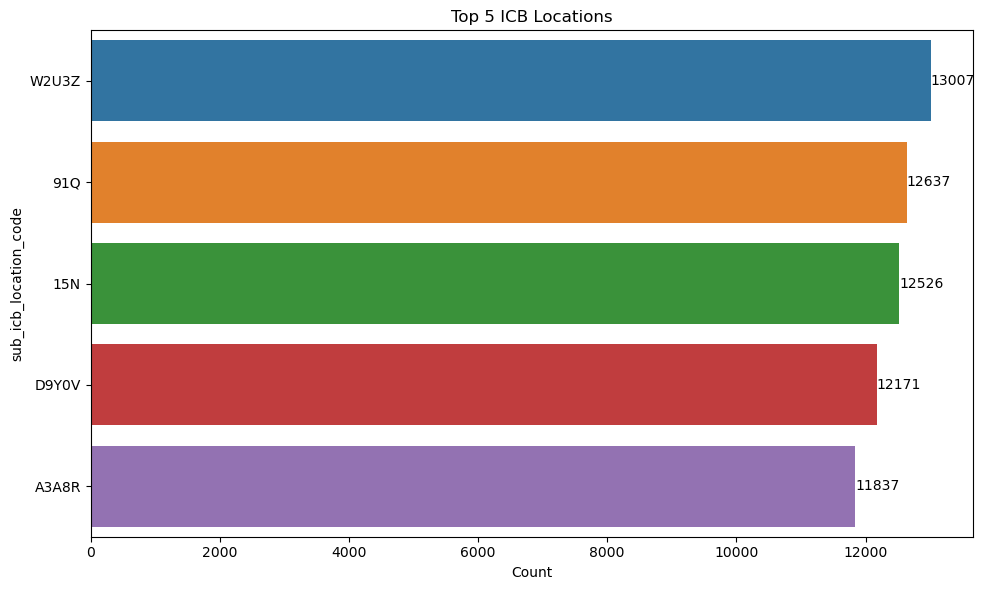

service_setting,Count
General Practice,359274
Primary Care Network,183790
Other,138789
Extended Access Provision,108122
Unmapped,27419


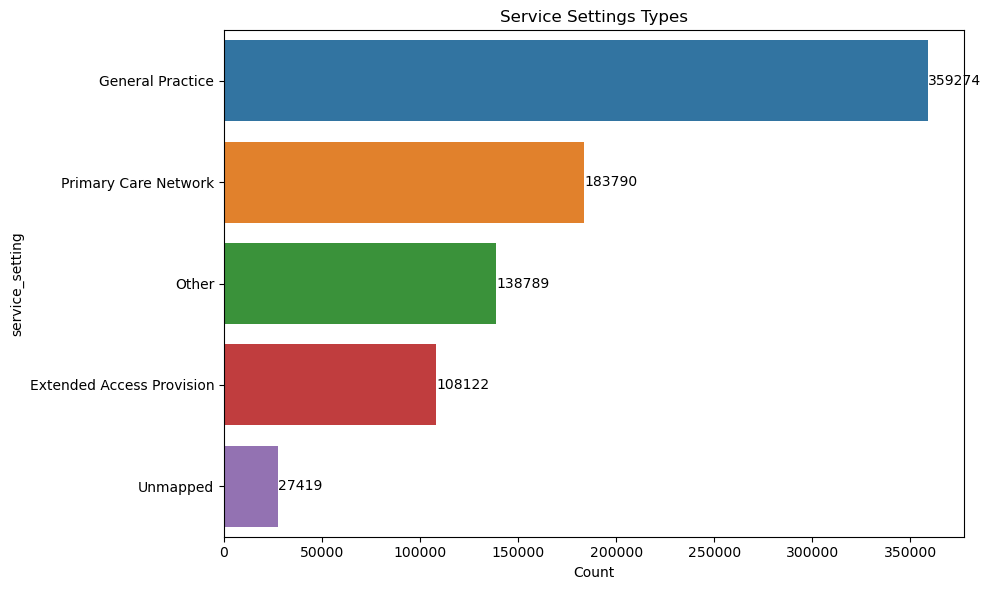

context_type,Count
Care Related Encounter,700481
Inconsistent Mapping,89494
Unmapped,27419


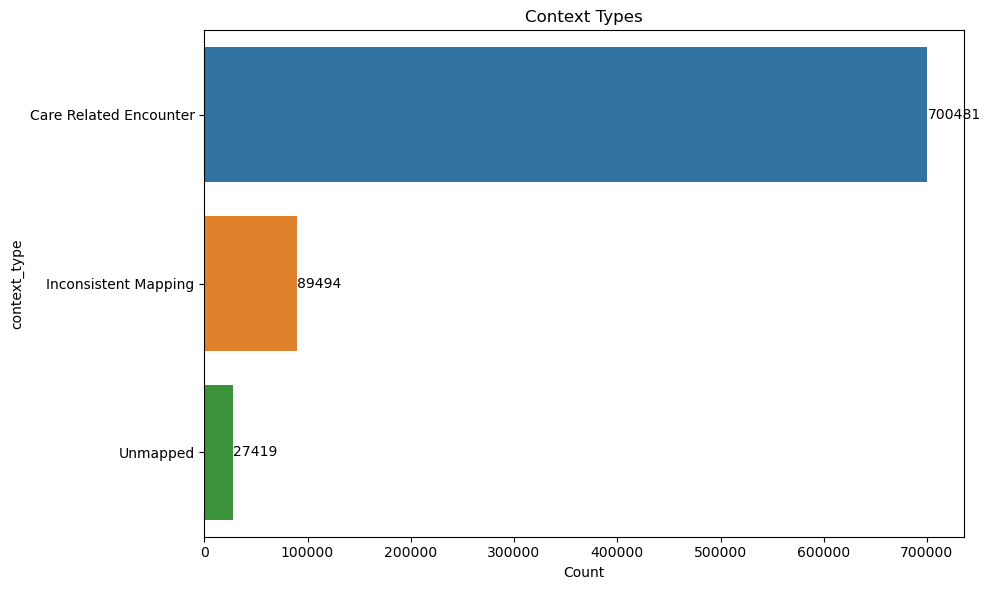

national_category,Count
Inconsistent Mapping,89494
General Consultation Routine,89329
General Consultation Acute,84874
Planned Clinics,76429
Clinical Triage,74539
Planned Clinical Procedure,59631
Structured Medication Review,44467
Service provided by organisation external to the practice,43095
Home Visit,41850
Unplanned Clinical Activity,40415


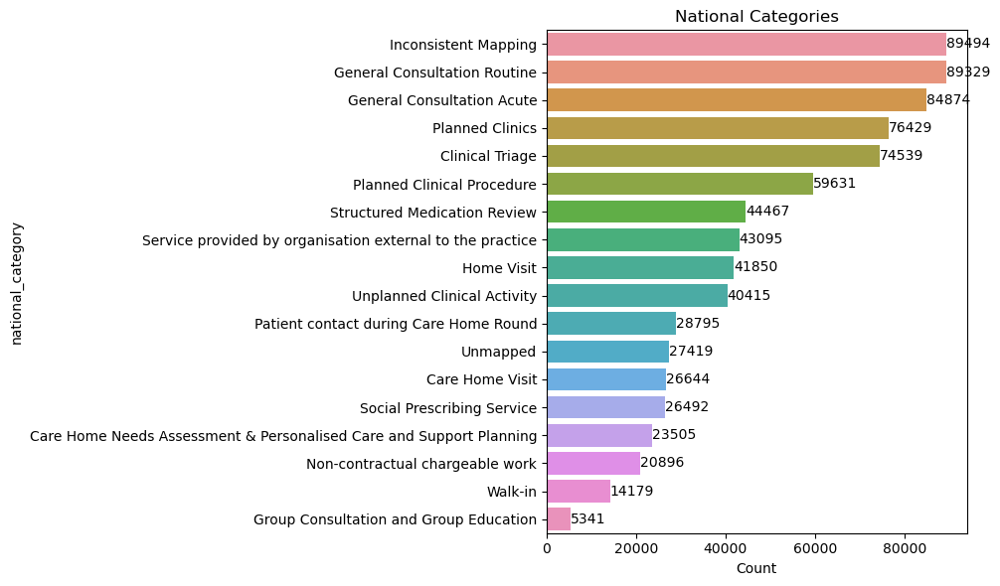

appointment_status,Count
Attended,232137
Unknown,201324
DNA,163360


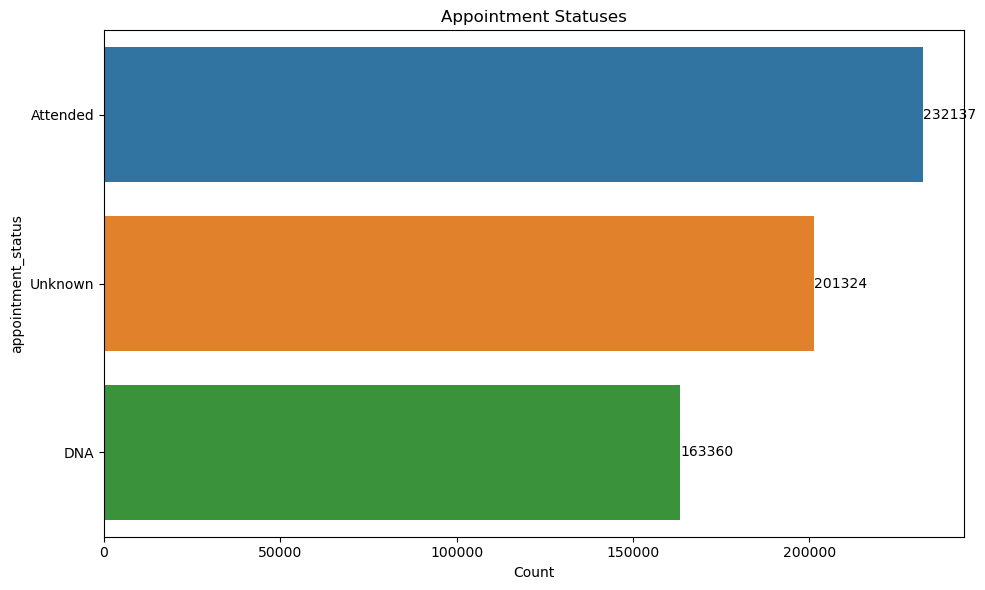

Note: The number of appointments is an estimate based on the percentage of practices included in the data collection.

In [39]:
# Code to answer the number of locations, service settings, context types, \
# national categories, and appointment statuses in the data sets with visualisations
# Load the data
ad = pd.read_csv('scaled_actual_duration.csv')
ar = pd.read_csv('scaled_appointments_regional.csv')
nc = pd.read_csv('scaled_national_categories.csv')

# If you would like to see the results with outliers values removed, 
# load the filtered files.
#ad = pd.read_csv('filtered_actual_duration.csv')
#ar = pd.read_csv('filtered_appointments_regional.csv')
#nc = pd.read_csv('filtered_national_categories.csv')

# Count unique values for each metric
n_sub_icb_locations = nc['sub_icb_location_code'].nunique()
n_icb_location = nc['icb_location_name'].nunique()
n_region = ad['region_ons_code'].nunique()
n_service_settings = nc['service_setting'].nunique()
n_context_types = nc['context_type'].nunique()
n_national_categories = nc['national_category'].nunique()
n_appointment_statuses = ar['appointment_status'].nunique()

# Display counts of unique values in a DataFrame
unique_counts_df = pd.DataFrame({
    'Metric': ['Sub ICB Locations', 'ICB Locations', 'Regions', 'Service Settings', \
               'Context Types', 'National Categories', 'Appointment Statuses'],
    'Count': [n_sub_icb_locations, n_icb_location, n_region, n_service_settings, \
              n_context_types, n_national_categories, n_appointment_statuses]
})

# Display the results in a styled table
styled_unique_counts = unique_counts_df.style.set_properties(**{'text-align': 'left'})
styled_unique_counts = (
    styled_unique_counts.set_table_styles([dict(selector='th', 
                                                props=[('text-align', 'left')])]))
styled_unique_counts = styled_unique_counts.set_caption("Counts of Unique Values")
styled_unique_counts = styled_unique_counts.hide(axis='index')  # Hide the index

display(styled_unique_counts)

# Function to create a styled DataFrame and bar plot for a given metric
# and its unique counts
def create_visualization(df, metric, column, title, top_n=None, additional_column=None):
    unique_counts = df[column].value_counts().reset_index()
    unique_counts.columns = [metric, 'Count']
    
    if top_n is not None:
        unique_counts = unique_counts.head(top_n)
    
    # Add additional column if provided
    if additional_column:
        unique_counts = unique_counts.merge(df[[column, additional_column]].drop_duplicates(), 
                                            left_on=metric, right_on=column)
        unique_counts = unique_counts[[metric, additional_column, 'Count']]
    
    # Display results in a styled table
    styled_results = unique_counts.style.set_properties(**{'text-align': 'left'})
    styled_results = (
        styled_results
        .set_table_styles([dict(selector='th', props=[('text-align', 'left')])]))
    styled_results = styled_results.set_caption(title)
    styled_results = styled_results.hide(axis='index')  # Hide the index
    
    display(styled_results)

    # Visualize results
    plt.figure(figsize=(10, 6))
    sns.barplot(y=metric, x='Count', data=unique_counts)
    plt.title(title)
    
    # Add count labels on top of bars
    for index, row in unique_counts.iterrows():
        plt.text(row['Count'], row.name, row['Count'], color='black', va="center")
        
    plt.tight_layout()
    plt.show()

# Create visualizations for each metric
create_visualization(nc, 'sub_icb_location_code', 'sub_icb_location_code', 
                     'Top 5 ICB Locations', 
                     top_n=5, additional_column='icb_location_name')
create_visualization(nc, 'service_setting', 
                     'service_setting', 'Service Settings Types')
create_visualization(nc, 'context_type',
                     'context_type', 'Context Types')
create_visualization(nc, 'national_category', 
                     'national_category', 'National Categories')
create_visualization(ar, 'appointment_status', 
                     'appointment_status', 'Appointment Statuses')

# Adding a note about estimation in visualizations
note = "Note: The number of appointments is an estimate based on the percentage of practices included in the data collection."
display(Markdown(note))

Results: 
- The top 5 sub ICB locations per occurrence are in NHS North West London ICB, NHS Kent and Medway ICB, 	NHS Devon ICB,	NHS Hampshire and Isle Of Wight , NHS North East London (When the outliers are considered the results are: (NHS Kent and Medway ICB, 	NHS Devon ICB, NHS North East London ICB, NHS Black Country ICB, NHS Hampshire and Isle Of Wight ICB	
The top service setting is General Practice (the same when outlier and duplicated values are excluded)
- The highest context type is Care related encounter (the same when outlier values are excluded),
- The highest national categories are Inconsistent Mapping, 
General Consultation routine followed by general consultation acute  (the same when outlied values are excluded)u
- For appointment sttus attended is the highest level. (unknown if outlier values are excluded),

<a id="Question-2"></a>
#### Question 2: What is the date range of the provided data sets, and which service settings reported the most appointments for a specific period?

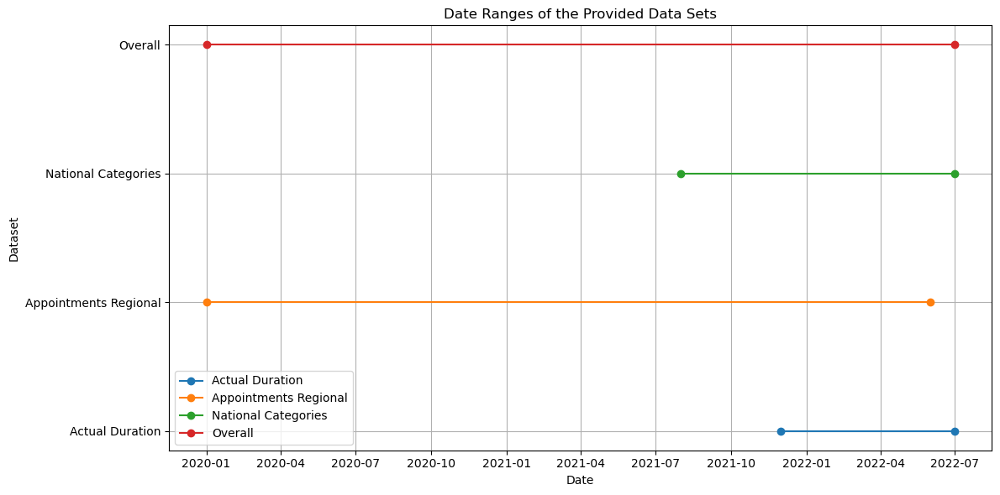

In [42]:
# Visualise the date ranges in the data
# Load the cleaned data
ad = pd.read_csv('scaled_actual_duration.csv')
ar = pd.read_csv('scaled_appointments_regional.csv')
nc = pd.read_csv('scaled_national_categories.csv')

# Convert date columns to datetime
ad['appointment_date'] = pd.to_datetime(ad['appointment_date'])
ar['appointment_month'] = pd.to_datetime(ar['appointment_month'], format='%Y-%m')
nc['appointment_date'] = pd.to_datetime(nc['appointment_date'])

# Get the date ranges for each dataset
ad_date_range = (ad['appointment_date'].min(), ad['appointment_date'].max())
ar_date_range = (ar['appointment_month'].min(), ar['appointment_month'].max())
nc_date_range = (nc['appointment_date'].min(), nc['appointment_date'].max())

# Combine the date ranges to find the overall date range
overall_start_date = min(ad_date_range[0], ar_date_range[0], nc_date_range[0])
overall_end_date = max(ad_date_range[1], ar_date_range[1], nc_date_range[1])

# Create a DataFrame for the date ranges
date_ranges = pd.DataFrame({
    'Dataset': ['Actual Duration', 'Appointments Regional', 
                'National Categories', 'Overall'],
    'Start Date': [ad_date_range[0], ar_date_range[0], 
                   nc_date_range[0], overall_start_date],
    'End Date': [ad_date_range[1], ar_date_range[1],
                 nc_date_range[1], overall_end_date]
})

# Visualize the date ranges
plt.figure(figsize=(12, 6))
for idx, row in date_ranges.iterrows():
    plt.plot([row['Start Date'], row['End Date']], [idx, idx],
             marker='o', label=row['Dataset'])

plt.yticks(range(len(date_ranges)), date_ranges['Dataset'])
plt.title('Date Ranges of the Provided Data Sets')
plt.xlabel('Date')
plt.ylabel('Dataset')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig('date_ranges.png')
plt.show()

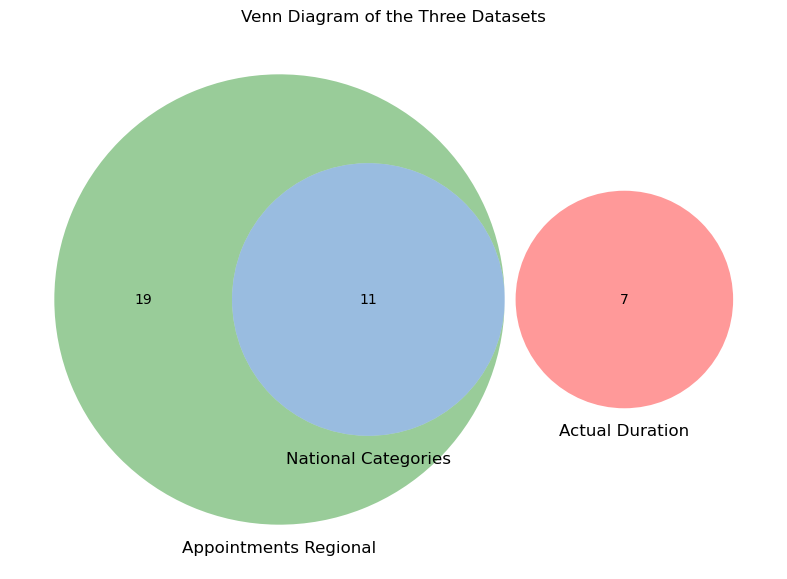

In [43]:
# Venn diagram representation of the 3 datasets on apointment_month
# Load the datasets
ad = pd.read_csv('scaled_actual_duration.csv')
ar = pd.read_csv('scaled_appointments_regional.csv')
nc = pd.read_csv('scaled_national_categories.csv')

# Convert the appointment_month columns to sets
ad_set = set(ad['appointment_month'])
ar_set = set(ar['appointment_month'])
nc_set = set(nc['appointment_month'])

# Plot the Venn diagram
plt.figure(figsize=(10, 7))
venn = venn3([ad_set, ar_set, nc_set], ('Actual Duration', 
                                        'Appointments Regional', 'National Categories'))
plt.title('Venn Diagram of the Three Datasets')
plt.savefig('Venn_diagram.png')
plt.show()

Results: 
Ar represents the 30 month reporting period, nc covers 11 months data, whilst ad covers only 7 months.

Dataset,Start Date,End Date
actual_duration.csv,01/12/2021,30/06/2022
appointments_regional.csv,2020/01,2022/06
national_categories.csv,01/08/2021,30/06/2022


service_setting,count_of_appointments
General Practice,270811691
Unmapped,11080810
Primary Care Network,6557386
Other,5420076
Extended Access Provision,2176807


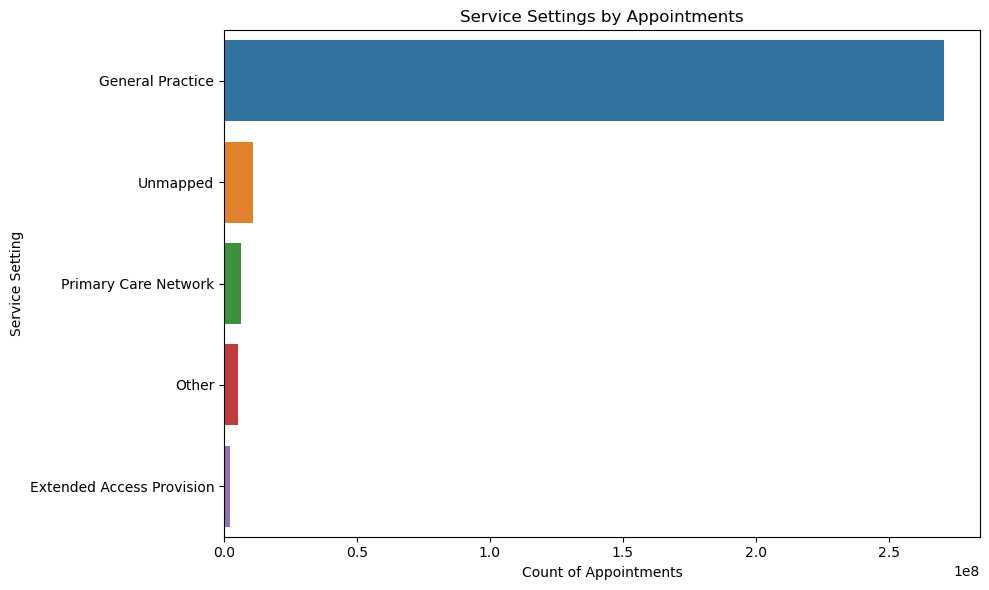

service_setting,count_of_appointments
General Practice,4804239


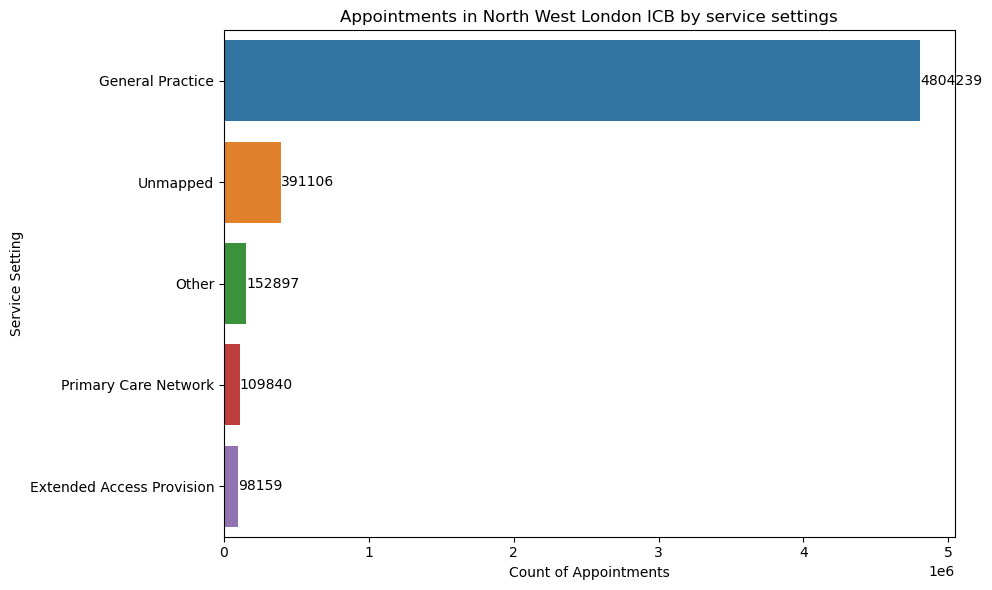

Note: The number of appointments is an estimate based on the percentage of practices included in the data collection.

In [45]:
# Identify which service settings reported the most appointments? \
# Identify the most popular service setting for NHS North West London 
# from 1 January to 1 June 

# Load the data
ad = pd.read_csv('scaled_actual_duration.csv')
ar = pd.read_csv('scaled_appointments_regional.csv')
nc = pd.read_csv('scaled_national_categories.csv')

# If you would like to see the results with outliers values removed, 
# load the filtered files.
#ad = pd.read_csv('filtered_actual_duration.csv')
#ar = pd.read_csv('filtered_appointments_regional.csv')
#nc = pd.read_csv('filtered_national_categories.csv')

# Convert date columns to datetime
ad['appointment_date'] = pd.to_datetime(ad['appointment_date'])
ar['appointment_month'] = pd.to_datetime(ar['appointment_month'])
nc['appointment_date'] = pd.to_datetime(nc['appointment_date'])

# Sub-question 1: Display the date range of the dataset
ad_date_range = (ad['appointment_date'].min().strftime('%d/%m/%Y'), ad['appointment_date'].max().strftime('%d/%m/%Y'))
ar_date_range = (ar['appointment_month'].min().strftime('%Y/%m'), ar['appointment_month'].max().strftime('%Y/%m'))
nc_date_range = (nc['appointment_date'].min().strftime('%d/%m/%Y'), nc['appointment_date'].max().strftime('%d/%m/%Y'))

# Create a DataFrame to display the date ranges
date_ranges = pd.DataFrame({
    'Dataset': ['actual_duration.csv', 'appointments_regional.csv',
                'national_categories.csv'],
    'Start Date': [ad_date_range[0], ar_date_range[0], nc_date_range[0]],
    'End Date': [ad_date_range[1], ar_date_range[1], nc_date_range[1]]
})

# Display the date ranges in a styled table
styled_date_ranges = date_ranges.style.set_properties(**{'text-align': 'left'})
styled_date_ranges = (
    styled_date_ranges
    .set_table_styles([dict(selector='th', props=[('text-align', 'left')])]))
styled_date_ranges = (
    styled_date_ranges.set_caption("\nDate Ranges for Each Dataset"))

# Display the styled DataFrame without the index
display(HTML(styled_date_ranges.hide(axis='index').to_html()))

# Sub-question 2: Identify which service settings reported the most appointments

# Group by service_setting and sum the count_of_appointments for the given
# period in nc dataset
top_service_settings = (
    nc.groupby('service_setting')['count_of_appointments']
    .sum().nlargest(5).reset_index())

# Display the top service settings in a styled table without the index
styled_top_service_settings = (
    top_service_settings.style.set_properties(**{'text-align': 'left'}))
styled_top_service_settings = (
    styled_top_service_settings
    .set_table_styles([dict(selector='th', props=[('text-align', 'left')])]))
styled_top_service_settings = (
    styled_top_service_settings
    .set_caption("\n\n Top Service Settings with the Most Appointments"))

# Display the styled DataFrame without the index
display(HTML(styled_top_service_settings.hide(axis='index').to_html()))

# Visualize the top service settings
plt.figure(figsize=(10, 6))
sns.barplot(y='service_setting', x='count_of_appointments', data=top_service_settings)
plt.title('Service Settings by Appointments')
plt.xlabel('Count of Appointments')
plt.ylabel('Service Setting')
plt.tight_layout()
plt.show()

# Sub-question 3: Identify the most popular service setting for NHS North West London from 1 January to 1 June 2022
# Filter the dataset for NHS North West London and the specified date range
nwl_data = nc[(nc['sub_icb_location_name'] == 'NHS North West London ICB - W2U3Z') & 
              (nc['appointment_date'] >= '2022-01-01') & 
              (nc['appointment_date'] <= '2022-06-01')]

# Check if there is any data after filtering
if not nwl_data.empty:
    # Group by service_setting and sum the count_of_appointments
    popular_service_setting_nwl = (
        nwl_data.groupby('service_setting')['count_of_appointments']
        .sum().nlargest(1).reset_index())

    # Display the most popular service setting in a styled table without the index
    styled_popular_service_setting_nwl = (
        popular_service_setting_nwl.style.set_properties(**{'text-align': 'left'}))
    styled_popular_service_setting_nwl = (
        styled_popular_service_setting_nwl
        .set_table_styles([dict(selector='th', props=[('text-align', 'left')])]))
    styled_popular_service_setting_nwl = (
        styled_popular_service_setting_nwl
        .set_caption("\nMost Popular Service Setting for NHS North West London' (1 Jan 2022 - 1 Jun 2022)"))

    # Convert the styled DataFrame to HTML
    styled_html_popular_service_nwl = styled_popular_service_setting_nwl.to_html()

    # Display the styled DataFrame without the index
    display(HTML(styled_popular_service_setting_nwl.hide(axis='index').to_html()))

else:
    print("No data available for NHS North West London from 1 January to 1 June 2022.")

# Visualize the top service settings within the NWL ICB
plt.figure(figsize=(10, 6))
ax = sns.barplot(
    y='service_setting', x='count_of_appointments', data=nwl_data
    .groupby('service_setting')['count_of_appointments']
    .sum().reset_index().sort_values('count_of_appointments', ascending=False))
plt.title('Appointments in North West London ICB by service settings')
plt.xlabel('Count of Appointments')
plt.ylabel('Service Setting')

# Add the counts on top of the bars
for i in ax.containers:
    ax.bar_label(i, fmt='%d')

plt.tight_layout()
plt.show()

# Adding a note about estimation in visualizations
note = "Note: The number of appointments is an estimate based on the percentage of practices included in the data collection."
display(Markdown(note))

Results: 
- General Practice has the highest appointments (regardless of duplicate/outlier values)
- For NHS North West London - General Practice is the highest service setting (when accounting for outlier values, this affects the results and it is the extended access provision)

<a id="Question-3"></a>
#### Question 3: What is the number of appointments and records per month?

,appointment_month,count_of_appointments
0,2021/12,22853483
1,2022/01,23597196
2,2022/02,23351939
3,2022/03,27170002
4,2022/04,21948814
5,2022/05,25343941
6,2022/06,23715317


,appointment_month,count_of_appointments
0,2020/01,27199296
1,2020/02,24104621
2,2020/03,24053468
3,2020/04,16007881
4,2020/05,16417212
5,2020/06,20690805
6,2020/07,22491437
7,2020/08,20150520
8,2020/09,26714255
9,2020/10,28301932


,appointment_month,count_of_appointments
0,2021/08,23852171
1,2021/09,28522501
2,2021/10,30303834
3,2021/11,30405070
4,2021/12,25140776
5,2022/01,25635474
6,2022/02,25355260
7,2022/03,29595038
8,2022/04,23913060
9,2022/05,27495508


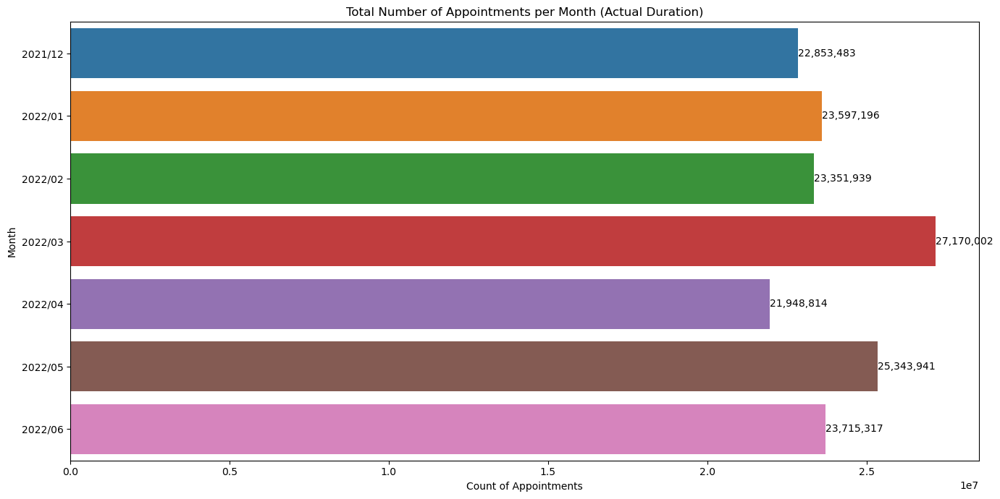

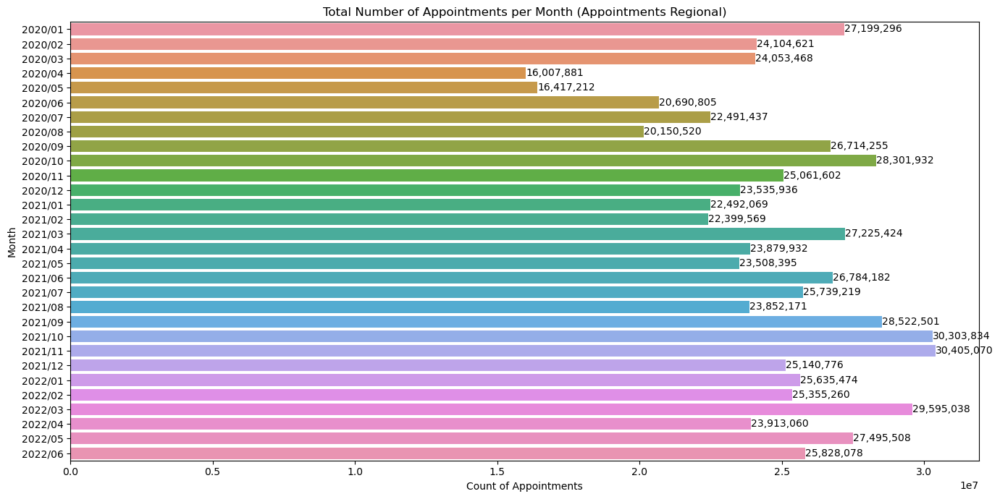

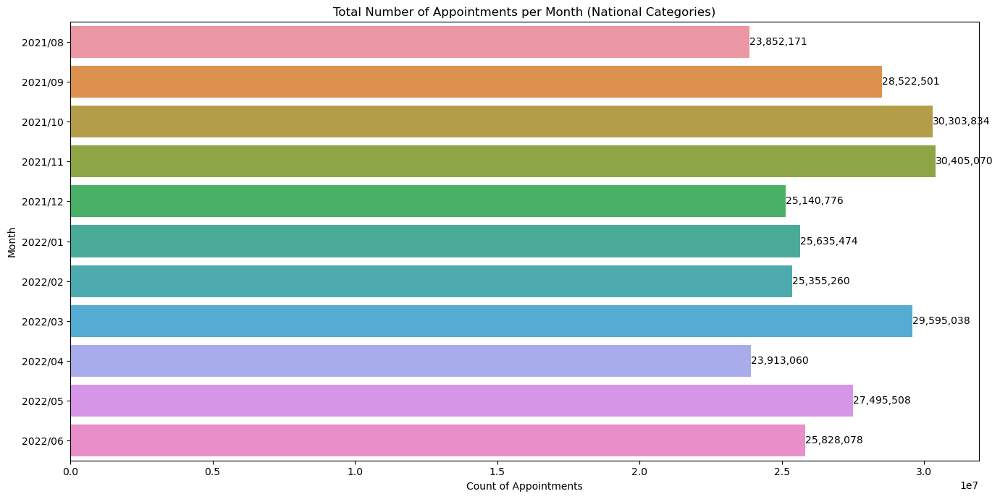

Note: The number of appointments is an estimate based on the percentage of practices included in the data collection.

In [48]:
# Load the data
ad = pd.read_csv('scaled_actual_duration.csv')
ar = pd.read_csv('scaled_appointments_regional.csv')
nc = pd.read_csv('scaled_national_categories.csv')

# If you would like to see the results with outliers values removed on the analysis,
# load the filtered files instead.
#ad = pd.read_csv('filtered_actual_duration.csv')
#ar = pd.read_csv('filtered_appointments_regional.csv')
#nc = pd.read_csv('filtered_national_categories.csv')

# Convert date columns to datetime
ad['appointment_date'] = pd.to_datetime(ad['appointment_date'])
ar['appointment_month'] = pd.to_datetime(ar['appointment_month'], format='%Y-%m')
nc['appointment_date'] = pd.to_datetime(nc['appointment_date'])

# Extract month and year for grouping
ad['appointment_month'] = ad['appointment_date'].dt.to_period('M').dt.to_timestamp()
nc['appointment_month'] = nc['appointment_date'].dt.to_period('M').dt.to_timestamp()

# Format appointment_month to display only year and month in yyyy/mm format
ad['appointment_month'] = ad['appointment_month'].dt.strftime('%Y/%m')
ar['appointment_month'] = ar['appointment_month'].dt.strftime('%Y/%m')
nc['appointment_month'] = nc['appointment_month'].dt.strftime('%Y/%m')

# Aggregate the data to count the number of appointments per month
ad_monthly_appointments = (
    ad.groupby('appointment_month')['count_of_appointments']
    .sum().reset_index())
ar_monthly_appointments = (
    ar.groupby('appointment_month')['count_of_appointments']
    .sum().reset_index())
nc_monthly_appointments = (
    nc.groupby('appointment_month')['count_of_appointments']
    .sum().reset_index())

# Display the tables
styled_ad_monthly_appointments = (
    ad_monthly_appointments.style.set_properties(**{'text-align': 'left'}))
styled_ad_monthly_appointments = (
    styled_ad_monthly_appointments
    .set_table_styles([dict(selector='th', props=[('text-align', 'left')])]))
styled_ad_monthly_appointments = (
    styled_ad_monthly_appointments.set_caption("Actual Duration Appointments by Month"))
display(HTML(styled_ad_monthly_appointments.to_html()))

styled_ar_monthly_appointments = (
    ar_monthly_appointments.style.set_properties(**{'text-align': 'left'}))
styled_ar_monthly_appointments = (
    styled_ar_monthly_appointments
    .set_table_styles([dict(selector='th', props=[('text-align', 'left')])]))
styled_ar_monthly_appointments = (
    styled_ar_monthly_appointments.set_caption("Appointments Regional by Month"))
display(HTML(styled_ar_monthly_appointments.to_html()))

styled_nc_monthly_appointments = (
    nc_monthly_appointments.style.set_properties(**{'text-align': 'left'}))
styled_nc_monthly_appointments = (
    styled_nc_monthly_appointments
    .set_table_styles([dict(selector='th', props=[('text-align', 'left')])]))
styled_nc_monthly_appointments = (
    styled_nc_monthly_appointments
    .set_caption("National Categories Appointments by Month"))
display(HTML(styled_nc_monthly_appointments.to_html()))

# Plot total appointments per month for ad
plt.figure(figsize=(14, 7))
sns.barplot(y='appointment_month', x='count_of_appointments',
            data=ad_monthly_appointments, orient='h')
plt.title('Total Number of Appointments per Month (Actual Duration)')
plt.ylabel('Month')
plt.xlabel('Count of Appointments')

# Add counts on top of the bars
for index, row in ad_monthly_appointments.iterrows():
    plt.text(row['count_of_appointments'], index, f'{row["count_of_appointments"]:,}', 
             color='black', va="center")

plt.tight_layout()
plt.savefig('bar_total_appointments')
plt.show()

# Plot total appointments per month for ar
plt.figure(figsize=(14, 7))
sns.barplot(y='appointment_month', x='count_of_appointments', 
            data=ar_monthly_appointments, orient='h')
plt.title('Total Number of Appointments per Month (Appointments Regional)')
plt.ylabel('Month')
plt.xlabel('Count of Appointments')

# Add counts on top of the bars
for index, row in ar_monthly_appointments.iterrows():
    plt.text(row['count_of_appointments'], index, f'{row["count_of_appointments"]:,}', 
             color='black', va="center")

plt.tight_layout()
plt.show()

# Plot total appointments per month for nc
plt.figure(figsize=(14, 7))
sns.barplot(y='appointment_month', x='count_of_appointments', 
            data=nc_monthly_appointments, orient='h')
plt.title('Total Number of Appointments per Month (National Categories)')
plt.ylabel('Month')
plt.xlabel('Count of Appointments')

# Add counts on top of the bars
for index, row in nc_monthly_appointments.iterrows():
    plt.text(row['count_of_appointments'], index, f'{row["count_of_appointments"]:,}',
             color='black', va="center")

plt.tight_layout()
plt.show()

# Adding a note about estimation in visualizations
note = "Note: The number of appointments is an estimate based on the percentage of practices included in the data collection."
display(Markdown(note))

Results: 11/2021, 10/2021 and 03/2022 had the highest number of appointments, while 04/2020 the lowest. Interestingly when outliers are removed, in nc the highest apppointments is in 03/2022 and 03/2022 in ad and nc.

<a id="Question-4"></a>
#### Question 4: What monthly and seasonal trends are evident, based on the number of appointments for service settings, context types, and national categories?

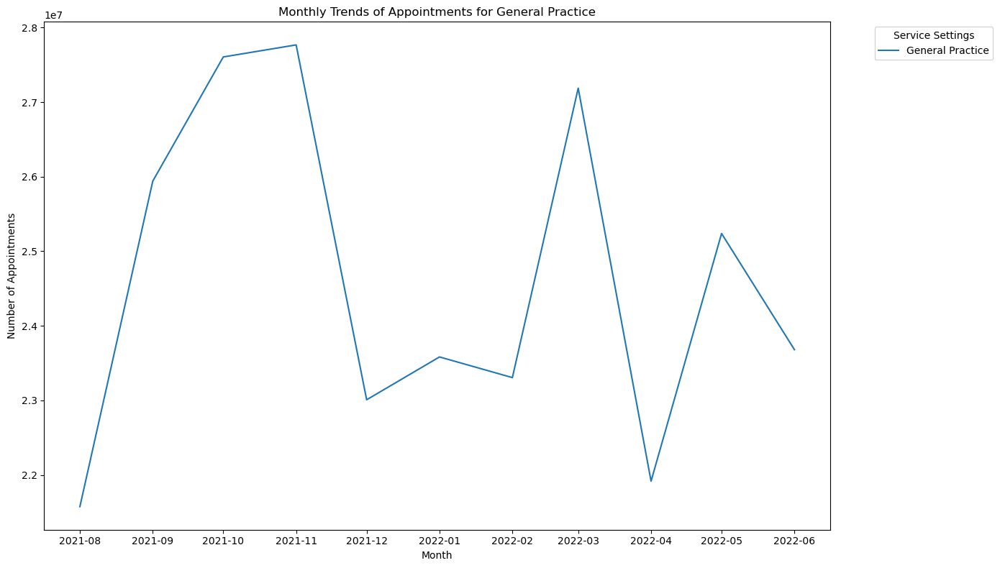

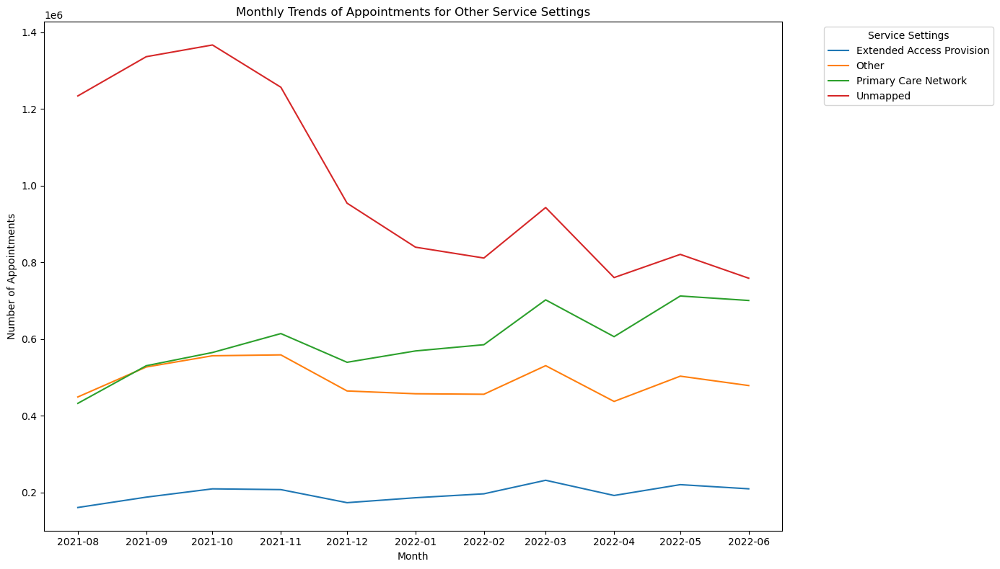

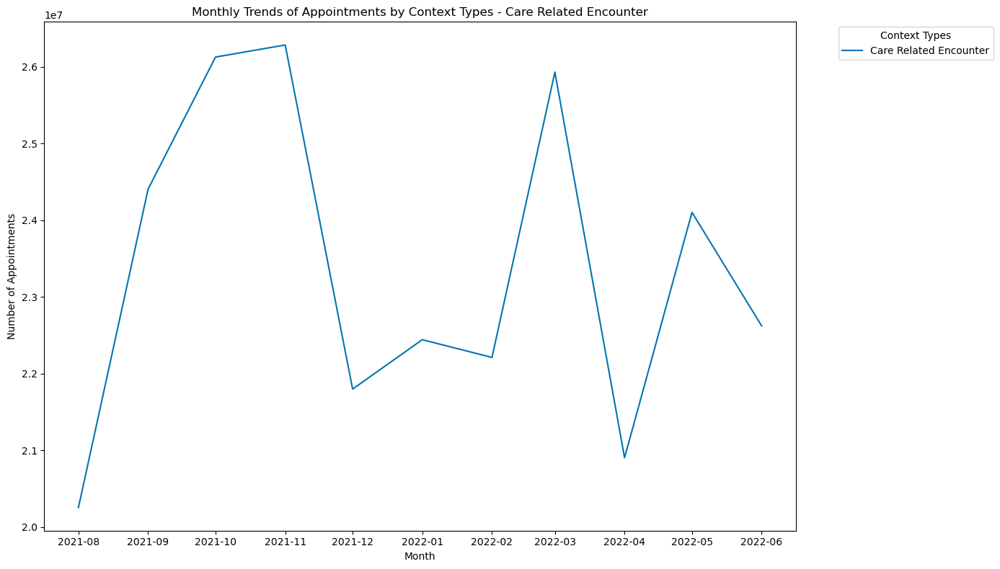

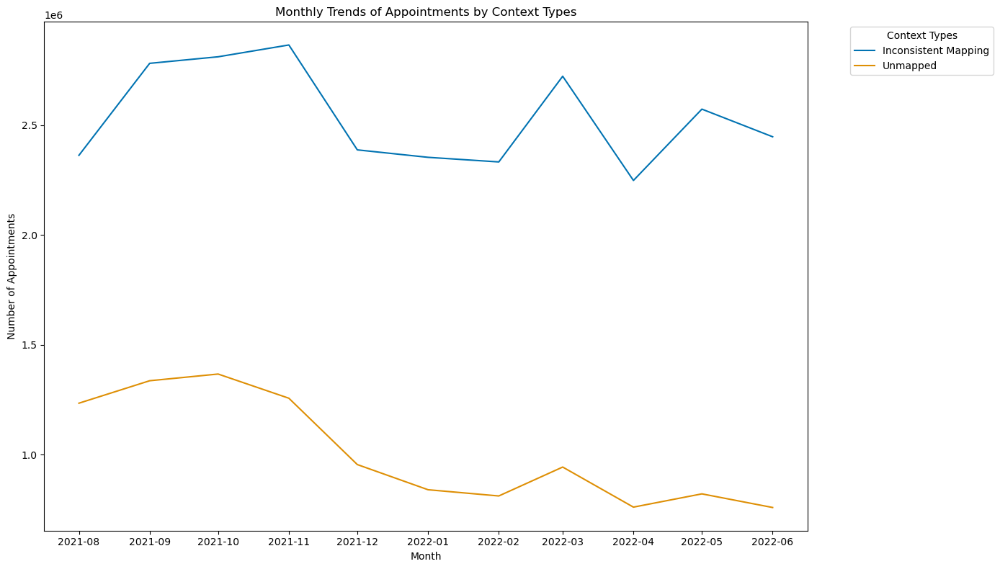

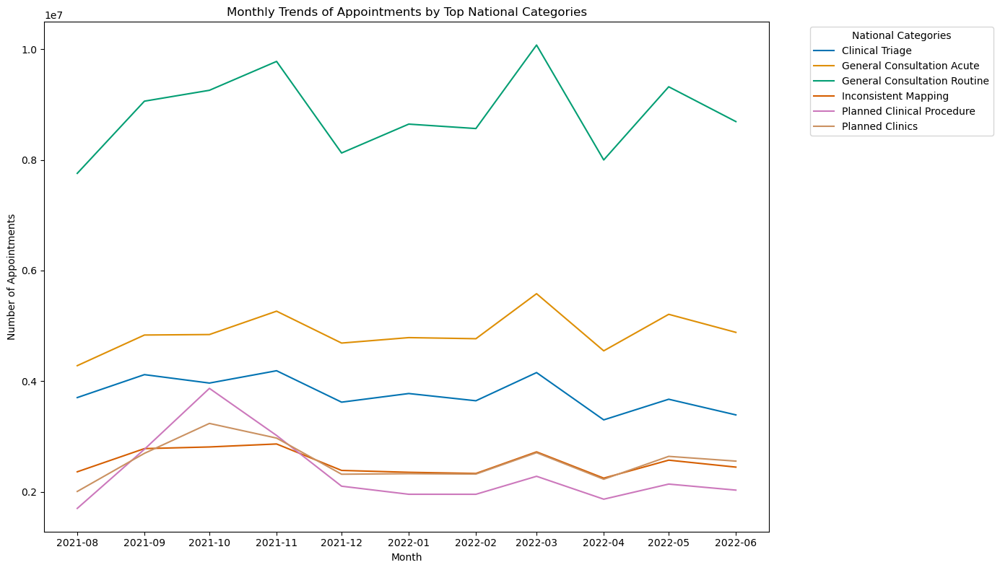

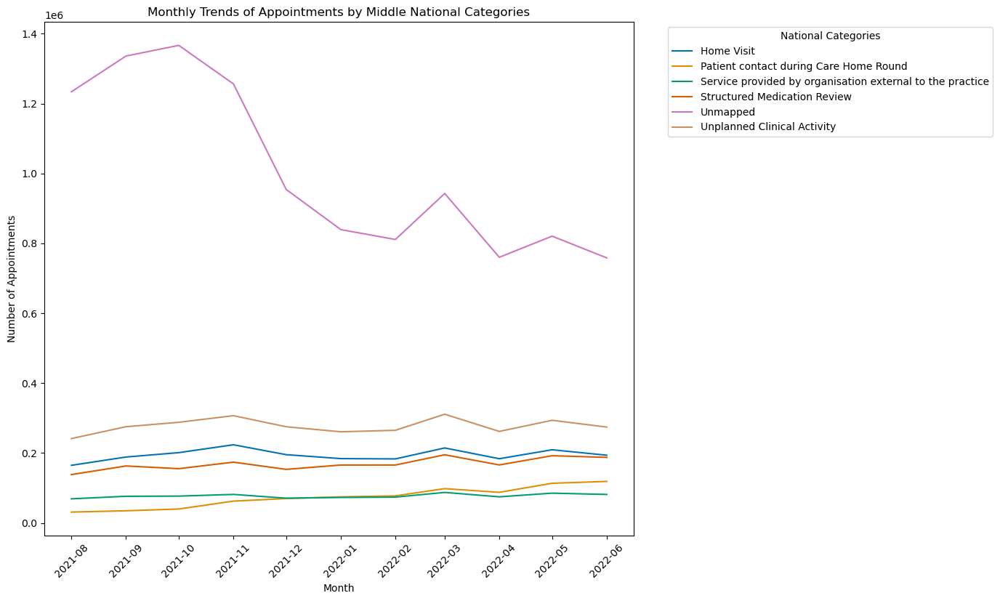

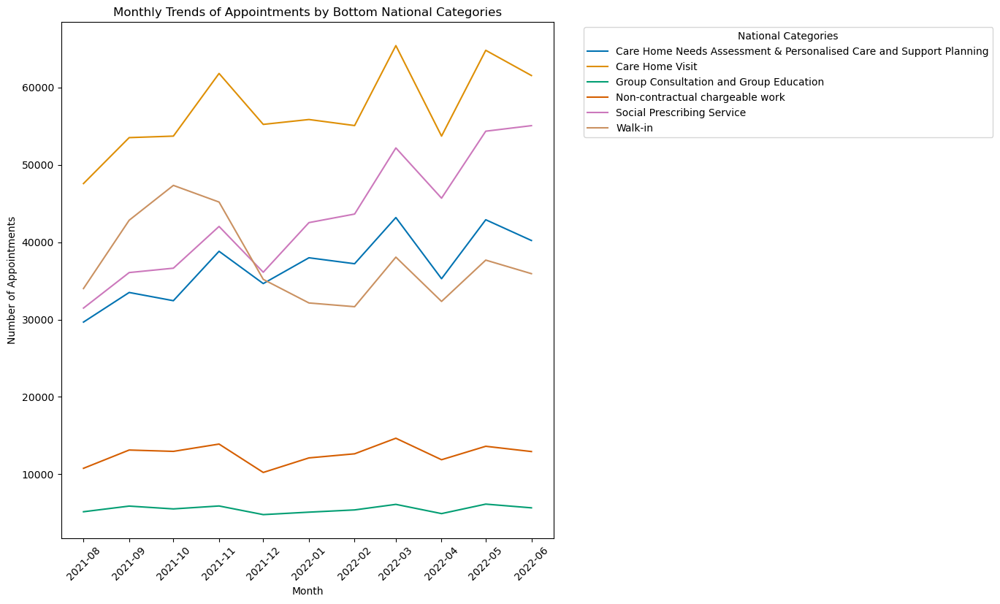

Note: The number of appointments is an estimate based on the percentage of practices included in the data collection.

In [51]:
# Load the data
nc = pd.read_csv('scaled_national_categories.csv')

# If you would like to see the results with outliers values removed, 
# load the filtered files.
#nc = pd.read_csv('filtered_national_categories.csv')

# Ensure date columns are in datetime format
nc['appointment_date'] = pd.to_datetime(nc['appointment_date'])

# Extract month from appointment_date for ad and nc datasets
nc['appointment_month'] = nc['appointment_date'].dt.to_period('M').dt.to_timestamp()

# Aggregate the data by appointment month and category
service_settings_trends = (
    nc.groupby(['appointment_month', 'service_setting'])['count_of_appointments']
    .sum().reset_index())
context_types_trends = (
    nc.groupby(['appointment_month', 'context_type'])['count_of_appointments']
    .sum().reset_index())
national_categories_trends = (
    nc.groupby(['appointment_month', 'national_category'])['count_of_appointments']
    .sum().reset_index())

# save the new dataframes as csv
service_settings_trends.to_csv('service_setting_trends.csv', index=False)
context_types_trends.to_csv('context_types_trends.csv', index=False)
national_categories_trends.to_csv('national_categories_trends.csv', index=False)

# Separate General Practice from other service settings
gp_trends = (
    service_settings_trends[service_settings_trends['service_setting'] ==
    'General Practice'])
other_service_trends = (
    service_settings_trends[service_settings_trends['service_setting'] != 
    'General Practice'])

# Plot monthly trends for General Practice
plt.figure(figsize=(14, 8))
sns.lineplot(data=gp_trends, x='appointment_month', y='count_of_appointments', 
             hue='service_setting', palette='tab10')
plt.title('Monthly Trends of Appointments for General Practice')
plt.xlabel('Month')
plt.ylabel('Number of Appointments')
plt.legend(title='Service Settings', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig('Monthly_Trends_of_Appointments_for_General_Practice.png')
plt.show()

# Plot monthly trends for other service settings
plt.figure(figsize=(14, 8))
sns.lineplot(data=other_service_trends, x='appointment_month', y='count_of_appointments',
             hue='service_setting', palette='tab10')
plt.title('Monthly Trends of Appointments for Other Service Settings')
plt.xlabel('Month')
plt.ylabel('Number of Appointments')
plt.legend(title='Service Settings', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig('Monthly_Trends_of_Appointments_for_Other_service_settings.png')
plt.show()

# Separate Care related encounter from the rest of the context types
care_trends = (
    context_types_trends[context_types_trends['context_type'] == 
    'Care Related Encounter'])
other_context_trends = (
    context_types_trends[context_types_trends['context_type'] != 'Care Related Encounter'])

# Plot monthly trends for context types care related encounter
plt.figure(figsize=(14, 8))
sns.lineplot(data=care_trends, x='appointment_month', y='count_of_appointments', 
             hue='context_type', palette='colorblind')
plt.title('Monthly Trends of Appointments by Context Types - Care Related Encounter')
plt.xlabel('Month')
plt.ylabel('Number of Appointments')
plt.legend(title='Context Types', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig('Monthly_Trends_of_Appointments_by_context_type_care.png')
plt.show()

# Plot monthly trends for context types other
plt.figure(figsize=(14, 8))
sns.lineplot(data=other_context_trends , x='appointment_month', y='count_of_appointments', 
             hue='context_type', palette='colorblind')
plt.title('Monthly Trends of Appointments by Context Types')
plt.xlabel('Month')
plt.ylabel('Number of Appointments')
plt.legend(title='Context Types', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig('Monthly_Trends_of_Appointments_by_context_type_care2.png')
plt.show()

# Get the total count of appointments per national category for sorting
category_totals = national_categories_trends.groupby('national_category')['count_of_appointments'].sum().reset_index()
category_totals = category_totals.sort_values(by='count_of_appointments', ascending=False)

# Divide categories into top, middle, and bottom thirds
top_categories = category_totals['national_category'][:6]
middle_categories = category_totals['national_category'][6:12]
bottom_categories = category_totals['national_category'][12:]

# Filter the trends data for each group
top_trends = (
    national_categories_trends[national_categories_trends['national_category']
    .isin(top_categories)])
middle_trends = (
    national_categories_trends[national_categories_trends['national_category']
    .isin(middle_categories)])
bottom_trends = (
    national_categories_trends[national_categories_trends['national_category']
    .isin(bottom_categories)])

# Plot monthly trends for top categories
plt.figure(figsize=(14, 8))
sns.lineplot(data=top_trends, x='appointment_month', y='count_of_appointments',
             hue='national_category', palette='colorblind')
plt.title('Monthly Trends of Appointments by Top National Categories')
plt.xlabel('Month')
plt.ylabel('Number of Appointments')
plt.legend(title='National Categories', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig('Monthly_Trends_of_Appointments_by_national_category1.png')
plt.show()

# Plot monthly trends for middle categories
plt.figure(figsize=(14, 8))
sns.lineplot(data=middle_trends, x='appointment_month', y='count_of_appointments', 
             hue='national_category', palette='colorblind')
plt.title('Monthly Trends of Appointments by Middle National Categories')
plt.xlabel('Month')
plt.ylabel('Number of Appointments')
plt.legend(title='National Categories', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.xticks(rotation=45)
plt.savefig('Monthly_Trends_of_Appointments_by_national_category2.png')
plt.show()

# Plot monthly trends for bottom categories
plt.figure(figsize=(14, 8))
sns.lineplot(data=bottom_trends, x='appointment_month', y='count_of_appointments', 
             hue='national_category', palette='colorblind')
plt.title('Monthly Trends of Appointments by Bottom National Categories')
plt.xlabel('Month')
plt.ylabel('Number of Appointments')
plt.legend(title='National Categories', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.xticks(rotation=45)
plt.savefig('Monthly_Trends_of_Appointments_by_national_category3.png')
plt.show()

# Adding a note about estimation
note = "Note: The number of appointments is an estimate based on the percentage \
of practices included in the data collection."
display(Markdown(note))

#### Displaying data by seasons for the national categories file

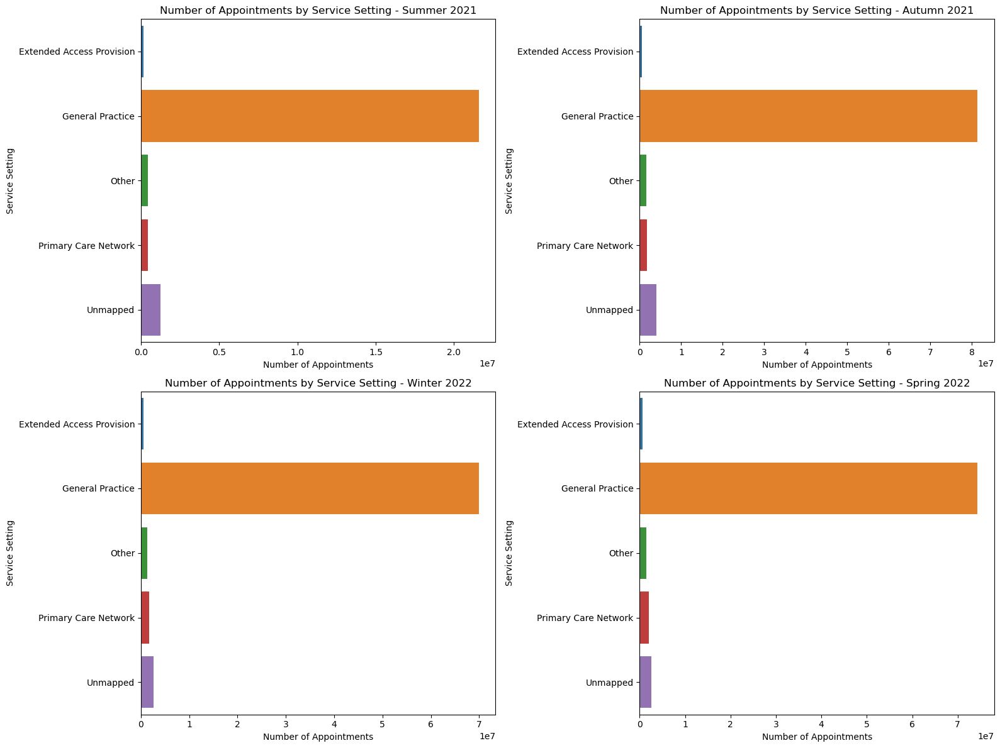

,season,service_setting,count_of_appointments
0,Summer 2021,Extended Access Provision,160927
1,Summer 2021,General Practice,21575852
2,Summer 2021,Other,449101
3,Summer 2021,Primary Care Network,432448
4,Summer 2021,Unmapped,1233843
0,Autumn 2021,Extended Access Provision,605022
1,Autumn 2021,General Practice,81314881
2,Autumn 2021,Other,1642445
3,Autumn 2021,Primary Care Network,1709790
4,Autumn 2021,Unmapped,3959267


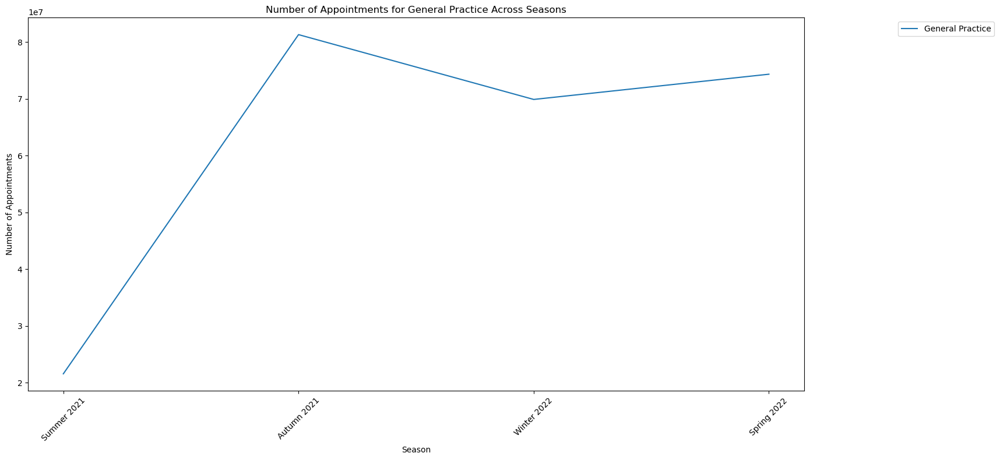

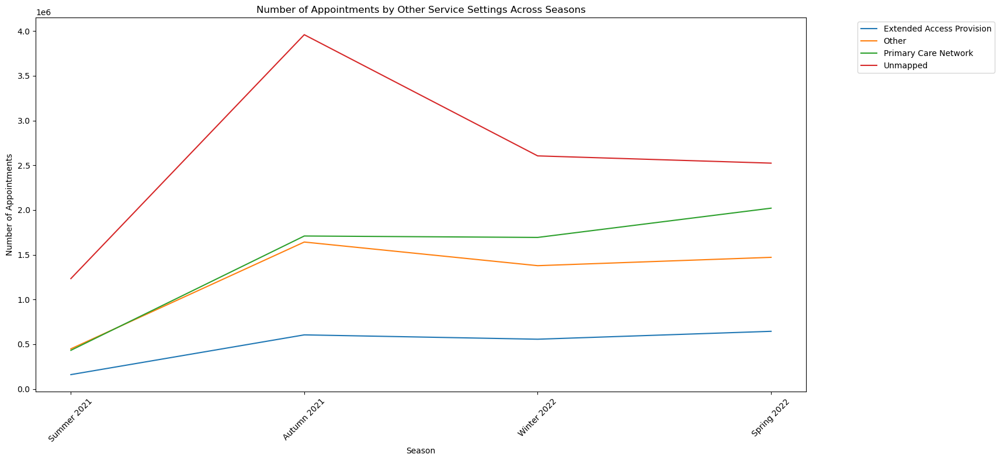

Note: The number of appointments is an estimate based on the percentage of practices included in the data collection.

In [53]:
# Load the data
nc = pd.read_csv('scaled_national_categories.csv')

# If you would like to see the results with outliers values removed, 
# load the filtered files.
#nc = pd.read_csv('filtered_national_categories.csv')

# Ensure the appointment_date column is in datetime format
nc['appointment_date'] = pd.to_datetime(nc['appointment_date'])

# Define a function to assign seasons based on the appointment_date
def assign_season(date):
    if date >= pd.Timestamp('2021-06-01') and date <= pd.Timestamp('2021-08-31'):
        return 'Summer 2021'
    elif date >= pd.Timestamp('2021-09-01') and date <= pd.Timestamp('2021-11-30'):
        return 'Autumn 2021'
    elif date >= pd.Timestamp('2021-12-01') and date <= pd.Timestamp('2022-02-28'):
        return 'Winter 2022'
    elif date >= pd.Timestamp('2022-03-01') and date <= pd.Timestamp('2022-05-31'):
        return 'Spring 2022'
    else:
        return None

# Apply the function to create a season column
nc['season'] = nc['appointment_date'].apply(assign_season)

# Filter out rows where season is None
nc = nc[nc['season'].notna()]

# Create separate datasets for each season
summer_data = nc[nc['season'] == 'Summer 2021']
autumn_data = nc[nc['season'] == 'Autumn 2021']
winter_data = nc[nc['season'] == 'Winter 2022']
spring_data = nc[nc['season'] == 'Spring 2022']

# Save these datasets for future use
summer_data.to_csv('summer_2021_data.csv', index=False)
autumn_data.to_csv('autumn_2021_data.csv', index=False)
winter_data.to_csv('winter_2022_data.csv', index=False)
spring_data.to_csv('spring_2022_data.csv', index=False)

# Aggregate data by service setting for each season
summer_agg = (
    summer_data.groupby('service_setting')['count_of_appointments']
    .sum().reset_index())
summer_agg['season'] = 'Summer 2021'
autumn_agg = (
    autumn_data.groupby('service_setting')['count_of_appointments']
    .sum().reset_index())
autumn_agg['season'] = 'Autumn 2021'
winter_agg = (
    winter_data.groupby('service_setting')['count_of_appointments']
    .sum().reset_index())
winter_agg['season'] = 'Winter 2022'
spring_agg = (
    spring_data.groupby('service_setting')['count_of_appointments']
    .sum().reset_index())
spring_agg['season'] = 'Spring 2022'

# Combine all seasonal data
combined_seasonal_data = pd.concat([summer_agg, autumn_agg, winter_agg, spring_agg])

# Plot the data - Bar Charts
fig, axes = plt.subplots(2, 2, figsize=(16, 12))

sns.barplot(ax=axes[0, 0], data=summer_agg, x='count_of_appointments', y='service_setting')
axes[0, 0].set_title('Number of Appointments by Service Setting - Summer 2021')
axes[0, 0].set_xlabel('Number of Appointments')
axes[0, 0].set_ylabel('Service Setting')

sns.barplot(ax=axes[0, 1], data=autumn_agg, x='count_of_appointments', y='service_setting')
axes[0, 1].set_title('Number of Appointments by Service Setting - Autumn 2021')
axes[0, 1].set_xlabel('Number of Appointments')
axes[0, 1].set_ylabel('Service Setting')

sns.barplot(ax=axes[1, 0], data=winter_agg, x='count_of_appointments', y='service_setting')
axes[1, 0].set_title('Number of Appointments by Service Setting - Winter 2022')
axes[1, 0].set_xlabel('Number of Appointments')
axes[1, 0].set_ylabel('Service Setting')

sns.barplot(ax=axes[1, 1], data=spring_agg, x='count_of_appointments', y='service_setting')
axes[1, 1].set_title('Number of Appointments by Service Setting - Spring 2022')
axes[1, 1].set_xlabel('Number of Appointments')
axes[1, 1].set_ylabel('Service Setting')

plt.tight_layout()
plt.savefig('seasons_by_service_setting_nc.png')
plt.show()

# Combine all seasonal data
combined_seasonal_data = pd.concat([summer_agg, autumn_agg, winter_agg, spring_agg])
combined_seasonal_data = (
    combined_seasonal_data[['season', 'service_setting', 'count_of_appointments']])

# Separate data for General Practice and other service settings
gp_data = (
    combined_seasonal_data[combined_seasonal_data['service_setting'] == 
    'General Practice'])
other_data = (
    combined_seasonal_data[combined_seasonal_data['service_setting'] != 
    'General Practice'])

# Display the combined data as a DataFrame
display(combined_seasonal_data)

# Plot seasonal trends for General Practice
plt.figure(figsize=(14, 8))
sns.lineplot(data=gp_data, x='season', y='count_of_appointments', hue='service_setting')
plt.title('Number of Appointments for General Practice Across Seasons')
plt.xlabel('Season')
plt.ylabel('Number of Appointments')
plt.xticks(rotation=45)
plt.tight_layout()
plt.legend(loc='upper right', bbox_to_anchor=(1.25, 1))
plt.show()

# Plot seasonal trends for other service settings
plt.figure(figsize=(14, 8))
sns.lineplot(data=other_data, x='season', y='count_of_appointments',
             hue='service_setting')
plt.title('Number of Appointments by Other Service Settings Across Seasons')
plt.xlabel('Season')
plt.ylabel('Number of Appointments')
plt.xticks(rotation=45)
plt.tight_layout()
plt.legend(loc='upper right', bbox_to_anchor=(1.25, 1))
plt.show()

# Adding a note about estimation
note = "Note: The number of appointments is an estimate based on the percentage of practices included in the data collection."
display(Markdown(note))

Results:
- General Practice has the highest appointments in all seasons (results remain the same when outlier values are excluded). Autumn has the highest appointments for all types of appointments.

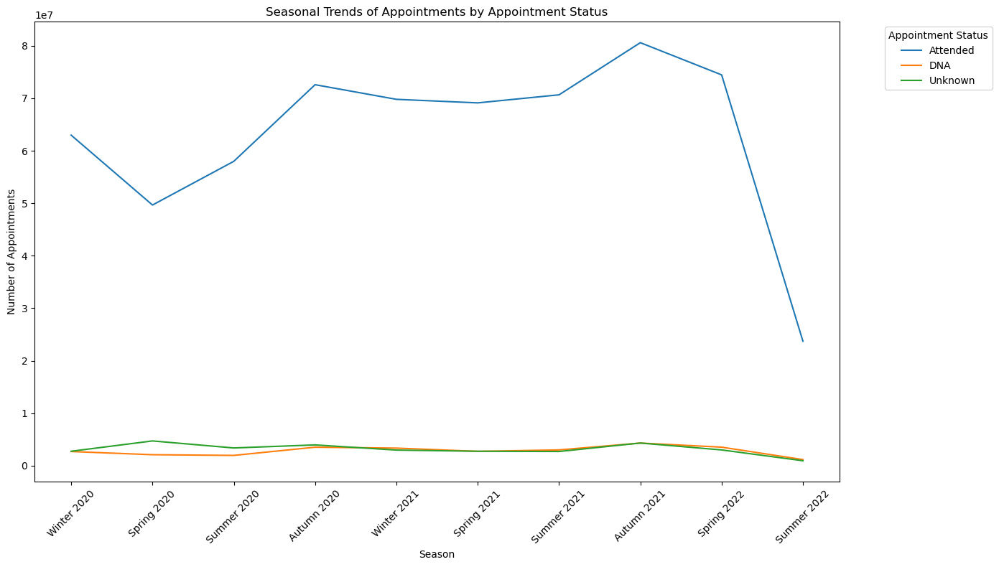

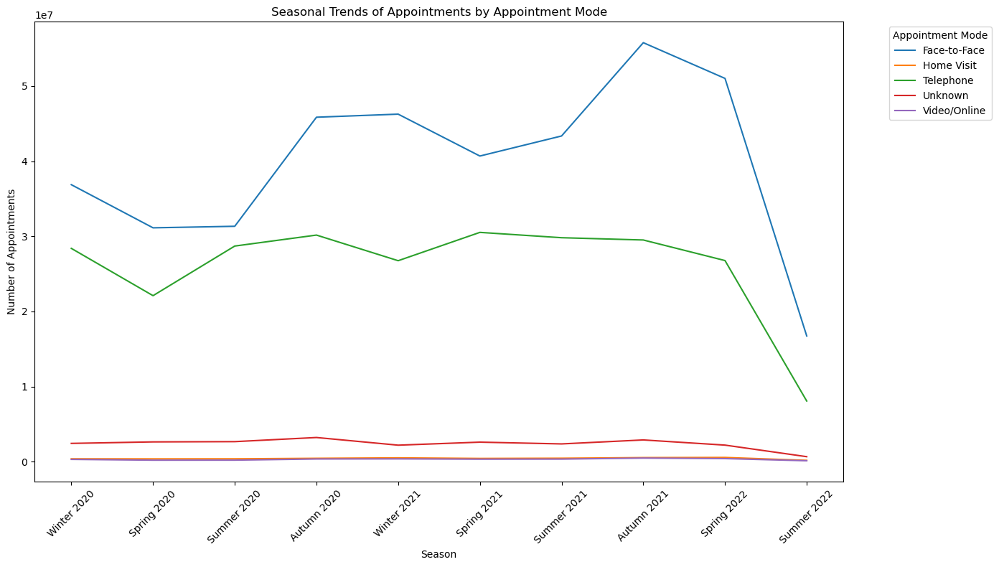

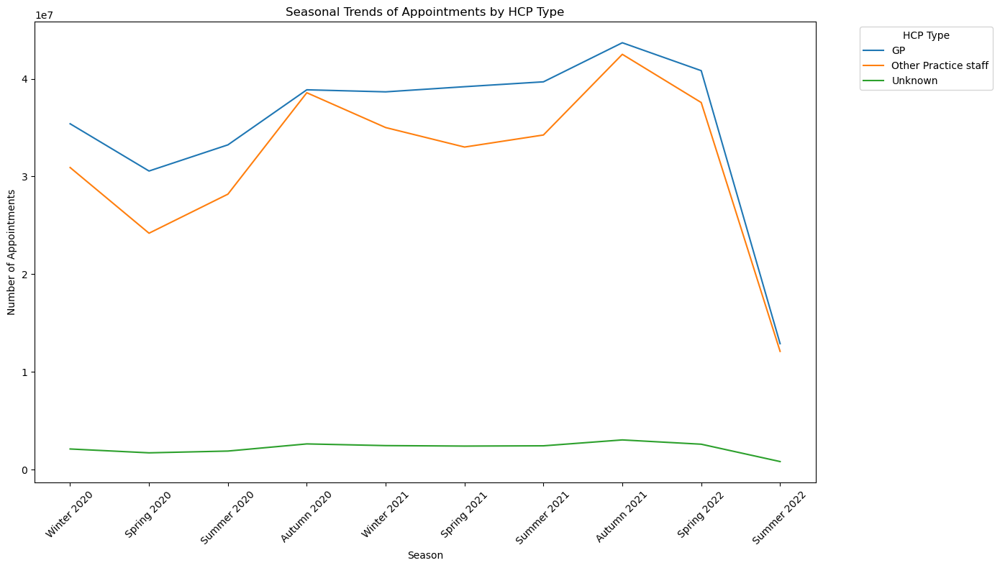

In [55]:
# Seasonal trends of apointment_status, hcp_type and appointment_mode
# Ensure the appointment_date column is in datetime format
ar['appointment_month'] = pd.to_datetime(ar['appointment_month'])

# Define a function to assign seasons based on the appointment_date
def assign_season(date):
    year = date.year
    if date.month in [12, 1, 2]:
        return f'Winter {year if date.month == 12 else year - 1}'
    elif date.month in [3, 4, 5]:
        return f'Spring {year}'
    elif date.month in [6, 7, 8]:
        return f'Summer {year}'
    elif date.month in [9, 10, 11]:
        return f'Autumn {year}'
    else:
        return None

# Apply the function to create a season column
ar['season'] = ar['appointment_month'].apply(assign_season)

# Filter out rows where season is None
ar = ar[ar['season'].notna()]

# Create a categorical type for seasons with a specific order
season_order = [
    'Winter 2020', 'Spring 2020', 'Summer 2020', 'Autumn 2020',
    'Winter 2021', 'Spring 2021', 'Summer 2021', 'Autumn 2021',
    'Winter 2022', 'Spring 2022', 'Summer 2022'
]
season_order = [season for season in season_order if season in ar['season'].unique()]
ar['season'] = pd.Categorical(ar['season'], categories=season_order, ordered=True)

# Aggregate data by appointment_status, appointment_mode, and hcp_type for each season
status_agg = (
    ar.groupby(['season', 'appointment_status'])['count_of_appointments']
    .sum().reset_index())
mode_agg = (
    ar.groupby(['season', 'appointment_mode'])['count_of_appointments']
    .sum().reset_index())
hcp_type_agg = (
    ar.groupby(['season', 'hcp_type'])['count_of_appointments']
    .sum().reset_index())

# Combine all seasonal data for visualization
combined_seasonal_data_status = status_agg[['season', 
                                            'appointment_status', 'count_of_appointments']]
combined_seasonal_data_mode = mode_agg[['season',
                                        'appointment_mode', 'count_of_appointments']]
combined_seasonal_data_hcp_type = hcp_type_agg[['season',
                                                'hcp_type', 'count_of_appointments']]

# Plot seasonal trends for appointment_status
plt.figure(figsize=(14, 8))
sns.lineplot(data=combined_seasonal_data_status, x='season', y='count_of_appointments', 
             hue='appointment_status', palette='tab10')
plt.title('Seasonal Trends of Appointments by Appointment Status')
plt.xlabel('Season')
plt.ylabel('Number of Appointments')
plt.legend(title='Appointment Status', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Plot seasonal trends for appointment_mode
plt.figure(figsize=(14, 8))
sns.lineplot(data=combined_seasonal_data_mode, x='season', y='count_of_appointments',
             hue='appointment_mode', palette='tab10')
plt.title('Seasonal Trends of Appointments by Appointment Mode')
plt.xlabel('Season')
plt.ylabel('Number of Appointments')
plt.legend(title='Appointment Mode', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Plot seasonal trends for hcp_type
plt.figure(figsize=(14, 8))
sns.lineplot(data=combined_seasonal_data_hcp_type, x='season', y='count_of_appointments',
             hue='hcp_type', palette='tab10')
plt.title('Seasonal Trends of Appointments by HCP Type')
plt.xlabel('Season')
plt.ylabel('Number of Appointments')
plt.legend(title='HCP Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

<a id="Question-5"></a>
#### Question 5: What are the top trending hashtags (#) on the supplied Twitter data set and how can this be used in the decision-making process?
- How can sentiment analysis of tweets inform decision-making and public communication strategies?

In [57]:
tweets = pd.read_csv('tweets.csv')
tweets.head()

,tweet_id,tweet_full_text,tweet_entities,tweet_entities_hashtags,tweet_metadata,tweet_retweet_count,tweet_favorite_count,tweet_favorited,tweet_retweeted,tweet_lang
0,1567629223795527681,As Arkansas’ first Comprehensive Stroke Certif...,"{'hashtags': [{'text': 'Healthcare', 'indices'...",#Healthcare,"{'iso_language_code': 'en', 'result_type': 're...",0,0,False,False,en
1,1567582846612553728,RT @AndreaGrammer: Work-life balance is at the...,"{'hashtags': [{'text': 'PremiseHealth', 'indic...","#PremiseHealth, #hiring","{'iso_language_code': 'en', 'result_type': 're...",2,0,False,False,en
2,1567582787070304256,RT @OntarioGreens: $10 billion can go a long w...,"{'hashtags': [{'text': 'Healthcare', 'indices'...",#Healthcare,"{'iso_language_code': 'en', 'result_type': 're...",39,0,False,False,en
3,1567582767625428992,RT @modrnhealthcr: 🚨#NEW:🚨 Insurance companies...,"{'hashtags': [{'text': 'NEW', 'indices': [20, ...",#NEW,"{'iso_language_code': 'en', 'result_type': 're...",5,0,False,False,en
4,1567582720460570625,ICYMI: Our recent blogs on Cybersecurity in Ac...,"{'hashtags': [{'text': 'blogs', 'indices': [18...","#blogs, #digitaltransformation, #cybersecurity...","{'iso_language_code': 'en', 'result_type': 're...",0,0,False,False,en


In [58]:
tweets.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1174 entries, 0 to 1173
Data columns (total 10 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   tweet_id                 1174 non-null   int64 
 1   tweet_full_text          1174 non-null   object
 2   tweet_entities           1174 non-null   object
 3   tweet_entities_hashtags  1007 non-null   object
 4   tweet_metadata           1174 non-null   object
 5   tweet_retweet_count      1174 non-null   int64 
 6   tweet_favorite_count     1174 non-null   int64 
 7   tweet_favorited          1174 non-null   bool  
 8   tweet_retweeted          1174 non-null   bool  
 9   tweet_lang               1174 non-null   object
dtypes: bool(2), int64(3), object(5)
memory usage: 75.8+ KB


In [59]:
tweets.describe()

,tweet_id,tweet_retweet_count,tweet_favorite_count
count,1.174000e+03,1174.000000,1174.00000
mean,1.567612e+18,8.629472,0.37138
std,2.427553e+13,29.784675,2.04470
min,1.567574e+18,0.000000,0.00000
25%,1.567590e+18,0.000000,0.00000
50%,1.567611e+18,1.000000,0.00000
75%,1.567633e+18,3.000000,0.00000
max,1.567655e+18,303.000000,42.00000


In [60]:
# Remove duplicates from the tweets data
# Load the tweets data
tweets = pd.read_csv('tweets.csv')

# Define the function to add duplicate flag ignoring 'tweet_id' column
def add_duplicate_flag_and_remove_duplicates(df, file_name, ignore_columns=None):
    if ignore_columns is None:
        ignore_columns = []
        
    logging.info(f"Adding duplicate flag. DataFrame shape before: {df.shape}")
    try:
        # Add the duplicate flag
        df['duplicate_flag'] = 0  # Initialize the flag column with 0
        # Check duplicates based on all columns except the ones to ignore
        df.loc[df.duplicated(subset=df.columns.difference(ignore_columns), 
                             keep=False), 'duplicate_flag'] = 1
        logging.info(f"Duplicate flag added. DataFrame shape after: {df.shape}")
        
        # Count duplicates
        total_duplicates = df.duplicated(subset=df.columns.difference(ignore_columns), 
                                         keep=False).sum()
        
        # Remove duplicates while keeping the first occurrence
        df_unique = df.drop_duplicates(subset=df.columns.difference(ignore_columns), 
                                       keep='first').copy()
        
        # Count unique records
        total_unique_kept = df_unique.shape[0]
        
        # Calculate the number of duplicates removed
        total_duplicates_removed = df.shape[0] - total_unique_kept
        
        logging.info(f"Duplicates removed. DataFrame shape after removing duplicates: {df_unique.shape}")
        logging.info(f"Total duplicates flagged: {total_duplicates}")
        logging.info(f"Total unique records kept: {total_unique_kept}")
        logging.info(f"Total duplicates removed: {total_duplicates_removed}")
        
        # Print the counts
        print(f"Total duplicates flagged: {total_duplicates}")
        print(f"Total unique records kept: {total_unique_kept}")
        print(f"Total duplicates removed: {total_duplicates_removed}")

        return df_unique
    except Exception as e:
        logging.error(f"Error adding duplicate flag: {str(e)}")
        return df  # Return the original DataFrame if the operation fails

# Apply the function to the tweets DataFrame ignoring the 'tweet_id' column
tweets_unique = add_duplicate_flag_and_remove_duplicates(tweets, 'tweets.csv',
                                                         ignore_columns=['tweet_id'])

# Optionally, save the unique DataFrame to a new CSV file
tweets_unique.to_csv('tweets_unique.csv', index=False)


2024-08-12 12:16:29,166 - INFO - Adding duplicate flag. DataFrame shape before: (1174, 10)
2024-08-12 12:16:29,182 - INFO - Duplicate flag added. DataFrame shape after: (1174, 11)
2024-08-12 12:16:29,215 - INFO - Duplicates removed. DataFrame shape after removing duplicates: (969, 11)
2024-08-12 12:16:29,215 - INFO - Total duplicates flagged: 296
2024-08-12 12:16:29,215 - INFO - Total unique records kept: 969
2024-08-12 12:16:29,215 - INFO - Total duplicates removed: 205


Total duplicates flagged: 296
Total unique records kept: 969
Total duplicates removed: 205


There appeared to be 296 duplicate entries. The first occurence was kept of each duplicate and 205 duplicates were removed. 

In [62]:
tweets_unique['tweet_retweet_count'].value_counts()

tweet_retweet_count
0      523
1      213
2       84
3       43
4       16
5       15
8        8
7        7
9        5
6        5
12       4
10       3
11       3
73       2
41       2
53       2
16       2
35       2
23       2
19       1
24       1
62       1
48       1
79       1
49       1
150      1
13       1
107      1
15       1
20       1
78       1
208      1
37       1
44       1
303      1
57       1
68       1
63       1
76       1
54       1
14       1
85       1
72       1
40       1
207      1
39       1
169      1
Name: count, dtype: int64

In [63]:
tweets_unique['tweet_favorite_count'].value_counts()

tweet_favorite_count
0     822
1      91
2      16
3      13
4       7
5       5
6       2
17      1
12      1
10      1
8       1
13      1
11      1
7       1
20      1
28      1
14      1
18      1
9       1
42      1
Name: count, dtype: int64

In [64]:
# Set display options to show full text
pd.set_option('display.max_colwidth', None)

# Display the first 5 rows of the tweet_full_text column
print(tweets_unique['tweet_full_text'].head())

0                           As Arkansas’ first Comprehensive Stroke Certified Center, UAMS provides Arkansans with access to the most advanced stoke care. Join us in our mission to make a difference in the health and well-being of our community as our next https://t.co/yw0cstfmSI #Healthcare
1                                                                                                                                                        RT @AndreaGrammer: Work-life balance is at the foundation of how decisions are made and where #PremiseHealth is headed.  We're #hiring for…
2                                                                                                                                                     RT @OntarioGreens: $10 billion can go a long way to fixing our broken #Healthcare system.\n\nYet Doug Ford would rather spend it ALL on a hig…
3                                                                                                                        

                    hashtag  count
0               #healthcare    686
1                   #health     62
2                      #job     35
3                 #strategy     30
4           #pharmaceutical     28
5                       #ai     26
6                   #pharma     25
7                #marketing     25
8                  #biotech     24
9  #competitiveintelligence     24
            mention  count
0         @_timos_:     26
1       @imedverse:      7
2     @fiercehealth      7
3  @soniafurstenau:      6
4  @kelly_archives:      5
5       @solve_care      5
6   @modrnhealthcr:      4
7         @statnews      4
8  @ihirejobalerts:      3
9    @cbchereandnow      3
         word  count
0      health    139
1  healthcare    132
2       about     83
3       their     57
4       learn     49
5       apply     43
6     medical     37
7       today     37
8     patient     36
9       great     36


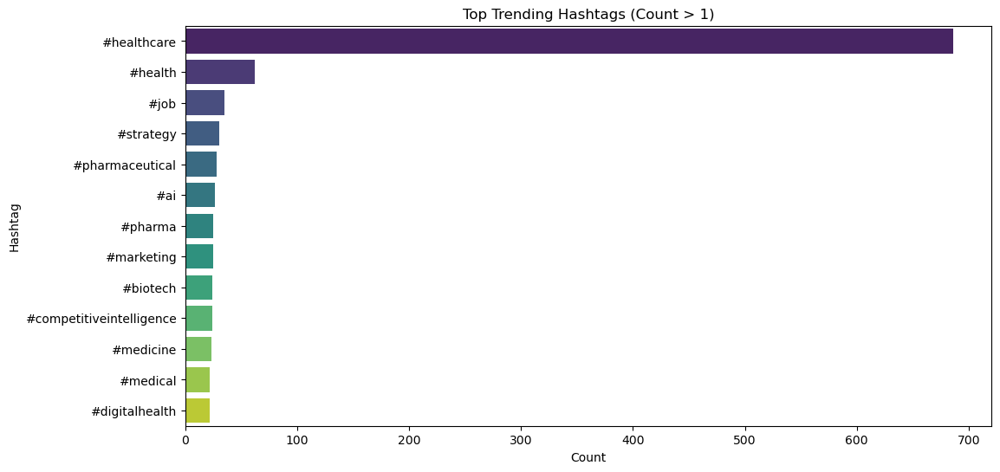

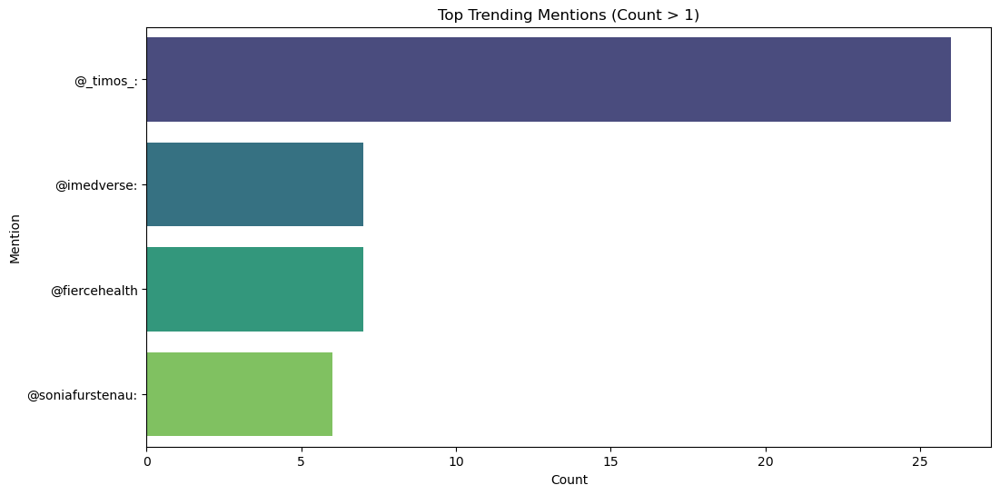

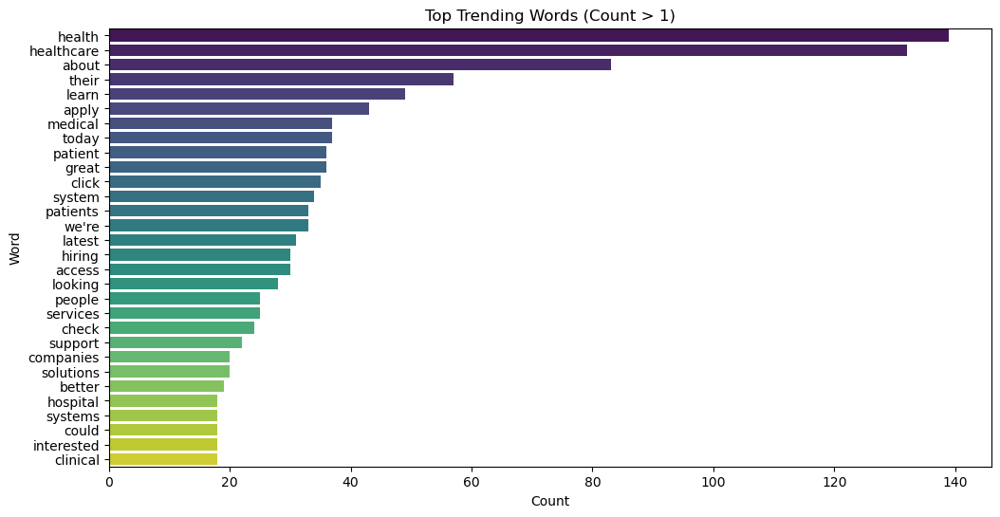

In [65]:
# Find the top trending hastags, mentions and words

# Continue to work with the unique tweets
tweets = pd.read_csv('tweets_unique.csv')

# Create a new DataFrame with only non-null text values
tweets_full_text = tweets['tweet_full_text'].dropna()
tweets_full_text = tweets_full_text[tweets_full_text != '']  
# Exclude empty strings if needed
tweets_full_text = pd.DataFrame(tweets_full_text, columns=['tweet_full_text'])


# Initialize empty lists for hashtags and mentions
hashtags = []
mentions = []
words = []

# Use a for loop to extract words, clean them, and convert them to lowercase
for y in [x.split(' ') for x in tweets['tweet_full_text'].values]:
    for z in y:
        z_clean = z.lower().strip('.,!?;')
        if z.startswith('#'):
            hashtags.append(z_clean)
        elif z.startswith('@'):
            mentions.append(z_clean)
        else:
            # Remove any non-alphanumeric characters at the start or end
            word_clean = re.sub(r'^[^\w]+|[^\w]+$', '', z_clean)
            if len(word_clean) > 4:
                words.append(word_clean)
                
# Create Pandas Series to count the values in the lists
hashtags_series = pd.Series(hashtags).value_counts()
mentions_series = pd.Series(mentions).value_counts()
words_series = pd.Series(words).value_counts()

# Convert the Series into DataFrames and reset the index
hashtags_df = hashtags_series.reset_index()
hashtags_df.columns = ['hashtag', 'count']
hashtags_df['count'] = hashtags_df['count'].astype(int)

mentions_df = mentions_series.reset_index()
mentions_df.columns = ['mention', 'count']
mentions_df['count'] = mentions_df['count'].astype(int)

words_df = words_series.reset_index()
words_df.columns = ['word', 'count']
words_df['count'] = words_df['count'].astype(int)

# Sense-check the DataFrames
print(hashtags_df.head(10))
print(mentions_df.head(10))
print(words_df.head(10))

# Create a Seaborn barplot of hashtags with a count > 20
plt.figure(figsize=(12, 6))
sns.barplot(x='count', y='hashtag', data=hashtags_df[hashtags_df['count'] > 20], 
            palette='viridis')
plt.title('Top Trending Hashtags (Count > 1)')
plt.xlabel('Count')
plt.ylabel('Hashtag')
plt.show()

# Create a Seaborn barplot of mentions with a count > 5
plt.figure(figsize=(12, 6))
sns.barplot(x='count', y='mention', data=mentions_df[mentions_df['count'] > 5],
            palette='viridis')
plt.title('Top Trending Mentions (Count > 1)')
plt.xlabel('Count')
plt.ylabel('Mention')
plt.show()

# Create a Seaborn barplot of words with a count > 5
plt.figure(figsize=(12, 6))
sns.barplot(x='count', y='word', data=words_df[words_df['count'] > 5].head(30), 
            palette='viridis')
plt.title('Top Trending Words (Count > 1)')
plt.xlabel('Count')
plt.ylabel('Word')
plt.show()

                                                                                                                                                                                                                                                                                                      tweet_full_text  \
0                                            As Arkansas’ first Comprehensive Stroke Certified Center, UAMS provides Arkansans with access to the most advanced stoke care. Join us in our mission to make a difference in the health and well-being of our community as our next https://t.co/yw0cstfmSI #Healthcare   
1                                                                                                                                                                         RT @AndreaGrammer: Work-life balance is at the foundation of how decisions are made and where #PremiseHealth is headed.  We're #hiring for…   
2                                                            

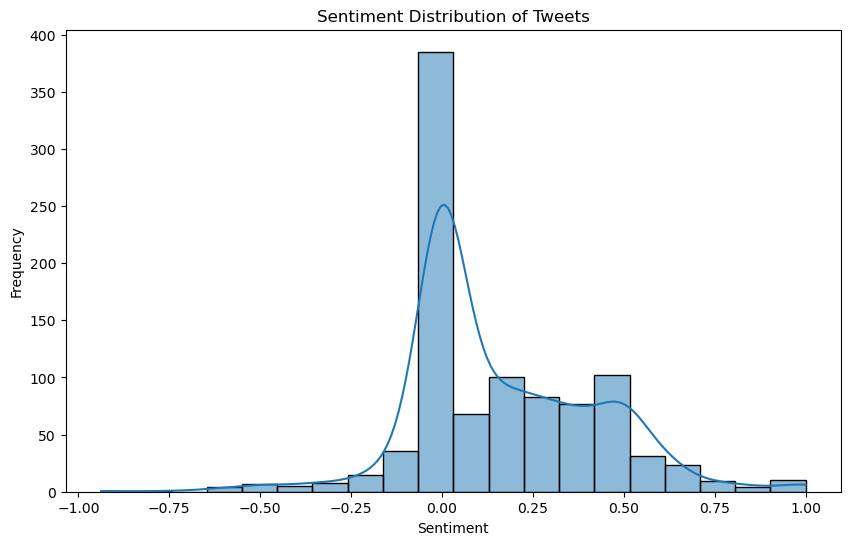

In [66]:
# Sentiment analysis

# Continue to work with the unique tweets
tweets = pd.read_csv('tweets_unique.csv')

# Function to get sentiment
def get_sentiment(text):
    analysis = TextBlob(text)
    return analysis.sentiment.polarity

# Apply the sentiment function to the tweet_full_text column
tweets['sentiment'] = tweets['tweet_full_text'].apply(get_sentiment)

# Display the DataFrame with sentiment scores
print(tweets[['tweet_full_text', 'sentiment']])

# Visualize the sentiment distribution
plt.figure(figsize=(10, 6))
sns.histplot(tweets['sentiment'], bins=20, kde=True)
plt.title('Sentiment Distribution of Tweets')
plt.xlabel('Sentiment')
plt.ylabel('Frequency')
plt.show()

Chicago                       12
U.S.                           8
US                             8
DoctorofVeterinaryMedicine     7
Canada                         7
MD                             6
Florida                        5
Arkansas                       4
Harvey                         4
North Carolina                 4
India                          4
Michigan                       4
Texas                          4
Vermont                        4
Name: count, dtype: int64


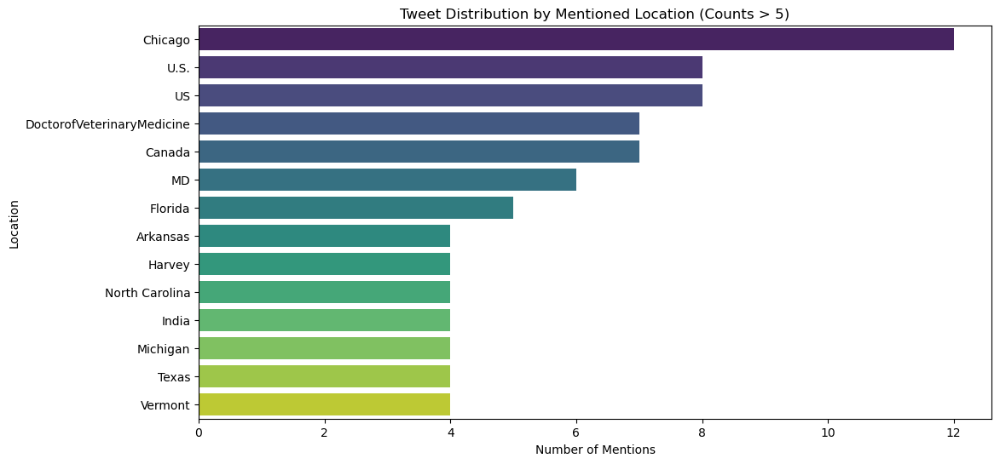

In [67]:
# Continue to work with the unique tweets - check for location name mentions
# Load spaCy model
nlp = spacy.load('en_core_web_sm')

# Continue to work with the unique tweets
tweets = pd.read_csv('tweets_unique.csv')

# Function to extract valid geographical locations from text using Spacy
def extract_locations(text):
    doc = nlp(text)
    return [ent.text for ent in doc.ents if ent.label_ == 'GPE']

# Apply the function to extract locations and create a new column
tweets['locations'] = tweets['tweet_full_text'].apply(extract_locations)

# Flatten the list of locations and count the occurrences
all_locations = [location for sublist in tweets['locations'] for location in sublist]
location_counts = pd.Series(all_locations).value_counts()

# Filter for locations with counts above 5
filtered_location_counts = location_counts[location_counts > 3]

# Display the filtered location counts
print(filtered_location_counts)

# Visualize the tweet distribution by location (with counts > 3)
plt.figure(figsize=(12, 6))
sns.barplot(y=filtered_location_counts.index, x=filtered_location_counts.values,
            palette='viridis')
plt.title('Tweet Distribution by Mentioned Location (Counts > 5)')
plt.xlabel('Number of Mentions')
plt.ylabel('Location')
plt.show()

UK            2
Birmingham    1
London        1
Winchester    1
Aberdeen      1
Name: count, dtype: int64


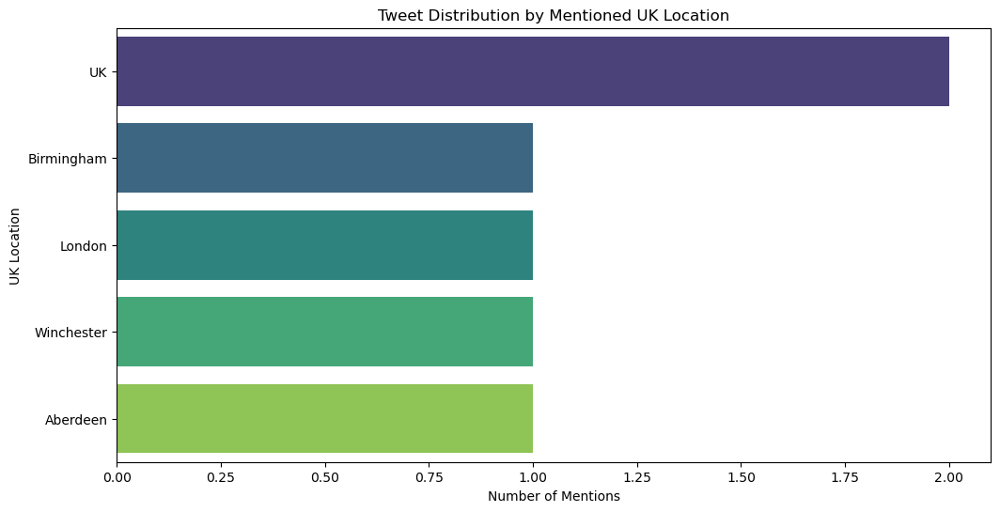

In [68]:
# Check for UK location mentions

# Continue to work with the unique tweets
tweets = pd.read_csv('tweets_unique.csv')

# List of common UK locations
uk_locations = set([
    'UK', 'England', 'Britain', 'United Kingdom', 'Great Britain', 'GB', 'Wales', 
    'Scotland', 
    'London', 'Manchester', 'Birmingham', 'Leeds', 'Glasgow', 'Liverpool',
    'Edinburgh', 'Bristol', 'Sheffield', 'Cardiff', 'Belfast', 'Leicester',
    'Newcastle', 'Coventry', 'Nottingham', 'Sunderland', 'Brighton', 'Hull',
    'Plymouth', 'Stoke-on-Trent', 'Wolverhampton', 'Derby', 'Swansea', 'Southampton',
    'Portsmouth', 'York', 'Oxford', 'Cambridge', 'Aberdeen', 'Dundee', 'Bath', 'Chester',
    'Durham', 'Exeter', 'Lancaster', 'Lincoln', 'Norwich', 'Preston', 'Ripon', 'Salford',
    'Wakefield', 'Wells', 'Winchester', 'Worcester'
])

# Function to extract locations from text using Spacy
def extract_locations(text):
    doc = nlp(text)
    return [ent.text for ent in doc.ents if ent.label_ == 'GPE']

# Apply the function to extract locations and create a new column
tweets['locations'] = tweets['tweet_full_text'].apply(extract_locations)

# Flatten the list of locations and filter for UK-related locations
all_locations = [location for sublist in tweets['locations'] for location in sublist]
uk_related_locations = (
    [location for location in all_locations if location in uk_locations])

# Count the occurrences of UK-related locations
uk_location_counts = pd.Series(uk_related_locations).value_counts()

# Display the UK location counts
print(uk_location_counts)

# Visualize the UK tweet distribution by location
plt.figure(figsize=(12, 6))
sns.barplot(y=uk_location_counts.index, x=uk_location_counts.values, palette='viridis')
plt.title('Tweet Distribution by Mentioned UK Location')
plt.xlabel('Number of Mentions')
plt.ylabel('UK Location')
plt.show()

In [69]:
# Finding mentions of NHS in the tweets dataset
# Continue to work with the unique tweets
tweets = pd.read_csv('tweets_unique.csv')

# Function to check for mentions of NHS or National Health Service
def check_nhs(text):
    return 'nhs' in text.lower() or 'national health service' in text.lower()
    
# Apply the function to check for NHS mentions and create a new column
tweets['nhs_mentioned'] = tweets['tweet_full_text'].apply(check_nhs)

# Display the tweets mentioning NHS
nhs_mentions = tweets[tweets['nhs_mentioned'] == True]

# Count the number of tweets mentioning NHS
nhs_count = nhs_mentions.shape[0]
print(f"Number of tweets mentioning NHS or National Health Service: {nhs_count}")
nhs_mentions

Number of tweets mentioning NHS or National Health Service: 3


,tweet_id,tweet_full_text,tweet_entities,tweet_entities_hashtags,tweet_metadata,tweet_retweet_count,tweet_favorite_count,tweet_favorited,tweet_retweeted,tweet_lang,duplicate_flag,nhs_mentioned
176,1567654557768982529,RT @LaunchpadDevon: @RDCareersNHS Recruitment Event Exeter – Saturday 17 September\n\nThis event is for anyone interested in roles availabl…,"{'hashtags': [], 'symbols': [], 'user_mentions': [{'screen_name': 'LaunchpadDevon', 'name': 'Skills Launchpad - Devon', 'id': 1382016925421735941, 'id_str': '1382016925421735941', 'indices': [3, 18]}, {'screen_name': 'RDCareersNHS', 'name': 'Royal Devon Careers', 'id': 4783711222, 'id_str': '4783711222', 'indices': [20, 33]}], 'urls': []}",NaN,"{'iso_language_code': 'en', 'result_type': 'recent'}",2,0,False,False,en,0,True
205,1567652040192532480,RT @SkillsLaunchpad: Recruitment Event Exeter – Saturday 17 September with @RDCareersNHS \n\nFor anyone interested in #administration #heal…,"{'hashtags': [{'text': 'administration', 'indices': [118, 133]}], 'symbols': [], 'user_mentions': [{'screen_name': 'SkillsLaunchpad', 'name': 'Heart of the South West - Skills Launchpad', 'id': 1096043595092635649, 'id_str': '1096043595092635649', 'indices': [3, 19]}, {'screen_name': 'RDCareersNHS', 'name': 'Royal Devon Careers', 'id': 4783711222, 'id_str': '4783711222', 'indices': [76, 89]}], 'urls': []}",#administration,"{'iso_language_code': 'en', 'result_type': 'recent'}",1,0,False,False,en,0,True
385,1567633960879984640,HLA Scholar Thessa Rebecca Frieble from our Amsterdam cohort tells us what leadership means to her.\n\nhttps://t.co/Wt4ZmQ3H3z\n\n#HLAScholars #Leadership #HLA #Healthcare #NHS #doctor #Medical #Student #Nurse #globalhealth #meded,"{'hashtags': [{'text': 'HLAScholars', 'indices': [126, 138]}, {'text': 'Leadership', 'indices': [139, 150]}, {'text': 'HLA', 'indices': [151, 155]}, {'text': 'Healthcare', 'indices': [156, 167]}, {'text': 'NHS', 'indices': [168, 172]}, {'text': 'doctor', 'indices': [173, 180]}, {'text': 'Medical', 'indices': [181, 189]}, {'text': 'Student', 'indices': [190, 198]}, {'text': 'Nurse', 'indices': [199, 205]}, {'text': 'globalhealth', 'indices': [207, 220]}, {'text': 'meded', 'indices': [221, 227]}], 'symbols': [], 'user_mentions': [], 'urls': [{'url': 'https://t.co/Wt4ZmQ3H3z', 'expanded_url': 'http://ow.ly/wxuO50KCFlC', 'display_url': 'ow.ly/wxuO50KCFlC', 'indices': [101, 124]}]}","#HLAScholars, #Leadership, #HLA, #Healthcare, #NHS, #doctor, #Medical, #Student, #Nurse, #globalhealth, #meded","{'iso_language_code': 'en', 'result_type': 'recent'}",0,0,False,False,en,0,True


In [70]:
# Try to stipulate the date of the tweets data

# Continue to work with the unique tweets
tweets = pd.read_csv('tweets_unique.csv')

# List of months
months = [
    'january', 'february', 'march', 'april', 'may', 'june',
    'july', 'august', 'september', 'october', 'november', 'december'
]

# Function to check for mentions of any month and associated year
def check_month_mentioned(text):
    doc = nlp(text)
    month_mentioned = None
    year_mentioned = None
    for ent in doc.ents:
        if ent.label_ == 'DATE':
            # Check if the entity contains a month
            for month in months:
                if month in ent.text.lower():
                    month_mentioned = month.capitalize()
                    # Check for the presence of a year
                    year = None
                    for token in ent:
                        if token.like_num and len(token.text) == 4:  # Year detection
                            year = token.text
                            break
                    if year is not None:
                        year_mentioned = year
                        break
    return month_mentioned, year_mentioned

# Apply the function to check for month mentions and create new columns
tweets['mentioned_month'], tweets['mentioned_year'] = (
    zip(*tweets['tweet_full_text'].apply(check_month_mentioned)))

# Filter tweets mentioning both a month and a year
month_year_mentions = (
    tweets[(tweets['mentioned_month'].notnull()) & 
    (tweets['mentioned_year'].notnull())])
print("Tweets mentioning both a month and a year:")
print(month_year_mentions[['tweet_id', 'mentioned_month', 'mentioned_year']])


# Count the number of tweets mentioning both a month and a year
month_year_count = month_year_mentions.shape[0]
print(f"Number of tweets mentioning both a month and a year: {month_year_count}")

Tweets mentioning both a month and a year:
                tweet_id mentioned_month mentioned_year
90   1567578122371072000         January           1985
149  1567574629191151621       September           2022
181  1567653694174273543       September           12th
302  1567642264796631042         October           2022
384  1567634057852231680          August           2022
403  1567632320923828225       September           2022
685  1567607314223448065            June           2022
826  1567594623886888960       September           2022
891  1567588931859881986         October           1968
908  1567588420062695426         October           14th
943  1567585401178624002          August           2022
944  1567585378504441856          August           2022
Number of tweets mentioning both a month and a year: 12


### Tweet analysis results:
- The tweet analysis involved analysing 1174 tweets. It was noticed that many tweets were the same, where every line was the same apart from the unique tweet_id they were flagged and total duplicates flagged: 296, 
Total unique records kept: 96, 
Total duplicates removed: 205.
- Continued the analysis on the unique tweets set.
- 523 of the tweets were not re-tweeted, whilst  231 were retweeted once and 84 twice.
- 822 of the tweets were not liked, whilst 91  were liked once and 16 twice.
- The most common hashtags wer  #healthcaer, #heathl and  job.. @_timos_ and @imedverse    were the most popular mentions. Health, healthcare, patient, medical were amongst the most common words mentioned in the tweets.
- A sentiment analysis of the tweets shows a neutral sentiment, with more positive tweets than negative
- The most common locations identified were U.S., Chicago and Canada.
- NHS was mentioned in 3 tweets
- UK locations were only mentioned in handful of tweets.
-  As there was no guidance of when the tweet data is from, the tweets were checked for occurence of months and years. It is likely, that the tweet data is from between June 2022-October 2022.

### Recommendations:
- If the NHS would like to contisue to utilise Twitter/X data for its services, it would be useful to target UK tweets/hashtags and mentions of NHS or local services. As it a appears that very small portion of the  supplied tweets were UK related.

### Limitations: 
- Currently X moved to a paid API, unable to comment on enterprise price tiers, however the pro access costs $5000 per month.

For the NHS to better decide if X data could be useful, another example of twitter data was searched. This was gained from https://www.kaggle.com/datasets/gpreda/covid19-tweets?resource=download, which covers twitter results between 24/07/2020 and 30/08/2020 for Covid-19. This data set has a lot more mentions of the NHS, 599 within this period. The NHS mentions were also sentiment analysed and also has neutral sentiment, with more positive than negative emotions. Considering a difficult time period for the NHS, it is interesting to see a neutral to positive sentiment. It would require a careful consideration whether X related data is useful for the NHS with the price weighing out the benefits. Further research would be necessary to figure out the usefullness of this type of data.  

In [74]:
covid_tweets = pd.read_csv('covid19_tweets.csv')
covid_tweets.head()

,user_name,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,text,hashtags,source,is_retweet
0,ᏉᎥ☻լꂅϮ,astroworld,wednesday addams as a disney princess keepin it [̲̅$̲̅(̲̅ιοο̲̅)̲̅$̲̅] 👸🏻💚♊️🧀🌵🌃🌙,2017-05-26 05:46:42,624,950,18775,False,2020-07-25 12:27:21,"If I smelled the scent of hand sanitizers today on someone in the past, I would think they were so intoxicated that… https://t.co/QZvYbrOgb0",NaN,Twitter for iPhone,False
1,Tom Basile 🇺🇸,"New York, NY","Husband, Father, Columnist & Commentator. Author of Tough Sell: Fighting the Media War in Iraq. Bush Admin Alum. Newsmax Contributor. Fmr Exec Dir NYSGOP",2009-04-16 20:06:23,2253,1677,24,True,2020-07-25 12:27:17,Hey @Yankees @YankeesPR and @MLB - wouldn't it have made more sense to have the players pay their respects to the A… https://t.co/1QvW0zgyPu,NaN,Twitter for Android,False
2,Time4fisticuffs,"Pewee Valley, KY",#Christian #Catholic #Conservative #Reagan #Republican #Capitalist; Sports lover - #BBN #Cincinnati #Reds #Bengals #Trump2020,2009-02-28 18:57:41,9275,9525,7254,False,2020-07-25 12:27:14,@diane3443 @wdunlap @realDonaldTrump Trump never once claimed #COVID19 was a hoax. We all claim that this effort to… https://t.co/Jkk8vHWHb3,['COVID19'],Twitter for Android,False
3,ethel mertz,Stuck in the Middle,#Browns #Indians #ClevelandProud #[]_[] #Cavs #Resist,2019-03-07 01:45:06,197,987,1488,False,2020-07-25 12:27:10,@brookbanktv The one gift #COVID19 has give me is an appreciation for the simple things that were always around me… https://t.co/Z0pOAlFXcW,['COVID19'],Twitter for iPhone,False
4,DIPR-J&K,Jammu and Kashmir,"🖊️Official Twitter handle of Department of Information and Public Relations, Govt of Jammu & Kashmir",2017-02-12 06:45:15,101009,168,101,False,2020-07-25 12:27:08,25 July : Media Bulletin on Novel #CoronaVirusUpdates #COVID19 \n@kansalrohit69 @DrSyedSehrish @airnewsalerts @ANI… https://t.co/MN0EEcsJHh,"['CoronaVirusUpdates', 'COVID19']",Twitter for Android,False


In [75]:
# Analysing the COVID-tweets
# Load the dataset
covid_tweets = pd.read_csv('covid19_tweets.csv')

# Function to check for mentions of NHS or National Health Service
def check_nhs(text):
    return 'nhs' in text.lower() or 'national health service' in text.lower()

# Apply the function to check for NHS mentions and create a new column
covid_tweets['nhs_mentioned'] = covid_tweets['text'].apply(check_nhs)

# Display the tweets mentioning NHS
nhs_mentions = covid_tweets[covid_tweets['nhs_mentioned'] == True]

# Count the number of tweets mentioning NHS
nhs_count = nhs_mentions.shape[0]
print(f"Number of tweets mentioning NHS or National Health Service: {nhs_count}")

min_date = covid_tweets['date'].min()
max_date = covid_tweets['date'].max()
print(min_date)
print(max_date)

Number of tweets mentioning NHS or National Health Service: 599
2020-07-24 23:47:08
2020-08-30 09:07:39


Number of tweets mentioning NHS or National Health Service: 599


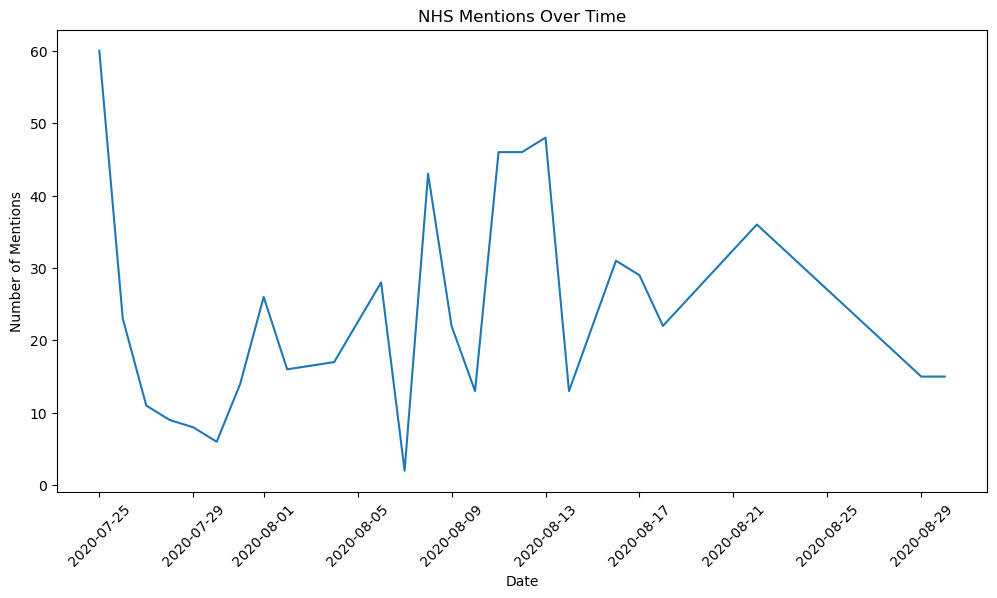

In [76]:
# Visualise the NHS mentions in the COVID-tweets
# Load the dataset
covid_tweets = pd.read_csv('covid19_tweets.csv')

# Convert the 'date' column to datetime
covid_tweets['date'] = pd.to_datetime(covid_tweets['date'])

# Function to check for mentions of NHS or National Health Service
def check_nhs(text):
    return 'nhs' in text.lower() or 'national health service' in text.lower()
    
# Apply the function to check for NHS mentions and create a new column
covid_tweets['nhs_mentioned'] = covid_tweets['text'].apply(check_nhs)

# Display the tweets mentioning NHS
nhs_mentions = covid_tweets[covid_tweets['nhs_mentioned'] == True]

# Count the number of tweets mentioning NHS
nhs_count = nhs_mentions.shape[0]
print(f"Number of tweets mentioning NHS or National Health Service: {nhs_count}")

# Display the first few rows of the NHS mentions
nhs_mentions.head()

# Optional: If you want to visualize the distribution of NHS mentions over time
import matplotlib.pyplot as plt

# Plot the number of NHS mentions over time
nhs_mentions_per_day = nhs_mentions['date'].dt.date.value_counts().sort_index()
plt.figure(figsize=(12, 6))
nhs_mentions_per_day.plot(kind='line')
plt.title('NHS Mentions Over Time')
plt.xlabel('Date')
plt.ylabel('Number of Mentions')
plt.xticks(rotation=45)
plt.show()

                                                                                                                                                    text  \
830          The NHS test and trace service will help to manage the risk of #Covid19. It's vital that employers play their part… https://t.co/Nspfj0tYuT   
831          The NHS test and trace service will help to manage the risk of #Covid19. It's vital that employers play their part… https://t.co/hPQMUcu6Pt   
884                 The latest government advice.\n\n@DHSCmedia @number10gov @MattHancock @BorisJohnson @NHS @NHSuk @NHSEngland… https://t.co/POCaVGi3Ak   
1092    #obesity means an increased risk of getting severe #COVID19 and hospitalised.  Our @DHSCgovuk &amp; @NHSuk has moderate… https://t.co/esp2EHXpvr   
1178                     #coronavirus #COVID19 \nWho and how often are these cleaned in the UK?\n@BBCClick @NHSuk @BorisJohnson… https://t.co/tirZVL9T6W   
...                                                             

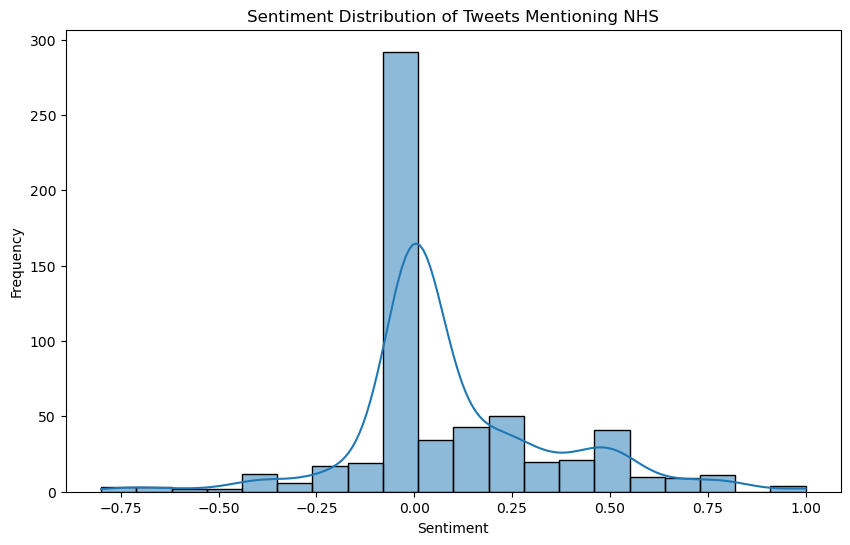

In [77]:
# Sentiment analysis of the COVID-tweets dataset
# Load the dataset
covid_tweets = pd.read_csv('covid19_tweets.csv')

# Convert the 'date' column to datetime
covid_tweets['date'] = pd.to_datetime(covid_tweets['date'])

# Function to check for mentions of NHS or National Health Service
def check_nhs(text):
    return 'nhs' in text.lower() or 'national health service' in text.lower()

# Apply the function to check for NHS mentions and create a new column
covid_tweets['nhs_mentioned'] = covid_tweets['text'].apply(check_nhs)

# Filter the tweets mentioning NHS
nhs_mentions = covid_tweets[covid_tweets['nhs_mentioned'] == True]

# Function to get sentiment
def get_sentiment(text):
    analysis = TextBlob(text)
    return analysis.sentiment.polarity

# Handle missing values in 'text' column
nhs_mentions['text'] = nhs_mentions['text'].fillna('')

# Apply the sentiment function to the 'text' column
nhs_mentions['sentiment'] = nhs_mentions['text'].apply(get_sentiment)

# Display the DataFrame with sentiment scores
print(nhs_mentions[['text', 'sentiment']])

# Visualize the sentiment distribution
plt.figure(figsize=(10, 6))
sns.histplot(nhs_mentions['sentiment'], bins=20, kde=True)
plt.title('Sentiment Distribution of Tweets Mentioning NHS')
plt.xlabel('Sentiment')
plt.ylabel('Frequency')
plt.show()


<a id="Question-6"></a>
#### Question 6: Was there adequate staff and capacity in the networks?
- See further staffing analysis under the regional analysis

#### Aggregated view of appointments by day of the week/month/season to infer staffing demands

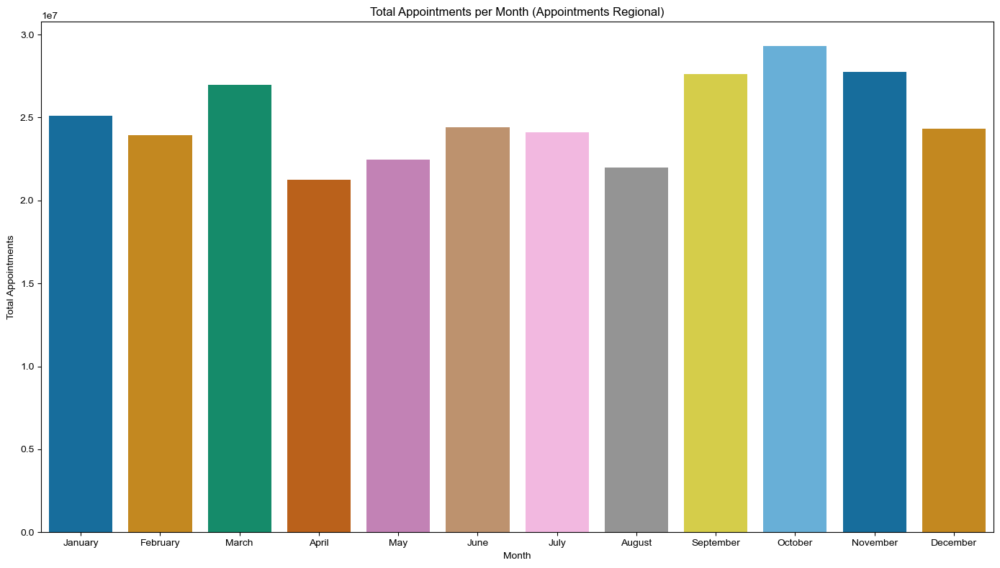

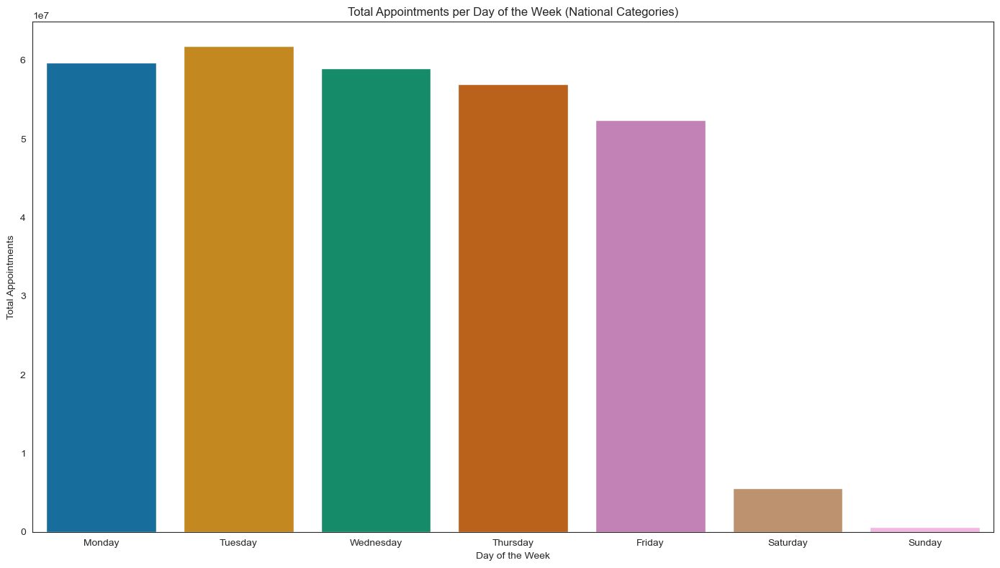

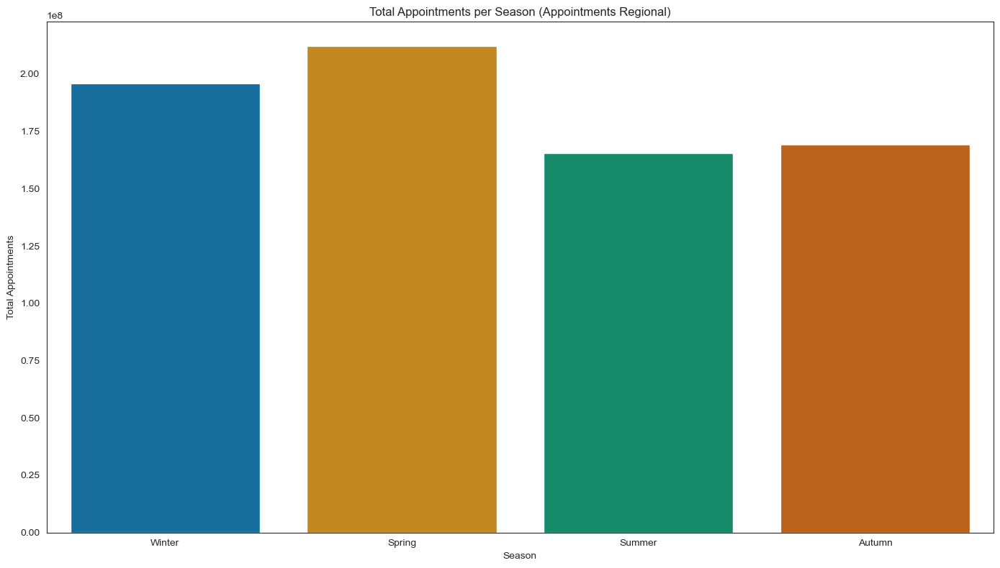

In [80]:
# Load the data
ar = pd.read_csv('scaled_appointments_regional.csv')
nc = pd.read_csv('scaled_national_categories.csv')

# If you would like to see the results with outliers values removed, load the filtered files.
#ar = pd.read_csv('filtered_appointments_regional.csv')
#nc = pd.read_csv('filtered_national_categories.csv')

# Ensure date columns are in datetime format
ar['appointment_month'] = pd.to_datetime(ar['appointment_month'], format='%Y-%m')
nc['appointment_date'] = pd.to_datetime(nc['appointment_date'])

# Extract month from appointment_date for nc datasets
nc['appointment_month'] = nc['appointment_date'].dt.to_period('M').dt.to_timestamp()


# Aggregate the data by month for ar dataset
monthly_appointments_ar = (
    ar.groupby('appointment_month')['count_of_appointments']
    .sum().reset_index())
monthly_appointments_ar.columns = ['month', 'total_appointments']

# Sort the months in calendar order
monthly_appointments_ar['month'] = (
    pd.to_datetime(monthly_appointments_ar['month']).dt.strftime('%B'))
months_order = ['January', 'February', 'March', 'April', 'May', 
                'June', 'July', 'August', 'September', 'October', 'November', 'December']
monthly_appointments_ar['month'] = pd.Categorical(monthly_appointments_ar['month'], 
                                                  categories=months_order, ordered=True)
monthly_appointments_ar = monthly_appointments_ar.sort_values('month')

# Plot total appointments per month
plt.figure(figsize=(14, 8))
sns.barplot(data=monthly_appointments_ar, x='month', y='total_appointments', 
            ci=None, palette='colorblind')
sns.set_style("white")
plt.title('Total Appointments per Month (Appointments Regional)')
plt.xlabel('Month')
plt.ylabel('Total Appointments')
plt.tight_layout()
plt.savefig('Appointments_by_month.png')
plt.show()

# Extract day of the week from appointment_date for nc dataset
nc['day_of_week'] = nc['appointment_date'].dt.day_name()

# Aggregate the data by day of the week for nc dataset
weekly_appointments_nc = (
    nc.groupby('day_of_week')['count_of_appointments']
    .sum().reset_index())
weekly_appointments_nc.columns = ['day_of_week', 'total_appointments']

# Sort the days of the week in order
days_order = ['Monday', 'Tuesday', 'Wednesday',
              'Thursday', 'Friday', 'Saturday', 'Sunday']
weekly_appointments_nc['day_of_week'] = pd.Categorical(weekly_appointments_nc['day_of_week'], 
                                                       categories=days_order, 
                                                       ordered=True)
weekly_appointments_nc = weekly_appointments_nc.sort_values('day_of_week')

# Plot total appointments per day of the week without error bars
plt.figure(figsize=(14, 8))
sns.barplot(data=weekly_appointments_nc, x='day_of_week', y='total_appointments',
            ci=None, palette='colorblind')
sns.set_style("white")
plt.title('Total Appointments per Day of the Week (National Categories)')
plt.xlabel('Day of the Week')
plt.ylabel('Total Appointments')
plt.tight_layout()
plt.savefig('Appointments_by_days_of_the_week.png')
plt.show()

# Define a function to get the season
def get_season(date):
    if date.month in [12, 1, 2]:
        return 'Winter'
    elif date.month in [3, 4, 5]:
        return 'Spring'
    elif date.month in [6, 7, 8]:
        return 'Summer'
    elif date.month in [9, 10, 11]:
        return 'Autumn'
    else:
        return 'No data found'

ar['season'] = ar['appointment_month'].apply(get_season)

# Aggregate the data by season for ar dataset
seasonal_appointments_ar = (
    ar.groupby('season')['count_of_appointments']
    .sum().reset_index())
seasonal_appointments_ar.columns = ['season', 'total_appointments']

# Plot total appointments per season
plt.figure(figsize=(14, 8))
sns.barplot(data=seasonal_appointments_ar, x='season', y='total_appointments', 
                 order=['Winter', 'Spring', 'Summer', 'Autumn'], palette='colorblind')
sns.set_style("white")
plt.title('Total Appointments per Season (Appointments Regional)')
plt.xlabel('Season')
plt.ylabel('Total Appointments')
plt.tight_layout()
plt.savefig('Appointments_by_season.png')
plt.show()

Results: The data doesn't directly include staffing information, but the highest level of appointments would indicate higher staffing demand. (Note monthly and seasonal data is from ar, whilst daily views are from nc)
- The most demanding days are Tuesdays whilst Friday is the least demanding weekday. There are very few appointments at the weekend, probably due to services not being fully operational at the weekends. (This is not affected by outlier values)
- The most demanding months are October, November, September, the least is April. (This pattern is slightly different when outliers are removed and September has the highest appointments)
- Spring is the most demanding season. (This is not affected by outlier values)

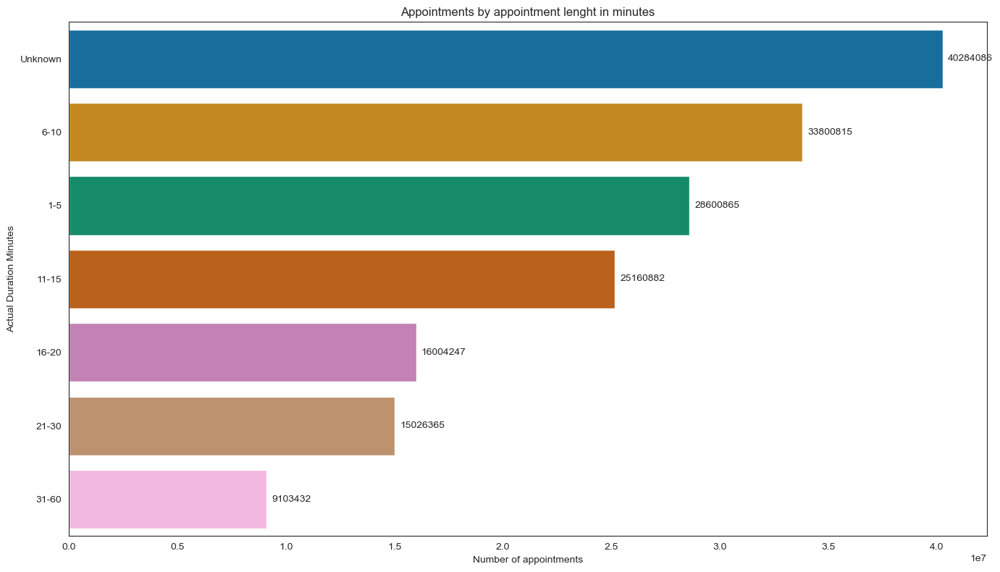

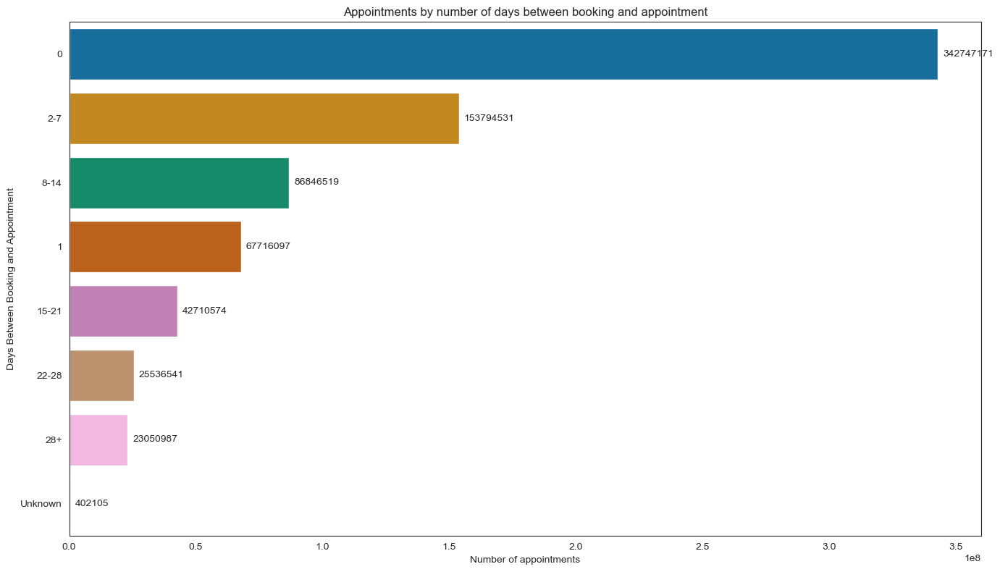

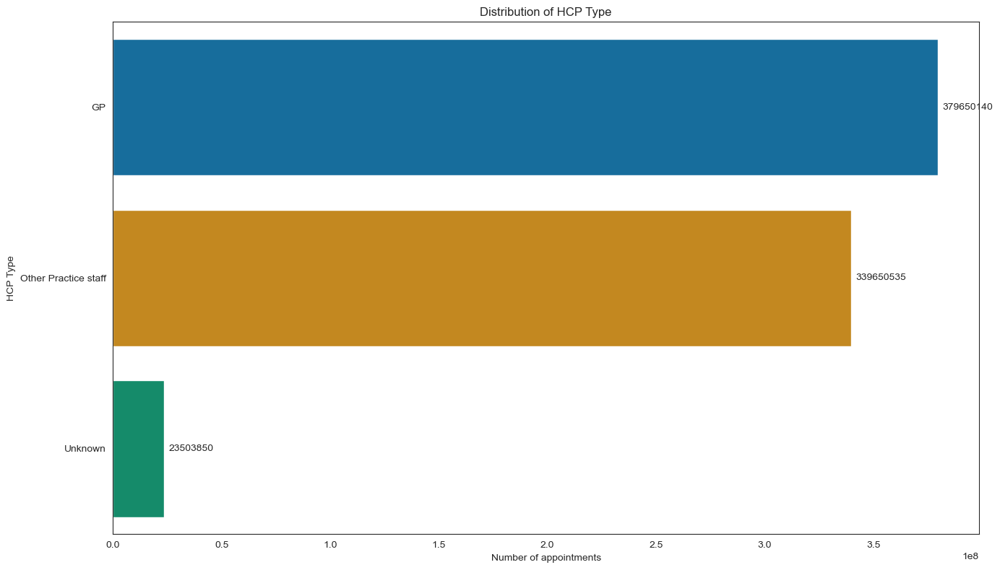

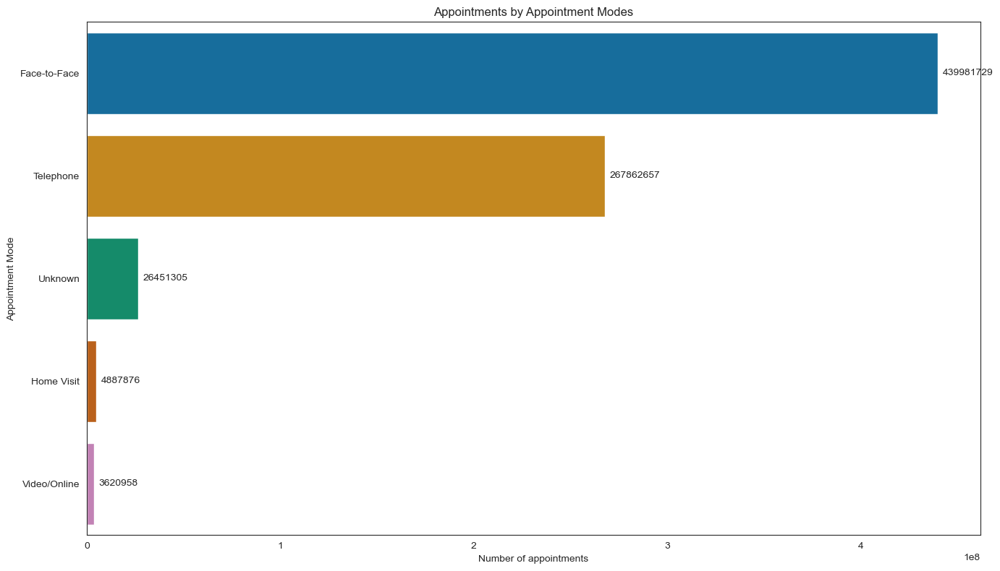

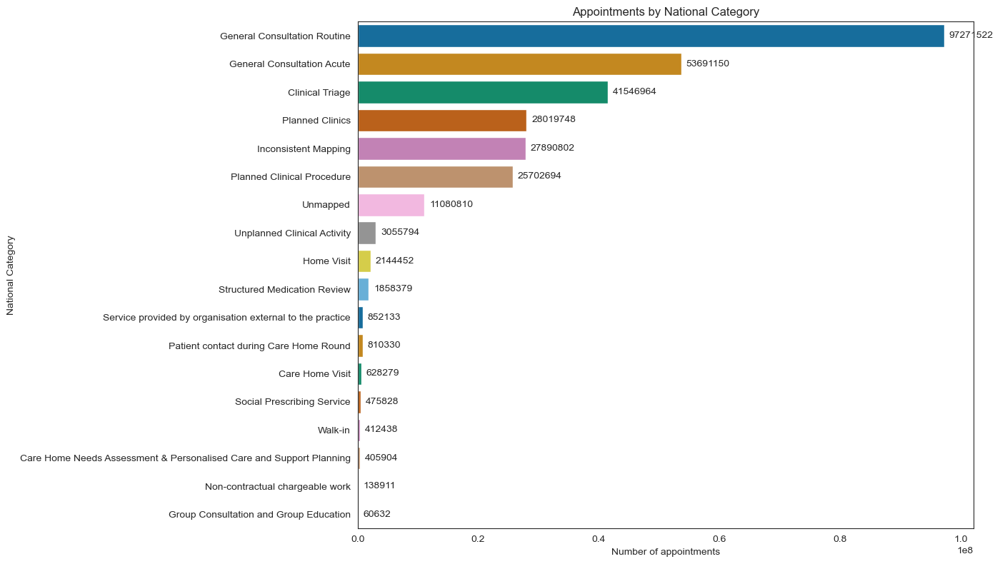

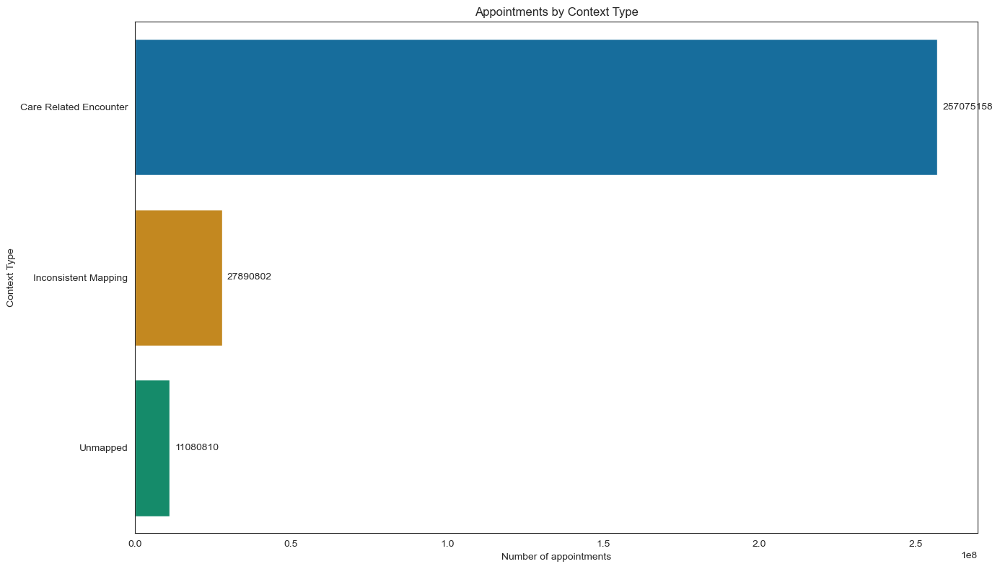

In [82]:
# Show inferred service demand based on all the available metrics within the data.
# Load the data
ad = pd.read_csv('scaled_actual_duration.csv')
ar = pd.read_csv('scaled_appointments_regional.csv')
nc = pd.read_csv('scaled_national_categories.csv')

# If you would like to see the results with outliers values removed,
# load the filtered files.
#ad = pd.read_csv('filtered_actual_duration.csv')
#ar = pd.read_csv('filtered_appointments_regional.csv')
#nc = pd.read_csv('filtered_national_categories.csv')

# Ensure date columns are in datetime format
ad['appointment_date'] = pd.to_datetime(ad['appointment_date'])
ar['appointment_month'] = pd.to_datetime(ar['appointment_month'], format='%Y-%m')
nc['appointment_date'] = pd.to_datetime(nc['appointment_date'])

# Extract month from appointment_date for ad and nc datasets
ad['appointment_month'] = ad['appointment_date'].dt.to_period('M').dt.to_timestamp()
nc['appointment_month'] = nc['appointment_date'].dt.to_period('M').dt.to_timestamp()

# Function to add counts on the bars
def add_counts(ax):
    for p in ax.patches:
        ax.annotate(f'{p.get_width():.0f}', 
                    (p.get_width(), p.get_y() + p.get_height() / 2),
                    ha='left', va='center', xytext=(5, 0), textcoords='offset points')

# Appointments by actual duration
appointments_by_duration = ad.groupby('actual_duration_minutes')\
['count_of_appointments'].sum().reset_index()
appointments_by_duration = appointments_by_duration.sort_values\
('count_of_appointments', ascending=False)

# Appointments by actual_duration_minutes in ad
plt.figure(figsize=(14, 8))
ax = sns.barplot(data=appointments_by_duration, y='actual_duration_minutes', 
                 x='count_of_appointments', palette='colorblind',
                 order=appointments_by_duration['actual_duration_minutes'])
add_counts(ax)
plt.title('Appointments by appointment lenght in minutes')
plt.ylabel('Actual Duration Minutes')
plt.xlabel('Number of appointments')
plt.tight_layout()
plt.show()

# Sum  of appointments by waiting time
appointments_by_waiting = ar.groupby('days_between_booking_and_appointment')\
['count_of_appointments'].sum().reset_index()
appointments_by_waiting = appointments_by_waiting.sort_values\
('count_of_appointments', ascending=False)

# appointments by days_between_booking_and_appointment in ar
plt.figure(figsize=(14, 8))
ax = sns.barplot(data=appointments_by_waiting, y='days_between_booking_and_appointment',
                 x='count_of_appointments', palette='colorblind',
                 order=appointments_by_waiting['days_between_booking_and_appointment'])
add_counts(ax)
plt.title('Appointments by number of days between booking and appointment')
plt.ylabel('Days Between Booking and Appointment')
plt.xlabel('Number of appointments')
plt.tight_layout()
plt.show()

# sum of appointments of each HCP type in ar
appointments_by_hcp_type = ar.groupby('hcp_type')\
['count_of_appointments'].sum().reset_index()
appointments_by_hcp_type = appointments_by_hcp_type.sort_values\
('count_of_appointments', ascending=False)

# Appointments by HCP type
plt.figure(figsize=(14, 8))
ax = sns.barplot(data=appointments_by_hcp_type, y='hcp_type', 
                 x='count_of_appointments', palette='colorblind',
                 order=appointments_by_hcp_type['hcp_type'])
add_counts(ax)
plt.title('Distribution of HCP Type')
plt.ylabel('HCP Type')
plt.xlabel('Number of appointments')
plt.tight_layout()
plt.show()

# Sum of appointments for each appointment mode in ar
appointment_by_modes = ar.groupby('appointment_mode')\
['count_of_appointments'].sum().reset_index()
appointment_by_modes = appointment_by_modes.sort_values\
('count_of_appointments', ascending=False)

# Appointments by appointment modes
plt.figure(figsize=(14, 8))
ax = sns.barplot(data=appointment_by_modes, y='appointment_mode', 
                 x='count_of_appointments', palette='colorblind',
                 order = appointment_by_modes['appointment_mode'])
add_counts(ax)
plt.title('Appointments by Appointment Modes')
plt.ylabel('Appointment Mode')
plt.xlabel('Number of appointments')
plt.tight_layout()
plt.show()

# sum of appointments of each national category in nc
appointments_by_national_category = nc.groupby('national_category')\
['count_of_appointments'].sum().reset_index()
appointments_by_national_category = appointments_by_national_category.sort_values\
('count_of_appointments', ascending=False)

# Appointments by national category
plt.figure(figsize=(14, 8))
ax = sns.barplot(data=appointments_by_national_category, y='national_category', 
                 x='count_of_appointments', palette='colorblind',
                 order = appointments_by_national_category['national_category'])
add_counts(ax)
plt.title('Appointments by National Category')
plt.ylabel('National Category')
plt.xlabel('Number of appointments')
plt.tight_layout()
plt.show()

# Sum of appointments for each context type in nc
appointments_by_context_type = nc.groupby('context_type')\
['count_of_appointments'].sum().reset_index()
appointments_by_context_type = appointments_by_context_type.sort_values\
('count_of_appointments', ascending=False) 

# Appointments by context type
plt.figure(figsize=(14, 8))
ax = sns.barplot(data=appointments_by_context_type, y='context_type',
                 x='count_of_appointments', palette='colorblind',
                 order = appointments_by_context_type['context_type'])
add_counts(ax)
plt.title('Appointments by Context Type')
plt.ylabel('Context Type')
plt.xlabel('Number of appointments')
plt.tight_layout()
plt.show()

Results:
- In terms of appointment length, the unknown length had the highest number of appointments, which can be a concern for the NHS. This was followed by 6-10 and 1-5 minutes. Therefore appointments under 10 minutes have the highest demand on staff. Whilst long duration of 31-60 minutes had the lowest count, which can question whether these long appointments could add demand on staff. (When outlier values were excluded unknown remained the highest category, followed by 1-5 minutes)
- Same day appointments were the highest, which can be a concern, this was followed by 2-7 days. (This result is unaffected by  outlier values)
- GP had highest number of appointments followed by other practice staff. This would have been useful to know how this differs per professionals rather than aggregated to know the exact demand on staff. (When outlier values are excluded Other practice staff had the highest appointemnt numbers)
- Face-to-face and telephone appointments were the highest. (unaffected by outlier values)
- As per the national category, General consultation routine had the highest appointments, followed by General Consultation acute and then clinical triage. (When removing outlier values inconsistent mapping was the highest)
- Care related encounter has the highest number of appointments (Unchanged by outlier values)

<a id="Question-7"></a>
#### Question 7: What was the actual utilisation of resources?
- Should the NHS start looking at increasing staff levels?


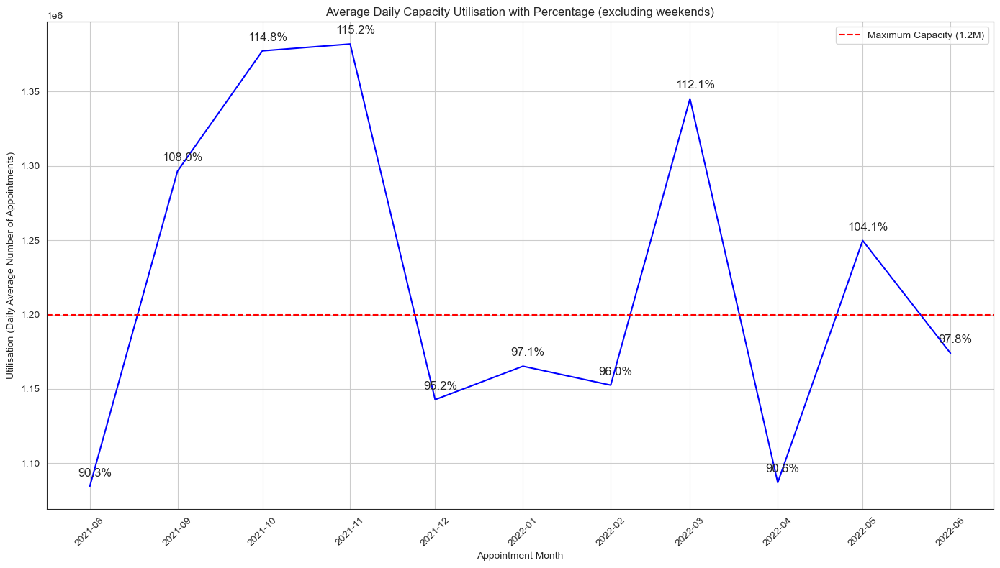

In [85]:
# Utilisation rate trends
# Load the dataset
ar = pd.read_csv('scaled_appointments_regional.csv')

# Filter data for dates from 2021-08 onwards
ar['appointment_month'] = pd.to_datetime(ar['appointment_month'])
ar_filtered = ar[ar['appointment_month'] >= '2021-08-01']

# Create the ar_agg DataFrame
ar_agg = (
    ar_filtered.groupby(['appointment_month', 'hcp_type', 'appointment_status', 
                         'appointment_mode', 
                         'time_between_book_and_appointment'])['count_of_appointments']
    .sum().reset_index())

# Determine average utilisation of services
ar_df = (
    ar_filtered.groupby('appointment_month')['count_of_appointments']
    .sum().reset_index())

# Calculate utilisation percentage - instead of 30 using 22 to exclude weekends to gain a more accurate view
ar_df['utilisation_%'] = (
    (ar_df['count_of_appointments'] / 22) / 1200000 * 100)  
     # percentage of maximum capacity
ar_df['utilisation_%'] = ar_df['utilisation_%'].round(1)

# Calculate utilisation - instead of 30 using 22 to exclude weekends to gain a more accurate view
ar_df['utilisation'] = (ar_df['count_of_appointments'] / 22)
ar_df['utilisation'] = ar_df['utilisation'].round(1)


# Plot utilisation (daily average)
plt.figure(figsize=(14, 8))
sns.lineplot(data=ar_df, x='appointment_month', y='utilisation', color='blue')

# Add maximum capacity line
plt.axhline(y=1200000, color='red', linestyle='--', label='Maximum Capacity (1.2M)')

# Annotate with percentage values
for idx, row in ar_df.iterrows():
    plt.annotate(f"{row['utilisation_%']}%", 
                 (row['appointment_month'], row['utilisation']),
                 textcoords="offset points",
                 xytext=(5,10),
                 ha='center',
                 fontsize=12)

plt.title('Average Daily Capacity Utilisation with Percentage (excluding weekends)')
plt.xlabel('Appointment Month')
plt.ylabel('Utilisation (Daily Average Number of Appointments)')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.grid(True)
plt.savefig('Average_daily_utilisation_with_percentage.png')
plt.show()

Number of days the 1.2 million threshold was breached: 175
Number of days the 1.2 million threshold was not breached: 159


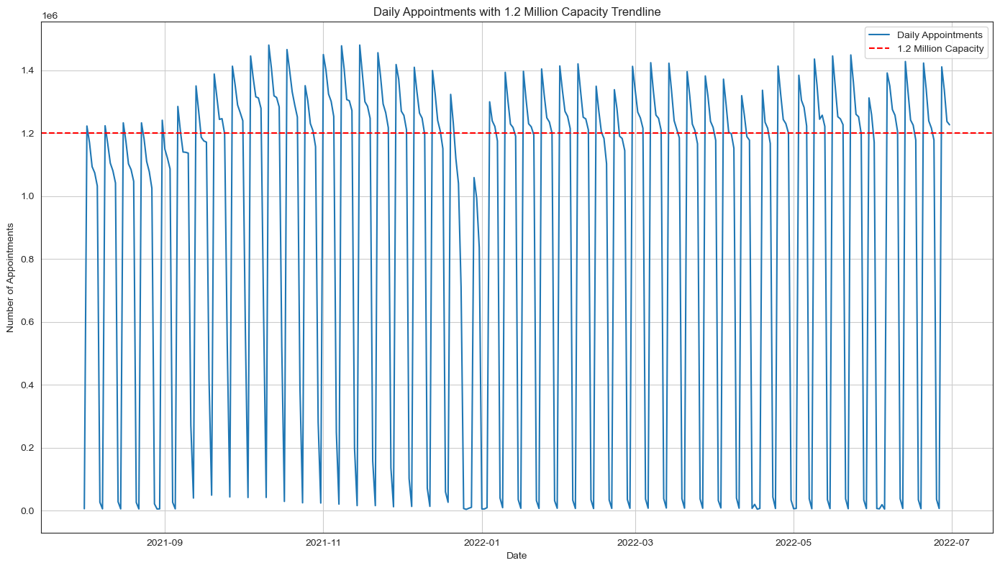

In [86]:
# Compare daily demands to the 1.2M appointment treshold
# Load the data
nc = pd.read_csv('scaled_national_categories.csv')

# Ensure the appointment_date column is in datetime format
nc['appointment_date'] = pd.to_datetime(nc['appointment_date'])

# Define the maximum capacity for appointments per day
max_capacity = 1200000

# Aggregate data by appointment_date to get daily counts
daily_appointments = (
    nc.groupby('appointment_date')['count_of_appointments']
    .sum().reset_index())

# Calculate the number of days when the threshold was breached and when it was not
days_breached = (
    daily_appointments[daily_appointments['count_of_appointments'] > max_capacity]
    .shape[0])
days_not_breached = (
    daily_appointments[daily_appointments['count_of_appointments'] <= max_capacity]
    .shape[0])

print(f"Number of days the 1.2 million threshold was breached: {days_breached}")
print(f"Number of days the 1.2 million threshold was not breached: {days_not_breached}")

# Plot the daily appointments
plt.figure(figsize=(14, 8))
plt.plot(daily_appointments['appointment_date'],
         daily_appointments['count_of_appointments'], 
         label='Daily Appointments')
plt.axhline(y=max_capacity, color='r', linestyle='--', label='1.2 Million Capacity')
plt.title('Daily Appointments with 1.2 Million Capacity Trendline')
plt.xlabel('Date')
plt.ylabel('Number of Appointments')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

Number of weekdays (excluding bank holidays) the 1.2 million threshold was breached: 175
Number of weekdays (excluding bank holidays) the 1.2 million threshold was not breached: 55


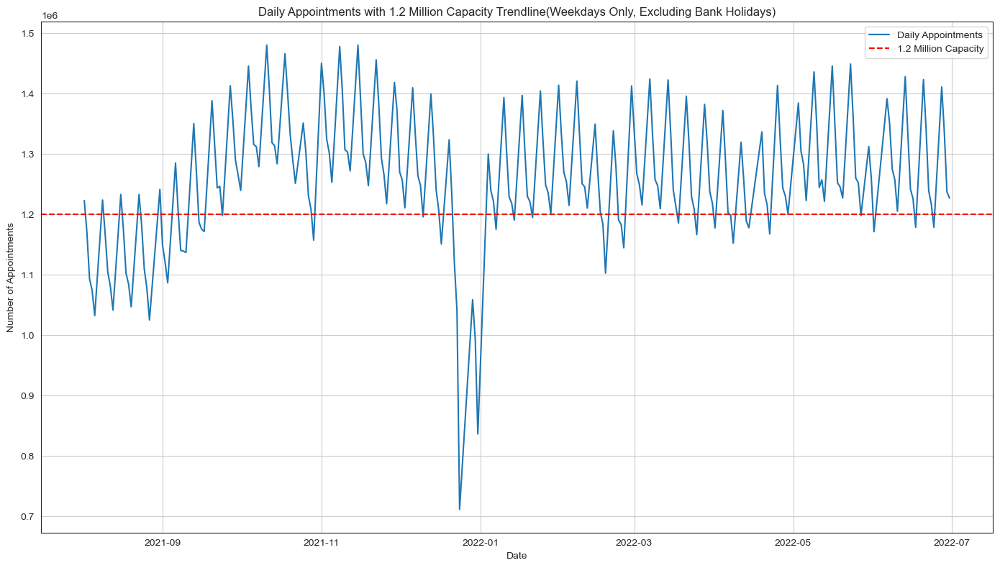

In [87]:
# Explore capacity excluding weekends and bank holidays
# Load the data
nc = pd.read_csv('scaled_national_categories.csv')

# Ensure the appointment_date column is in datetime format
nc['appointment_date'] = pd.to_datetime(nc['appointment_date'])

# Exclude weekends
nc['day_of_week'] = nc['appointment_date'].dt.dayofweek
nc = nc[~nc['day_of_week'].isin([5, 6])]   
# optional - exclude other weekday numbers to see which days of the week breach

# List of UK bank holidays from 2021 to 2022
uk_bank_holidays = [
    '2021-01-01', '2021-04-02', '2021-04-05', '2021-05-03', '2021-05-31', '2021-08-30',
    '2021-12-27', '2021-12-28', '2022-01-03', '2022-04-15', '2022-04-18', '2022-05-02',
    '2022-06-02', '2022-06-03', '2022-08-29'
]
# Convert the list to datetime
uk_bank_holidays = pd.to_datetime(uk_bank_holidays)

# Exclude bank holidays
nc = nc[~nc['appointment_date'].isin(uk_bank_holidays)]

# Define the maximum capacity for appointments per day
max_capacity = 1200000

# Aggregate data by appointment_date to get daily counts
daily_appointments = (
    nc.groupby('appointment_date')['count_of_appointments']
    .sum().reset_index())

# Calculate the number of days when the threshold was breached and when it was not
days_breached = (
    daily_appointments[daily_appointments['count_of_appointments'] > max_capacity]
    .shape[0])
days_not_breached = (
    daily_appointments[daily_appointments['count_of_appointments'] <= max_capacity]
    .shape[0])

print(f"Number of weekdays (excluding bank holidays) the 1.2 million threshold was breached: {days_breached}")
print(f"Number of weekdays (excluding bank holidays) the 1.2 million threshold was not breached: {days_not_breached}")

# Plot the daily appointments excluding weekends and bank holidays
plt.figure(figsize=(14, 8))
plt.plot(daily_appointments['appointment_date'], 
         daily_appointments['count_of_appointments'], label='Daily Appointments')
plt.axhline(y=max_capacity, color='r', linestyle='--', label='1.2 Million Capacity')
plt.title('Daily Appointments with 1.2 Million Capacity Trendline' 
          '(Weekdays Only, Excluding Bank Holidays)')
plt.xlabel('Date')
plt.ylabel('Number of Appointments')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig('weekday_utilisation_nc.png')
plt.show()


Results: When exploring the capacity of the services, when we looking at the monthly aggregated data NHS doesn't seem to reach the 1.2 M treshold and function at a capacity of betweeen 65.5%-84%. This is when weekends are included. When the monthly average is calculated by excluding the weekends,  the NHS breaches in many month and utilisations ranges between 90.3-115%. When we looked at the data on daily aggregation from the nc dataset, it appears that on 175 days vs 159 days this treshold was breached between 01/08/2021 and 30/06/2022. As there are only very limited appointments at the weekends and bank holidays the data was filtered to exclude weekends and bank holidays. Which meant that only on 55 weekdays within this period were not breached. 76% of the daily appointments breached the 1.2 M treshold.  

<a id="Question-8"></a>
#### Question 8: What insights can be gained by looking at missed appointments?
- Further missed appointment insight in the regional analysis

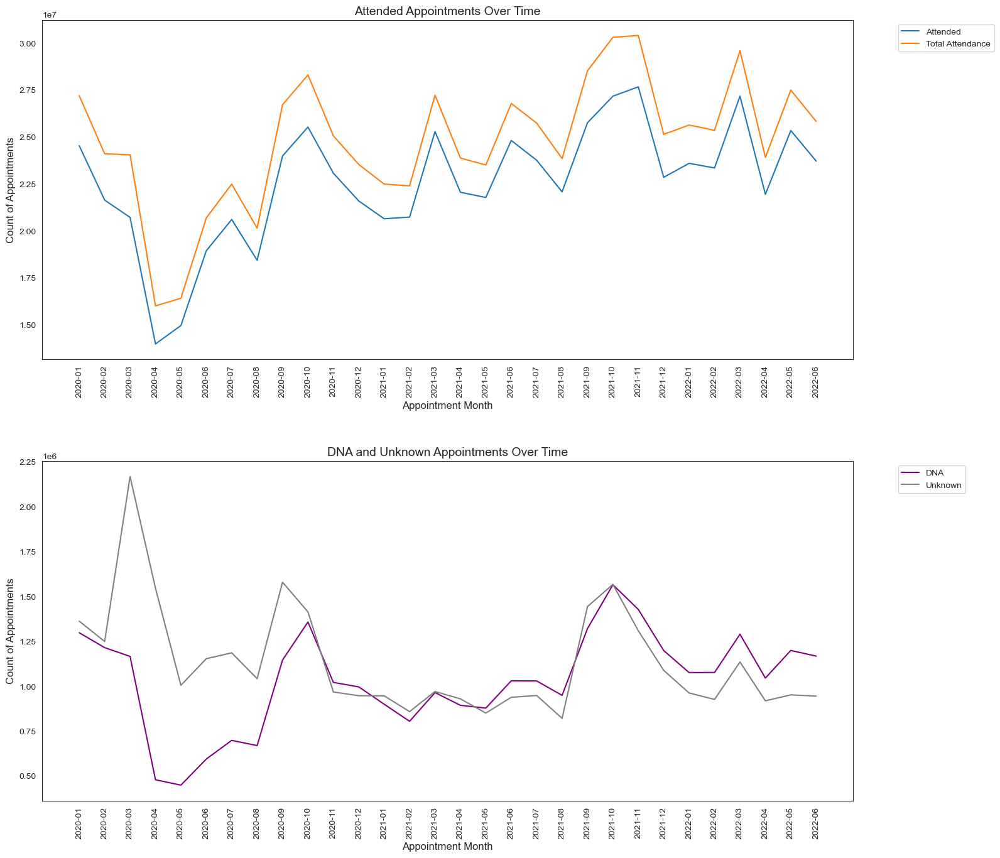

In [90]:
# Load the dataset
ar = pd.read_csv('scaled_appointments_regional.csv')

# Group by appointment_month and appointment_status, then sum the count_of_appointments
ar_grouped = ar.groupby(['appointment_month',
                         'appointment_status'])['count_of_appointments'].sum().reset_index()

# Split the data into two dataframes based on appointment_status
attended_df = ar_grouped[ar_grouped['appointment_status'] == 'Attended']
dna_unknown_df = ar_grouped[ar_grouped['appointment_status'].isin(['DNA', 'Unknown'])]

# Calculate the total attendance for each month
total_attendance_df = (
    ar_grouped.groupby('appointment_month')['count_of_appointments']
    .sum().reset_index())
total_attendance_df['appointment_status'] = 'Total Attendance'

# Combine the attended data with the total attendance data
attended_df = pd.concat([attended_df, total_attendance_df])

# Set up the subplot structure
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(16, 16))

# Plot for Attended appointments including total attendance
sns.lineplot(ax=axes[0], x='appointment_month', y='count_of_appointments',
             data=attended_df, hue='appointment_status', errorbar=None)
axes[0].set_title('Attended Appointments Over Time', fontsize=14)
axes[0].set_xlabel('Appointment Month', fontsize=12)
axes[0].set_ylabel('Count of Appointments', fontsize=12)
axes[0].tick_params(axis='x', rotation=90, labelsize=10)
axes[0].tick_params(axis='y', labelsize=10)
axes[0].legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)

# Define a color palette for DNA and Unknown
palette = {
    'DNA': 'purple',
    'Unknown': 'grey'
}

# Plot for DNA and Unknown appointments
sns.lineplot(ax=axes[1], x='appointment_month', y='count_of_appointments',
             data=dna_unknown_df, hue='appointment_status', palette=palette, 
             errorbar=None)
axes[1].set_title('DNA and Unknown Appointments Over Time', fontsize=14)
axes[1].set_xlabel('Appointment Month', fontsize=12)
axes[1].set_ylabel('Count of Appointments', fontsize=12)
axes[1].tick_params(axis='x', rotation=90, labelsize=10)
axes[1].tick_params(axis='y', labelsize=10)
axes[1].legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)

# Adjust layout and show the plots
plt.tight_layout()
plt.subplots_adjust(bottom=0.2, hspace=0.3)  
# Adjust bottom margin and space between plots
plt.savefig('Appointment_status_insights.png')
plt.show()

Insights from missed appointments: 
- prior to the lockdown high unknown appointments are apparent, due to potential staffing issues or appointment handling during COVID.
- During high appointment levels in 10-11/2021 there is also increased levels of DNA and unkown appointments

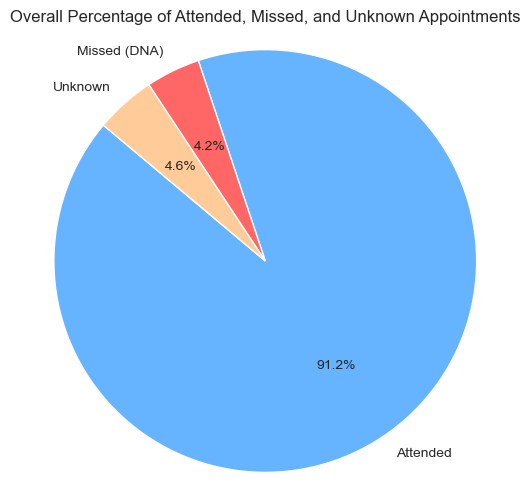

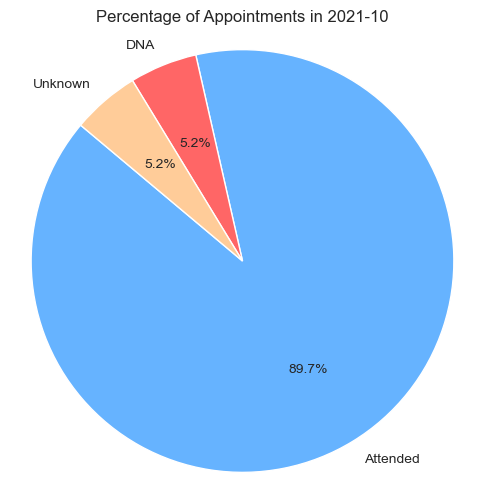

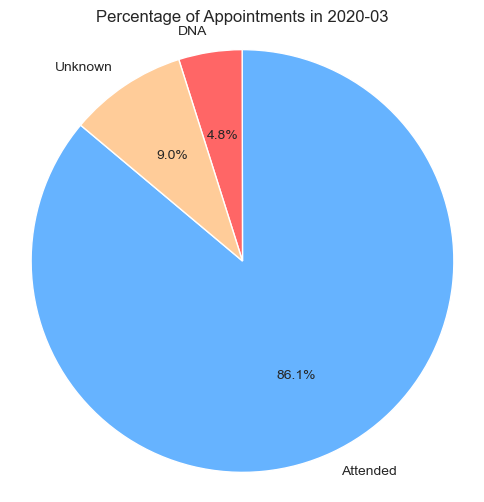

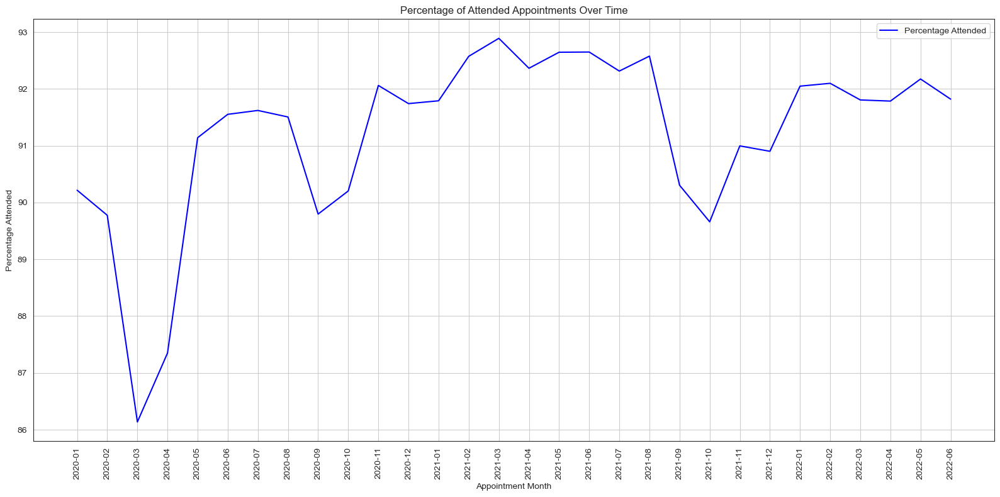

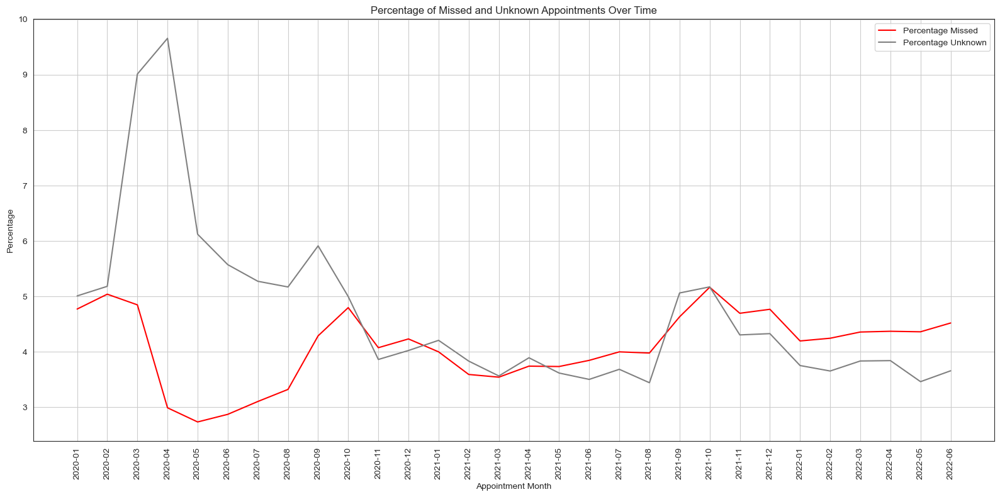

In [92]:
# Calculate the missed appointments as a percentage 
# Load the dataset
ar = pd.read_csv('scaled_appointments_regional.csv')

# Group by appointment_month and appointment_status, then sum the count_of_appointments
ar_grouped = (
    ar.groupby(['appointment_month', 'appointment_status'])['count_of_appointments']
    .sum().reset_index())

# Calculate the total number of attended, missed, and unknown appointments
total_attended = (
    ar_grouped[ar_grouped['appointment_status'] == 'Attended']['count_of_appointments']
    .sum())
total_missed = (
    ar_grouped[ar_grouped['appointment_status'] == 'DNA']['count_of_appointments']
    .sum())
total_unknown = (
    ar_grouped[ar_grouped['appointment_status'] == 'Unknown']['count_of_appointments']
    .sum())

# Plot the overall pie chart
labels = ['Attended', 'Missed (DNA)', 'Unknown']
sizes = [total_attended, total_missed, total_unknown]
colors = ['#66b3ff', '#ff6666', '#ffcc99']

plt.figure(figsize=(6, 6))
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=140)
plt.axis('equal')
plt.title('Overall Percentage of Attended, Missed, and Unknown Appointments')
plt.savefig('overall_appointments_pie_chart.png')
plt.show()

# Create pie charts for specific months (October 2021 and March 2020)
specific_months = ['2021-10', '2020-03']

for month in specific_months:
    month_data = ar_grouped[ar_grouped['appointment_month'].str.startswith(month)]
    total_monthly = month_data['count_of_appointments'].sum()
    month_data['percentage'] = (month_data['count_of_appointments'] / total_monthly) * 100

    plt.figure(figsize=(6, 6))
    plt.pie(month_data['count_of_appointments'], 
            labels=month_data['appointment_status'], colors=colors, 
            autopct='%1.1f%%', startangle=140)
    plt.axis('equal')
    plt.title(f'Percentage of Appointments in {month}')
    plt.savefig(f'appointments_pie_chart_{month}.png')
    plt.show()

# Calculate percentages over time
total_appointments_by_month = (
    ar_grouped.groupby('appointment_month')['count_of_appointments']
    .sum().reset_index())
attended_by_month = ar_grouped[ar_grouped['appointment_status'] == 'Attended']
missed_by_month = ar_grouped[ar_grouped['appointment_status'] == 'DNA']
unknown_by_month = ar_grouped[ar_grouped['appointment_status'] == 'Unknown']

attended_by_month = attended_by_month.merge(total_appointments_by_month, 
                                            on='appointment_month', suffixes=('', '_total'))
attended_by_month['percentage_attended'] = (
    (attended_by_month['count_of_appointments'] / 
     attended_by_month['count_of_appointments_total']) * 100)

missed_by_month = missed_by_month.merge(total_appointments_by_month, 
                                        on='appointment_month', suffixes=('', '_total'))
missed_by_month['percentage_missed'] = (
    (missed_by_month['count_of_appointments'] / 
     missed_by_month['count_of_appointments_total']) * 100)

unknown_by_month = (
    unknown_by_month.merge(total_appointments_by_month, 
                           on='appointment_month', suffixes=('', '_total')))
unknown_by_month['percentage_unknown'] = (
    (unknown_by_month['count_of_appointments'] / 
     unknown_by_month['count_of_appointments_total']) * 100)

# Plot the percentage line chart for Attended appointments
plt.figure(figsize=(16, 8))
sns.lineplot(x='appointment_month', y='percentage_attended', 
             data=attended_by_month, label='Percentage Attended', color='blue')
plt.title('Percentage of Attended Appointments Over Time')
plt.xlabel('Appointment Month')
plt.ylabel('Percentage Attended')
plt.xticks(rotation=90)
plt.legend(loc='upper right')
plt.grid(True)
plt.tight_layout()
plt.savefig('percentage_attended_line_chart.png')
plt.show()

# Plot the percentage line chart for Missed and Unknown appointments
plt.figure(figsize=(16, 8))
sns.lineplot(x='appointment_month', y='percentage_missed', 
             data=missed_by_month, label='Percentage Missed', color='red')
sns.lineplot(x='appointment_month', y='percentage_unknown', 
             data=unknown_by_month, label='Percentage Unknown', color='grey')
plt.title('Percentage of Missed and Unknown Appointments Over Time')
plt.xlabel('Appointment Month')
plt.ylabel('Percentage')
plt.xticks(rotation=90)
plt.legend(loc='upper right')
plt.grid(True)
plt.tight_layout()
plt.savefig('percentage_missed_unknown_line_chart.png')
plt.show()


In [93]:
# Total missed appointments over the 30 month average
missed_by_month = ar_grouped[ar_grouped['appointment_status'] == 'DNA']
missed_by_month['count_of_appointments'].sum()/30

1030374.4333333333

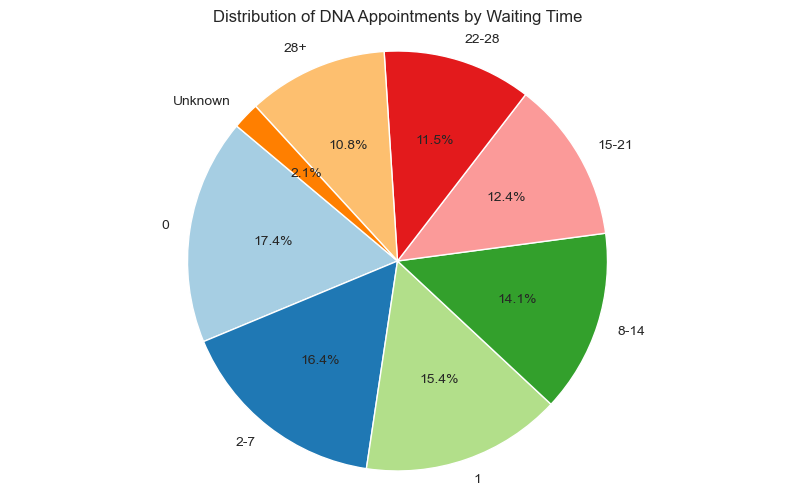

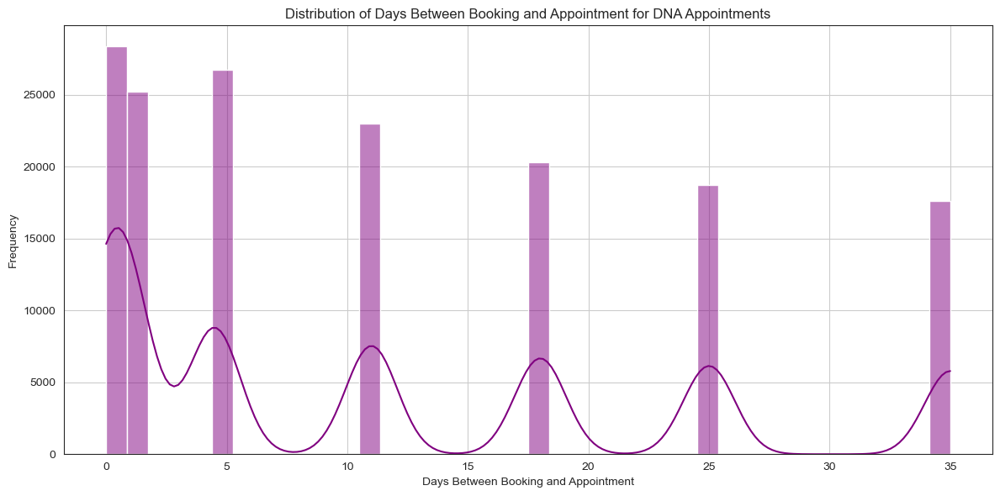

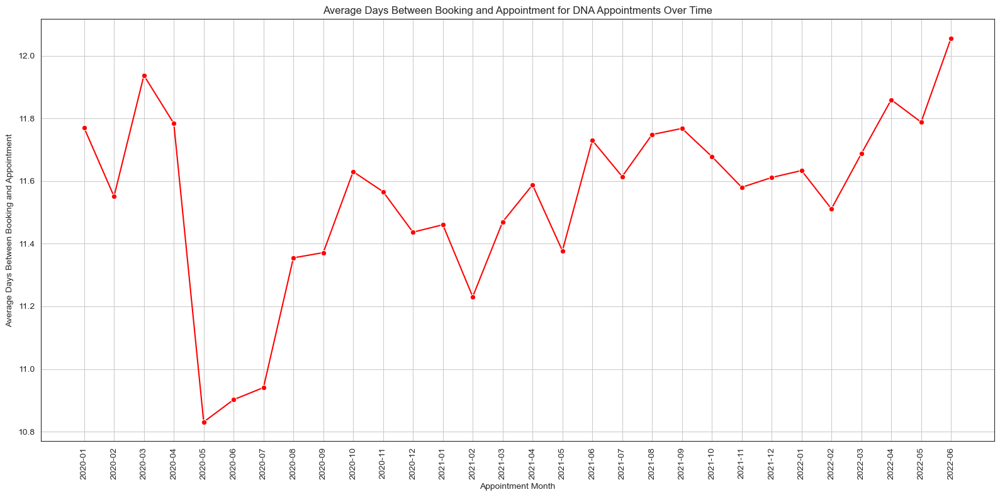

Correlation between days between booking and appointment and DNA appointments: -0.06686322305477425


In [94]:
# Examine the DNA appointments by waiting time
# Load the dataset
ar = pd.read_csv('scaled_appointments_regional.csv')

# Filter the data for DNA appointments
dna_appointments = ar[ar['appointment_status'] == 'DNA']

# Drop rows with missing values in the 'days_between_booking_and_appointment' column
dna_appointments = (
    dna_appointments.dropna(subset=['days_between_booking_and_appointment']))

# Define a mapping from categorical to numeric values
waiting_time_mapping = {
    '0': 0,
    '1': 1,
    '2-7': 4.5,  # average value of the range
    '8-14': 11,
    '15-21': 18,
    '22-28': 25,
    '28+': 35  # Assuming 35 as a rough estimate
}

# Map the 'days_between_booking_and_appointment' to numeric values
dna_appointments['days_between_booking_and_appointment_numeric'] = (
    dna_appointments['days_between_booking_and_appointment'].map(waiting_time_mapping))

# Group by waiting times and count the number of DNA appointments
dna_waiting_time_distribution = (
    dna_appointments['days_between_booking_and_appointment'].value_counts())

# Plot a pie chart
plt.figure(figsize=(10, 6))
plt.pie(dna_waiting_time_distribution, labels=dna_waiting_time_distribution.index, 
        autopct='%1.1f%%', startangle=140, colors=plt.cm.Paired.colors)
plt.title('Distribution of DNA Appointments by Waiting Time')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.savefig('dna_waiting_time_distribution.png')
plt.show()

# Plot the distribution of days between booking and appointment for DNA appointments
plt.figure(figsize=(12, 6))
sns.histplot(dna_appointments['days_between_booking_and_appointment_numeric'], 
             bins=40, kde=True, color='purple')
plt.title('Distribution of Days Between Booking and Appointment for DNA Appointments')
plt.xlabel('Days Between Booking and Appointment')
plt.ylabel('Frequency')
plt.grid(True)
plt.tight_layout()
plt.savefig('dna_days_between_booking_and_appointment_distribution.png')
plt.show()

# Aggregate the data to calculate the average days between booking and appointment for DNA appointments over time
dna_appointments_avg = (
    dna_appointments
    .groupby('appointment_month')['days_between_booking_and_appointment_numeric']
    .mean().reset_index())

# Plot the average days between booking and appointment for DNA appointments over time
plt.figure(figsize=(16, 8))
sns.lineplot(x='appointment_month', y='days_between_booking_and_appointment_numeric', 
             data=dna_appointments_avg, color='red', marker='o')
plt.title('Average Days Between Booking and Appointment for DNA Appointments Over Time')
plt.xlabel('Appointment Month')
plt.ylabel('Average Days Between Booking and Appointment')
plt.xticks(rotation=90)
plt.grid(True)
plt.tight_layout()
plt.savefig('average_days_between_booking_and_appointment_dna.png')
plt.show()

# Calculate the correlation between days between booking and appointment and DNA appointments
correlation = (
    dna_appointments[['days_between_booking_and_appointment_numeric', 
                      'count_of_appointments']].corr().iloc[0, 1])
print(f'Correlation between days between booking and appointment and DNA appointments: {correlation}')


The correlation value of -0.06686322305477425 indicates a very weak negative correlation between the number of days between booking and the appointment and the DNA (Did Not Attend) appointments. This suggests that as the waiting time increases, there is a very slight tendency for the DNA appointments to decrease, but this relationship is extremely weak.

<a id="Question-9"></a>
#### Question 9: What other patterns are visible in the data relating to the use case?
- Insights into average wait times
- Insights into average appointment lenght
- Appointment mode over time

Average waiting time: 11.88 days


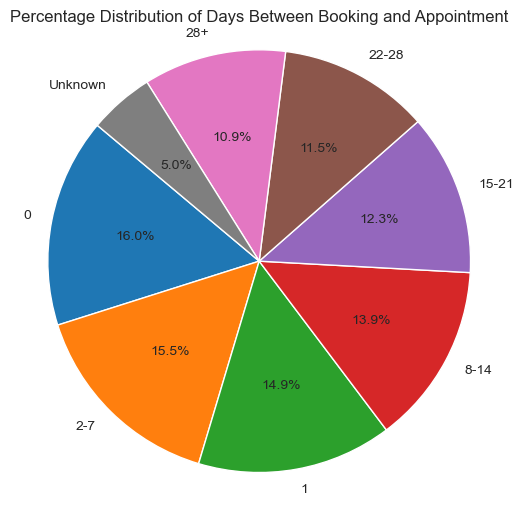

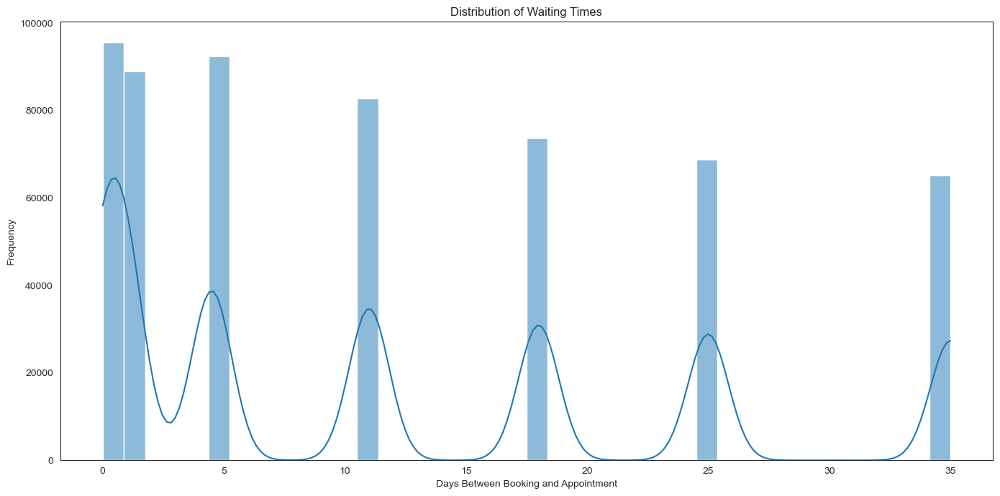

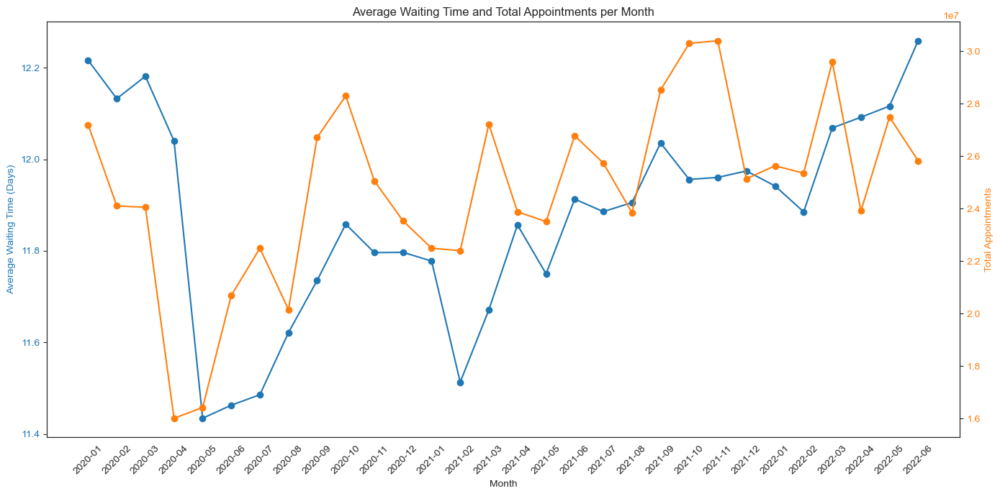

In [97]:
#Calculate the average wait times:
#Note there is only categorical data available within the dataset.
# Load the data
ar = pd.read_csv('scaled_appointments_regional.csv')

# If you would like to see the results with outliers values removed, 
# load the filtered files.
#ar = pd.read_csv('filtered_appointments_regional.csv')

# Ensure date columns are in datetime format
ar['appointment_month'] = pd.to_datetime(ar['appointment_month'], format='%Y-%m')

# Define a mapping from categorical to numeric values
waiting_time_mapping = {
    '0': 0,
    '1': 1,
    '2-7': 4.5,  # average value of the range
    '8-14': 11,
    '15-21': 18,
    '22-28': 25,
    '28+': 35  # Assuming 35 as a rough estimate
}

# Map the categorical waiting times to numeric values
ar['days_between_booking_and_appointment_numeric'] = (
    ar['days_between_booking_and_appointment']
    .map(waiting_time_mapping))

# Calculate the average waiting time
average_waiting_time = ar['days_between_booking_and_appointment_numeric'].mean()
print(f"Average waiting time: {average_waiting_time:.2f} days")

# Calculate the percentage distribution of the different day categories
day_category_counts = ar['days_between_booking_and_appointment'].value_counts()
day_category_percentages = (day_category_counts / day_category_counts.sum()) * 100

# Plot the pie chart
plt.figure(figsize=(6, 6))
plt.pie(day_category_percentages, labels=day_category_percentages.index, 
        autopct='%1.1f%%', startangle=140)
plt.title('Percentage Distribution of Days Between Booking and Appointment')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.savefig('Wait_times_pie_chart.png')
plt.show()

# Visualize the distribution of waiting times
plt.figure(figsize=(14, 7))
sns.histplot(ar['days_between_booking_and_appointment_numeric'], bins=40, kde=True)
plt.title('Distribution of Waiting Times')
plt.xlabel('Days Between Booking and Appointment')
plt.ylabel('Frequency')
plt.tight_layout()
plt.savefig('distribution_of_wait_times.png')
plt.show()

# Aggregate the average waiting time and total appointments by month
monthly_stats = ar.groupby('appointment_month').agg(
    average_waiting_time=('days_between_booking_and_appointment_numeric', 'mean'),
    total_appointments=('count_of_appointments', 'sum')
).reset_index()

# Convert appointment_month to string format for plotting
monthly_stats['appointment_month'] = (
    monthly_stats['appointment_month'].dt.strftime('%Y-%m'))

# Plot the average waiting time and total appointments per month
fig, ax1 = plt.subplots(figsize=(14, 7))

ax1.set_title('Average Waiting Time and Total Appointments per Month')
ax1.set_xlabel('Month')
ax1.set_ylabel('Average Waiting Time (Days)', color='tab:blue')
ax1.plot(monthly_stats['appointment_month'],
         monthly_stats['average_waiting_time'], color='tab:blue', marker='o')
ax1.tick_params(axis='y', labelcolor='tab:blue')
plt.xticks(rotation=45)

# Create a second y-axis to show the total number of appointments
ax2 = ax1.twinx()
ax2.set_ylabel('Total Appointments', color='tab:orange')
ax2.plot(monthly_stats['appointment_month'],
         monthly_stats['total_appointments'], color='tab:orange', marker='o')
ax2.tick_params(axis='y', labelcolor='tab:orange')

fig.tight_layout()
plt.xticks(rotation=45)
plt.savefig('average_wait_time_trends.png')
plt.show()


Results: 
- 16 % of appointments are same-day appointments
- The average waiting time is 12 days. (This is when 28+ is assumed to be 35. If we increase this to 60, then the average wait time is 15 days, if we further increase it to 120, then the average wait time would be 22 days)
- 2020/05 had the lowest average waiting times, while 2022/06 was the highest.
- The graphs show strong relationships between the number of appointments and the average wait times. The higher the number of appointments the longer the average wait times. The two trend lines show a very similar pattern.
- Trendlines Interpretation:
Average Waiting Time:
- March 2020: The average waiting time decreased significantly, possibly due to the initial COVID-19 lockdowns reducing the number of non-urgent appointments.
- Mid-2020 to Early 2021: Fluctuations likely due to changes in healthcare policy, COVID-19 waves, and vaccine rollouts.
- Early 2022: Slight increase in waiting times as healthcare services started to manage backlogs.
Total Number of Appointments:
- March 2020: Sharp decline in the number of appointments, corresponding with the initial COVID-19 lockdown.
- Mid-2020 to Early 2021: Recovery period with peaks and troughs possibly due to changes in COVID-19 restrictions and healthcare demands.
- Late 2021 to Early 2022: Another increase in the number of appointments, likely reflecting efforts to clear backlogs and manage routine healthcare needs.

#### Calculate the average appointment length: 
Note there is only categorical data available within the dataset.

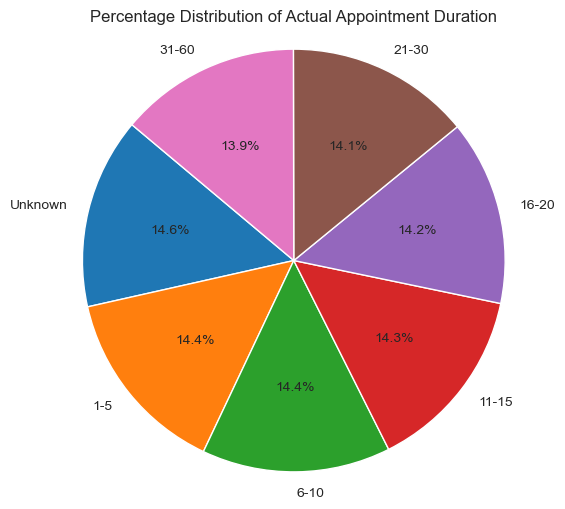

In [100]:
# Load the data
ad = pd.read_csv('scaled_actual_duration.csv')

# If you would like to see the results with outliers values removed, load the filtered files.
#ad = pd.read_csv('filtered_actual_duration.csv')

# Define a mapping from categorical to numeric values for actual_duration_minutes
duration_mapping = {
    '1-5': 3,
    '6-10': 8,
    '11-15': 13,
    '16-20': 18,
    '21-30': 25,
    '31-60': 45,
    '60+': 60  # Assuming 60 as a rough estimate
}

# Map the categorical durations to numeric values
ad['actual_duration_numeric'] = ad['actual_duration_minutes'].map(duration_mapping)

# Calculate the percentage distribution of the different duration categories
duration_category_counts = ad['actual_duration_minutes'].value_counts()
duration_category_percentages =(
    (duration_category_counts / duration_category_counts.sum()) * 100)

# Plot the pie chart
plt.figure(figsize=(6, 6))
plt.pie(duration_category_percentages, labels=duration_category_percentages.index, 
        autopct='%1.1f%%', startangle=140)
plt.title('Percentage Distribution of Actual Appointment Duration')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.savefig('Appointment_lenght_pie_chart.png')
plt.show()


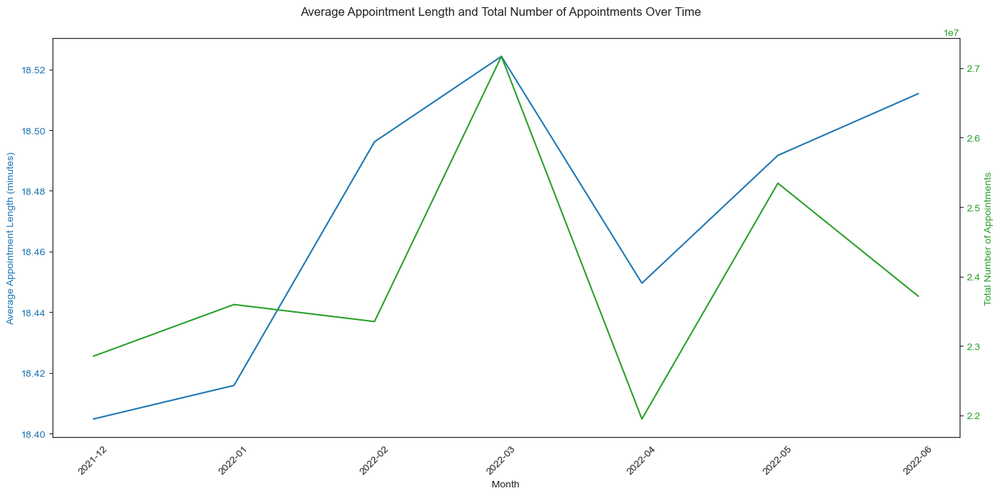

In [101]:
# Load the cleaned data
ad = pd.read_csv('cleaned_actual_duration.csv')

# If you would like to see the results with outliers values removed, load the filtered files.
#ad = pd.read_csv('filtered_actual_duration.csv')

# Define a mapping from categorical to numeric values for actual_duration_minutes
duration_mapping = {
    '1-5': 3,
    '6-10': 8,
    '11-15': 13,
    '16-20': 18,
    '21-30': 25,
    '31-60': 45,
    '60+': 70  # Assuming 70 as a rough estimate
}

# Map the categorical durations to numeric values
ad['actual_duration_numeric'] = ad['actual_duration_minutes'].map(duration_mapping)

# Ensure appointment_date is in datetime format
ad['appointment_date'] = pd.to_datetime(ad['appointment_date'])

# Extract the month for aggregation
ad['appointment_month'] = ad['appointment_date'].dt.to_period('M').dt.to_timestamp()

# Aggregate data by month to get the average duration and total number of appointments
monthly_avg_duration = (
    ad.groupby('appointment_month')['actual_duration_numeric'].mean().reset_index())
monthly_total_appointments = (
    ad.groupby('appointment_month')['count_of_appointments'].sum().reset_index())

# Plot the trend lines with two y-axes
fig, ax1 = plt.subplots(figsize=(14, 7))

# Plot average appointment length
ax1.set_xlabel('Month')
ax1.set_ylabel('Average Appointment Length (minutes)', color='tab:blue')
ax1.plot(monthly_avg_duration['appointment_month'], 
         monthly_avg_duration['actual_duration_numeric'], 
         color='tab:blue', label='Average Appointment Length')
ax1.tick_params(axis='y', labelcolor='tab:blue')
ax1.set_xticklabels(
    monthly_avg_duration['appointment_month']
    .dt.strftime('%Y-%m'), rotation=45)

# Create a second y-axis to plot total number of appointments
ax2 = ax1.twinx()
ax2.set_ylabel('Total Number of Appointments', color='tab:green')
ax2.plot(monthly_total_appointments['appointment_month'], 
         monthly_total_appointments['count_of_appointments'], 
         color='tab:green', label='Total Number of Appointments')
ax2.tick_params(axis='y', labelcolor='tab:green')

# Add a title
fig.suptitle('Average Appointment Length and Total Number of Appointments Over Time')

# Show the plot
fig.tight_layout()
plt.savefig('Average_Appointment_lenght_line_chart.png')
plt.show()


In [102]:
# Code to merge data, due to computer's memory issues unable to execute the merge.
# Load the data
#ad = pd.read_csv('scaled_actual_duration.csv')
#ar = pd.read_csv('scaled_appointments_regional.csv')
#nc = pd.read_csv('scaled_national_categories.csv')

# Convert the appointment date to datetime to group by month later
#ad['appointment_month'] = pd.to_datetime(ad['appointment_date']).dt.to_period('M')

# Define a mapping from categorical to numeric values for actual_duration_minutes
#duration_mapping = {
    #'1-5': 3,
    #'6-10': 8,
    #'11-15': 13,
    #'16-20': 18,
    #'21-30': 25,
    #'31-60': 45,
    #'60+': 70  # Assuming 70 as a rough estimate}

# Map the categorical durations to numeric values
#ad['actual_duration_numeric'] = ad['actual_duration_minutes'].map(duration_mapping)

# Group by month and icb_ons_code, then aggregate the actual duration
#ad_monthly = ad.groupby(['appointment_month', 'icb_ons_code'])['actual_duration_numeric'].mean().reset_index()

# Convert the appointment_month in ar1 and nc1 to period[M] to match ad_monthly
#ar['appointment_month'] = pd.to_datetime(ar['appointment_month']).dt.to_period('M')
#nc['appointment_month'] = pd.to_datetime(nc['appointment_month']).dt.to_period('M')

# Select necessary columns from ar and nc dataframes
#ar1 = ar[['appointment_month', 'icb_ons_code', 'hcp_type']]
#nc1 = nc[['appointment_month', 'icb_ons_code', 'national_category']]

# First, merge ad_monthly with ar1 on icb_ons_code and appointment_month
#merged_data1 = pd.merge(ad_monthly, ar1, on=['appointment_month', 'icb_ons_code'], how='inner')

# Then, merge the result with nc1 on icb_ons_code and appointment_month
#final_merged_data = pd.merge(merged_data1, nc1, on=['appointment_month', 'icb_ons_code'], how='inner')

#look at the relationship between the average appointment duration, HCP type, and national category

# Group by HCP type and national category to get average appointment duration
#hcp_category_analysis = final_merged_data.groupby(['hcp_type', 'national_category'])['actual_duration_numeric'].mean().reset_index()

# Display the results
#print(hcp_category_analysis)

# Plotting the average appointment duration by HCP type and national category
#plt.figure(figsize=(14, 8))
#sns.barplot(data=hcp_category_analysis, x='hcp_type', y='actual_duration_numeric', hue='national_category')
#plt.title('Average Appointment Duration by HCP Type and National Category')
#plt.xlabel('HCP Type')
#plt.ylabel('Average Appointment Duration (Minutes)')
#plt.legend(title='National Category')
#plt.grid(True)
#plt.tight_layout()
#plt.show()


Results: 
- All the different appointment lenghts accounts for around 14% of the data.
- The average appointment lenght and the total number of appointments have similar trends.
- January 2022 to March 2022: Both the average appointment length and the total number of appointments rise steadily, reaching a peak in March 2022.
March 2022 to April 2022: There is a sharp drop in both metrics. This could indicate a possible disruption or change in appointment scheduling or handling during this period.
April 2022 to June 2022: After the drop, both metrics begin to rise again, although the average appointment length recovers more consistently compared to the total number of appointments, which shows a dip in May 2022 before rising again in June 2022.

In [104]:
# merge was performed in pgAdmin. Analyse nc and ad merge of daily data
merged1 = pd.read_csv('merged_ad_nc.csv')
merged1.head()

,sub_icb_location_name,actual_duration,service_setting,context_type,national_category,count_of_appointments,appointment_date
0,NHS Staffordshire and Stoke-on-Trent ICB - 04Y,1-5 Minutes,Primary Care Network,Care Related Encounter,Unplanned Clinical Activity,10,2022-05-03
1,NHS Staffordshire and Stoke-on-Trent ICB - 04Y,1-5 Minutes,Primary Care Network,Care Related Encounter,Structured Medication Review,9,2022-05-03
2,NHS Staffordshire and Stoke-on-Trent ICB - 04Y,1-5 Minutes,Primary Care Network,Care Related Encounter,Social Prescribing Service,14,2022-05-03
3,NHS Staffordshire and Stoke-on-Trent ICB - 04Y,1-5 Minutes,Primary Care Network,Care Related Encounter,General Consultation Routine,70,2022-05-03
4,NHS Staffordshire and Stoke-on-Trent ICB - 04Y,1-5 Minutes,Primary Care Network,Care Related Encounter,General Consultation Acute,3,2022-05-03


In [105]:
merged1['actual_duration_minutes'] = merged1['actual_duration'].apply(convert_duration)
merged1.head()

,sub_icb_location_name,actual_duration,service_setting,context_type,national_category,count_of_appointments,appointment_date,actual_duration_minutes
0,NHS Staffordshire and Stoke-on-Trent ICB - 04Y,1-5 Minutes,Primary Care Network,Care Related Encounter,Unplanned Clinical Activity,10,2022-05-03,1-5
1,NHS Staffordshire and Stoke-on-Trent ICB - 04Y,1-5 Minutes,Primary Care Network,Care Related Encounter,Structured Medication Review,9,2022-05-03,1-5
2,NHS Staffordshire and Stoke-on-Trent ICB - 04Y,1-5 Minutes,Primary Care Network,Care Related Encounter,Social Prescribing Service,14,2022-05-03,1-5
3,NHS Staffordshire and Stoke-on-Trent ICB - 04Y,1-5 Minutes,Primary Care Network,Care Related Encounter,General Consultation Routine,70,2022-05-03,1-5
4,NHS Staffordshire and Stoke-on-Trent ICB - 04Y,1-5 Minutes,Primary Care Network,Care Related Encounter,General Consultation Acute,3,2022-05-03,1-5


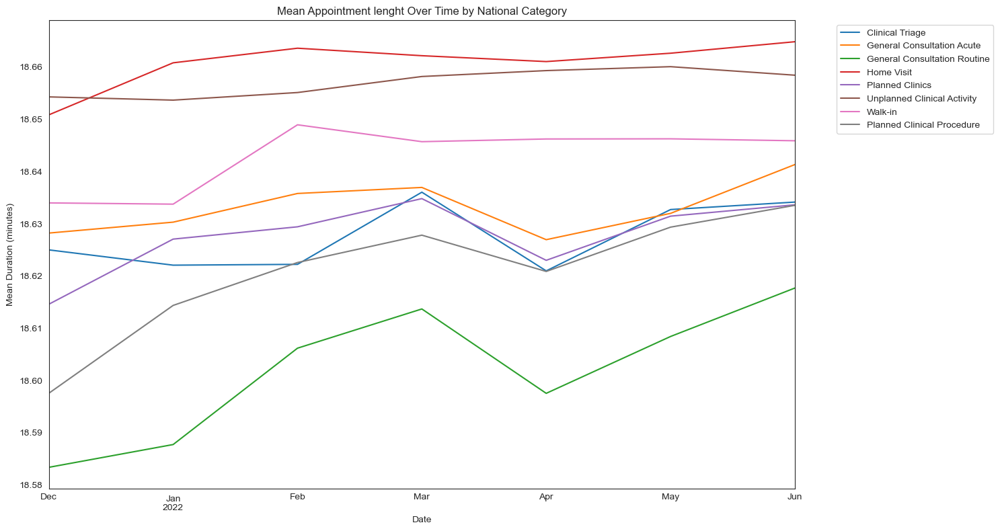

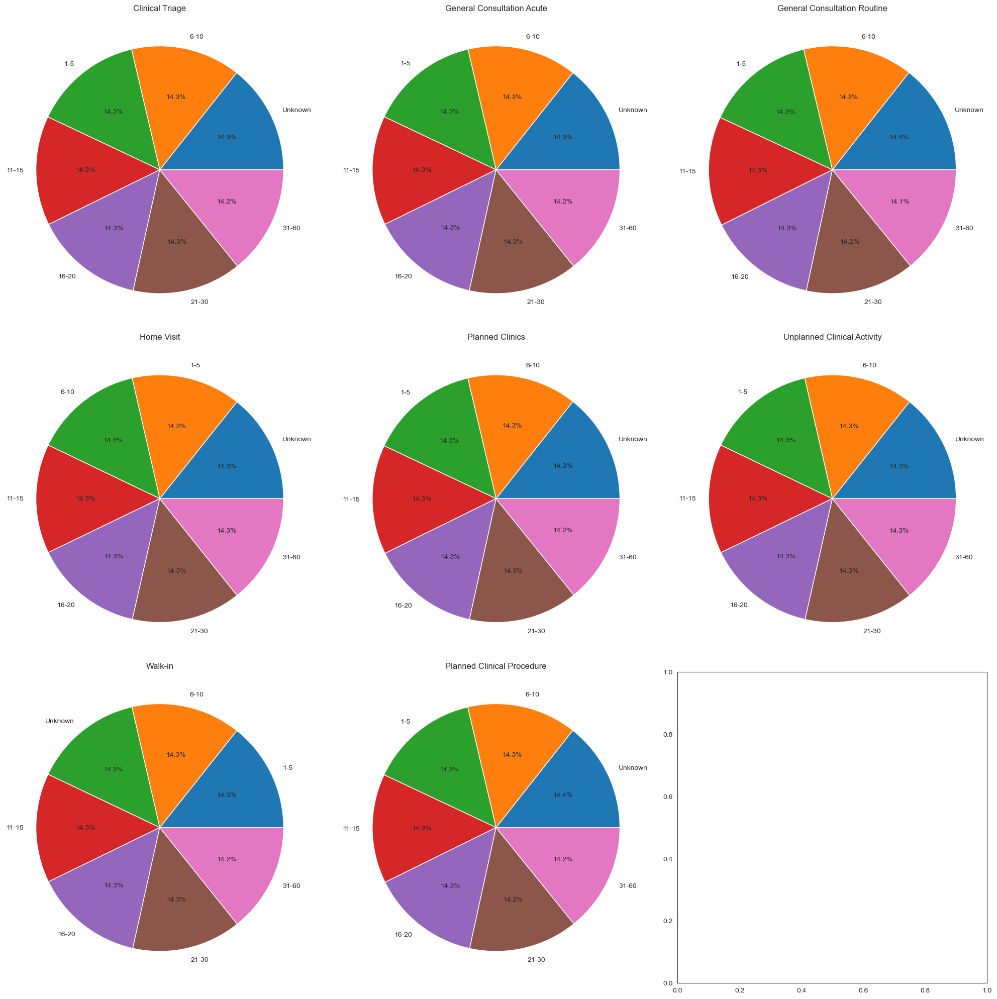

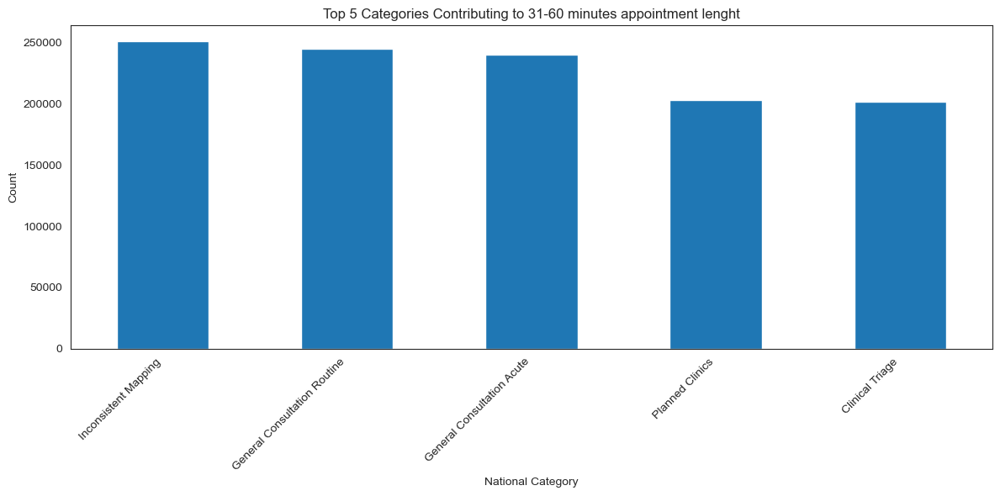


Percentages for 31-60 minute durations:
Inconsistent Mapping: 11.46%
General Consultation Routine: 11.18%
General Consultation Acute: 10.93%
Planned Clinics: 9.25%
Clinical Triage: 9.18%


In [106]:
# Find relationships between appointment duration and 

# Define the categories of interest
categories_of_interest = [
    'Clinical Triage', 'General Consultation Acute', 'General Consultation Routine',
    'Home Visit', 'Planned Clinics', 'Unplanned Clinical Activity', 'Walk-in',
    'Planned Clinical Procedure'
]

# Filter the dataframe
df_filtered = merged1[merged1['national_category'].isin(categories_of_interest)]

# Apply the duration mapping
duration_mapping = {
    '1-5': 3, '6-10': 8, '11-15': 13, '16-20': 18,
    '21-30': 25, '31-60': 45, '60+': 70
}
df_filtered['duration_numeric'] = df_filtered['actual_duration_minutes'].map(duration_mapping)

# 1. Mean duration over time
# Convert appointment_date to datetime
df_filtered['appointment_date'] = pd.to_datetime(df_filtered['appointment_date'])

# Set appointment_date as the index
df_filtered.set_index('appointment_date', inplace=True)

# 1. Mean duration over time
plt.figure(figsize=(15, 8))
for category in categories_of_interest:
    category_data = df_filtered[df_filtered['national_category'] == category]
    category_data['duration_numeric'].resample('M').mean().plot(label=category)

plt.title('Mean Appointment lenght Over Time by National Category')
plt.xlabel('Date')
plt.ylabel('Mean Duration (minutes)')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig('Mean_appointment_lenght_by_national_category.png')
plt.show()

# Reset index for the pie charts
df_filtered.reset_index(inplace=True)

# 2. Pie charts of timings for each category
fig, axs = plt.subplots(3, 3, figsize=(20, 20))
axs = axs.ravel()

for i, category in enumerate(categories_of_interest):
    category_data = df_filtered[df_filtered['national_category'] == category]
    category_data['actual_duration_minutes'].value_counts().plot.pie(autopct='%1.1f%%', ax=axs[i])
    axs[i].set_title(category)
    axs[i].set_ylabel('')

plt.tight_layout()
plt.show()

# 3. Categories contributing most to 31-60 durations (No 60+identified)
long_durations = merged1[merged1['actual_duration_minutes'].isin([ '31-60'])]
category_counts = long_durations['national_category'].value_counts().head(5)

plt.figure(figsize=(12, 6))
category_counts.plot(kind='bar')
plt.title('Top 5 Categories Contributing to 31-60 minutes appointment lenght')
plt.xlabel('National Category')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.savefig('top_5_long_appointments.png')
plt.show()

# Print percentages for 31-60 and categories
total_long = len(long_durations)
print("\nPercentages for 31-60 minute durations:")
for category, count in category_counts.items():
    percentage = (count / total_long) * 100
    print(f"{category}: {percentage:.2f}%")

Results: Due to the high number of national categories the data was filtered to a few categories (adjust per interest). Home visits and unplanned clinical activities shown the highest mean value trends, whilst general consultation routine shown the lowest mean trends, considering that GPs can prepare to these consultations. 
When looking at the longest appointments 11.4% was due to inconsistent mapping, followed by General Consultation Routine and then General Consultation Acute. Although General consultation Routine had a relatively low mean trends, it appears that it contributes more to the longer appointments.  

In [108]:
# tried to load the final_merged file as a pandas datframe, however again due to cumputer resources it was not 
# possible. Attempted to load it through a connection with pgAdmin directly, however it was still time-consuming. 
# This remains a limitation of the analysis. Was hoping to look into appointment length and appointment mode,
# hcp_type and service setting. 

# from sqlalchemy import create_engine, inspect
# from urllib.parse import quote_plus

# PostgreSQL credentials
# host = '127.0.0.1'
# database = 'NHS_assignment'
# user = 'postgres'
# password = ''  # Use your actual password

# URL encode the password
# encoded_password = quote_plus(password)

# Correct connection string
# connection_string = f"postgresql+psycopg2://{user}:{encoded_password}@{host}/{database}"

#try:
    # Create the engine
   # engine = create_engine(connection_string)
    
    # Test connection
   # connection = engine.connect()
   # print("SQLAlchemy connection successful")
   # connection.close()

    # Create an inspector object
    # insp = inspect(engine)

    # Get table names
    # tables = insp.get_table_names()
    # print("Tables:", tables)
# except Exception as e:
    # print(f"An error occurred: {e}")

# Create a DataFrame.
# merged_final = pd.read_sql('SELECT "icb_ons_code", \
   # "actual_duration", "service_setting", "hcp_type", "appointment_mode", "total_nc_count_of_appointments" \
   # FROM "final_merged_data"', engine)
# merged_final.head()

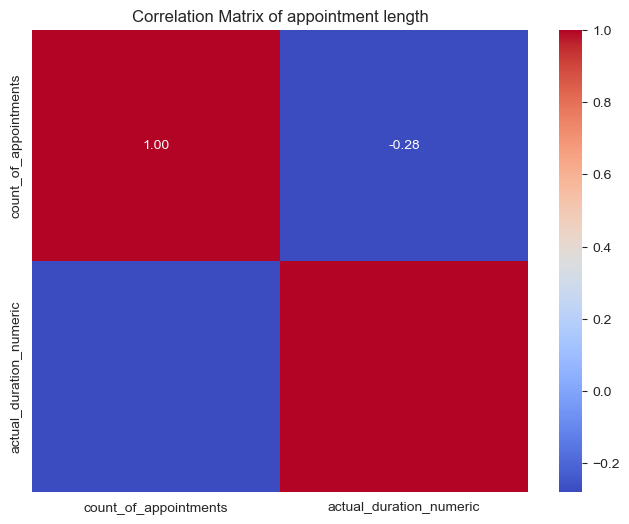

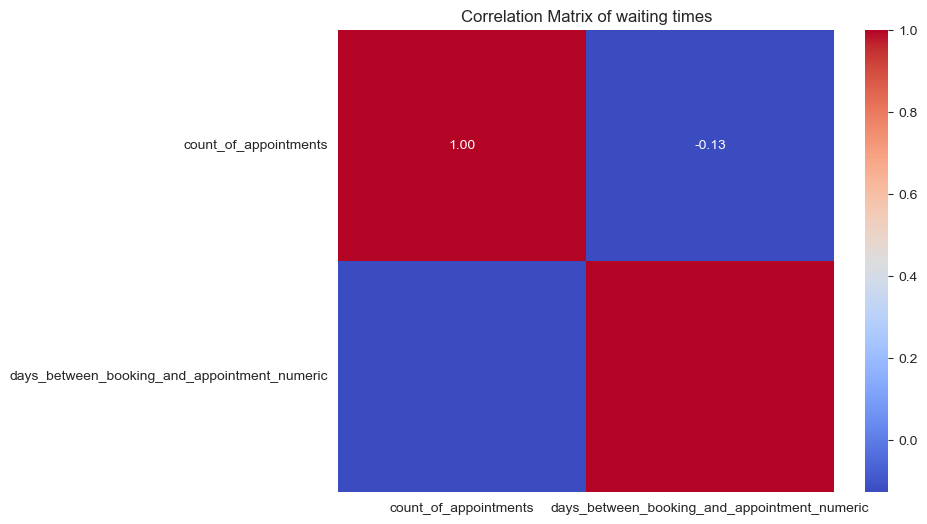

In [109]:
# Correlation of appointment length and waiting times
# Define mappings for the categorical data
duration_mapping = {
    '1-5': 3, '6-10': 8, '11-15': 13, '16-20': 18,
    '21-25': 23, '26-30': 28, '31-60': 45, '61+': 61
}

days_mapping = {
    '0': 0, '1': 1, '2-7': 4, '8-14': 11, '15-21': 18, '22-28': 25, '28+': 30
}

# Apply mappings to the respective columns
ad['actual_duration_numeric'] = ad['actual_duration_minutes'].map(duration_mapping)
ar['days_between_booking_and_appointment_numeric'] = (
    ar['days_between_booking_and_appointment'].map(days_mapping))

# Create a DataFrame for each dataset with relevant columns
ad_relevant = ad[['count_of_appointments', 'actual_duration_numeric']]
ar_relevant = ar[['count_of_appointments', 
                  'days_between_booking_and_appointment_numeric']]

# Compute correlation matrix for actual_duration dataset
correlation_matrix_ad = ad_relevant.corr()

# Compute correlation matrix for appointments_regional dataset
correlation_matrix_ar = ar_relevant.corr()

# Plot the heatmap for actual_duration dataset
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix_ad, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix of appointment length')
plt.show()

# Plot the heatmap for appointments_regional dataset
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix_ar, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix of waiting times')
plt.show()


Results: 
- For the count of Appointments and the Actual Duration of appointments in numeric representation: The correlation coefficient is -0.28, indicating a weak negative correlation. This suggests that, in general, as the number of appointments increases, the average duration of each appointment tends to decrease slightly. However, the correlation is not strong enough to make a definitive conclusion.
- There isn't a strong linear relationship between the average waiting time and the total number of appointments based on the correlation coefficient. It indicate a mild relationship, that when the number of appointments increase the the average wait times also increase.

#### Attended Appointments Over Time
- Fluctuations: Significant variations with peaks in late 2021 and early 2022, reaching around 2.75 million attended appointments.
- Pandemic Impact: Initial decline in early 2020 likely due to the start of COVID-19 lockdowns.
- Recovery: Peaks in attended appointments align with periods following lockdowns, suggesting catch-up in healthcare services. 
#### DNA and Unknown Appointments Over Time
- Initial Spike: Sharp increase in DNA and unknown appointments in early 2020, corresponding to the start of the COVID-19 pandemic. Potentially indicating staffing issues or overload.
- Stabilization: DNA appointments, generally higher than unknowns but both show a stabilizing trend post-2020.
- Notable Peaks: DNA appointments show another peak in late 2021, possibly reflecting ongoing pandemic effects or seasonal variations.

#### Dynamic Resource Allocation:
- Increase resources during peak healthcare demand periods, especially post-lockdown and during seasonal peaks.
Reduce DNAs:
- Implement strategies such as appointment reminders and flexible scheduling to improve patient adherence.

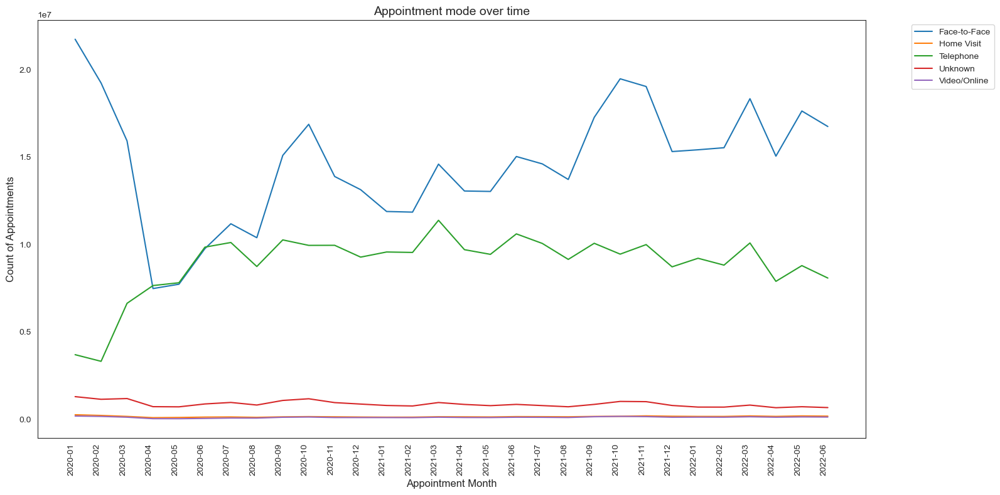

In [112]:
# Appointment mode over time
ar = pd.read_csv('scaled_appointments_regional.csv')

# Group by appointment_month and context_type, then sum the count_of_appointments
ar_grouped = ar.groupby(['appointment_month',
                         'appointment_mode'])['count_of_appointments'].sum().reset_index()

plt.figure(figsize=(16, 8))  # Increase figure size

sns.lineplot(x='appointment_month', y='count_of_appointments',
             data=ar_grouped,
             hue='appointment_mode', errorbar=None)

plt.xticks(rotation=90, ha='right')  # Rotate labels to 90 degrees
plt.xlabel('Appointment Month', fontsize=12)
plt.ylabel('Count of Appointments', fontsize=12)
plt.title('Appointment mode over time', fontsize=14)

# Adjust bottom margin to make room for labels
plt.subplots_adjust(bottom=0.2)

# Move legend outside the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)

# Increase font size of tick labels
plt.tick_params(axis='both', which='major', labelsize=10)

plt.tight_layout()
plt.savefig('Appointment_mode_over_time.png')
plt.show()

<a id="Geographical-Analysis"></a>
# Geographical Analysis
#### Prepare the datasets to include the NHS regions and ICB names for pivot analysis and geographical analysis

In [114]:
# Create a Region_names dictionary
region_names = {
    'NHS Bedfordshire Luton and Milton Keynes ICB': 'East of England',
    'NHS Cambridgeshire and Peterborough ICB': 'East of England',
    'NHS Hertfordshire and West Essex ICB': 'East of England',
    'NHS Mid and South Essex ICB': 'East of England',
    'NHS Norfolk and Waveney ICB': 'East of England',
    'NHS Suffolk and North East Essex ICB': 'East of England',

    'NHS North Central London ICB': 'London',
    'NHS North East London ICB': 'London',
    'NHS North West London ICB': 'London',
    'NHS South East London ICB': 'London',
    'NHS South West London ICB': 'London',

    'NHS Birmingham and Solihull ICB': 'Midlands',
    'NHS Coventry and Warwickshire ICB': 'Midlands',
    'NHS Herefordshire and Worcestershire ICB': 'Midlands',
    'NHS Leicester Leicestershire and Rutland ICB': 'Midlands',
    'NHS Lincolnshire ICB': 'Midlands',
    'NHS Northamptonshire ICB': 'Midlands',
    'NHS Nottingham and Nottinghamshire ICB': 'Midlands',
    'NHS Shropshire Telford and Wrekin ICB': 'Midlands',
    'NHS Staffordshire and Stoke-on-Trent': 'Midlands',
    'NHS Black Country ICB': 'Midlands',
    'NHS Derby and Derbyshire ICB': 'Midlands',

    'NHS Humber and North Yorkshire ICB': 'North East and Yorkshire',
    'NHS North East and North Cumbria ICB': 'North East and Yorkshire',
    'NHS South Yorkshire ICB': 'North East and Yorkshire',
    'NHS West Yorkshire ICB': 'North East and Yorkshire',
    
    'NHS Cheshire and Merseyside ICB': 'North West',
    'NHS Greater Manchester ICB': 'North West',
    'NHS Lancashire and South Cumbria ICB': 'North West',

    'NHS Bath and North East Somerset Swindon and Wiltshire ICB': 'South East',
    'NHS Buckinghamshire Oxfordshire and Berkshire West ICB': 'South East',
    'NHS Frimley ICB': 'South East',
    'NHS Hampshire and Isle Of Wight ICB': 'South East',
    'NHS Kent and Medway ICB': 'South East',
    'NHS Surrey Heartlands ICB': 'South East',
    'NHS Sussex ICB': 'South East',

    'NHS Bristol North Somerset and South Gloucestershire ICB': 'South West',
    'NHS Cornwall and The Isles Of Scilly ICB': 'South West',
    'NHS Devon ICB': 'South West',
    'NHS Dorset ICB': 'South West',
    'NHS Gloucestershire ICB': 'South West',
    'NHS Somerset ICB': 'South West'
}

In [115]:
# Load the dataset for formatting
ar = pd.read_csv('scaled_appointments_regional.csv')
nc = pd.read_csv('scaled_national_categories.csv')

# Create a dictionary for icb_ons_code to sub_icb_location_name
icb_location_name_dict = nc.set_index('icb_ons_code')['icb_location_name'].to_dict()

# Map the region names to national_categories
nc['region_name'] = nc['icb_location_name'].map(region_names)

# Map icb_location_name to appointments_regional using the dictionary
ar['icb_location_name'] = ar['icb_ons_code'].map(icb_location_name_dict)

# Map the region names to appointments_regional
ar['region_name'] = ar['icb_location_name'].map(region_names)

ar_new_column_order = ['icb_ons_code', 'icb_location_name', 'region_name', 
                       'appointment_month', 'appointment_status', 
                       'hcp_type', 'appointment_mode', 'time_between_book_and_appointment',
                       'days_between_booking_and_appointment',
                       'count_of_appointments',	'estimated_total_appointments', 
                       'count_of_appointments',
                       'max_scaled_appointments', 'min_max_scaled_appointments',
                       'z_score_scaled_appointments','outlier_flag']
ar = ar[ar_new_column_order]

nc_new_column_order = ['sub_icb_location_code', 'sub_icb_location_name', 'icb_ons_code',
                       'icb_location_name', 'region_name', 'appointment_date', 
                       'appointment_month', 'service_setting', 'context_type', 
                       'national_category', 'count_of_appointments', 
                       'max_scaled_appointments',
                       'min_max_scaled_appointments', 'z_score_scaled_appointments', 
                       'outlier_flag']
nc = nc[nc_new_column_order]
# Map icb_location_name to appointments_regional using the dictionary
ad['icb_location_name'] = ad['icb_ons_code'].map(icb_location_name_dict)

# Map the region names to appointments_regional
ad['region_name'] = ad['icb_location_name'].map(region_names)

# Save the updated datasets to new CSV files (optional)
ar.to_csv('updated_appointments_regional.csv', index=False)
nc.to_csv('updated_national_categories.csv', index=False)
ad.to_csv('updated_actual_duration.csv', index=False)

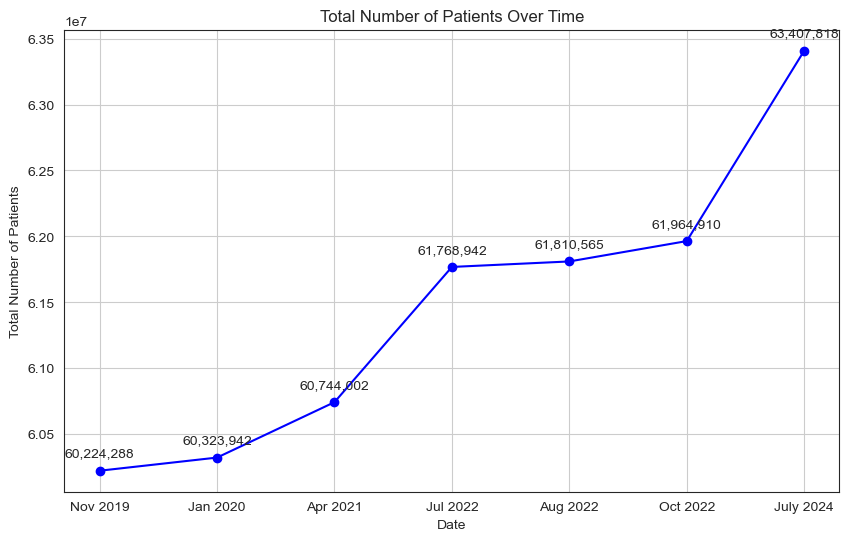

Percentage Growth from 01 January 2020 to 01 Aug 2022: 2.4644%


In [116]:
# Enrich the data with population data
# https://digital.nhs.uk/data-and-information/publications/statistical/patients-registered-at-a-gp-practice
# total number of patients July 2022 = 61,768,942
# total number of patients Nov 2019 = 60,224,288 (Metadata = 60,198,781)
# total number of patients Jan 2020 = 60,323,942
# total number of patients July 2022 = 60,744,002
# total patients Oct 2022 = 61,964,910
# total patients July 2024 = 63,407,818
# total patients 01/08/2022 = 61,810,565

# Population Data
dates = ['Nov 2019', 'Jan 2020', 'Apr 2021', 'Jul 2022', 
         'Aug 2022', 'Oct 2022', 'July 2024']
patients = [60224288, 60323942, 60744002, 61768942, 61810565, 61964910, 63407818]

# Create the plot
plt.figure(figsize=(10, 6))
plt.plot(dates, patients, marker='o', linestyle='-', color='b')

# Add titles and labels
plt.title('Total Number of Patients Over Time')
plt.xlabel('Date')
plt.ylabel('Total Number of Patients')
plt.grid(True)

# Annotate the points with patient numbers
for i, patient in enumerate(patients):
    plt.annotate(f'{patient:,}', (dates[i], patients[i]), 
                 textcoords="offset points", xytext=(0,10), ha='center')

# Show the plot
plt.show()


# The population is showing a growing trend. Calculate the percentage growth 
# for dates for the dataset
# Values for January 2020 and Aug 2022
patients_jan_2020 = 60323942
patients_aug_2022 = 61810565
# chose the 01 August data from the site as this has the converted codes for ICBs

# Calculate percentage growth from January 2020 to July 2022
percentage_growth_jan2020_aug2022 = (
    ((patients_aug_2022 - patients_jan_2020) / patients_jan_2020) * 100)

print(f"Percentage Growth from 01 January 2020 to 01 Aug 2022: {percentage_growth_jan2020_aug2022:.4f}%")

In [117]:
# Load the new patient dataset for 01/08/2022 
# (prior to this date the old system codes of CCGs were used)
patient_data = pd.read_csv('gp-reg-pat-prac-all-August-2022.csv')
patient_data.head()

,PUBLICATION,EXTRACT_DATE,TYPE,SUB_ICB_LOCATION_CODE,ONS_SUB_ICB_LOCATION_CODE,CODE,POSTCODE,SEX,AGE,NUMBER_OF_PATIENTS
0,GP_PRAC_PAT_LIST,01-Aug-22,GP,00L,E38000130,A84002,NE65 7UW,ALL,ALL,6005
1,GP_PRAC_PAT_LIST,01-Aug-22,GP,00L,E38000130,A84005,NE22 6JX,ALL,ALL,12096
2,GP_PRAC_PAT_LIST,01-Aug-22,GP,00L,E38000130,A84006,NE66 2NL,ALL,ALL,18927
3,GP_PRAC_PAT_LIST,01-Aug-22,GP,00L,E38000130,A84007,NE20 9SD,ALL,ALL,10681
4,GP_PRAC_PAT_LIST,01-Aug-22,GP,00L,E38000130,A84008,NE70 7ER,ALL,ALL,4494


In [118]:
# Load the nc dataset which contains SUB_ICB_LOCATION_CODE to region_name mapping
nc = pd.read_csv('updated_national_categories.csv')

# Create a mapping DataFrame
mapping_df = nc[['sub_icb_location_code', 'sub_icb_location_name', 
                 'icb_location_name', 'icb_ons_code','region_name']].drop_duplicates()

# Merge the patient data with the mapping DataFrame to get the region names
patient_data = patient_data.merge(mapping_df, left_on='SUB_ICB_LOCATION_CODE',
                                  right_on='sub_icb_location_code', how='left')

patient_data.to_csv('patient_data.csv', index=False)

# Display the merged DataFrame
patient_data.head()

,PUBLICATION,EXTRACT_DATE,TYPE,SUB_ICB_LOCATION_CODE,ONS_SUB_ICB_LOCATION_CODE,CODE,POSTCODE,SEX,AGE,NUMBER_OF_PATIENTS,sub_icb_location_code,sub_icb_location_name,icb_location_name,icb_ons_code,region_name
0,GP_PRAC_PAT_LIST,01-Aug-22,GP,00L,E38000130,A84002,NE65 7UW,ALL,ALL,6005,00L,NHS North East and North Cumbria ICB - 00L,NHS North East and North Cumbria ICB,E54000050,North East and Yorkshire
1,GP_PRAC_PAT_LIST,01-Aug-22,GP,00L,E38000130,A84005,NE22 6JX,ALL,ALL,12096,00L,NHS North East and North Cumbria ICB - 00L,NHS North East and North Cumbria ICB,E54000050,North East and Yorkshire
2,GP_PRAC_PAT_LIST,01-Aug-22,GP,00L,E38000130,A84006,NE66 2NL,ALL,ALL,18927,00L,NHS North East and North Cumbria ICB - 00L,NHS North East and North Cumbria ICB,E54000050,North East and Yorkshire
3,GP_PRAC_PAT_LIST,01-Aug-22,GP,00L,E38000130,A84007,NE20 9SD,ALL,ALL,10681,00L,NHS North East and North Cumbria ICB - 00L,NHS North East and North Cumbria ICB,E54000050,North East and Yorkshire
4,GP_PRAC_PAT_LIST,01-Aug-22,GP,00L,E38000130,A84008,NE70 7ER,ALL,ALL,4494,00L,NHS North East and North Cumbria ICB - 00L,NHS North East and North Cumbria ICB,E54000050,North East and Yorkshire


In [119]:
# Due to incorrect patient numbers the icb_to_region dictionary is used to ensure correct population totals for the regions
# Ensure the necessary columns are in the correct format
patient_data['NUMBER_OF_PATIENTS'] = pd.to_numeric(patient_data['NUMBER_OF_PATIENTS'], 
                                                   errors='coerce')
patient_data['POSTCODE'] = patient_data['POSTCODE'].astype(str)


# Rename 'NUMBER_OF_PATIENTS' to 'total_patients'
patient_data.rename(columns={'NUMBER_OF_PATIENTS': 'total_patients'}, inplace=True)

# Create a dictionary for ICB to Region mapping (this should be based on actual data)
icb_to_region = {
    'NHS Bedfordshire Luton and Milton Keynes ICB': 'East of England',
    'NHS Cambridgeshire and Peterborough ICB': 'East of England',
    'NHS Hertfordshire and West Essex ICB': 'East of England',
    'NHS Mid and South Essex ICB': 'East of England',
    'NHS Norfolk and Waveney ICB': 'East of England',
    'NHS Suffolk and North East Essex ICB': 'East of England',
    'NHS North Central London ICB': 'London',
    'NHS North East London ICB': 'London',
    'NHS North West London ICB': 'London',
    'NHS South East London ICB': 'London',
    'NHS South West London ICB': 'London',
    'NHS Birmingham and Solihull ICB': 'Midlands',
    'NHS Coventry and Warwickshire ICB': 'Midlands',
    'NHS Herefordshire and Worcestershire ICB': 'Midlands',
    'NHS Leicester Leicestershire and Rutland ICB': 'Midlands',
    'NHS Lincolnshire ICB': 'Midlands',
    'NHS Northamptonshire ICB': 'Midlands',
    'NHS Nottingham and Nottinghamshire ICB': 'Midlands',
    'NHS Shropshire Telford and Wrekin ICB': 'Midlands',
    'NHS Staffordshire and Stoke-on-Trent ICB': 'Midlands',
    'NHS Black Country ICB': 'Midlands',
    'NHS Derby and Derbyshire ICB': 'Midlands',
    'NHS Humber and North Yorkshire ICB': 'North East and Yorkshire',
    'NHS North East and North Cumbria ICB': 'North East and Yorkshire',
    'NHS South Yorkshire ICB': 'North East and Yorkshire',
    'NHS West Yorkshire ICB': 'North East and Yorkshire',
    'NHS Cheshire and Merseyside ICB': 'North West',
    'NHS Greater Manchester ICB': 'North West',
    'NHS Lancashire and South Cumbria ICB': 'North West',
    'NHS Bath and North East Somerset Swindon and Wiltshire ICB': 'South West',
    'NHS Buckinghamshire Oxfordshire and Berkshire West ICB': 'South East',
    'NHS Frimley ICB': 'South East',
    'NHS Hampshire and Isle Of Wight ICB': 'South East',
    'NHS Kent and Medway ICB': 'South East',
    'NHS Surrey Heartlands ICB': 'South East',
    'NHS Sussex ICB': 'South East',
    'NHS Bristol North Somerset and South Gloucestershire ICB': 'South West',
    'NHS Cornwall and The Isles Of Scilly ICB': 'South West',
    'NHS Devon ICB': 'South West',
    'NHS Dorset ICB': 'South West',
    'NHS Gloucestershire ICB': 'South West',
    'NHS Somerset ICB': 'South West'
}


# Map ICBs to Regions in the patient data
patient_data['region_name'] = patient_data['icb_location_name'].map(icb_to_region)

# Aggregate patient data by region
patients_by_region = (
    patient_data.groupby('region_name')['total_patients']
    .sum().reset_index())

# Count unique postcodes to estimate the number of GP practices per region
gps_by_region = patient_data.groupby('region_name')['POSTCODE'].nunique().reset_index()
gps_by_region = gps_by_region.rename(columns={'POSTCODE': 'total_gps'})

# Merge the aggregated data
region_population = pd.merge(patients_by_region, gps_by_region, on='region_name')

# Calculate total patients and GPs
total_patients_by_region = region_population['total_patients'].sum()
total_patients = patient_data['total_patients'].sum()
total_gps = patient_data['POSTCODE'].nunique()

print(f"Total patients by region: {total_patients_by_region}")
print(f"Total patients in the dataset: {total_patients}")

# Validate if the totals match
if total_patients_by_region == total_patients:
    print("Aggregated totals match the dataset totals.")
else:
    print(f"There is a discrepancy in the aggregated totals: {total_patients - total_patients_by_region}")

# Create the icb_population DataFrame
icb_population = patient_data.groupby('icb_location_name').agg({
    'total_patients': 'sum',
    'POSTCODE': 'nunique'
}).reset_index().rename(columns={'POSTCODE': 'total_gps'})

# Display the results
print('\nTotal number of patients:')
print(total_patients)

print('\nTotal number of GPs:')
print(total_gps)

print('\nTotal number of patients and GPs per Region:')
print(region_population)

print('\nTotal number of patients and GPs per ICB:')
print(icb_population)

Total patients by region: 61810565
Total patients in the dataset: 61810565
Aggregated totals match the dataset totals.

Total number of patients:
61810565

Total number of GPs:
5890

Total number of patients and GPs per Region:
                region_name  total_patients  total_gps
0           East of England         7111137        637
1                    London        10710176       1057
2                  Midlands        11605875       1185
3  North East and Yorkshire         9037704        880
4                North West         7715189        816
5                South East         9616291        792
6                South West         6014193        524

Total number of patients and GPs per ICB:
                                             icb_location_name  \
0   NHS Bath and North East Somerset Swindon and Wiltshire ICB   
1                 NHS Bedfordshire Luton and Milton Keynes ICB   
2                              NHS Birmingham and Solihull ICB   
3                        

In [120]:
# Load the ar dataset
ar = pd.read_csv('updated_appointments_regional.csv')

# Starting and final populations
population_jan_2020 = 66796807  # Population in January 2020
population_jul_2022 = 61810565  # Population on 01 Aug 2022 ass the dataset ends on 30/07/22

# Calculate the percentage growth
percentage_growth = (
    ((population_jul_2022 - population_jan_2020) / population_jan_2020) * 100)

# Calculate the growth factor
growth_factor = (population_jul_2022 / population_jan_2020) ** (1 / (2.5 * 12))  
# Annual growth factor assuming linear growth

# Apply the growth factor to estimate population for each month in ar
ar['appointment_month'] = pd.to_datetime(ar['appointment_month'])
ar['months_since_jan_2020'] = (
    (ar['appointment_month'].dt.year - 2020) * 12 + (ar['appointment_month'].dt.month - 1))
ar['estimated_population'] = (
    population_jan_2020 * (growth_factor ** ar['months_since_jan_2020']))

# Calculate per capita values (appointments per 1000 people)
ar['per_capita_appointments'] = (
    (ar['estimated_total_appointments'] / ar['estimated_population']) * 1000)

# Print the updated DataFrame
print(ar[['appointment_month', 'estimated_population',
          'per_capita_appointments']].head())

# Save the updated DataFrame to a CSV file
ar.to_csv('updated_appointments_regional.csv', index=False)

  appointment_month  estimated_population  per_capita_appointments
0        2020-01-01            66796807.0                 0.125900
1        2020-01-01            66796807.0                 0.105463
2        2020-01-01            66796807.0                 0.321250
3        2020-01-01            66796807.0                 0.066281
4        2020-01-01            66796807.0                 0.185908


In [121]:
# Load the updated datasets
ar = pd.read_csv('updated_appointments_regional.csv')
nc = pd.read_csv('updated_national_categories.csv')
ad = pd.read_csv('scaled_actual_duration.csv')

In [122]:
# Pivot table: Count of appointments by appointment status and healthcare professional type in ar
pivot_table_status_hcp = ar.pivot_table(
    values='count_of_appointments',
    index='appointment_status',
    columns='hcp_type',
    aggfunc='sum',
    fill_value=0
)

print("Pivot Table: Count of Appointments by Appointment Status and Healthcare Professional Type")
pivot_table_status_hcp

Pivot Table: Count of Appointments by Appointment Status and Healthcare Professional Type


hcp_type,GP,Other Practice staff,Unknown
appointment_status,,,
Attended,357847005,299129577,20779294
DNA,9428935,20829335,652963
Unknown,12374200,19691623,2071593


In [123]:
# Pivot table: Count of appointments by ICB and month in ar
pivot_table_icb_month = ar.pivot_table(
    values='count_of_appointments',
    index=['icb_location_name', 'appointment_month'],
    columns='appointment_status',
    aggfunc='sum',
    fill_value=0
)

print("\nPivot Table: Count of Appointments by ICB and Month")
pivot_table_icb_month


Pivot Table: Count of Appointments by ICB and Month


appointment_status                                                            Attended  \
icb_location_name                                          appointment_month             
NHS Bath and North East Somerset Swindon and Wiltshire ICB 2020-01-01           457462   
                                                           2020-02-01           404550   
                                                           2020-03-01           388015   
                                                           2020-04-01           265978   
                                                           2020-05-01           289492   
...                                                                                ...   
NHS West Yorkshire ICB                                     2022-02-01          1131553   
                                                           2022-03-01          1327621   
                                                           2022-04-01          1093044   
                                                           2022-05-01          1236165   
                                                           2022-06-01          1174120   

appointment_status                                                              DNA  \
icb_location_name                                          appointment_month          
NHS Bath and North East Somerset Swindon and Wiltshire ICB 2020-01-01         18360   
                                                           2020-02-01         16736   
                                                           2020-03-01         15704   
                                                           2020-04-01          6313   
                                                           2020-05-01          5474   
...                                                                             ...   
NHS West Yorkshire ICB                                     2022-02-01         42214   
                                                           2022-03-01         50785   
                                                           2022-04-01         41009   
                                                           2022-05-01         46828   
                                                           2022-06-01         45250   

appointment_status                                                            Unknown  
icb_location_name                                          appointment_month           
NHS Bath and North East Somerset Swindon and Wiltshire ICB 2020-01-01           32532  
                                                           2020-02-01           30457  
                                                           2020-03-01           59849  
                                                           2020-04-01           59521  
                                                           2020-05-01           31034  
...                                                                               ...  
NHS West Yorkshire ICB                                     2022-02-01           40553  
                                                           2022-03-01           52436  
                                                           2022-04-01           40422  
                                                           2022-05-01           46475  
                                                           2022-06-01           41053  

[1260 rows x 3 columns]

In [124]:
# Filter the DataFrame for a specific region or ICB/ amend accordingly
filtered_ar = ar[ar['region_name'] == 'London']

# Create the pivot table for the filtered data
pivot_table_icb_month = filtered_ar.pivot_table(
    values='count_of_appointments',
    index=['region_name', 'appointment_month'],
    columns='appointment_status',	
    aggfunc=['sum', 'mean'],
    fill_value=0
)

# Round the mean values to 1 decimal place
pivot_table_icb_month['mean'] = pivot_table_icb_month['mean'].round(1)

print("\nPivot Table: Count of Appointments by ICB and Month")
pivot_table_icb_month


Pivot Table: Count of Appointments by ICB and Month


sum                     mean               
appointment_status            Attended     DNA Unknown Attended    DNA Unknown
region_name appointment_month                                                 
London      2020-01-01         3344563  233640  158721   7724.2  654.5   365.7
            2020-02-01         3009564  225208  148630   6886.9  638.0   341.7
            2020-03-01         2886786  206254  244033   6358.6  576.1   550.9
            2020-04-01         2018145   74661  118626   4874.7  255.7   274.6
            2020-05-01         2139998   74176   88498   5270.9  253.2   221.2
            2020-06-01         2719214  100464  112327   6489.8  328.3   265.5
            2020-07-01         2975198  122884  125485   6655.9  376.9   293.2
            2020-08-01         2662274  119031  116690   6050.6  373.1   283.9
            2020-09-01         3455449  183448  168073   7561.2  541.1   399.2
            2020-10-01         3620430  216852  175489   8009.8  623.1   411.9
            2020-11-01         3310680  177924  146833   7324.5  514.2   353.8
            2020-12-01         3044831  167935  140011   6827.0  504.3   339.0
            2021-01-01         2937222  139544  134206   6600.5  425.4   326.5
            2021-02-01         3019923  134069  127525   6681.2  407.5   336.5
            2021-03-01         3645199  167467  152481   8154.8  485.4   369.2
            2021-04-01         3224908  154586  143939   7119.0  445.5   346.8
            2021-05-01         3182909  159160  130159   7010.8  468.1   319.8
            2021-06-01         3680007  196246  166013   8017.4  540.6   395.3
            2021-07-01         3510697  196389  164749   7598.9  545.5   383.1
            2021-08-01         3220952  181395  139167   7032.6  519.8   331.4
            2021-09-01         3738036  227227  202240   8126.2  641.9   468.1
            2021-10-01         3855712  255278  205720   8345.7  717.1   479.5
            2021-11-01         3951659  251327  190823   8534.9  694.3   440.7
            2021-12-01         3268218  211106  157072   7151.5  601.4   363.6
            2022-01-01         3426688  195085  147082   7417.1  546.5   349.4
            2022-02-01         3414439  202146  147726   7537.4  558.4   346.0
            2022-03-01         3960578  240293  175663   8743.0  673.1   412.4
            2022-04-01         3197795  192303  144071   6982.1  554.2   348.0
            2022-05-01         3726559  227913  156791   8154.4  643.8   371.5
            2022-06-01         3494242  223479  155654   7730.6  638.5   382.4

<a id="Regional-Analysis"></a>
# Regional Analysis

In [126]:
# Load the updated datasets
nc = pd.read_csv('updated_national_categories.csv')

# Calculate the total number of appointments per region in nc
total_appointments_nc = (
    nc.groupby('region_name')['count_of_appointments']
    .sum().reset_index())

# Calculate the average number of appointments per region in nc
average_appointments_nc = (
    nc.groupby('region_name')['count_of_appointments']
    .mean().reset_index().round(1))

# Rename the columns for clarity
total_appointments_nc = (
    total_appointments_nc
    .rename(columns={'count_of_appointments': 'total_appointments_nc'}))
average_appointments_nc = (
    average_appointments_nc
    .rename(columns={'count_of_appointments': 'average_appointments_nc'}))

# Merge the total and average DataFrames on region_name
appointments_nc = pd.merge(total_appointments_nc, average_appointments_nc,
                           on='region_name')

# Sort the DataFrame by total number of appointments in ascending order
appointments_nc = appointments_nc.sort_values(by='total_appointments_nc', ascending=True)

# Print the sum of all appointments
print("\nSum of All Appointments in nc:")
print(nc['count_of_appointments'].sum())

print("Total and Average Number of Appointments per Region in nc:")
appointments_nc


Sum of All Appointments in nc:
296046770
Total and Average Number of Appointments per Region in nc:


,region_name,total_appointments_nc,average_appointments_nc
6,South West,27127820,451.9
0,East of England,34055047,308.6
4,North West,35865459,229.5
1,London,43484439,778.7
3,North East and Yorkshire,47915966,289.0
5,South East,50245710,441.5
2,Midlands,52026539,432.0


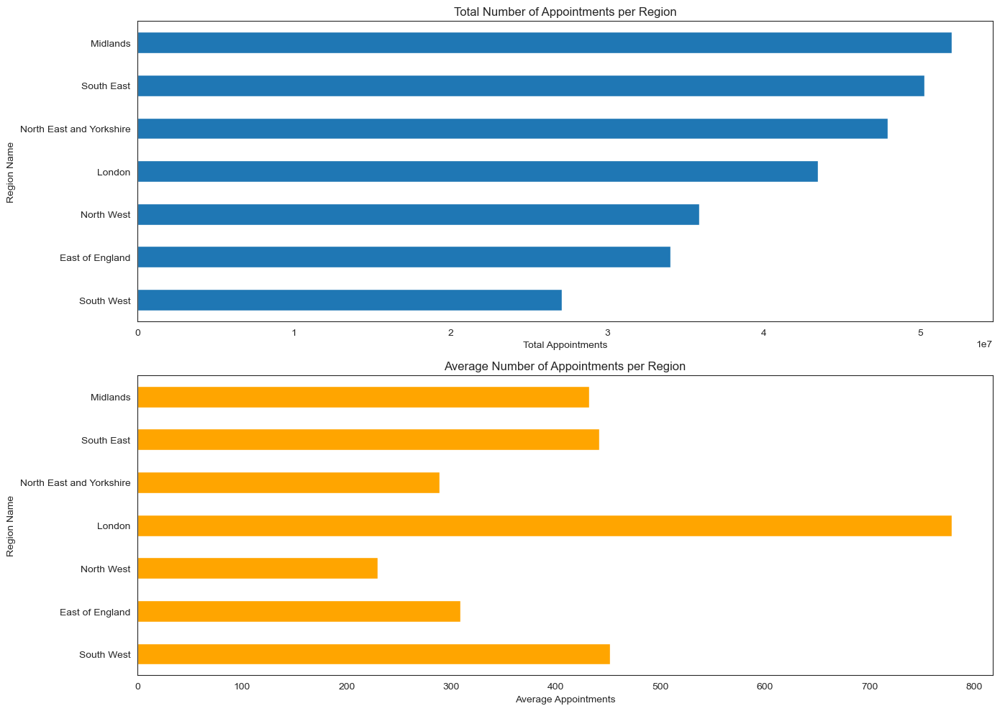

In [127]:
# Plotting the total and average number of appointments per region
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(14, 10))

# Total appointments horizontal bar plot
appointments_nc.plot(kind='barh', x='region_name', y='total_appointments_nc',
                     ax=axes[0], legend=False)
axes[0].set_title('Total Number of Appointments per Region')
axes[0].set_xlabel('Total Appointments')
axes[0].set_ylabel('Region Name')

# Average appointments horizontal bar plot
appointments_nc.plot(kind='barh', x='region_name', y='average_appointments_nc', 
                     ax=axes[1], legend=False, color='orange')
axes[1].set_title('Average Number of Appointments per Region')
axes[1].set_xlabel('Average Appointments')
axes[1].set_ylabel('Region Name')

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()

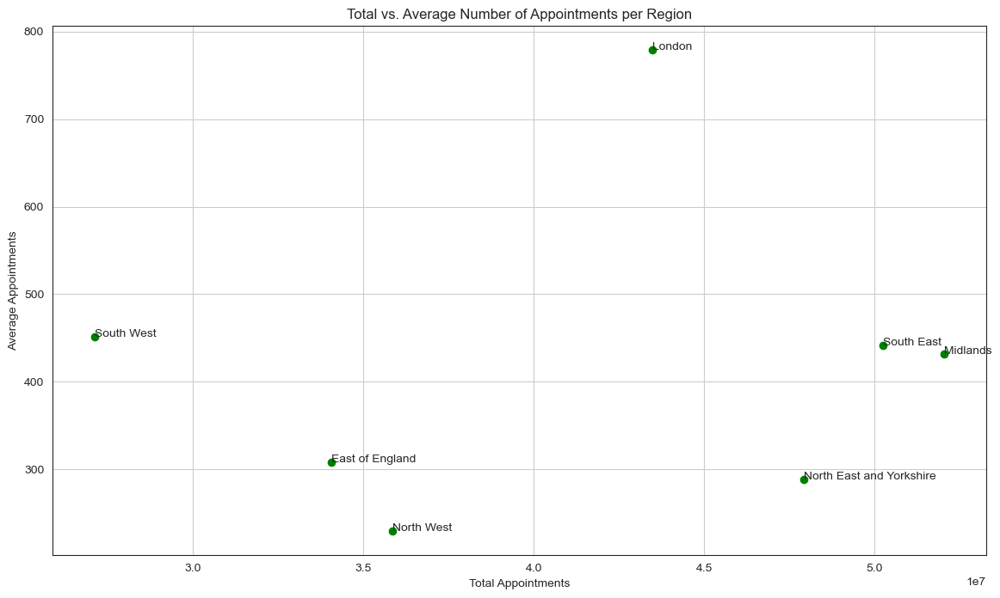

In [128]:
# Scatter plot for total vs. average number of appointments
plt.figure(figsize=(14, 8))
plt.scatter(appointments_nc['total_appointments_nc'], 
            appointments_nc['average_appointments_nc'], color='green')

# Annotate points with region names
for i, row in appointments_nc.iterrows():
    plt.annotate(row['region_name'], (row['total_appointments_nc'],
                                      row['average_appointments_nc']))

plt.title('Total vs. Average Number of Appointments per Region')
plt.xlabel('Total Appointments')
plt.ylabel('Average Appointments')
plt.grid(True)
plt.show()

In [129]:
# Pivot table: Count of appointments by region and national category in nc
pivot_table_region_category = nc.pivot_table(
    values='count_of_appointments',
    index='region_name',
    columns='national_category',
    aggfunc='sum',
    fill_value=0
)

print("\nPivot Table: Count of Appointments by Region and National Category")
pivot_table_region_category


Pivot Table: Count of Appointments by Region and National Category


national_category,Care Home Needs Assessment & Personalised Care and Support Planning,Care Home Visit,Clinical Triage,General Consultation Acute,General Consultation Routine,Group Consultation and Group Education,Home Visit,Inconsistent Mapping,Non-contractual chargeable work,Patient contact during Care Home Round,Planned Clinical Procedure,Planned Clinics,Service provided by organisation external to the practice,Social Prescribing Service,Structured Medication Review,Unmapped,Unplanned Clinical Activity,Walk-in
region_name,,,,,,,,,,,,,,,,,,
East of England,63064,87624,4983513,6438628,10760830,4799,184999,2268603,11215,96212,2298976,4476646,125376,58591,323814,1370389,383108,118660
London,29667,80877,6827053,7250359,15040853,5196,169229,4937655,28678,52109,2602170,4244563,84462,69093,212117,1458504,302180,89674
Midlands,80955,98552,7284112,10857554,15964776,31832,397105,4350308,16849,133401,4446371,5072775,118375,81756,410926,2109594,545008,26290
North East and Yorkshire,76012,91178,5815851,7916357,16606953,5412,331285,4412669,18558,132843,3559663,5482746,130705,72734,409145,2090737,703399,59719
North West,40675,76951,5261201,6792713,11787202,3002,470953,4129653,15416,115123,2977909,2341315,140472,39234,157478,1215972,277562,22628
South East,76092,140836,7212898,8737079,16254523,9287,337862,4893313,34321,171018,6045239,3767959,180738,91359,200186,1549109,482048,61843
South West,31466,41784,3549815,4577421,8889223,821,203579,2475939,11823,79398,3107834,2312230,61298,57993,115267,1256645,324203,31081


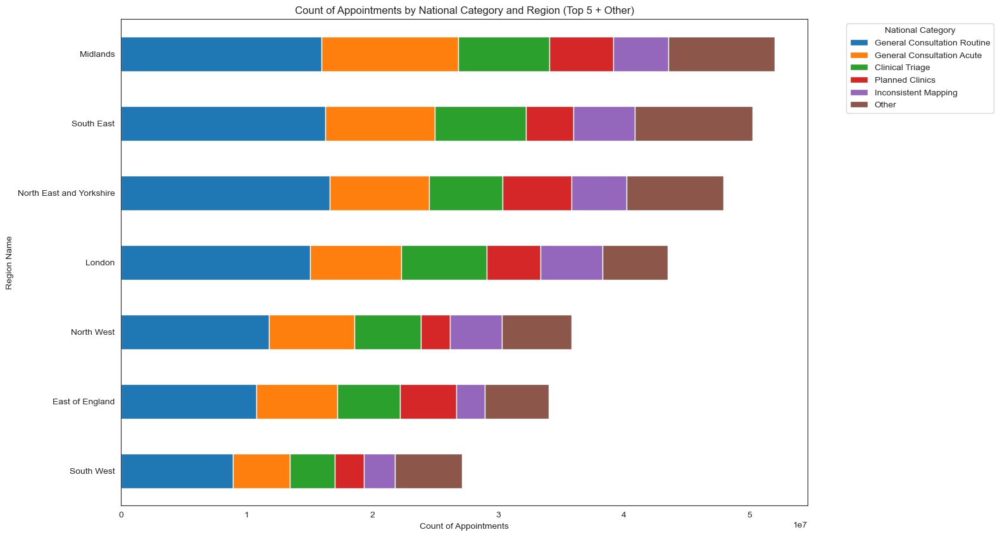

Note: This visualisation is based on the national categories file.

In [130]:
# Create visualisation for Pivot table: Count of appointments 
# by region and national category in nc
# Sum the counts for each national category
category_sums = pivot_table_region_category.sum(axis=0)

# Identify the top 5 categories
top_5_categories = category_sums.nlargest(5).index

# Create a new DataFrame for the top 5 categories and group the rest as 'Other'
pivot_table_top5 = pivot_table_region_category[top_5_categories]
pivot_table_top5['Other'] = (
    pivot_table_region_category.loc[:, ~pivot_table_region_category
    .columns.isin(top_5_categories)].sum(axis=1))

# Add a total row to sort by
pivot_table_top5['Total'] = pivot_table_top5.sum(axis=1)

# Sort the DataFrame by the total count of appointments in descending order
pivot_table_top5 = pivot_table_top5.sort_values(by='Total', ascending=True)

# Drop the 'Total' column as it's not needed for the plot
pivot_table_top5 = pivot_table_top5.drop(columns='Total')

# Plot the horizontal bar plot
pivot_table_top5.plot(kind='barh', stacked=True, figsize=(14, 10))
plt.title('Count of Appointments by National Category and Region (Top 5 + Other)')
plt.xlabel('Count of Appointments')
plt.ylabel('Region Name')
plt.legend(title='National Category', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('regional_breakdown_national_category.png')
plt.show()

# Adding a note about estimation
note = "Note: This visualisation is based on the national categories file."
display(Markdown(note))

In [131]:
# Pivot table: Count of appointments by region and service setting in nc
pivot_table_region_setting = nc.pivot_table(
    values='count_of_appointments',
    index='region_name',
    columns='service_setting',
    aggfunc='sum',
    fill_value=0
)

print("\nPivot Table: Count of Appointments by Region and Service setting")
pivot_table_region_setting


Pivot Table: Count of Appointments by Region and Service setting


service_setting,Extended Access Provision,General Practice,Other,Primary Care Network,Unmapped
region_name,,,,,
East of England,220387,30515758,941656,1006857,1370389
London,510042,40050508,609377,856008,1458504
Midlands,342315,47482503,1071107,1021020,2109594
North East and Yorkshire,292249,43295847,1069935,1167198,2090737
North West,214618,33457086,388716,589067,1215972
South East,396131,46319073,916305,1065092,1549109
South West,160695,24588078,386824,735578,1256645


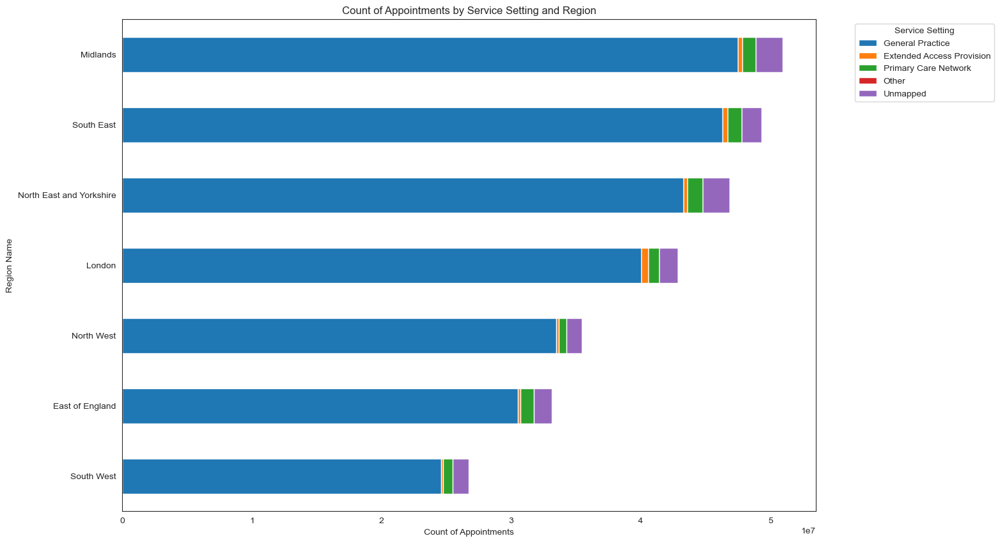

Note: This visualisation is based on the national categories file.

In [132]:
# Create visualisation for Pivot table: Count of appointments by region and service setting in nc
# Sum the counts for each national category
category_sums = pivot_table_region_setting.sum(axis=0)

# Identify the top 5 categories
top_5_categories = category_sums.nlargest(5).index

# Create a new DataFrame for the top 5 categories and group the rest as 'Other'
pivot_table_top5 = pivot_table_region_setting[top_5_categories]
pivot_table_top5['Other'] = (
    pivot_table_region_setting.loc[:, ~pivot_table_region_setting
    .columns.isin(top_5_categories)].sum(axis=1))

# Add a total row to sort by
pivot_table_top5['Total'] = pivot_table_top5.sum(axis=1)

# Sort the DataFrame by the total count of appointments in descending order
pivot_table_top5 = pivot_table_top5.sort_values(by='Total', ascending=True)

# Drop the 'Total' column as it's not needed for the plot
pivot_table_top5 = pivot_table_top5.drop(columns='Total')

# Specify the desired order of categories
desired_order = ['General Practice', 'Extended Access Provision', 
                 'Primary Care Network', 'Other', 'Unmapped']

# Reorder the columns based on the specified label order
pivot_table_top5 = pivot_table_top5[desired_order]

# Plot the horizontal bar plot
pivot_table_top5.plot(kind='barh', stacked=True, figsize=(14, 10))
plt.title('Count of Appointments by Service Setting and Region')
plt.xlabel('Count of Appointments')
plt.ylabel('Region Name')
plt.legend(title='Service Setting', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('regional_breakdown_service_setting.png')
plt.show()

# Adding a note about estimation
note = "Note: This visualisation is based on the national categories file."
display(Markdown(note))

In [133]:
# Pivot table: Count of appointments by region and context type in nc
pivot_table_region_context = nc.pivot_table(
    values='count_of_appointments',
    index='region_name',
    columns='context_type',
    aggfunc='sum',
    fill_value=0
)

print("\nPivot Table: Count of Appointments by Region and context type")
pivot_table_region_context


Pivot Table: Count of Appointments by Region and context type


context_type,Care Related Encounter,Inconsistent Mapping,Unmapped
region_name,,,
East of England,30416055,2268603,1370389
London,37088280,4937655,1458504
Midlands,45566637,4350308,2109594
North East and Yorkshire,41412560,4412669,2090737
North West,30519834,4129653,1215972
South East,43803288,4893313,1549109
South West,23395236,2475939,1256645


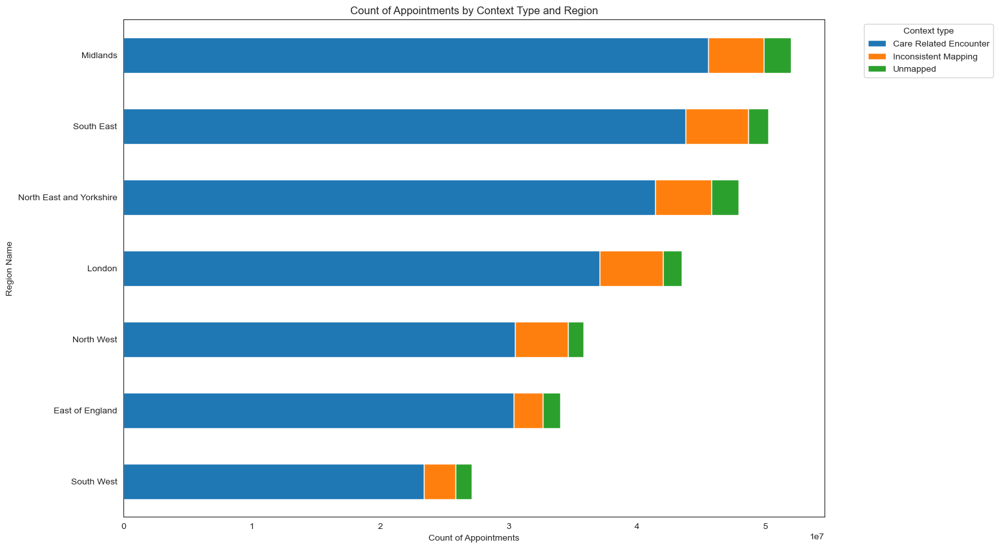

Note: This visualisation is based on the national categories file.

In [134]:
# Create visualisation for Pivot table: Count of appointments by region and context
# type in nc
# Add a total column to sort by
pivot_table_region_context['Total'] = pivot_table_region_context.sum(axis=1)

# Sort the DataFrame by the total count of appointments in ascending order
pivot_table_region_context = pivot_table_region_context.sort_values(by='Total', 
                                                                    ascending=True)

# Drop the 'Total' column as it's not needed for the plot
pivot_table_region_context = pivot_table_region_context.drop(columns='Total')

# Plot the horizontal bar plot
pivot_table_region_context.plot(kind='barh', stacked=True, figsize=(14, 10))
plt.title('Count of Appointments by Context Type and Region')
plt.xlabel('Count of Appointments')
plt.ylabel('Region Name')
plt.legend(title='Context type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('regional_breakdown_service_type.png')
plt.show()

# Adding a note about estimation
note = "Note: This visualisation is based on the national categories file."
display(Markdown(note))

In [135]:
# Pivot table: Count of appointments by region and context type in ar
pivot_table_region_status = ar.pivot_table(
    values='count_of_appointments',
    index='region_name',
    columns='appointment_status',
    aggfunc='sum',    # ['sum', 'mean'] - if you would like to add the mean values
    fill_value=0
)

print("\nPivot Table: Count of Appointments by Region and context type")
pivot_table_region_status


Pivot Table: Count of Appointments by Region and context type


appointment_status,Attended,DNA,Unknown
region_name,,,
East of England,79414915,2826791,3986942
London,97642875,5457490,4584497
Midlands,119186989,5444691,5797301
North East and Yorkshire,111199679,4362852,5886329
North West,79774059,4569359,4359450
South East,115163863,4969882,5650225
South West,63468708,2642379,3219034


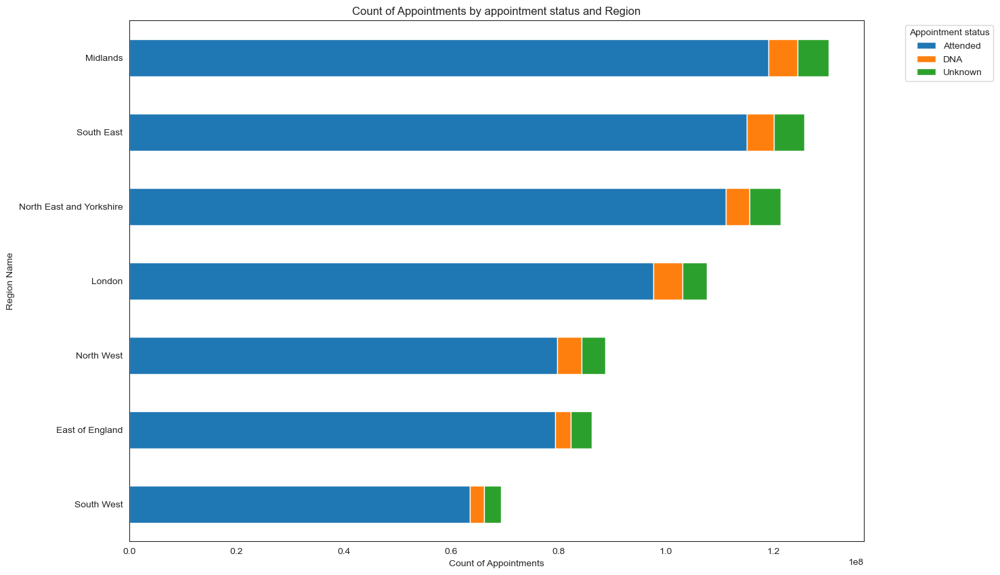

Note: This visualisation is based on the appointment regional file.

In [136]:
# Create visualisation for Pivot table: Count of appointments by appointment status in ar
# Add a total column to sort by
pivot_table_region_status['Total'] = pivot_table_region_status.sum(axis=1)

# Sort the DataFrame by the total count of appointments in ascending order
pivot_table_region_status = pivot_table_region_status.sort_values(by='Total', 
                                                                  ascending=True)

# Drop the 'Total' column as it's not needed for the plot
pivot_table_region_status = pivot_table_region_status.drop(columns='Total')

# Plot the horizontal bar plot
pivot_table_region_status.plot(kind='barh', stacked=True, figsize=(14, 10))
plt.title('Count of Appointments by appointment status and Region')
plt.xlabel('Count of Appointments')
plt.ylabel('Region Name')
plt.legend(title='Appointment status', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('regional_breakdown_missed_appointments.png')
plt.show()

# Adding a note about estimation
note = "Note: This visualisation is based on the appointment regional file."
display(Markdown(note))

In [137]:
# Compare Regional appointment trends

# Load the datasets
ar = pd.read_csv('updated_appointments_regional.csv')

# Calculate the total number of appointments per region in ar
total_appointments_ar = (
    ar.groupby('region_name')['estimated_total_appointments']
    .sum().reset_index())

# Calculate the average number of appointments per region in ar
average_appointments_ar = (
    ar.groupby('region_name')['estimated_total_appointments']
    .mean().reset_index().round(2))

# Merge the total and average DataFrames on region_name
appointments_ar = pd.merge(total_appointments_ar, average_appointments_ar, 
                           on='region_name')

# Rename the columns for clarity
appointments_ar = appointments_ar.rename(columns={
    'estimated_total_appointments_x': 'total_appointments_ar',
    'estimated_total_appointments_y': 'average_appointments_ar'
})
# Merge with region population to get population data
appointments_ar = pd.merge(appointments_ar, region_population, on='region_name')

# Calculate per capita appointments
appointments_ar['per_capita_appointments'] = (
    (appointments_ar['total_appointments_ar'] / appointments_ar['total_patients']) * 1000)

# Calculate appointment density (total appointments per GP surgery) and round to 3 decimal places
appointments_ar['appointment_density'] = (
    (appointments_ar['total_appointments_ar'] / appointments_ar['total_gps']).round(2))

# Convert total appointments and appointment density to millions for better readability
appointments_ar['total_appointments_ar_millions'] = (
    appointments_ar['total_appointments_ar'] / 1e6)
appointments_ar['appointment_density_millions'] = (
    appointments_ar['appointment_density'] / 1e6)

# Sort the DataFrame by total number of appointments in ascending order
appointments_ar = appointments_ar.sort_values(by='total_appointments_ar', ascending=True)

# Round the average per capita appointments to 2 decimal places for clarity
appointments_ar['per_capita_appointments'] = (
    appointments_ar['per_capita_appointments'].round(2))

appointments_ar_styled = appointments_ar.style \
    .set_caption("Appointments per region") \
    .set_properties(**{'text-align': 'center'}) \
    .set_table_styles([{'selector': 'th', 'props': [('text-align', 'center')]}]) \
    .background_gradient(cmap='viridis', low=0, high=1)
display(appointments_ar_styled)

,region_name,total_appointments_ar,average_appointments_ar,total_patients,total_gps,per_capita_appointments,appointment_density,total_appointments_ar_millions,appointment_density_millions
6,South West,71919212.655602,1796.860000,6014193,524,11958.250000,137250.410000,71.919213,0.137250
0,East of England,89448804.979253,1197.380000,7111137,637,12578.690000,140421.990000,89.448805,0.140422
4,North West,92015423.236515,661.320000,7715189,816,11926.530000,112764.000000,92.015423,0.112764
1,London,111706288.381743,3071.890000,10710176,1057,10429.920000,105682.390000,111.706288,0.105682
3,North East and Yorkshire,125984294.605809,1005.710000,9037704,880,13939.860000,143163.970000,125.984295,0.143164
5,South East,130481296.680498,1718.010000,9616291,792,13568.780000,164749.110000,130.481297,0.164749
2,Midlands,135299772.821577,1735.300000,11605875,1185,11657.870000,114177.020000,135.299773,0.114177


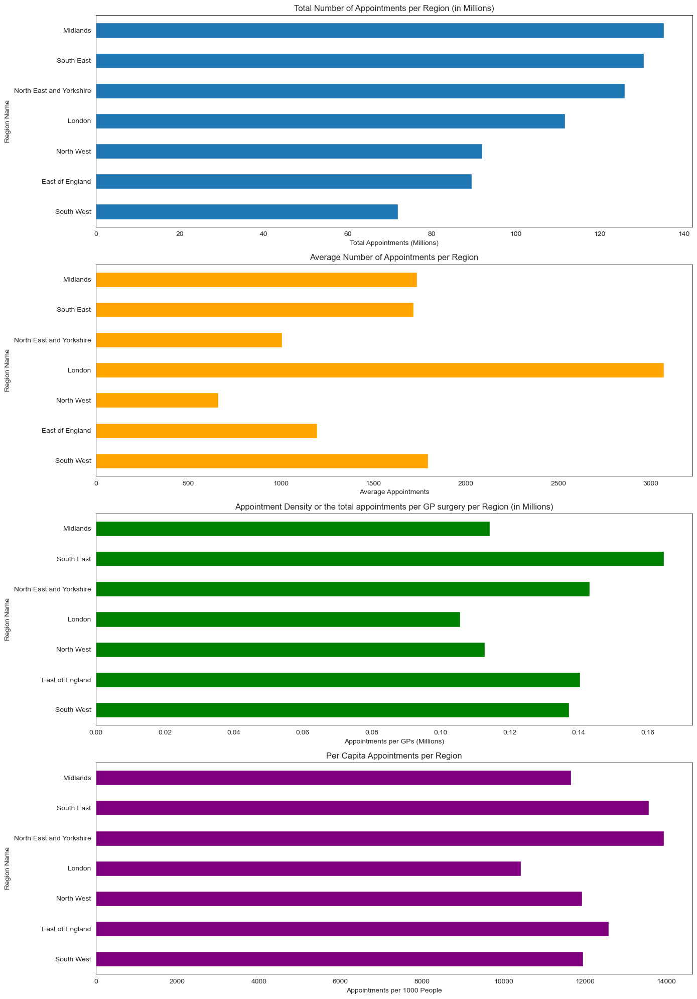

Note: This visualisation is based on population and GP data from 01/08/2022.

In [138]:
# Plotting the total, average, and appointment density per region
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(14, 20))

# Total appointments horizontal bar plot
appointments_ar.plot(kind='barh', x='region_name', y='total_appointments_ar_millions', 
                     ax=axes[0], legend=False)
axes[0].set_title('Total Number of Appointments per Region (in Millions)')
axes[0].set_xlabel('Total Appointments (Millions)')
axes[0].set_ylabel('Region Name')

# Average appointments horizontal bar plot
appointments_ar.plot(kind='barh', x='region_name', y='average_appointments_ar',
                     ax=axes[1], 
                     legend=False, color='orange')
axes[1].set_title('Average Number of Appointments per Region')
axes[1].set_xlabel('Average Appointments')
axes[1].set_ylabel('Region Name')

# Appointment density horizontal bar plot
appointments_ar.plot(kind='barh', x='region_name', y='appointment_density_millions',
                     ax=axes[2], legend=False, color='green')
axes[2].set_title('Appointment Density or the total appointments per GP surgery per Region (in Millions)')
axes[2].set_xlabel('Appointments per GPs (Millions)')
axes[2].set_ylabel('Region Name')

# Per capita appointments horizontal bar plot
appointments_ar.plot(kind='barh', x='region_name', y='per_capita_appointments',
                     ax=axes[3], legend=False, color='purple')
axes[3].set_title('Per Capita Appointments per Region')
axes[3].set_xlabel('Appointments per 1000 People')
axes[3].set_ylabel('Region Name')

plt.tight_layout()
plt.savefig('regional_breakdown_density_per_capita.png')
plt.show()

# Adding a note
note = "Note: This visualisation is based on population and GP data from 01/08/2022."
display(Markdown(note))

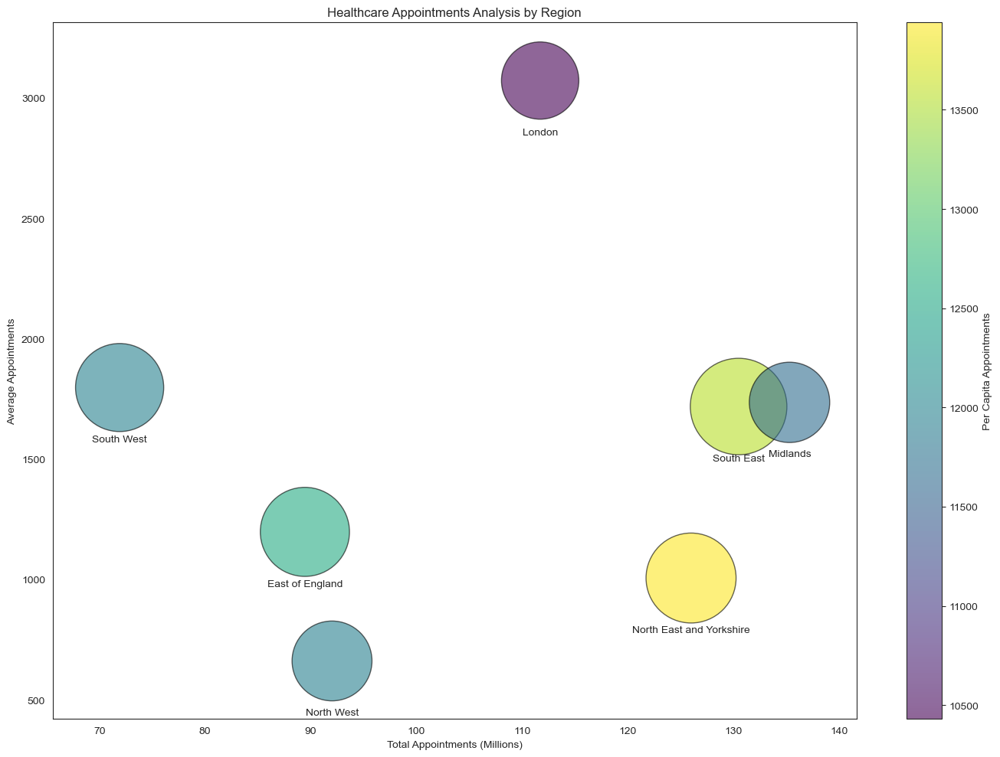

In [139]:
# Define padding
x_padding = (
    (appointments_ar['total_appointments_ar_millions'].max() - 
     appointments_ar['total_appointments_ar_millions'].min()) * 0.1)
y_padding = (
    (appointments_ar['average_appointments_ar'].max() - 
     appointments_ar['average_appointments_ar'].min()) * 0.1)

# Create a combined scatter plot
fig, ax = plt.subplots(figsize=(14, 10))

# Scatter plot
scatter = ax.scatter(
    appointments_ar['total_appointments_ar_millions'], 
    appointments_ar['average_appointments_ar'], 
    s=appointments_ar['appointment_density_millions'] * 50000, 
    c=appointments_ar['per_capita_appointments'],  # Color by per capita appointments
    cmap='viridis', 
    alpha=0.6,
    edgecolors="black", linewidth=1
)

# Add color bar
cbar = plt.colorbar(scatter)
cbar.set_label('Per Capita Appointments')

# Add labels and title
for i, row in appointments_ar.iterrows():
    ax.text(row['total_appointments_ar_millions'],
            row['average_appointments_ar'] - 225, row['region_name'], 
            fontsize=10, ha='center')  
# Set axis limits with padding
ax.set_xlim(appointments_ar['total_appointments_ar_millions'].min() - x_padding, 
            appointments_ar['total_appointments_ar_millions'].max() + x_padding)
ax.set_ylim(appointments_ar['average_appointments_ar'].min() - y_padding, 
            appointments_ar['average_appointments_ar'].max() + y_padding)

ax.set_title('Healthcare Appointments Analysis by Region')
ax.set_xlabel('Total Appointments (Millions)')
ax.set_ylabel('Average Appointments')
plt.tight_layout()
plt.savefig('regional_breakdown_scatter_plot.png')
plt.show()


##### Total Number of Appointments per Region
- Midlands: Leads with the highest total number of appointments, suggesting a high healthcare demand.
- South East and North East and Yorkshire: Follow closely, indicating significant healthcare needs.
- London: Despite being a densely populated area, it has fewer total appointments compared to Midlands and South East.
- North West, East of England, and South West: These regions have comparatively lower total appointment numbers.
###### Average Number of Appointments per Region
- London: Has the highest average number of appointments, reflecting intense utilization of healthcare services.
- South West and South East: Also show high averages, indicating high regional demand.
- Midlands and North East and Yorkshire: Moderate average appointments.
- North West and East of England: Lower average appointments.
##### Appointment Density per Region (in Millions)
- South West: Shows the highest appointment density, indicating a high number of appointments per GP.
- North East and Yorkshire and South East: Also show high appointment density.
- London, North West, and Midlands: Moderate density.
- East of England: Lowest appointment density.
##### Per Capita Appointments per Region
- Midlands: Leads with the highest per capita appointments.
- North East and Yorkshire, South East, and East of England: Show significant per capita appointments.
- London: Despite high averages, it has fewer per capita appointments.
- North West and South West: Moderate per capita appointments.
##### Insights and Recommendations
- High Demand Regions: Midlands and South East: High total and per capita appointments suggest the need for increased healthcare infrastructure.
- London: High average appointments, indicating a potential need for more facilities or expanded capacity.
- Moderate Utilization: North West and East of England: Balanced demand and facility utilization.
- High Density Regions: South West: High appointment density suggests efficient use of available facilities but also indicates potential strain.

- Impact of COVID-19: Both plots show a significant drop in the number of appointments around early 2020, corresponding to the onset of the COVID-19 pandemic and lockdown measures.
- Recovery Patterns: There is evidence of recovery in the number of appointments after the initial drop, with fluctuations likely due to changing restrictions and healthcare access issues.
- Overall Trend: The slight upward trend in both the original and filtered data indicates a general increase in the number of appointments over the analyzed period.
- Rolling Averages: The rolling averages in both plots help to highlight the longer-term trends, smoothing out short-term fluctuations to provide a clearer picture of the overall trajectory.

# Staffing analysis of the NHS Regions

https://digital.nhs.uk/data-and-information/publications/statistical/general-and-personal-medical-services/31-july-2022
From the xlsx file the required tab was saved and cleaned in excel prior to use in python.

In [144]:
gp_staffing = pd.read_csv('GP_staffing_july_2022.csv',  encoding='ISO-8859-1') 
# due to UTF8-encoding error
gp_staffing

,Unnamed: 0,Unnamed: 1,All GPs,All Nurses,All Direct Patient Care,All Admin/Non-Clinical
0,England,NaN,"44,446","23,448","21,638","100,749"
1,Y56,London,"6,960","2,374","2,161","13,232"
2,QKK,NHS South East London ICB,"1,352",521,373,"2,819"
3,72Q,NHS South East London ICB - 72Q,"1,352",521,373,"2,819"
4,QMF,NHS North East London ICB,"1,490",519,470,"3,005"
...,...,...,...,...,...,...
184,NaN,NaN,NaN,NaN,NaN,NaN
185,Data as at the last day of the applicable month,NaN,NaN,NaN,NaN,NaN
186,NaN,NaN,NaN,NaN,NaN,NaN
187,Source: NHS Digital,NaN,NaN,NaN,NaN,NaN


In [145]:
# Load the staffing data
gp_staffing = pd.read_csv('GP_staffing_july_2022.csv', encoding='ISO-8859-1')

# Specify the row labels of interest
rows_of_interest = [
    'London', 'South West', 'South East', 'Midlands', 
    'East of England', 'North West', 'North East and Yorkshire'
]

# Filter the DataFrame by the specified rows in the second column
filtered_gp_staffing = gp_staffing[gp_staffing.iloc[:, 1].isin(rows_of_interest)]

# Rename and drop columns
filtered_gp_staffing.rename(columns={'Unnamed: 1': 'Region'}, inplace=True)
filtered_gp_staffing.drop(columns=['Unnamed: 0'], inplace=True)

# Convert numeric columns to numeric types by removing commas
for col in filtered_gp_staffing.columns[1:]:
    filtered_gp_staffing[col] = filtered_gp_staffing[col].str.replace(',', '').astype(float)

# Display the filtered DataFrame
filtered_gp_staffing

,Region,All GPs,All Nurses,All Direct Patient Care,All Admin/Non-Clinical
1,London,6960.0,2374.0,2161.0,13232.0
12,South West,4838.0,3068.0,3061.0,11502.0
27,South East,6540.0,3541.0,3549.0,16135.0
45,Midlands,8301.0,4599.0,4111.0,19432.0
76,East of England,4614.0,2882.0,3007.0,11982.0
97,North West,5784.0,2894.0,2112.0,12896.0
128,North East and Yorkshire,6709.0,4122.0,3654.0,15637.0


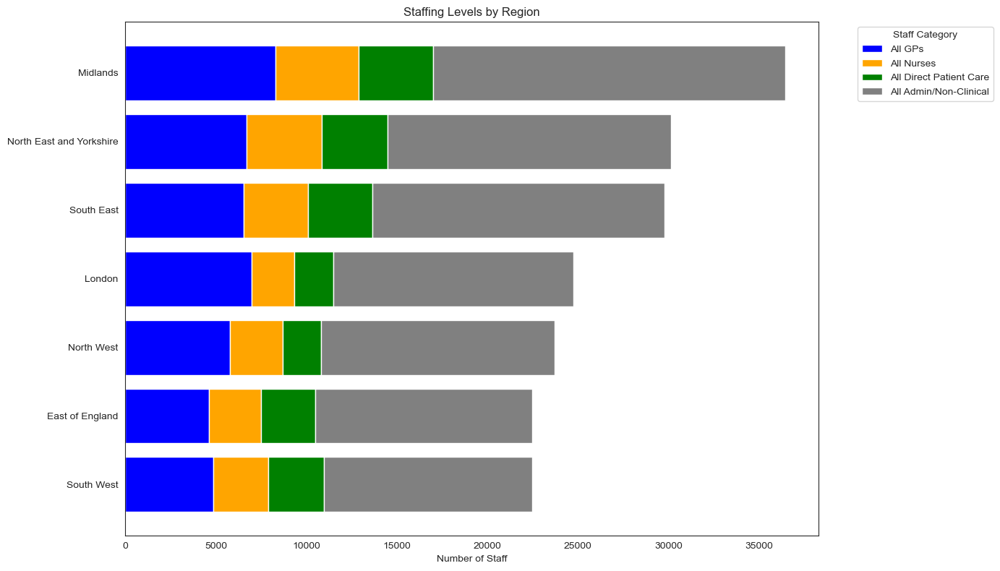

In [146]:
# Calculate the total number of staff for sorting
filtered_gp_staffing['Total Staff'] = (
    filtered_gp_staffing[['All GPs', 'All Nurses', 'All Direct Patient Care', 
                          'All Admin/Non-Clinical']].sum(axis=1))

# Sort by the total number of staff
filtered_gp_staffing = filtered_gp_staffing.sort_values(by='Total Staff', ascending=True)

# Plotting the stacked bar chart
plt.figure(figsize=(14, 8))

# Define the positions for each region
bar_positions = range(len(filtered_gp_staffing['Region']))

# Plot each staff category as a stacked bar
plt.barh(bar_positions, filtered_gp_staffing['All GPs'], color='b',
         edgecolor='white', label='All GPs')
plt.barh(bar_positions, filtered_gp_staffing['All Nurses'], 
         left=filtered_gp_staffing['All GPs'],
         color='orange', edgecolor='white', label='All Nurses')
plt.barh(bar_positions, filtered_gp_staffing['All Direct Patient Care'], 
         left=filtered_gp_staffing['All GPs'] + filtered_gp_staffing['All Nurses'], 
         color='g', edgecolor='white', label='All Direct Patient Care')
plt.barh(bar_positions, filtered_gp_staffing['All Admin/Non-Clinical'], 
         left=filtered_gp_staffing['All GPs'] + filtered_gp_staffing['All Nurses'] + 
         filtered_gp_staffing['All Direct Patient Care'],
         color='grey', edgecolor='white', label='All Admin/Non-Clinical')

# Adding region labels
plt.yticks(bar_positions, filtered_gp_staffing['Region'])
plt.xlabel('Number of Staff')
plt.title('Staffing Levels by Region')
plt.legend(title='Staff Category', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig('regional_breakdown_staffing_level.png')
plt.show()

In [147]:
region_population

,region_name,total_patients,total_gps
0,East of England,7111137,637
1,London,10710176,1057
2,Midlands,11605875,1185
3,North East and Yorkshire,9037704,880
4,North West,7715189,816
5,South East,9616291,792
6,South West,6014193,524


In [148]:
filtered_gp_staffing

,Region,All GPs,All Nurses,All Direct Patient Care,All Admin/Non-Clinical,Total Staff
12,South West,4838.0,3068.0,3061.0,11502.0,22469.0
76,East of England,4614.0,2882.0,3007.0,11982.0,22485.0
97,North West,5784.0,2894.0,2112.0,12896.0,23686.0
1,London,6960.0,2374.0,2161.0,13232.0,24727.0
27,South East,6540.0,3541.0,3549.0,16135.0,29765.0
128,North East and Yorkshire,6709.0,4122.0,3654.0,15637.0,30122.0
45,Midlands,8301.0,4599.0,4111.0,19432.0,36443.0


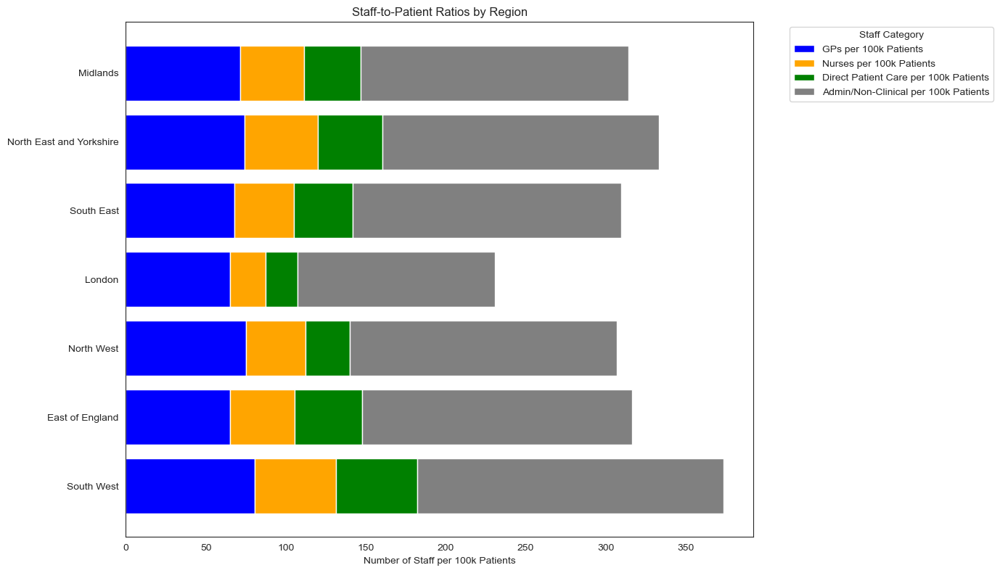

In [149]:
# Rename columns for consistency
region_population.rename(columns={'region_name': 'Region'}, inplace=True)

# Merge the data on the region name
merged_data = pd.merge(filtered_gp_staffing, region_population, on='Region')

# Calculate staff-to-patient ratios
merged_data['GPs_per_100k_patients'] = (
    (merged_data['All GPs'] / merged_data['total_patients']) * 100000)
merged_data['Nurses_per_100k_patients'] = (
    (merged_data['All Nurses'] / merged_data['total_patients']) * 100000)
merged_data['Direct_Patient_Care_per_100k_patients'] = (
    (merged_data['All Direct Patient Care'] / merged_data['total_patients']) * 100000)
merged_data['Admin_Non_Clinical_per_100k_patients'] = (
    (merged_data['All Admin/Non-Clinical'] / merged_data['total_patients']) * 100000)

# Plotting the staff-to-patient ratios
plt.figure(figsize=(14, 8))

# Define the positions for each region
bar_positions = range(len(merged_data['Region']))

# Plot each staff category as a stacked bar
plt.barh(bar_positions, merged_data['GPs_per_100k_patients'], 
         color='b', edgecolor='white', 
         label='GPs per 100k Patients')
plt.barh(bar_positions, merged_data['Nurses_per_100k_patients'], 
         left=merged_data['GPs_per_100k_patients'], 
         color='orange', edgecolor='white', label='Nurses per 100k Patients')
plt.barh(bar_positions, merged_data['Direct_Patient_Care_per_100k_patients'], 
         left=merged_data['GPs_per_100k_patients'] + 
         merged_data['Nurses_per_100k_patients'], 
         color='g', edgecolor='white', label='Direct Patient Care per 100k Patients')
plt.barh(bar_positions, merged_data['Admin_Non_Clinical_per_100k_patients'], 
         left=merged_data['GPs_per_100k_patients'] + 
         merged_data['Nurses_per_100k_patients'] + 
         merged_data['Direct_Patient_Care_per_100k_patients'], 
         color='grey', edgecolor='white', label='Admin/Non-Clinical per 100k Patients')

# Adding region labels
plt.yticks(bar_positions, merged_data['Region'])
plt.xlabel('Number of Staff per 100k Patients')
plt.title('Staff-to-Patient Ratios by Region')
plt.legend(title='Staff Category', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig('regional_breakdown_staff_patient_ratio.png')
plt.show()

In [150]:
merged_data

,Region,All GPs,All Nurses,All Direct Patient Care,All Admin/Non-Clinical,Total Staff,total_patients,total_gps,GPs_per_100k_patients,Nurses_per_100k_patients,Direct_Patient_Care_per_100k_patients,Admin_Non_Clinical_per_100k_patients
0,South West,4838.0,3068.0,3061.0,11502.0,22469.0,6014193,524,80.443045,51.012663,50.896272,191.247604
1,East of England,4614.0,2882.0,3007.0,11982.0,22485.0,7111137,637,64.884139,40.527977,42.285784,168.496262
2,North West,5784.0,2894.0,2112.0,12896.0,23686.0,7715189,816,74.968999,37.510423,27.374572,167.150798
3,London,6960.0,2374.0,2161.0,13232.0,24727.0,10710176,1057,64.984926,22.165836,20.177073,123.546056
4,South East,6540.0,3541.0,3549.0,16135.0,29765.0,9616291,792,68.009589,36.822929,36.906121,167.788184
5,North East and Yorkshire,6709.0,4122.0,3654.0,15637.0,30122.0,9037704,880,74.233456,45.608929,40.430623,173.019608
6,Midlands,8301.0,4599.0,4111.0,19432.0,36443.0,11605875,1185,71.524120,39.626482,35.421715,167.432443


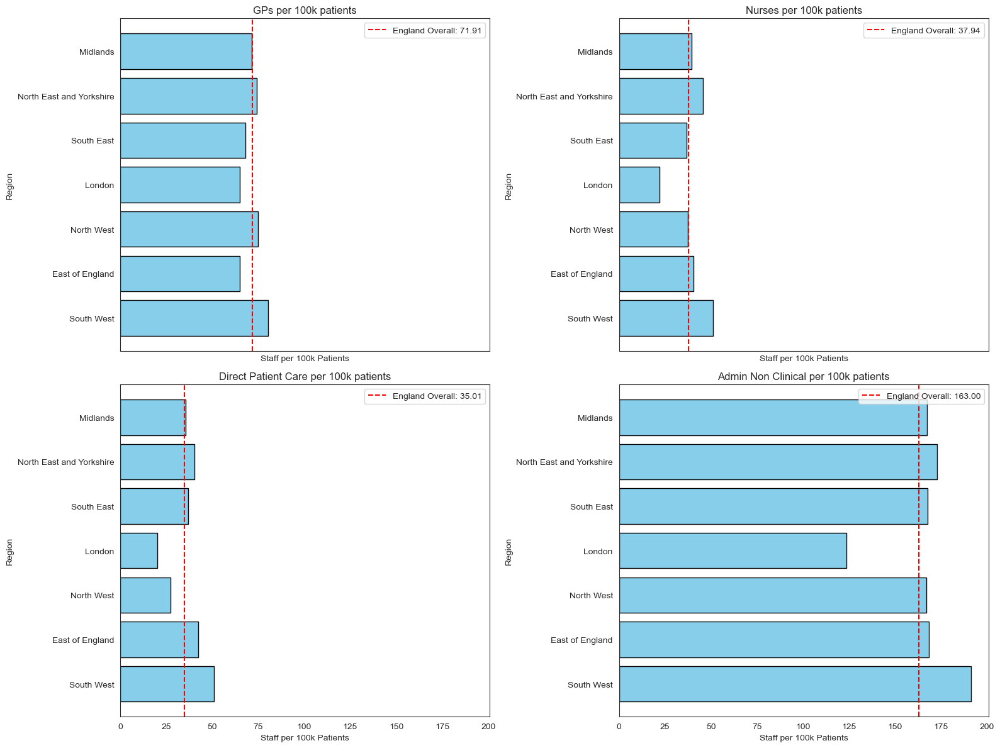

In [151]:
# Plotting staffing levels comparing to England data
# Sample data for England overall
england_data = {
    'Region': ['England'],
    'All GPs': [44446],
    'All Nurses': [23448],
    'All Direct Patient Care': [21638],
    'All Admin/Non-Clinical': [100749]
}

# Create DataFrame for England overall data
england_df = pd.DataFrame(england_data)

# Set region as index
merged_data.set_index('Region', inplace=True)

# Calculate England per 100k patients for each category
england_per_100k = {
    'GPs_per_100k_patients': (england_df['All GPs'].sum() / merged_data['total_patients'].sum()) * 100000,
    'Nurses_per_100k_patients': (england_df['All Nurses'].sum() / merged_data['total_patients'].sum()) * 100000,
    'Direct_Patient_Care_per_100k_patients': (england_df['All Direct Patient Care'].sum() / merged_data['total_patients'].sum()) * 100000,
    'Admin_Non_Clinical_per_100k_patients': (england_df['All Admin/Non-Clinical'].sum() / merged_data['total_patients'].sum()) * 100000
}

# Plotting the comparison of England overall data with regional data
fig, axes = plt.subplots(2, 2, figsize=(16, 12), sharex=True)

categories = [
    'GPs_per_100k_patients', 
    'Nurses_per_100k_patients', 
    'Direct_Patient_Care_per_100k_patients', 
    'Admin_Non_Clinical_per_100k_patients'
]

for i, category in enumerate(categories):
    ax = axes[i//2, i%2]
    england_value = england_per_100k[category]
    regional_values = merged_data[category]
    
    ax.barh(merged_data.index, regional_values, color='skyblue', edgecolor='black')
    ax.axvline(england_value, color='red', linestyle='--', 
               label=f'England Overall: {england_value:.2f}')
    
    ax.set_title(f'{category.replace("_", " ")}')
    ax.set_xlabel('Staff per 100k Patients')
    ax.set_ylabel('Region')
    ax.legend(loc='upper right')

plt.tight_layout()
plt.savefig('regional_breakdown_staffing_to_national_level.png')
plt.show()


<a id="Regional-Predictive-Analysis"></a>
# Time series analysis of Regional NHS data

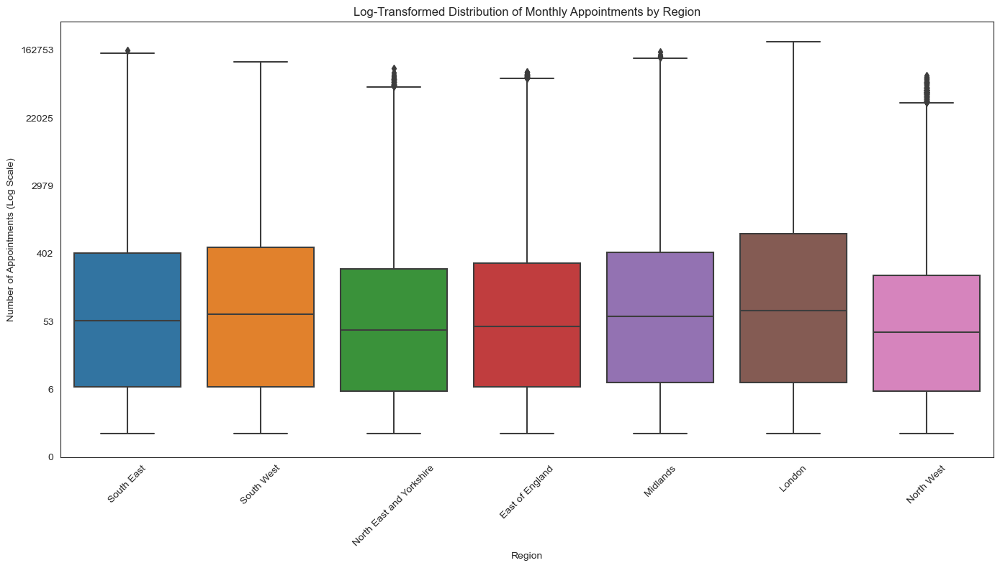

In [153]:
# Preparation for the regional data time-series analysis
# Load the monthly data
ar = pd.read_csv('updated_appointments_regional.csv')

# Ensure the appointment_month column is in datetime format
ar['appointment_month'] = pd.to_datetime(ar['appointment_month'])

# Filter the data for the specified regions
regions = ['London', 'South West', 'South East', 'Midlands', 'East of England', 
           'North West', 'North East and Yorkshire']
appointment_data = ar[ar['region_name'].isin(regions)]

# Apply log transformation to the count_of_appointments
appointment_data['log_count_of_appointments'] = (
    np.log(appointment_data['count_of_appointments'] + 1))

# Plotting boxplots for each region's appointment data with log transformation
plt.figure(figsize=(14, 8))
sns.boxplot(x='region_name', y='log_count_of_appointments', data=appointment_data)

# Add value labels for every 2, 4, 6... on y-axis
y_ticks = np.arange(0, appointment_data['log_count_of_appointments'].max() + 1, 2)
y_tick_labels = [str(int(np.exp(y_tick)-1)) for y_tick in y_ticks]
plt.yticks(y_ticks, y_tick_labels)

plt.title('Log-Transformed Distribution of Monthly Appointments by Region')
plt.xlabel('Region')
plt.ylabel('Number of Appointments (Log Scale)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('regional_breakdown_box_plot.png')
plt.show()


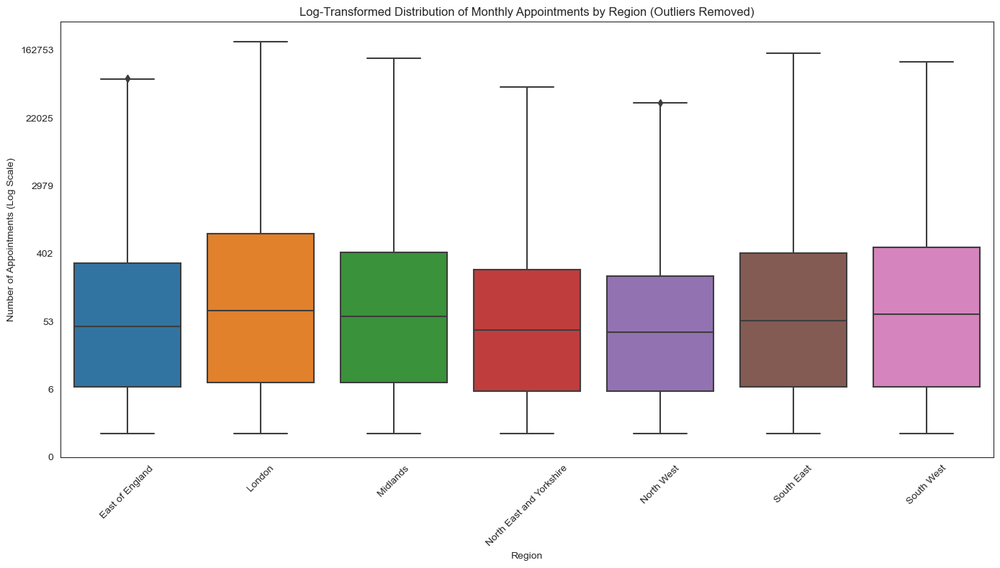

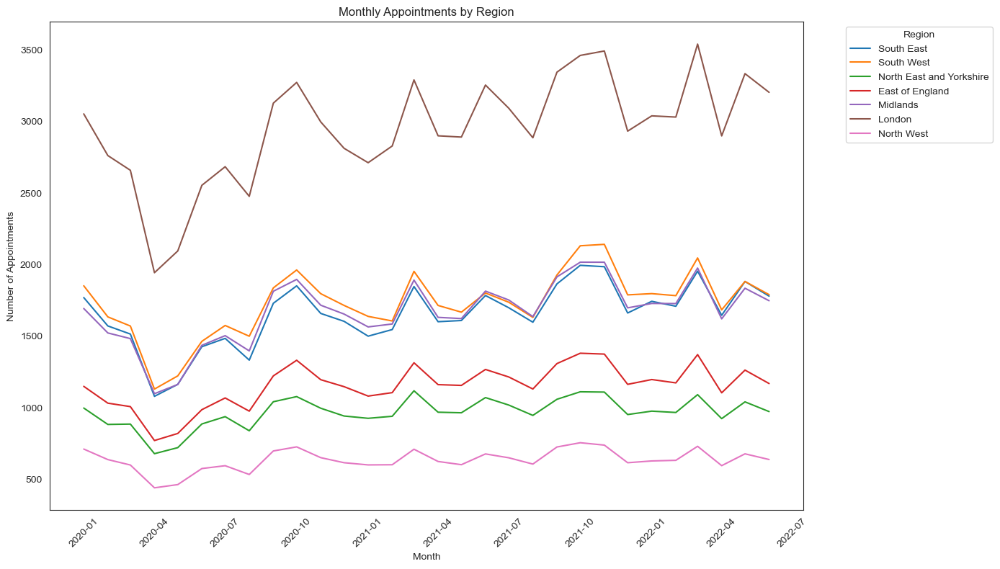

In [154]:
# Removing the outliers from the seasonal data in preparation for time-series analysis
# Load the monthly data
ar = pd.read_csv('updated_appointments_regional.csv')

# Ensure the appointment_month column is in datetime format
ar['appointment_month'] = pd.to_datetime(ar['appointment_month'])

# Filter the data for the specified regions
regions = ['London', 'South West', 'South East', 'Midlands', 'East of England', 
           'North West', 'North East and Yorkshire']
appointment_data = ar[ar['region_name'].isin(regions)]

# Apply log transformation to the count_of_appointments
appointment_data['log_count_of_appointments'] = (
    np.log(appointment_data['count_of_appointments'] + 1))

# Function to remove outliers based on IQR
def remove_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

# Remove outliers for each region
cleaned_appointment_data = (
    appointment_data.groupby('region_name')
    .apply(lambda x: remove_outliers(x, 'log_count_of_appointments'))
    .reset_index(drop=True))

# Plotting boxplots for each region's appointment data with log transformation 
# and outliers removed
plt.figure(figsize=(14, 8))
sns.boxplot(x='region_name', y='log_count_of_appointments', data=cleaned_appointment_data)

# Add value labels for every 2, 4, 6... on y-axis
y_ticks = np.arange(0, cleaned_appointment_data['log_count_of_appointments'].max() + 1, 2)
y_tick_labels = [str(int(np.exp(y_tick)-1)) for y_tick in y_ticks]
plt.yticks(y_ticks, y_tick_labels)

plt.title('Log-Transformed Distribution of Monthly Appointments by Region '
          '(Outliers Removed)')
plt.xlabel('Region')
plt.ylabel('Number of Appointments (Log Scale)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Plotting the monthly appointment trends for each region
plt.figure(figsize=(14, 8))
sns.lineplot(x='appointment_month', y='count_of_appointments', hue='region_name', 
             data=appointment_data, palette='tab10', errorbar=None)
plt.title('Monthly Appointments by Region')
plt.xlabel('Month')
plt.ylabel('Number of Appointments')
plt.xticks(rotation=45)
plt.legend(title='Region', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig('regional_breakdown_over_time.png')
plt.show()

Analyzing region: London
Plot saved to moving_average_london.png


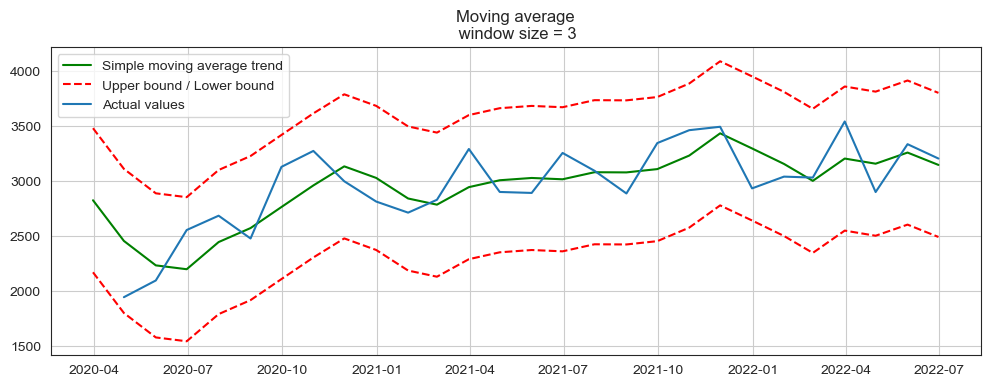

Plot saved to time_series_decomposition_london.png


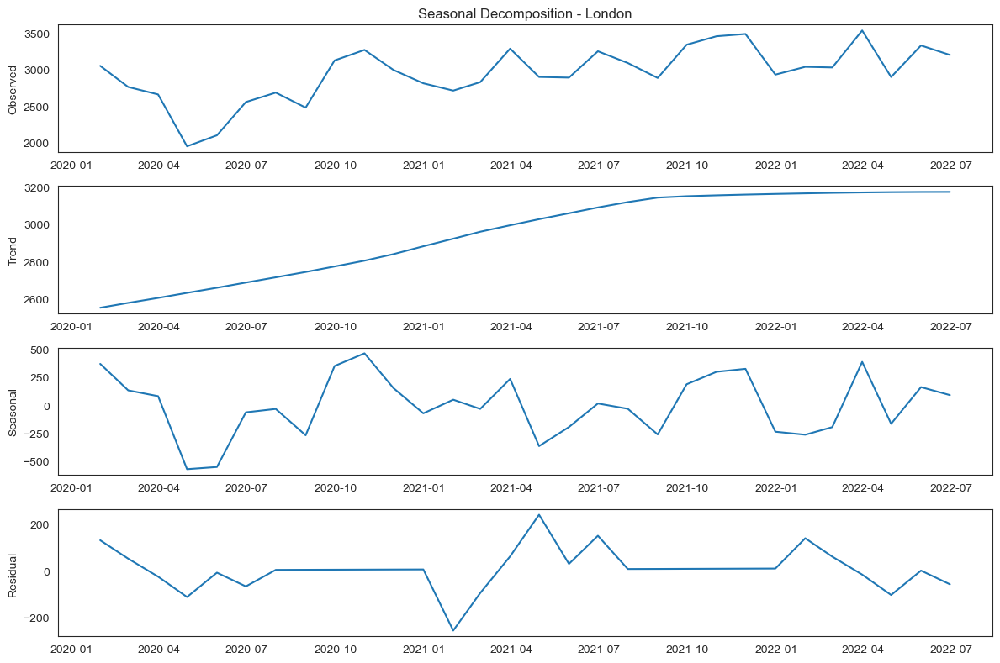

Plot saved to arima_forecasts_london.png


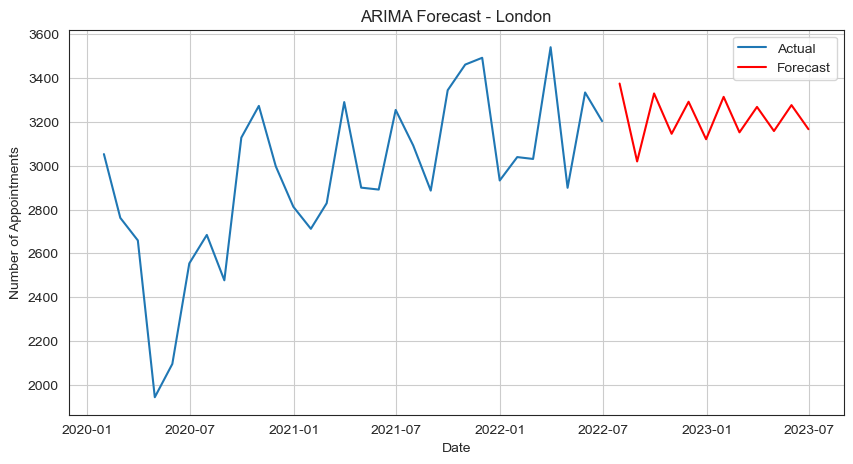

Analyzing region: South West
Plot saved to moving_average_south_west.png


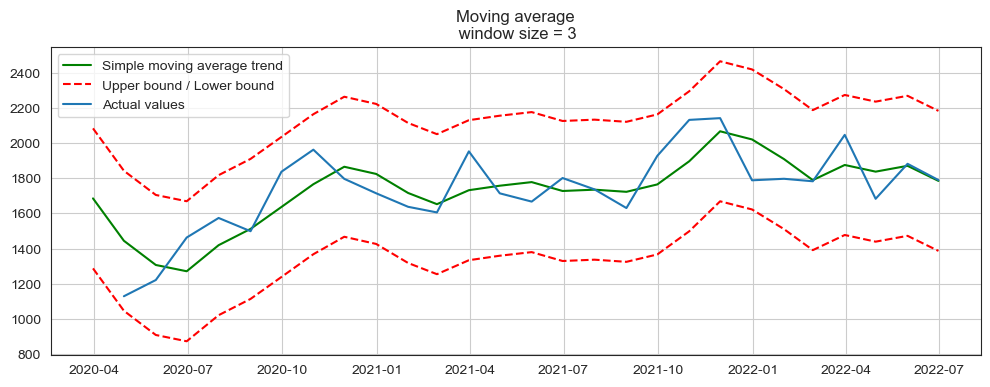

Plot saved to time_series_decomposition_south_west.png


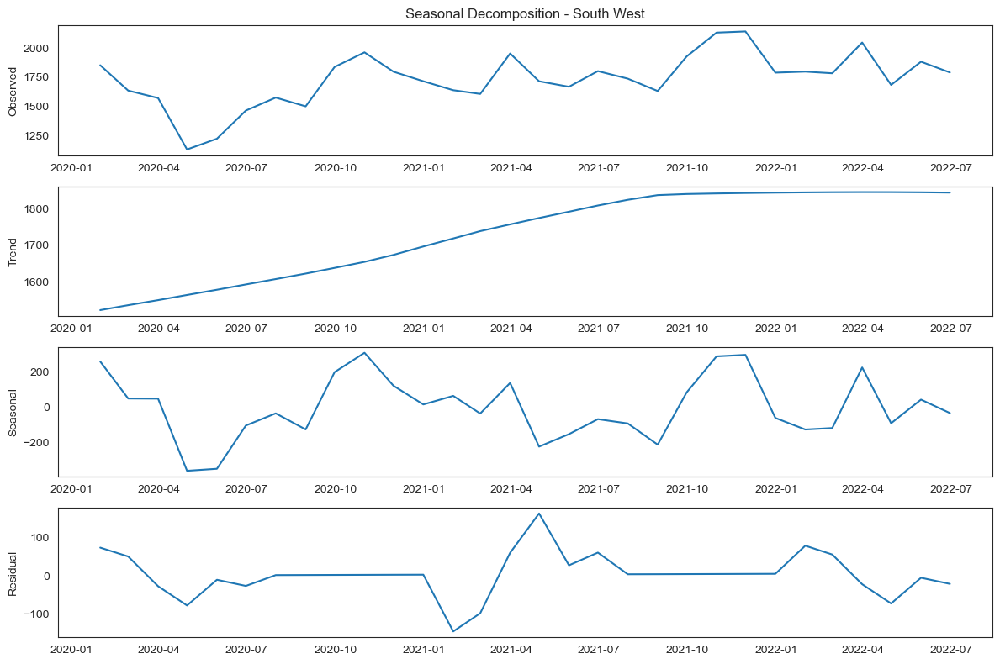

Plot saved to arima_forecasts_south_west.png


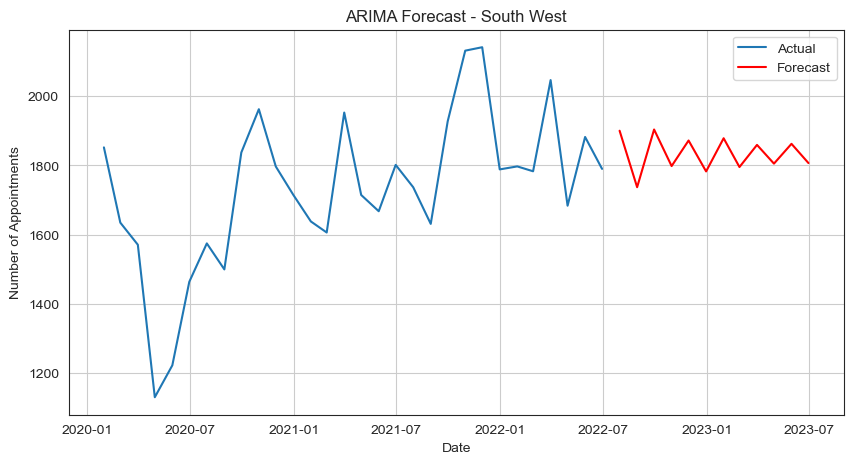

Analyzing region: South East
Plot saved to moving_average_south_east.png


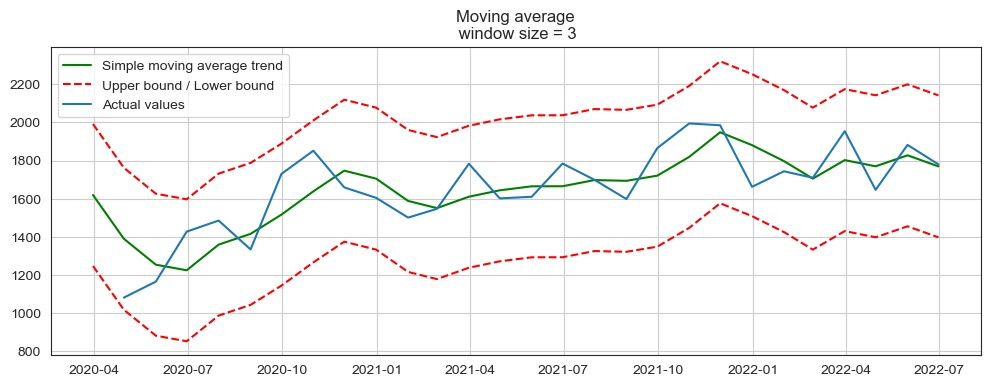

Plot saved to time_series_decomposition_south_east.png


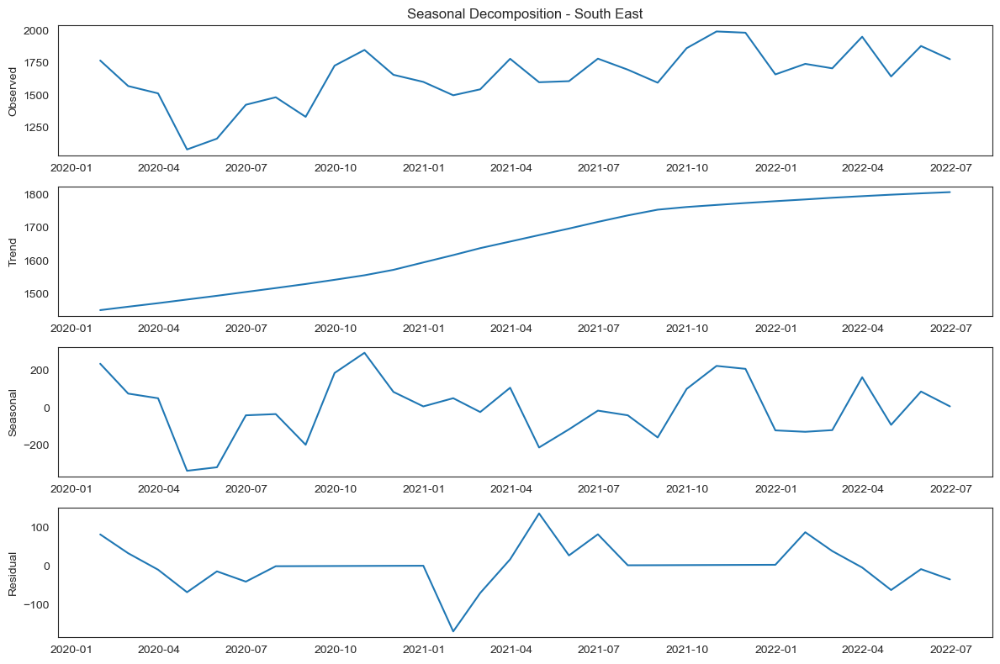

Plot saved to arima_forecasts_south_east.png


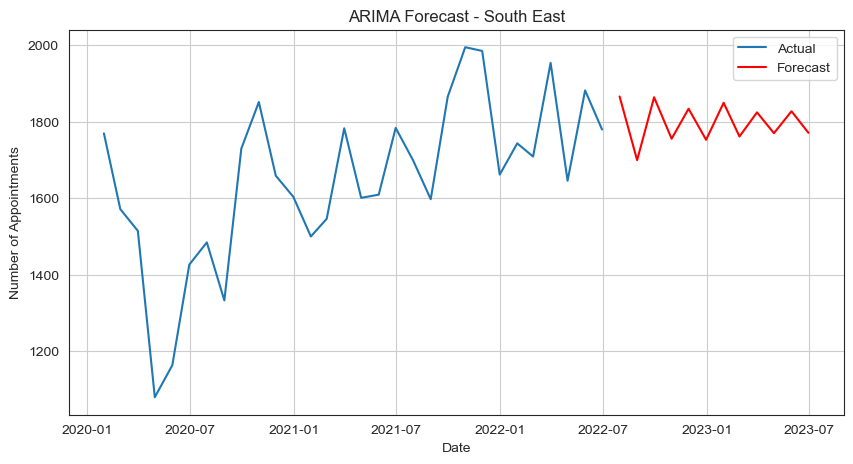

Analyzing region: Midlands
Plot saved to moving_average_midlands.png


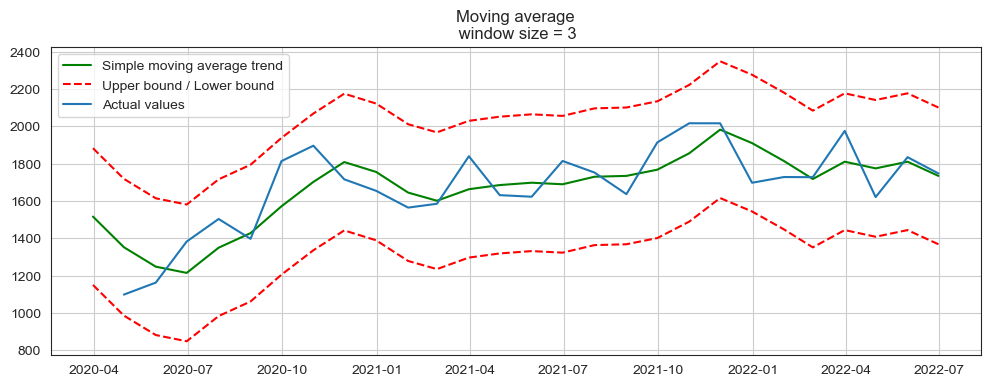

Plot saved to time_series_decomposition_midlands.png


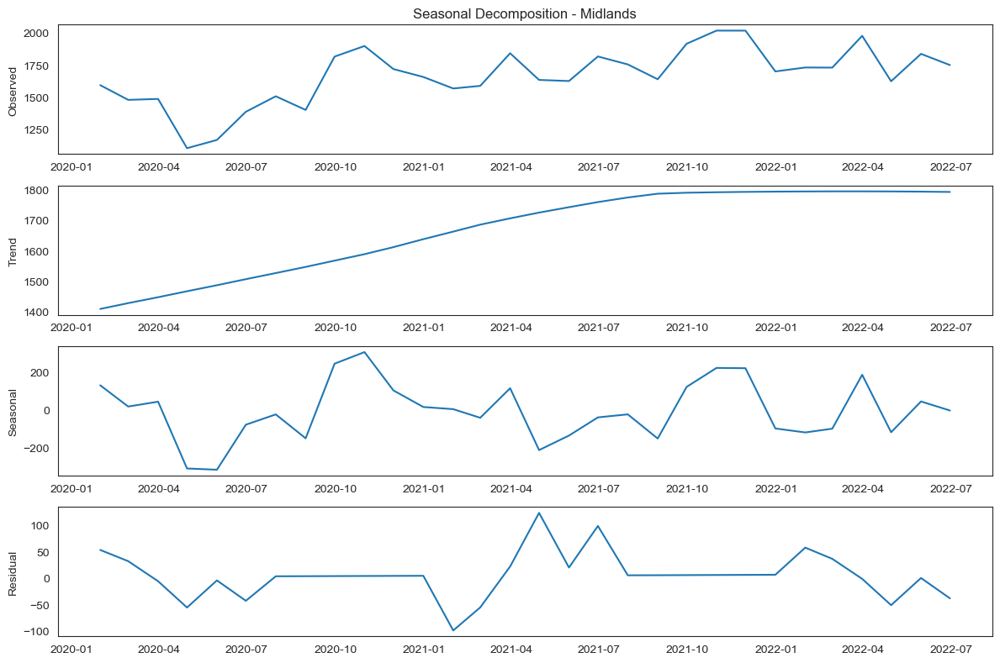

Plot saved to arima_forecasts_midlands.png


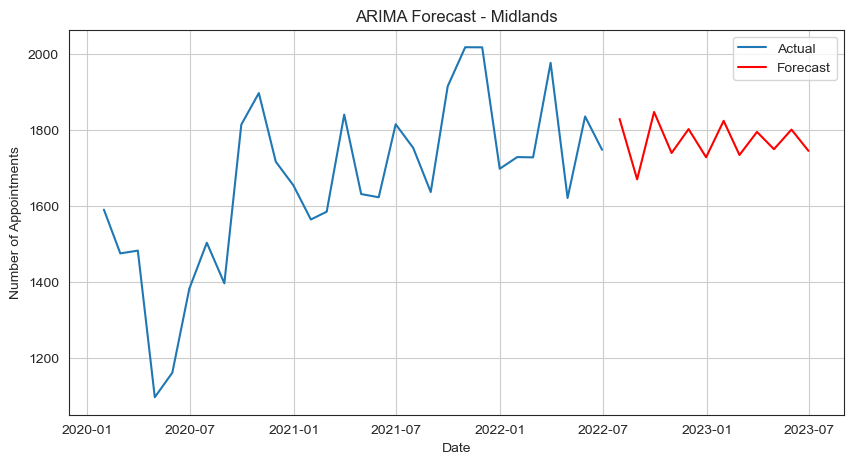

Analyzing region: East of England
Plot saved to moving_average_east_of_england.png


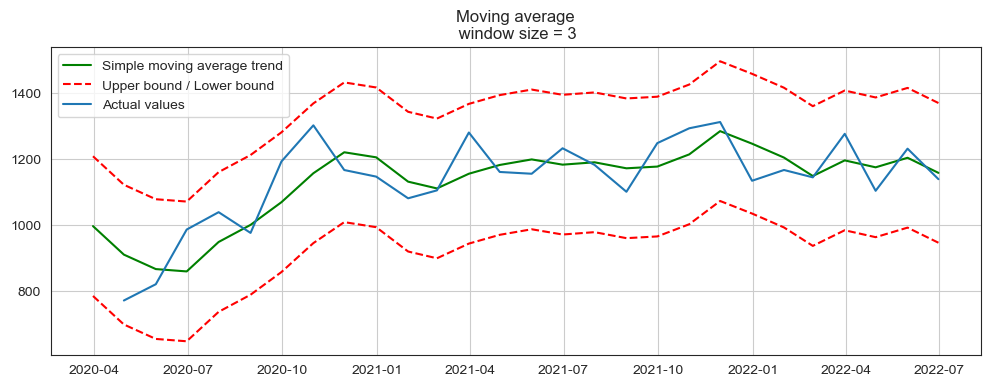

Plot saved to time_series_decomposition_east_of_england.png


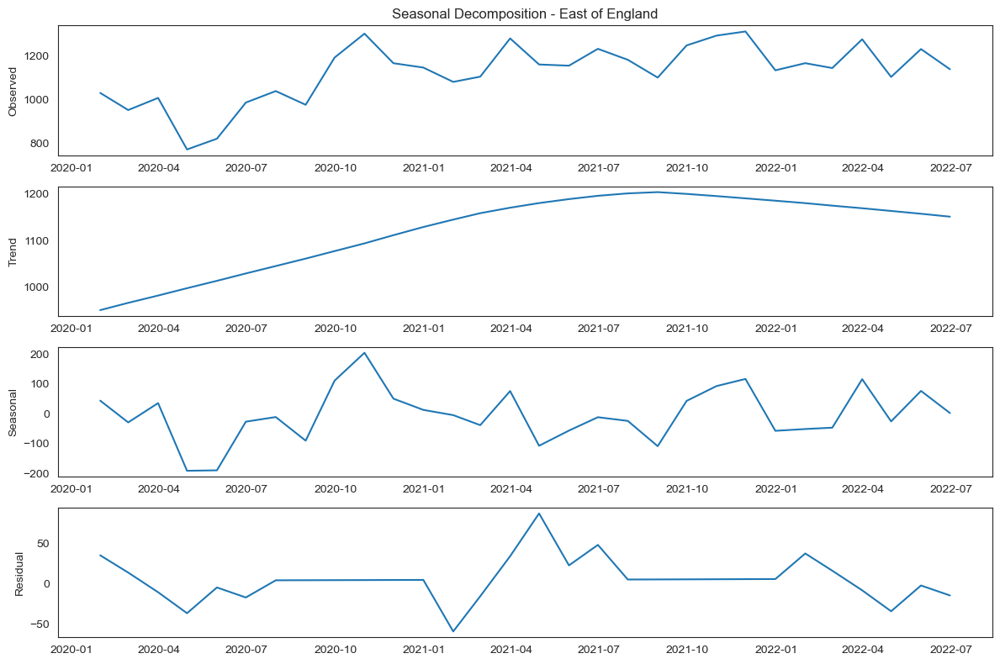

Plot saved to arima_forecasts_east_of_england.png


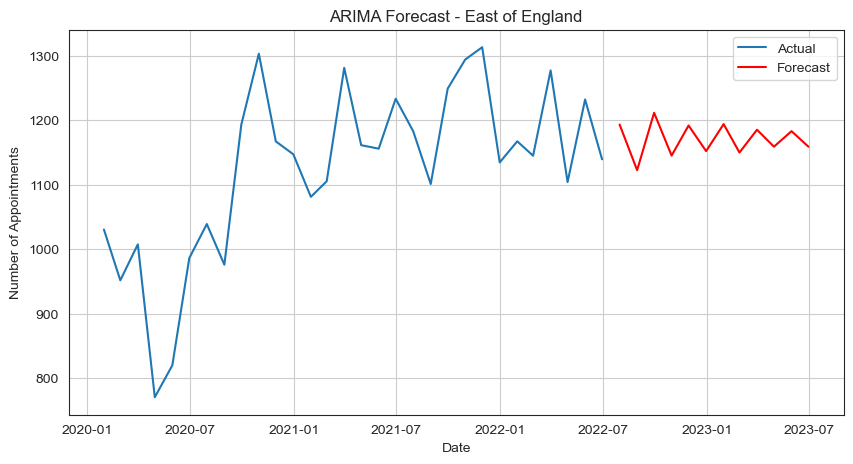

Analyzing region: North West
Plot saved to moving_average_north_west.png


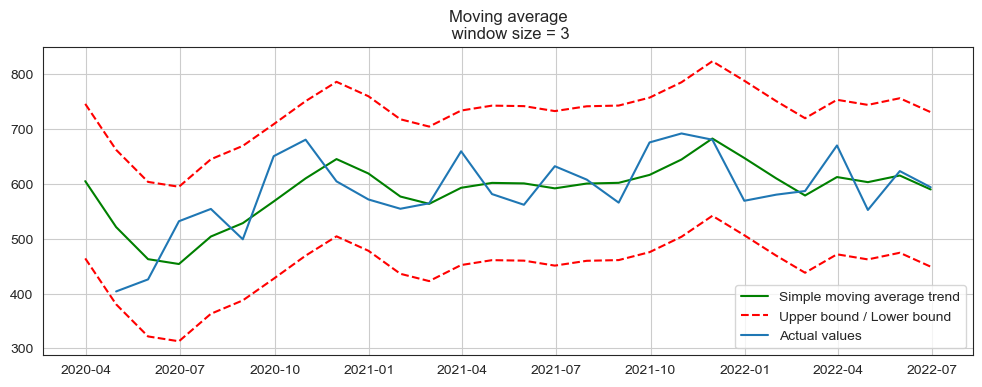

Plot saved to time_series_decomposition_north_west.png


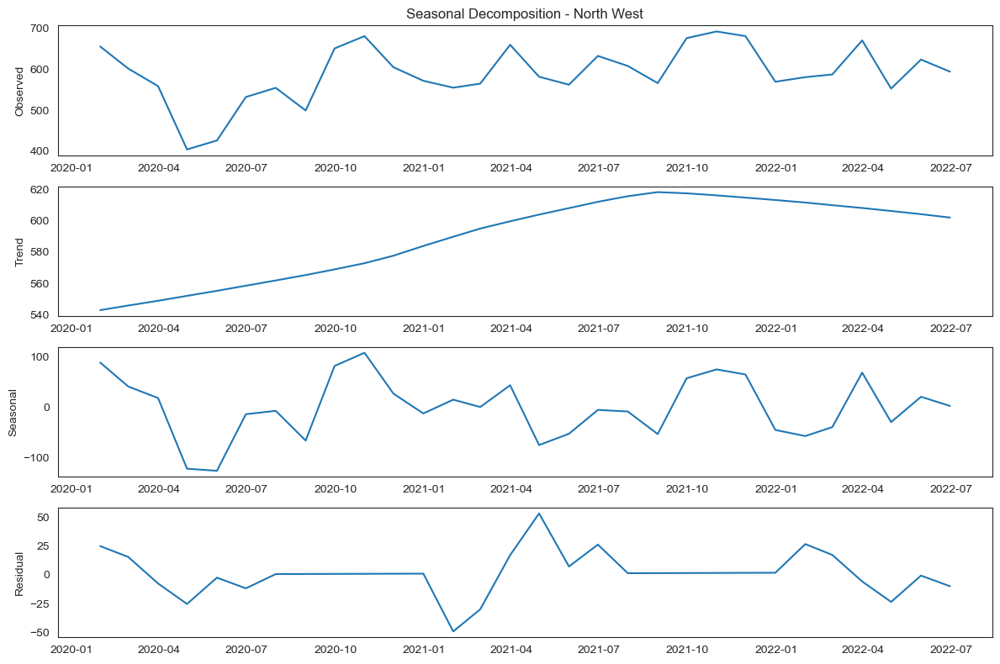

Plot saved to arima_forecasts_north_west.png


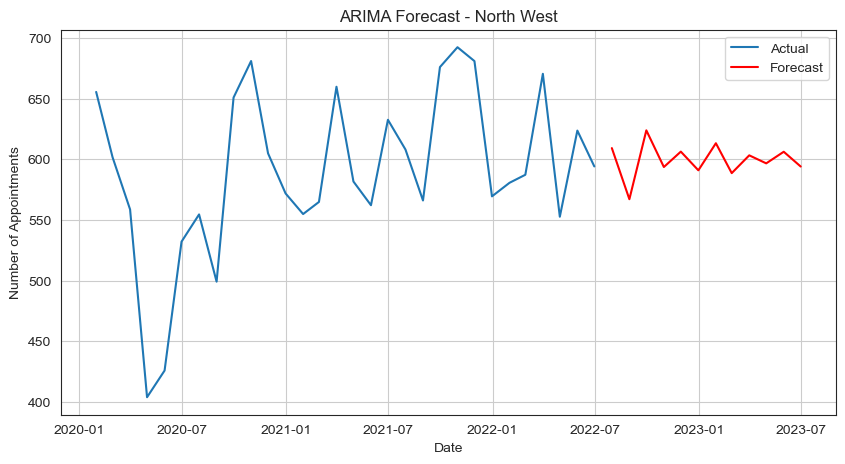

Analyzing region: North East and Yorkshire
Plot saved to moving_average_north_east_and_yorkshire.png


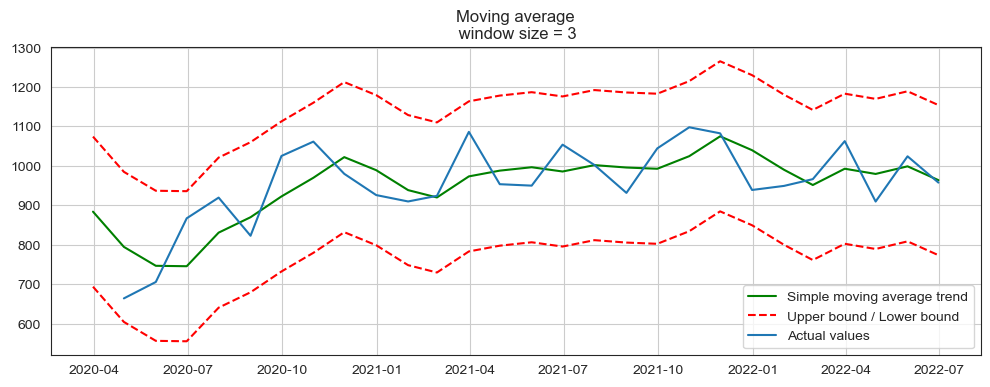

Plot saved to time_series_decomposition_north_east_and_yorkshire.png


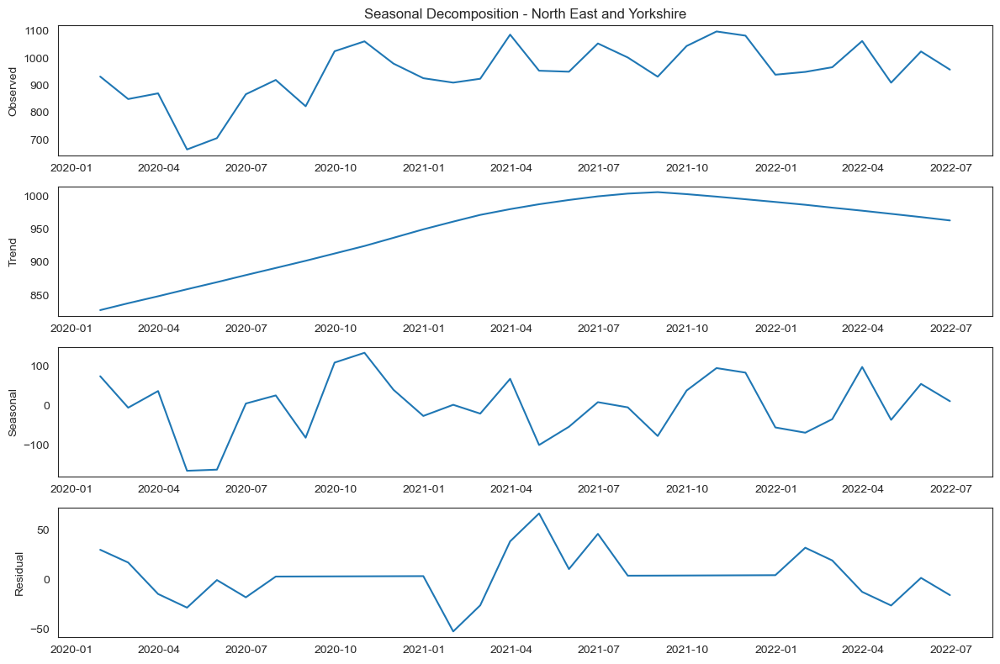

Plot saved to arima_forecasts_north_east_and_yorkshire.png


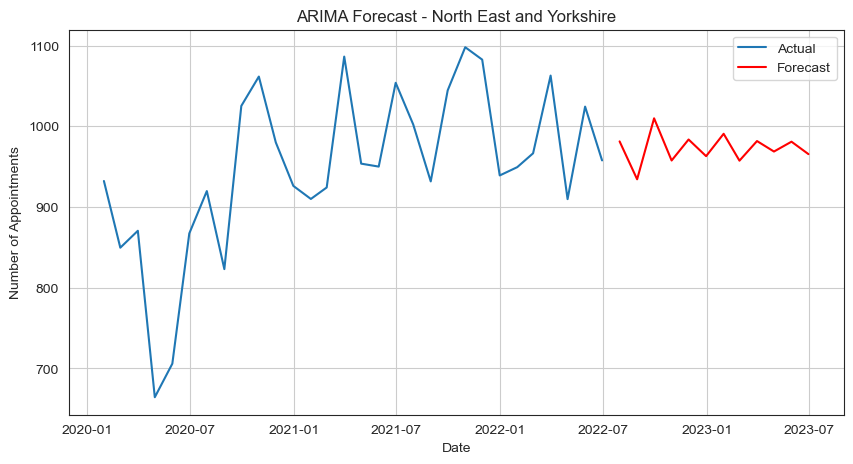

Plot saved to sarima_forecasts_london.png


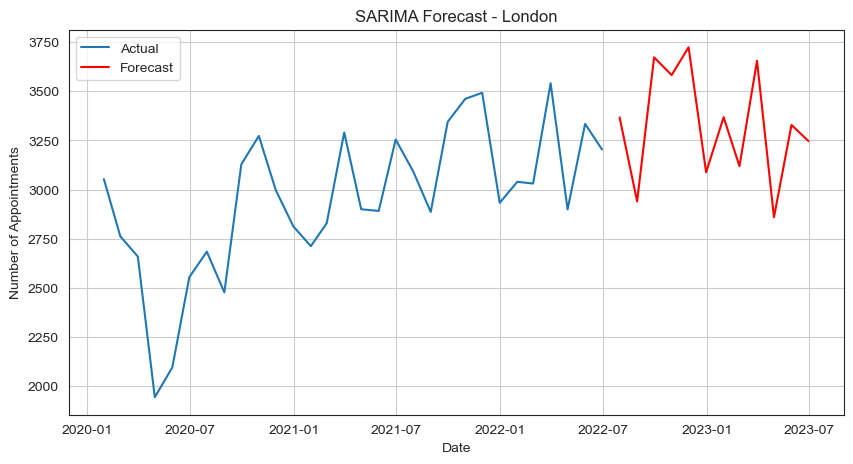

Plot saved to sarima_forecasts_south_west.png


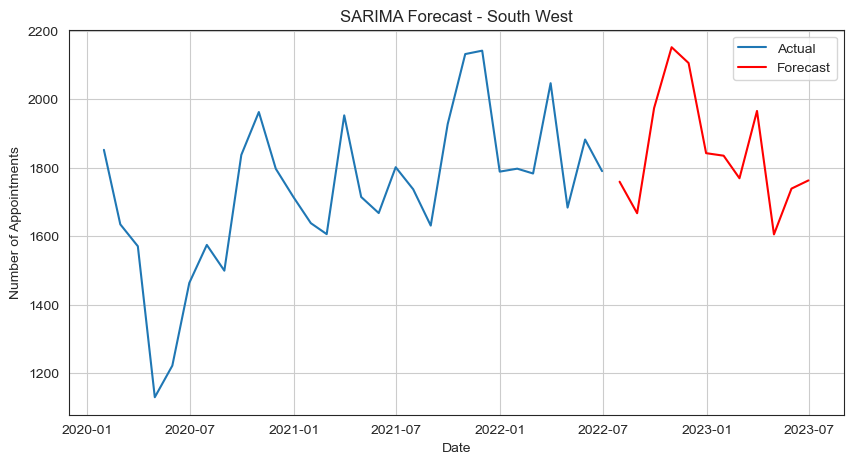

Plot saved to sarima_forecasts_south_east.png


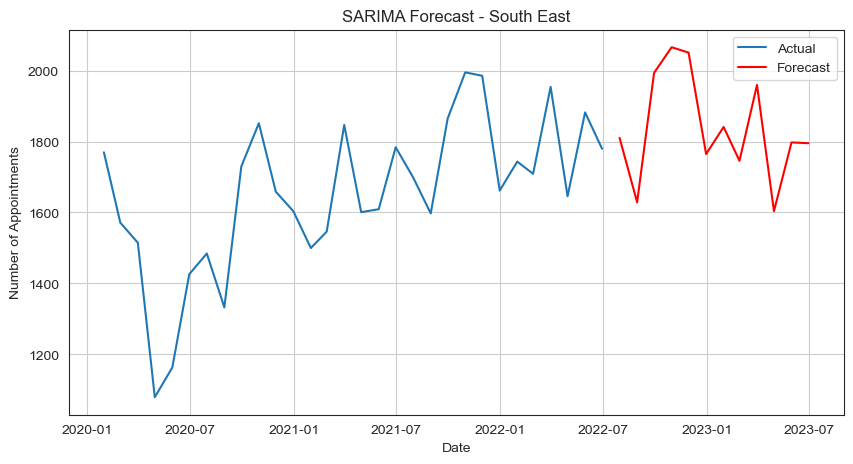

Plot saved to sarima_forecasts_midlands.png


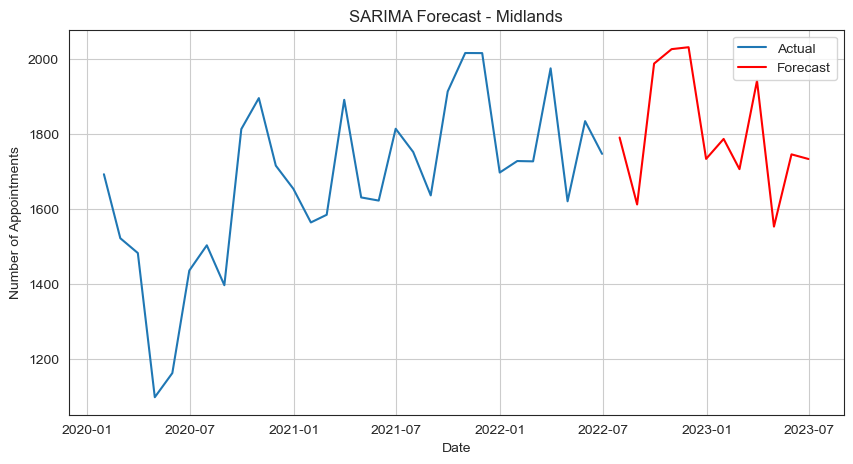

Plot saved to sarima_forecasts_east_of_england.png


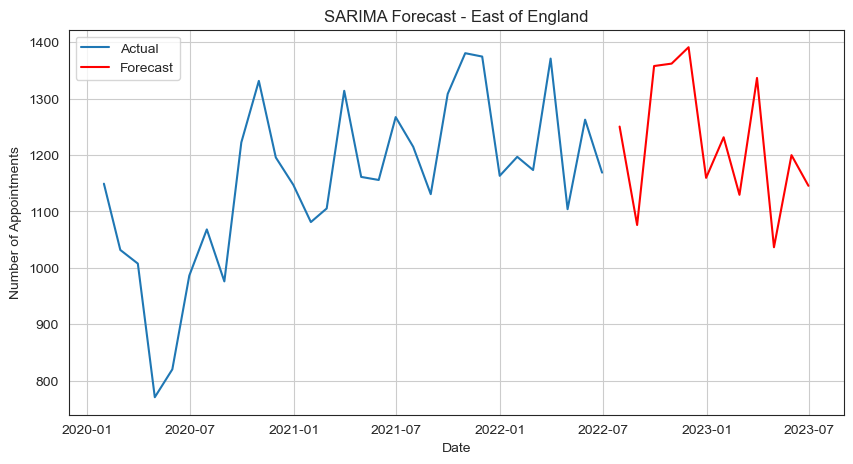

Plot saved to sarima_forecasts_north_west.png


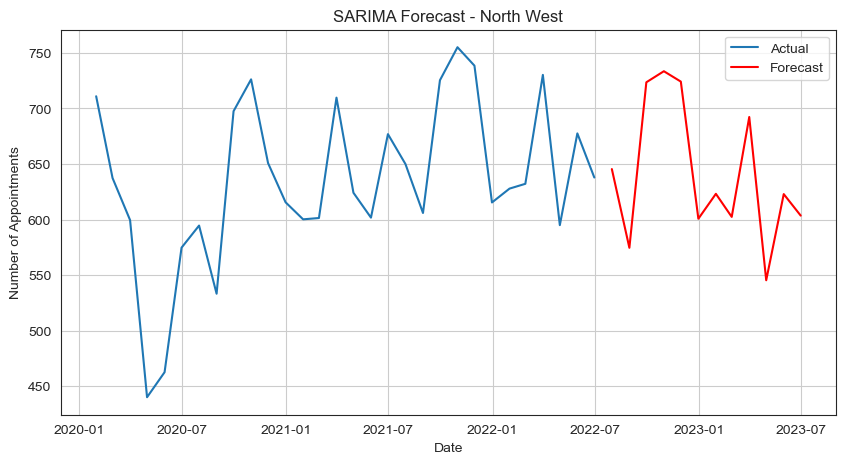

Plot saved to sarima_forecasts_north_east_and_yorkshire.png


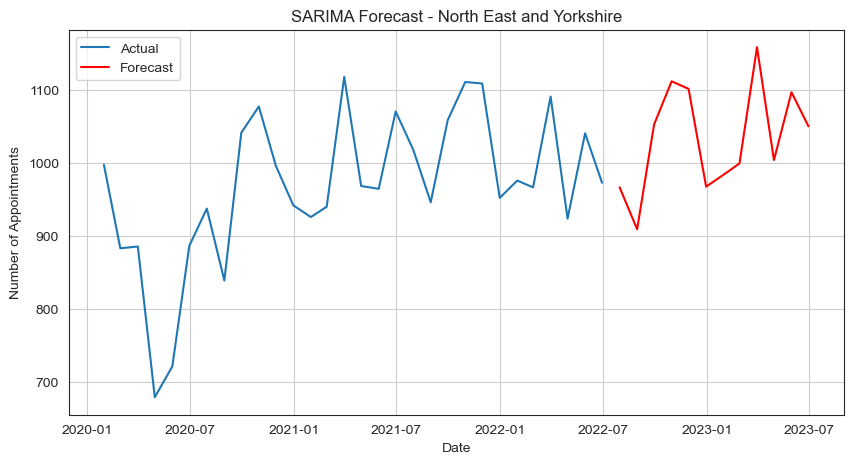

In [155]:
# Creating time-series analysis - moving average, seasonal trends and SARIMA and ARIMA predictions for the regional data
# Selecting the regions data
cleaned_appointment_data['region_name'] = cleaned_appointment_data['region_name']

# Function to calculate and plot the simple moving average.
def plot_moving_average(series, window, plot_intervals=False, scale=1.96):
    rolling_mean = series.rolling(window=window).mean()
    
    plt.figure(figsize=(12,4))
    plt.title("Moving average\n window size = {}".format(window))
    plt.plot(rolling_mean, 'g', label='Simple moving average trend')
    
    # Plot confidence intervals for smoothed values.
    if plot_intervals:
        mae = mean_absolute_error(series[window:], rolling_mean[window:])
        deviation = np.std(series[window:] - rolling_mean[window:])
        lower_bound = rolling_mean - (mae + scale * deviation)
        upper_bound = rolling_mean + (mae + scale * deviation)
        plt.plot(upper_bound, 'r--', label='Upper bound / Lower bound')
        plt.plot(lower_bound, 'r--')
            
    plt.plot(series[window:], label='Actual values')
    plt.legend(loc='best')
    plt.grid(True)
    save_plot(f'moving_average_{region.replace(" ", "_").lower()}.png')
    plt.show()

# Ensure the appointment_month column is in datetime format
cleaned_appointment_data['appointment_month'] = (
    pd.to_datetime(cleaned_appointment_data['appointment_month']))

# List of regions to analyze
regions = ['London', 'South West', 'South East', 'Midlands', 'East of England', 
           'North West', 'North East and Yorkshire']

for region in regions:
    print(f"Analyzing region: {region}")
    region_data = (
        cleaned_appointment_data[cleaned_appointment_data['region_name'] == region])
    region_data.set_index('appointment_month', inplace=True)
    region_series = region_data['count_of_appointments']

    # Resample the data to monthly frequency
    region_resample = region_series.resample('M').mean()

    # Plotting the moving average with a window size of 3
    plot_moving_average(region_resample, 3, plot_intervals=True)

    # Decompose the time series for the region
    stl = STL(region_resample, seasonal=13, period=12)
    result = stl.fit()

    # Plotting the decomposition
    plt.figure(figsize=(12, 8))
    plt.subplot(411)
    plt.plot(result.observed)
    plt.title(f'Seasonal Decomposition - {region}')
    plt.ylabel('Observed')

    plt.subplot(412)
    plt.plot(result.trend)
    plt.ylabel('Trend')

    plt.subplot(413)
    plt.plot(result.seasonal)
    plt.ylabel('Seasonal')

    plt.subplot(414)
    plt.plot(result.resid)
    plt.ylabel('Residual')

    plt.tight_layout()
    save_plot(f'time_series_decomposition_{region.replace(" ", "_").lower()}.png')
    plt.show()
    plt.show()

    # Forecasting using ARIMA for the region
    model = ARIMA(region_resample, order=(5,1,0))
    model_fit = model.fit()

    # Make forecast
    forecast = model_fit.forecast(steps=12)  # Forecasting for the next 12 months

    # Plotting the results
    plt.figure(figsize=(10, 5))
    plt.plot(region_resample, label='Actual')
    plt.plot(forecast, label='Forecast', color='red')
    plt.title(f'ARIMA Forecast - {region}')
    plt.xlabel('Date')
    plt.ylabel('Number of Appointments')
    plt.legend()
    plt.grid(True)
    save_plot(f'arima_forecasts_{region.replace(" ", "_").lower()}.png')
    plt.show()

# Function to apply SARIMA and plot forecast for each region
def apply_sarima(region_data, region_name):
    # Set the index
    region_data.set_index('appointment_month', inplace=True)
    
    # Resample to monthly data
    region_resample = region_data['count_of_appointments'].resample('M').mean()
    
    # Apply SARIMA model
    model = SARIMAX(region_resample, order=(1,1,1), seasonal_order=(1,1,1,12))
    model_fit = model.fit(disp=False)
    
    # Make forecast
    forecast = model_fit.get_forecast(steps=12)
    forecast_index = pd.date_range(start=region_resample.index[-1] + pd.DateOffset(1), 
                                   periods=12, freq='M')
    forecast_series = pd.Series(forecast.predicted_mean.values, index=forecast_index)
    
    # Plotting the results
    plt.figure(figsize=(10, 5))
    plt.plot(region_resample, label='Actual')
    plt.plot(forecast_series, label='Forecast', color='red')
    plt.title(f'SARIMA Forecast - {region_name}')
    plt.xlabel('Date')
    plt.ylabel('Number of Appointments')
    plt.legend()
    plt.grid(True)
    save_plot(f'sarima_forecasts_{region_name.replace(" ", "_").lower()}.png')
    plt.show()

# Apply SARIMA and plot forecast for each region
for region in regions:
    region_data = appointment_data[appointment_data['region_name'] == region]
    apply_sarima(region_data, region)


Analyzing region: London
Plot saved to moving_average_one_yearlondon.png


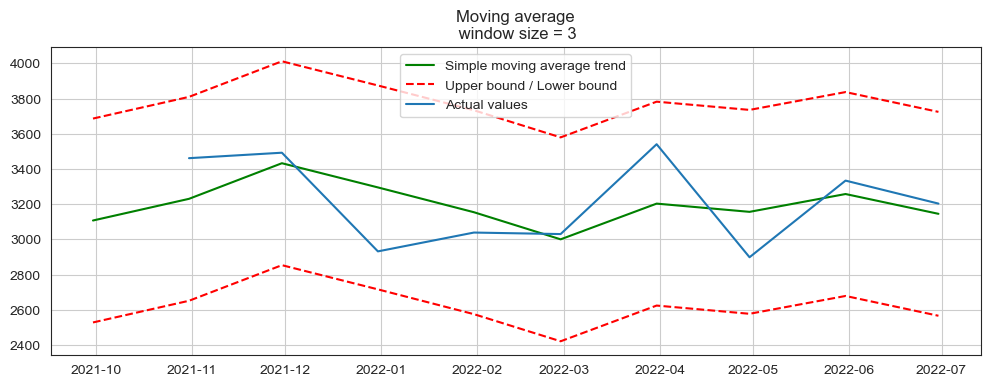

Plot saved to time_series_decomposition_one_yearlondon.png


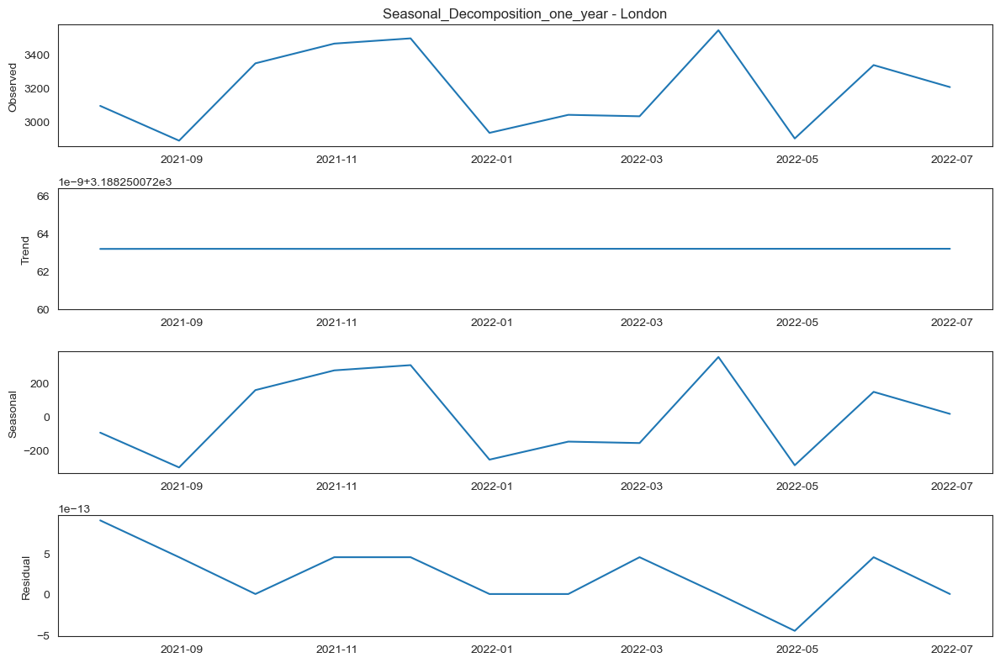

Plot saved to arima_forecasts_one_yearlondon.png


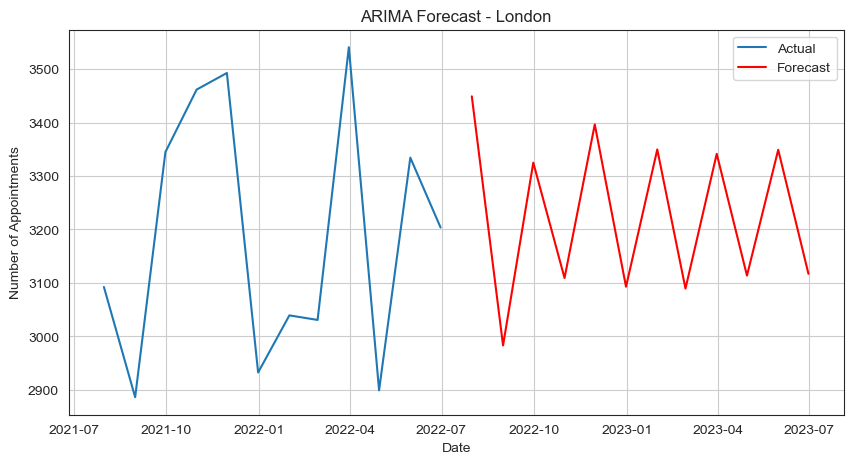

Analyzing region: South West
Plot saved to moving_average_one_yearsouth_west.png


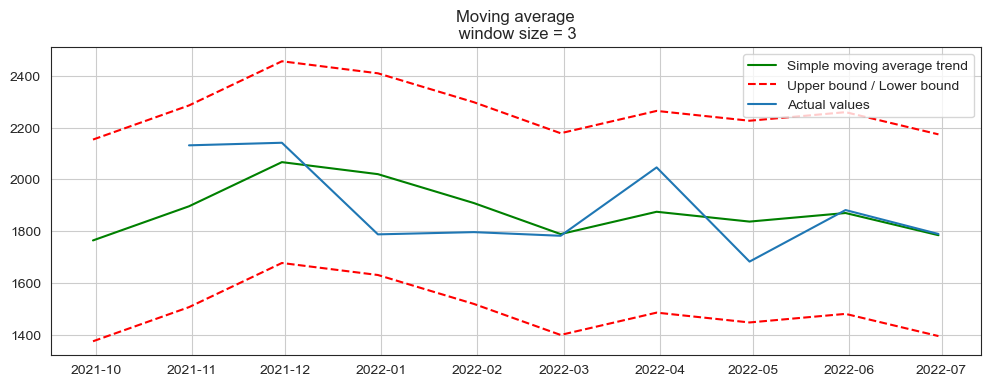

Plot saved to time_series_decomposition_one_yearsouth_west.png


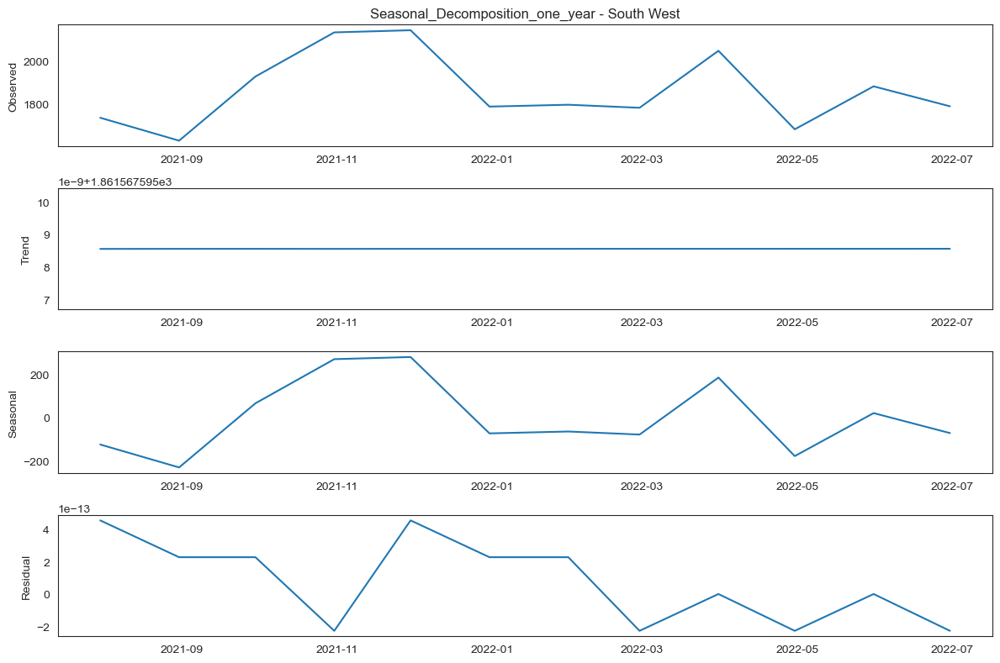

Plot saved to arima_forecasts_one_yearsouth_west.png


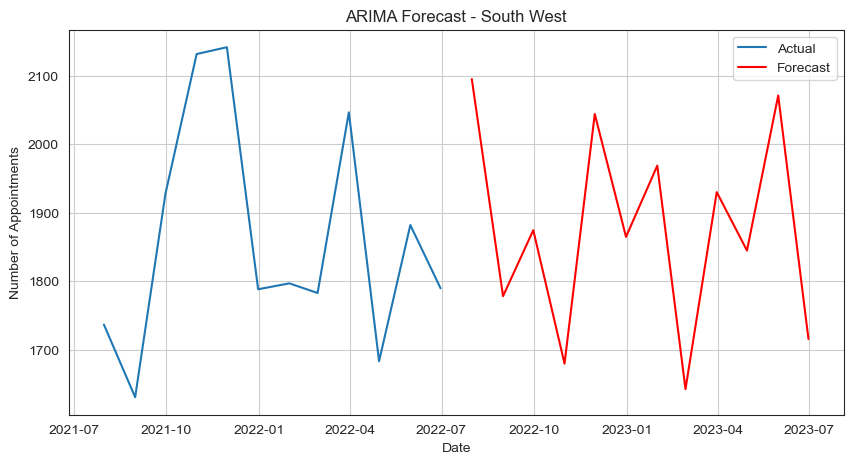

Analyzing region: South East
Plot saved to moving_average_one_yearsouth_east.png


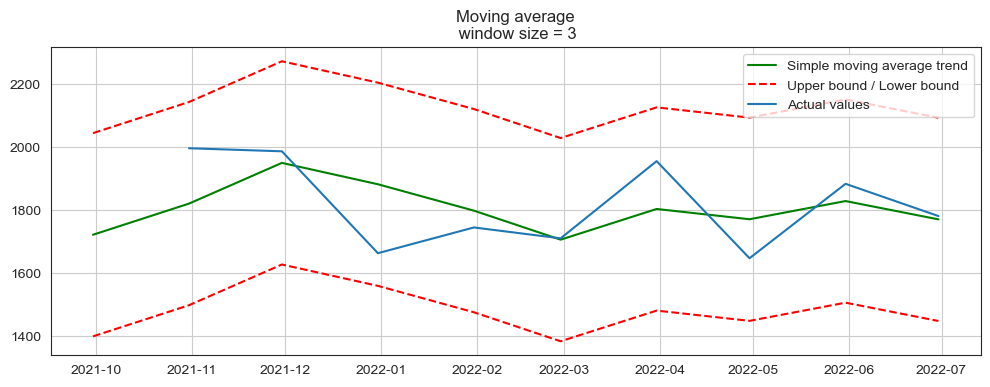

Plot saved to time_series_decomposition_one_yearsouth_east.png


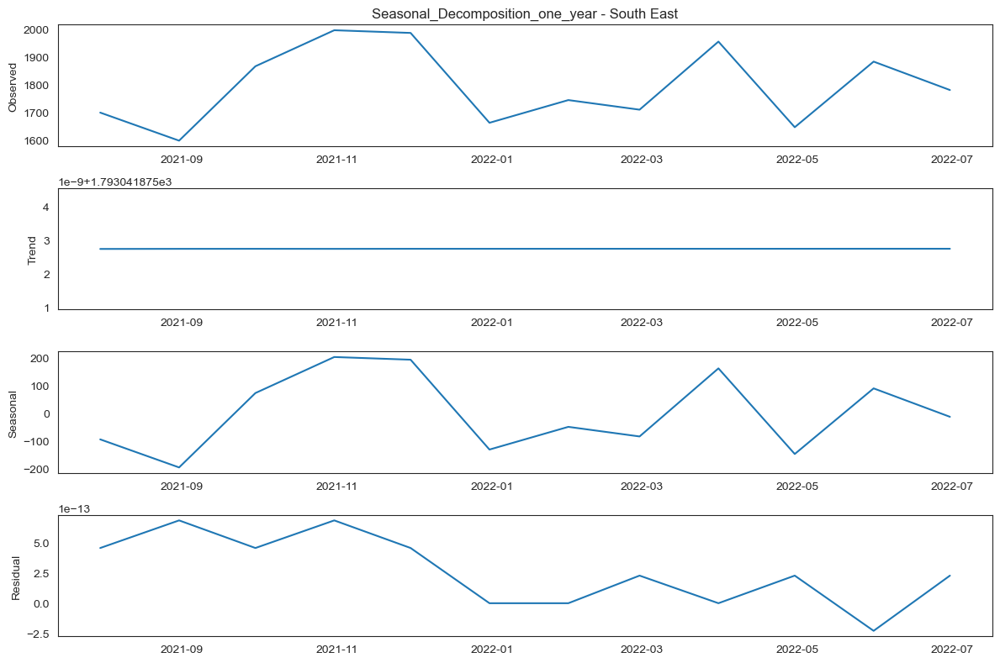

Plot saved to arima_forecasts_one_yearsouth_east.png


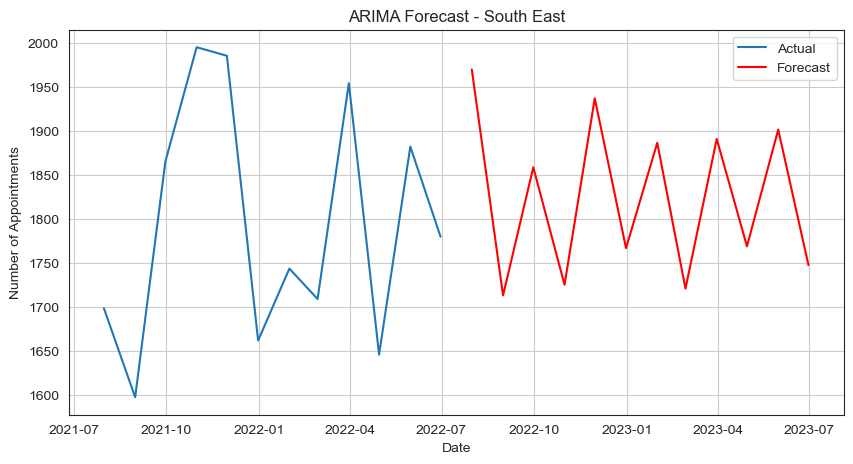

Analyzing region: Midlands
Plot saved to moving_average_one_yearmidlands.png


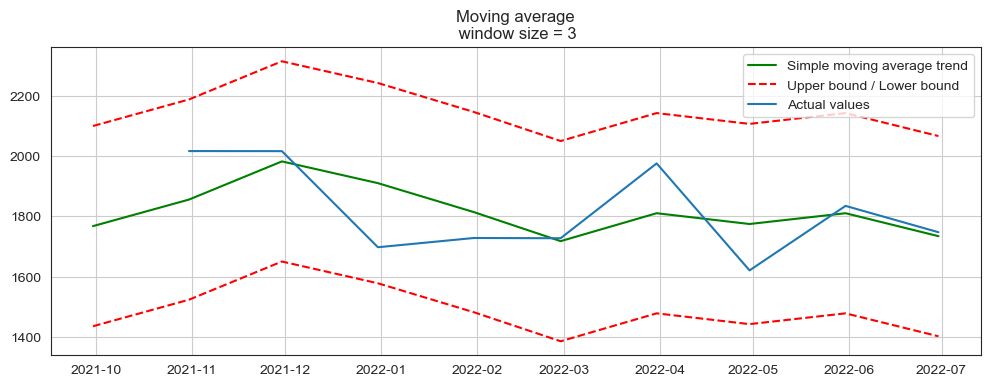

Plot saved to time_series_decomposition_one_yearmidlands.png


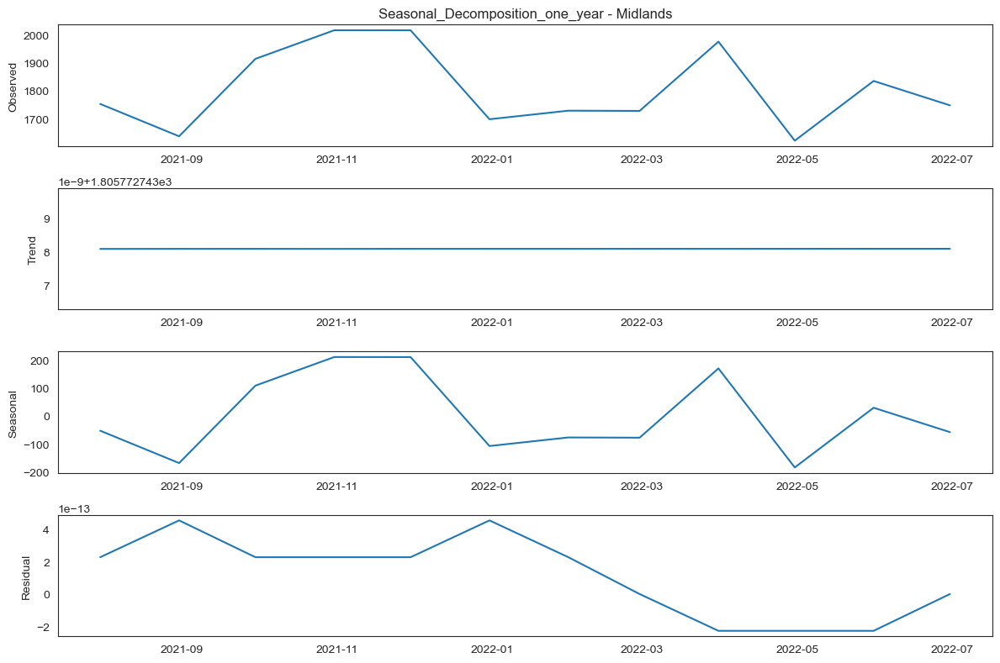

Plot saved to arima_forecasts_one_yearmidlands.png


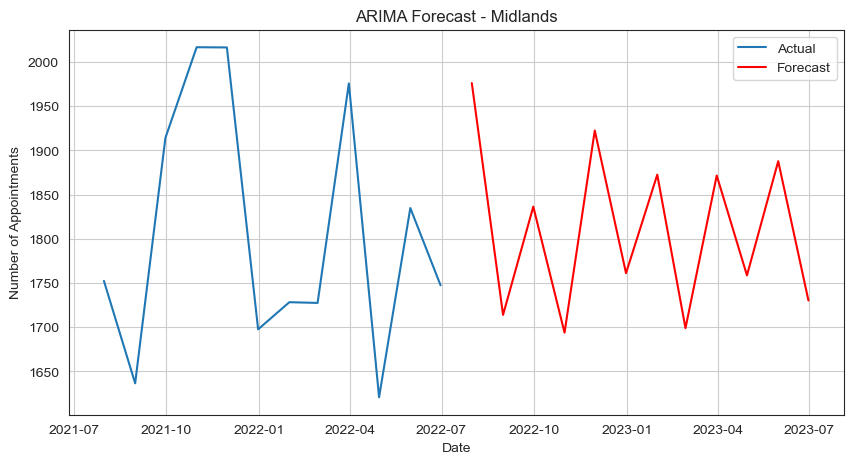

Analyzing region: East of England
Plot saved to moving_average_one_yeareast_of_england.png


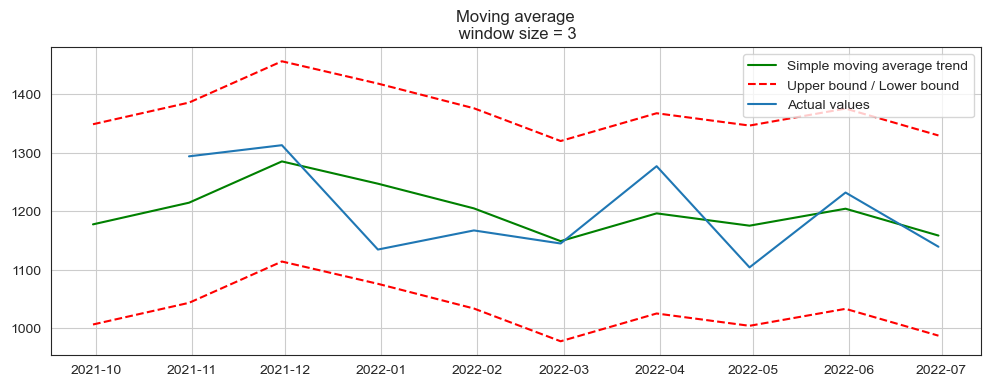

Plot saved to time_series_decomposition_one_yeareast_of_england.png


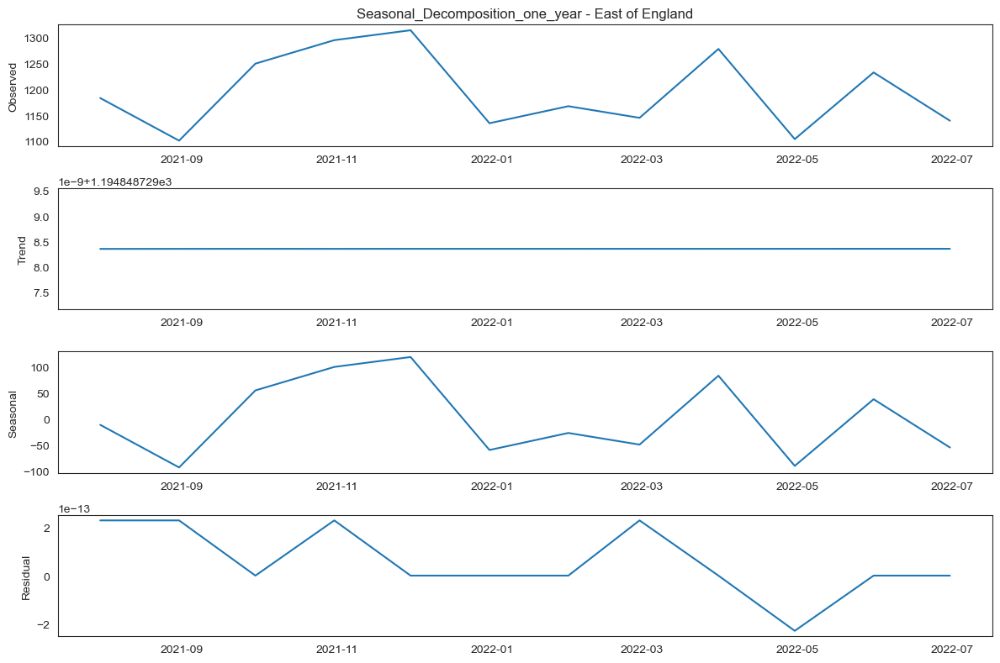

Plot saved to arima_forecasts_one_yeareast_of_england.png


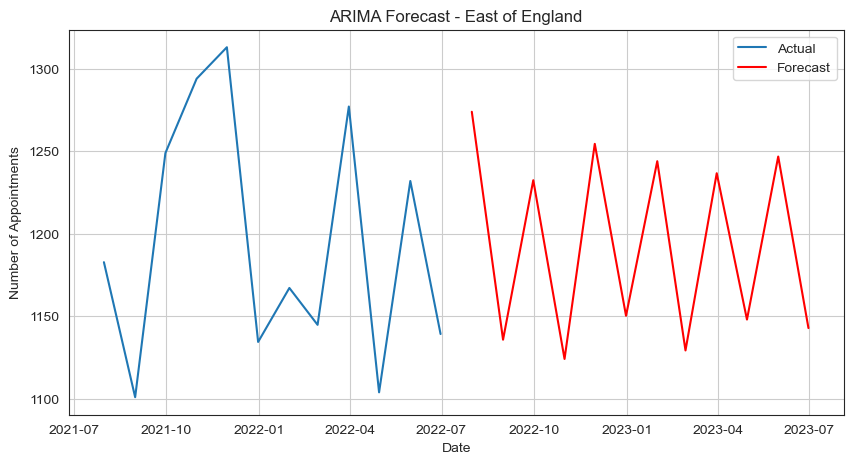

Analyzing region: North West
Plot saved to moving_average_one_yearnorth_west.png


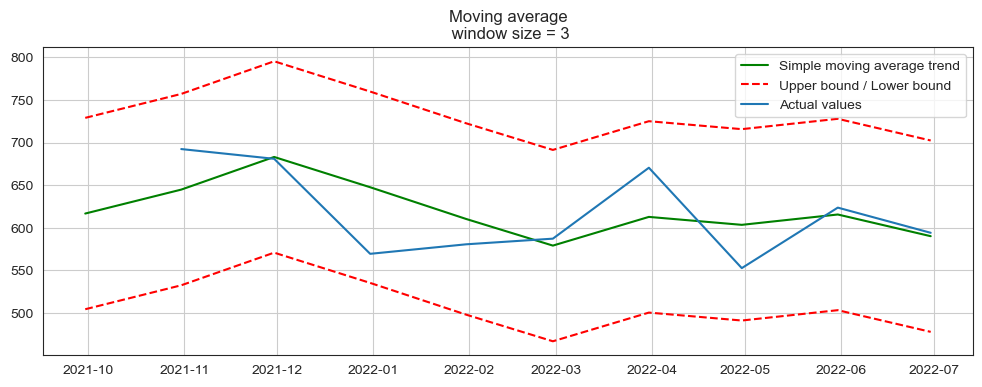

Plot saved to time_series_decomposition_one_yearnorth_west.png


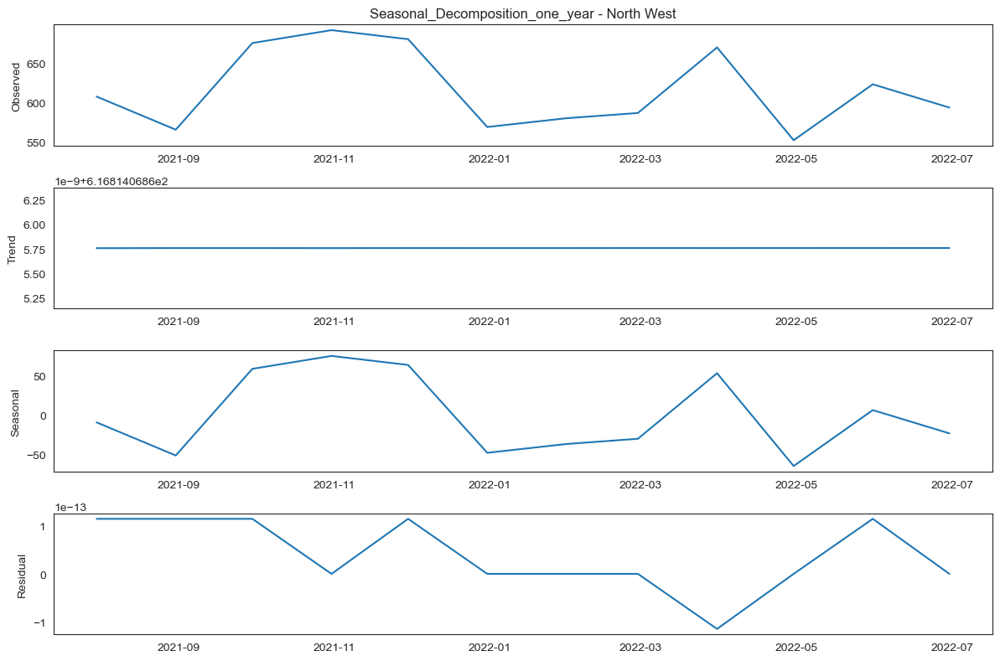

Plot saved to arima_forecasts_one_yearnorth_west.png


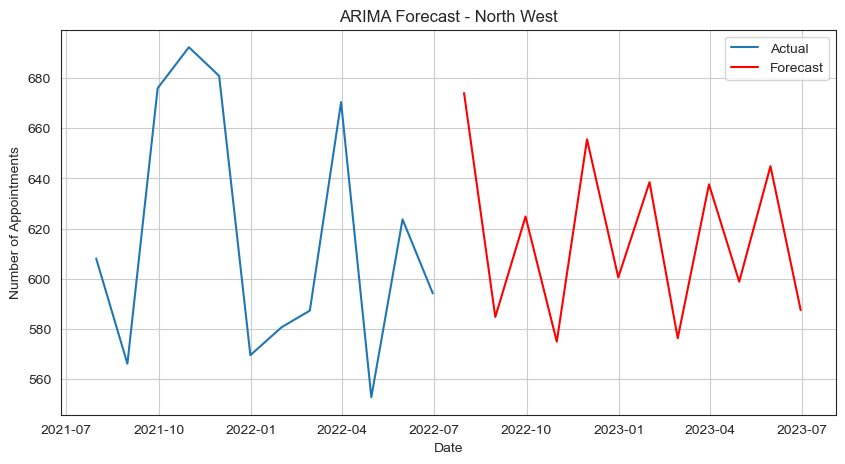

Analyzing region: North East and Yorkshire
Plot saved to moving_average_one_yearnorth_east_and_yorkshire.png


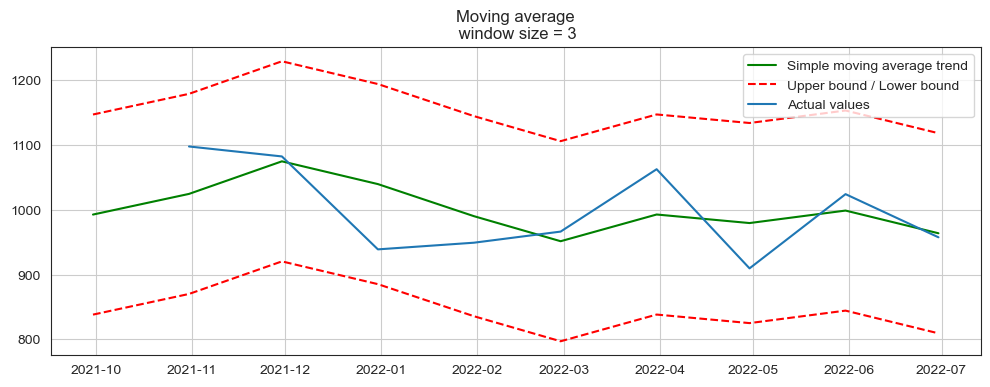

Plot saved to time_series_decomposition_one_yearnorth_east_and_yorkshire.png


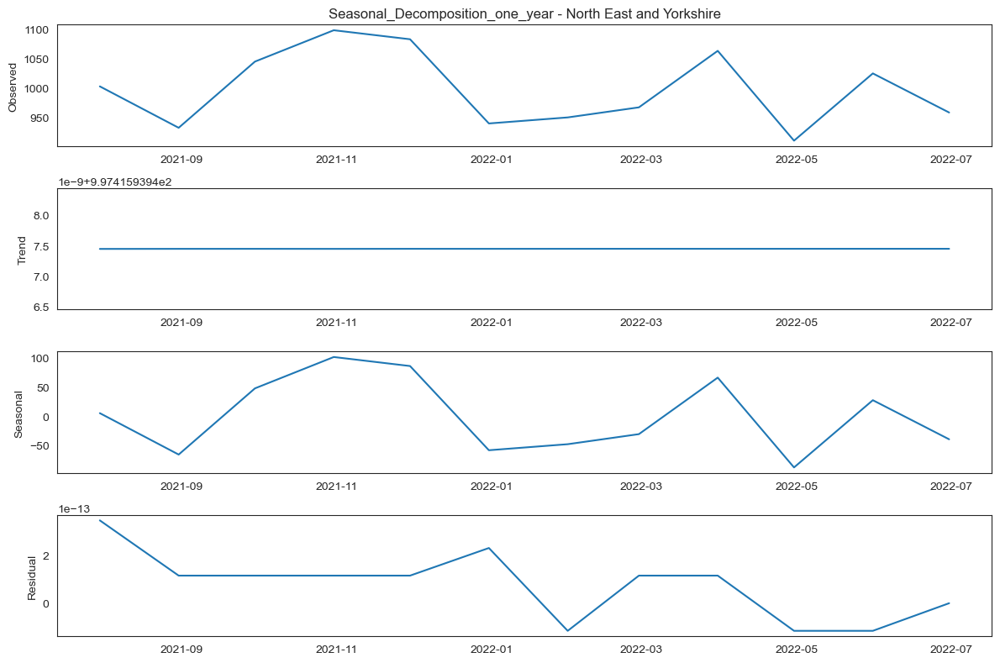

Plot saved to arima_forecasts_one_yearnorth_east_and_yorkshire.png


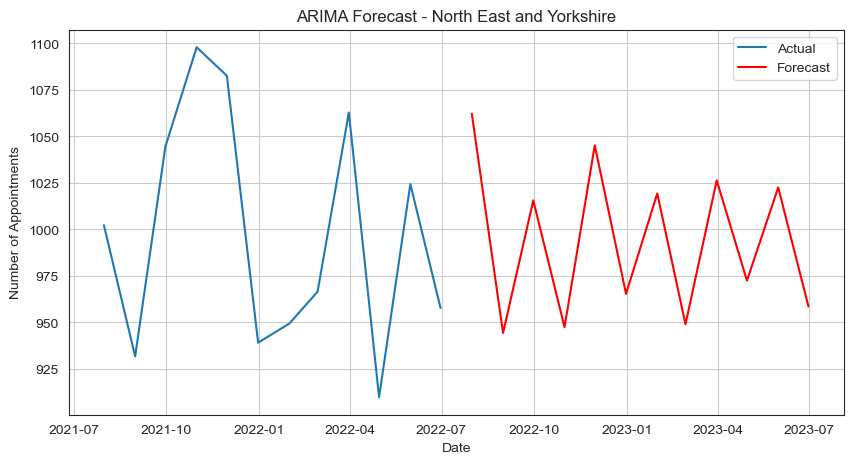

In [156]:
# Limiting the moving average and predictions to descount to COVID lockdowns. 
# SARIMA model requires longer-term data, threrefore it was excluded here
# Function to calculate and plot the simple moving average.
def plot_moving_average(series, window, plot_intervals=False, scale=1.96):
    rolling_mean = series.rolling(window=window).mean()
    
    plt.figure(figsize=(12,4))
    plt.title("Moving average\n window size = {}".format(window))
    plt.plot(rolling_mean, 'g', label='Simple moving average trend')
    
    # Plot confidence intervals for smoothed values.
    if plot_intervals:
        mae = mean_absolute_error(series[window:], rolling_mean[window:])
        deviation = np.std(series[window:] - rolling_mean[window:])
        lower_bound = rolling_mean - (mae + scale * deviation)
        upper_bound = rolling_mean + (mae + scale * deviation)
        plt.plot(upper_bound, 'r--', label='Upper bound / Lower bound')
        plt.plot(lower_bound, 'r--')
            
    plt.plot(series[window:], label='Actual values')
    plt.legend(loc='best')
    plt.grid(True)
    save_plot(f'moving_average_one_year{region.replace(" ", "_").lower()}.png')
    plt.show()

# Ensure the appointment_month column is in datetime format
cleaned_appointment_data['appointment_month'] = (
    pd.to_datetime(cleaned_appointment_data['appointment_month']))

# Filter data for the specified date range
filtered_data = (
    cleaned_appointment_data[(cleaned_appointment_data['appointment_month'] >= 
    '2021-07-01') & 
    (cleaned_appointment_data['appointment_month'] <= '2022-07-31')])

# List of regions to analyze
regions = ['London', 'South West', 'South East', 'Midlands', 'East of England', 
           'North West', 'North East and Yorkshire']

for region in regions:
    print(f"Analyzing region: {region}")
    region_data = filtered_data[filtered_data['region_name'] == region]
    region_data.set_index('appointment_month', inplace=True)
    region_series = region_data['count_of_appointments']

    # Resample the data to monthly frequency
    region_resample = region_series.resample('M').mean()

    # Plotting the moving average with a window size of 3
    plot_moving_average(region_resample, 3, plot_intervals=True)

    # Decompose the time series for the region
    stl = STL(region_resample, seasonal=13, period=12)
    result = stl.fit()

    # Plotting the decomposition
    plt.figure(figsize=(12, 8))
    plt.subplot(411)
    plt.plot(result.observed)
    plt.title(f'Seasonal_Decomposition_one_year - {region}')
    plt.ylabel('Observed')

    plt.subplot(412)
    plt.plot(result.trend)
    plt.ylabel('Trend')

    plt.subplot(413)
    plt.plot(result.seasonal)
    plt.ylabel('Seasonal')

    plt.subplot(414)
    plt.plot(result.resid)
    plt.ylabel('Residual')

    plt.tight_layout()
    save_plot(f'time_series_decomposition_one_year{region.replace(" ", "_").lower()}.png')
    plt.show()

    # Forecasting using ARIMA for the region
    model = ARIMA(region_resample, order=(5,1,0))
    model_fit = model.fit()

    # Make forecast
    forecast = model_fit.forecast(steps=12)  # Forecasting for the next 12 months

    # Plotting the results
    plt.figure(figsize=(10, 5))
    plt.plot(region_resample, label='Actual')
    plt.plot(forecast, label='Forecast', color='red')
    plt.title(f'ARIMA Forecast - {region}')
    plt.xlabel('Date')
    plt.ylabel('Number of Appointments')
    plt.legend()
    plt.grid(True)
    save_plot(f'arima_forecasts_one_year{region.replace(" ", "_").lower()}.png')
    plt.show()

# Missed Appointment analysis by region

In [158]:
# Missed (DNA) appointment analysis
# Load the AR dataset
ar = pd.read_csv('updated_appointments_regional.csv')

# Filter for missed appointments
missed_appointments = ar[ar['appointment_status'] == 'DNA']

# Group by Region and count missed appointments
missed_by_region = (
    missed_appointments.groupby('region_name')['count_of_appointments']
    .sum().reset_index())

# Example of how the dataframe looks after grouping
print(missed_by_region)

# Prepare data for t-test and ANOVA
# For this example, let's use three regions: London, Midlands, and South West
region_london = (
    missed_appointments[missed_appointments['region_name'] == 
    'London']['count_of_appointments'])
region_midlands = (
    missed_appointments[missed_appointments['region_name'] == 
    'Midlands']['count_of_appointments'])
region_southwest = (
    missed_appointments[missed_appointments['region_name'] == 
    'South West']['count_of_appointments'])

# Perform t-test: Compare missed appointments between London and Midlands
t_stat, p_val = ttest_ind(region_london, region_midlands)
print(f"T-test results (London vs Midlands): t-statistic = {t_stat}, p-value = {p_val}")

# Perform ANOVA: Compare missed appointments across London, Midlands, and South West
anova_stat, anova_p_val = f_oneway(region_london, region_midlands, region_southwest)
print(f"ANOVA results: F-statistic = {anova_stat}, p-value = {anova_p_val}")

                region_name  count_of_appointments
0           East of England                2826791
1                    London                5457490
2                  Midlands                5444691
3  North East and Yorkshire                4362852
4                North West                4569359
5                South East                4969882
6                South West                2642379
T-test results (London vs Midlands): t-statistic = 27.4100430308954, p-value = 1.5324752812622244e-163
ANOVA results: F-statistic = 511.153229840671, p-value = 3.740077079444667e-220


The results show that there is a statistically significant difference in missed appointments between the regions analyzed. Specifically:

T-test results (London vs Midlands): The very small p-value (1.5324752812622244e-163) indicates that the difference in missed appointments between London and Midlands is statistically significant.
ANOVA results: The extremely small p-value (3.740077079444667e-220) suggests that there are significant differences in missed appointments across the regions London, Midlands, and South West.
This statistical analysis indicates that the missed appointments are not uniformly distributed across the regions, and some regions have significantly different rates of missed appointments

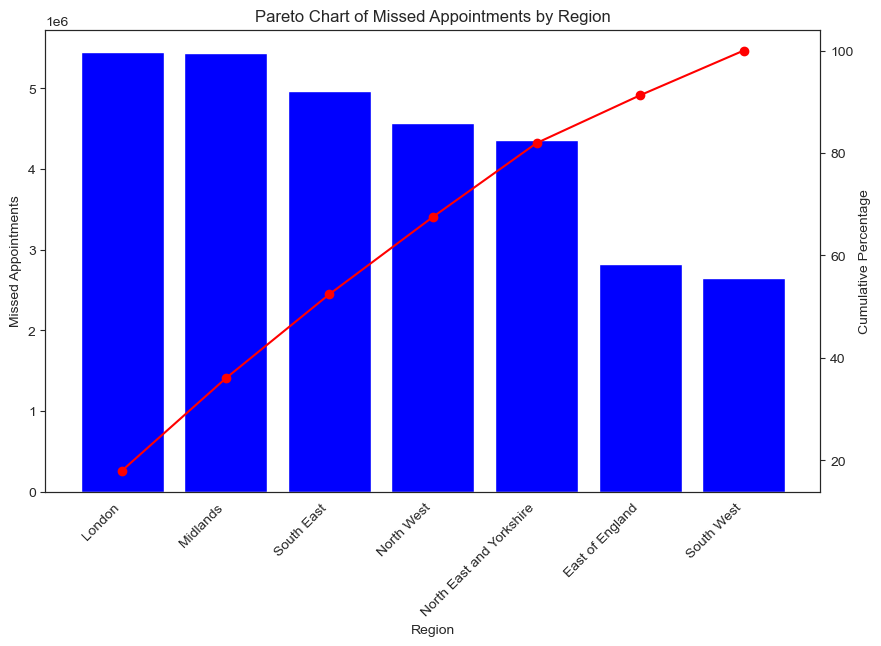

In [160]:
# Pareto chart of missed appointments by Region
# Sort the regions by missed appointments
missed_by_region_sorted = missed_by_region.sort_values(by='count_of_appointments',
                                                       ascending=False)

# Calculate cumulative percentage
missed_by_region_sorted['cumulative_percentage'] = (
    missed_by_region_sorted['count_of_appointments']
    .cumsum() / missed_by_region_sorted['count_of_appointments'].sum() * 100)

# Plot Pareto chart
fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(missed_by_region_sorted['region_name'], 
       missed_by_region_sorted['count_of_appointments'], color='b')
ax2 = ax.twinx()
ax2.plot(missed_by_region_sorted['region_name'], 
         missed_by_region_sorted['cumulative_percentage'], 
         color='r', marker='o', linestyle='-')

# Rotate x-axis labels
ax.set_xticklabels(missed_by_region_sorted['region_name'], rotation=45, ha='right')

ax.set_xlabel('Region')
ax.set_ylabel('Missed Appointments')
ax2.set_ylabel('Cumulative Percentage')
ax.set_title('Pareto Chart of Missed Appointments by Region')
plt.savefig('regional_missed_appointment_pareto.png')
plt.show()


Observations:
- London and Midlands: These two regions have the highest number of missed appointments, each contributing significantly to the total missed appointments.
Cumulative Percentage: The first few regions contribute to a significant percentage of the total missed appointments. For instance, London, Midlands, and South East together account half of the missed appointments.
Least Contributing Regions: East of England and South West have the least number of missed appointments, together contributing less than 20% to the total.

Possible Contributing Factors to DNA Rates
- Staffing levels:
    - London: Shown below England average staffing levels per 100K patients
    - South West: Had the highest staffing levels amongst the regions err 100K patients, which may lead to better appointment management.

- Accessibility:
    - London: Challenges like traffic congestion, longer travel times, and transportation issues might increase the likelihood of missed appointments.
    - South West: Generally easier accessibility to healthcare facilities.
- Socioeconomic Factors:
    - London: Greater socioeconomic diversity could impact appointment adherence differently compared to the South West.
    - South West: Different socioeconomic profile might lead to better adherence to appointments.

<a id="Geographical-analysis-of-the-42-ICBs"></a>
# Geographical analysis of the 42 ICBs

<img src="https://www.england.nhs.uk/wp-content/uploads/2024/06/map-of-integrated-care-systems-scaled.jpg" alt="NHS ICB map" width="600"/>

In [164]:
# To create a blank map with the ICB boundaries
# https://geoportal.statistics.gov.uk/datasets/0867d40e053441e582e538aca3a0c59b_0/explore
# Load the GeoJSON file, replace file path with you own.
icb_geojson = gpd.read_file('C:\\Users\\beata\\OneDrive\\Beata\\DA Career Accelerator\\Assignment 2 -python\\assignment_files_abbreviated_version\\icb-boundaries.geojson')

# Create a Folium map centered around England
m = folium.Map(location=[52.3555, -1.1743], zoom_start=6)

# Add the ICB GeoJSON data to the map
folium.GeoJson(icb_geojson).add_to(m)

# Display the map
m.save("icb_map.html")

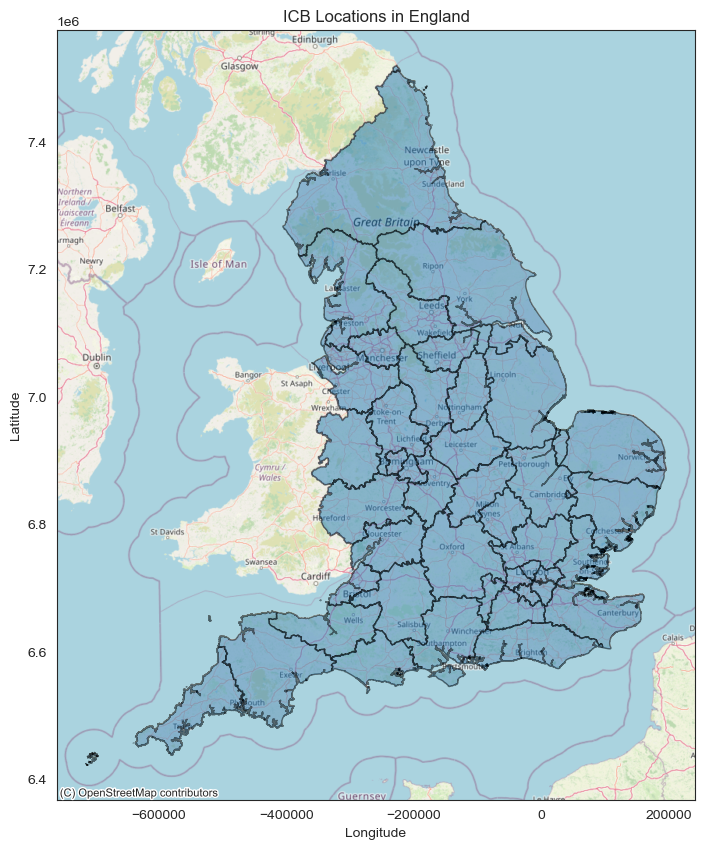

In [165]:
# Load the GeoJSON file, replace file path with you own.
geojson_path = ('C:\\Users\\beata\\OneDrive\\Beata\\DA Career Accelerator'
               '\\Assignment 2 -python\\assignment_files_abbreviated_version'
               '\\icb-boundaries.geojson')  # Replace with the path to your GeoJSON file
icb_gdf = gpd.read_file(geojson_path)

# Check CRS and set to a common CRS if necessary
if icb_gdf.crs is None:
    icb_gdf.set_crs(epsg=4326, inplace=True)  # Setting to WGS 84 if CRS is missing

# Reproject to Web Mercator for compatibility with contextily
icb_gdf = icb_gdf.to_crs(epsg=3857)

# Plot the ICB locations
fig, ax = plt.subplots(figsize=(15, 10))
icb_gdf.plot(ax=ax, edgecolor='k', alpha=0.5, linewidth=1)

# Basemap source
ctx.add_basemap(ax, crs=icb_gdf.crs.to_string(), source=ctx.providers.OpenStreetMap.Mapnik)

# Set titles and labels
ax.set_title('ICB Locations in England')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

plt.show()

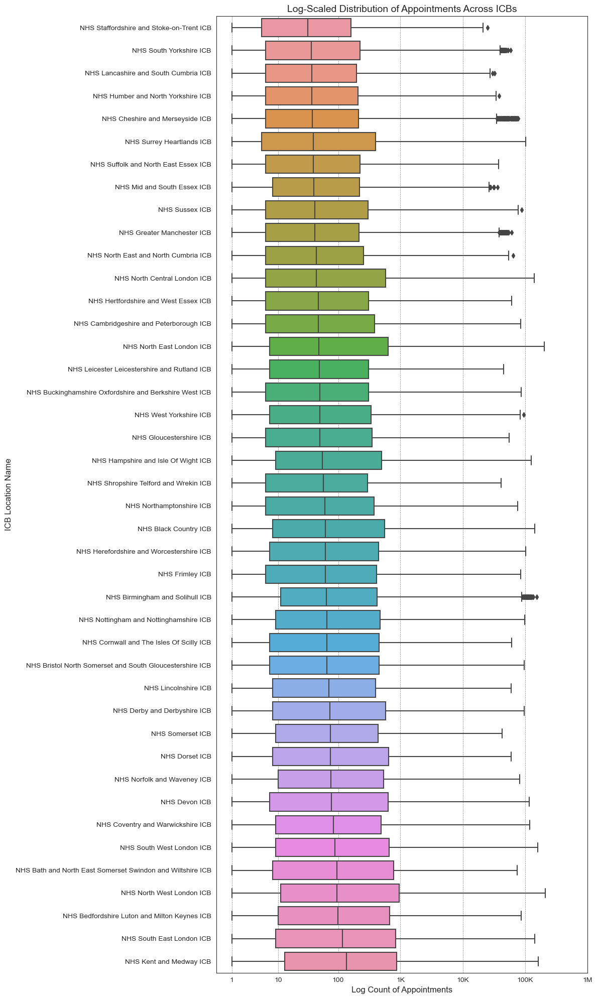

In [166]:
# Boxplot visualisation of the 42 ICBs
# Load the dataset
ar = pd.read_csv('updated_appointments_regional.csv')

# Ensure the icb_location_name is treated as a categorical variable
ar['icb_location_name'] = ar['icb_location_name'].astype('category')

# Apply log transformation to the count_of_appointments to handle high variance
ar['log_count_of_appointments'] = (
    np.log1p(ar['count_of_appointments']))  # log1p is used to handle zero counts

# Calculate the median values to sort the ICBs
median_values = (
    ar.groupby('icb_location_name')['log_count_of_appointments']
    .median().sort_values())

# Set up the figure and axes
plt.figure(figsize=(12, 20))

# Create a boxplot to show the distribution of log-transformed appointments across ICBs, 
# sorted by median value
sns.boxplot(y='icb_location_name', x='log_count_of_appointments', 
            data=ar, order=median_values.index, showfliers=True)

# Add values to the log numbers for interpretation
log_ticks = [np.log1p(x) for x in [1, 10, 100, 1000, 10000, 100000, 1000000]]
plt.xticks(log_ticks, ['1', '10', '100', '1K', '10K', '100K', '1M'])

# Add labels and title
plt.ylabel('ICB Location Name', fontsize=12)
plt.xlabel('Log Count of Appointments', fontsize=12)
plt.title('Log-Scaled Distribution of Appointments Across ICBs', fontsize=14)

# Add faint grid lines for log values
plt.grid(True, which='both', axis='x', color='gray', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.savefig('distribution_icb_appointments.png')
plt.show()

Results:
Distribution Range:

- The log-scaled distribution shows the range and variability of appointments within each ICB.Most ICBs have a wide range of appointment counts, indicating high variability.
- Outliers: The individual points beyond the whiskers are outliers, indicating exceptionally high appointment counts for those ICBs. Several ICBs have numerous outliers, suggesting frequent occurrences of exceptionally high appointment counts.
- Median Values:
The ICBs are sorted by their median values, providing a clear comparison across the regions.
The median value provides a central point of the distribution, helping to identify the typical appointment count for each ICB. While Staffordshire and Stoke have lower median values, South East London and Kent and Medway have higher median values
- Generally 50 % of the appointments are between 10 and 300-8000.
- In this view only a few ICBs have outlier appointments, such as NHS Birmingham, NHS Greater Manchester, NHS Chesire and Merseyside

In [168]:
icb_population = icb_population.sort_values(by='total_patients', ascending=False)
icb_population

,icb_location_name,total_patients,total_gps
15,NHS Greater Manchester ICB,3171787,348
28,NHS North East and North Cumbria ICB,3154627,318
29,NHS North West London ICB,2789930,306
7,NHS Cheshire and Merseyside ICB,2723500,296
41,NHS West Yorkshire ICB,2624909,247
27,NHS North East London ICB,2372238,243
34,NHS South East London ICB,2057799,179
20,NHS Kent and Medway ICB,1972012,183
5,NHS Buckinghamshire Oxfordshire and Berkshire West ICB,1950102,149
16,NHS Hampshire and Isle Of Wight ICB,1925238,140


In [169]:
# Load the datasets
ar = pd.read_csv('updated_appointments_regional.csv')

# Calculate the total number of appointments per region in ar
total_appointments_ar = (
    ar.groupby(['icb_ons_code', 'icb_location_name'])['estimated_total_appointments']
    .sum().reset_index())

# Calculate the average number of appointments per region in ar
average_appointments_ar = (
    ar.groupby(['icb_ons_code', 'icb_location_name'])['estimated_total_appointments']
    .mean().reset_index().round(2))

# Rename the columns for clarity before merging
total_appointments_ar = (
    total_appointments_ar
    .rename(columns={'estimated_total_appointments': 'total_appointments_ar'}))
average_appointments_ar = (
    average_appointments_ar
    .rename(columns={'estimated_total_appointments': 'average_appointments_ar'}))

# Merge the total and average DataFrames on icb_ons_code and icb_location_name
ar_icb = pd.merge(total_appointments_ar, average_appointments_ar, 
                  on=['icb_ons_code', 'icb_location_name'])

# Merge with icb_population to get population data
ar_icb = pd.merge(ar_icb, icb_population, on='icb_location_name')

# Calculate per capita appointments
ar_icb['per_capita_appointments'] = (
    (ar_icb['total_appointments_ar'] / ar_icb['total_patients']) * 1000)

# Calculate appointment density (total appointments per GP surgery) and round to 3 decimal places
ar_icb['appointment_density'] = (
    (ar_icb['total_appointments_ar'] / ar_icb['total_gps']).round(2))

# Convert total appointments and appointment density to millions for better readability
ar_icb['total_appointments_ar_millions'] = ar_icb['total_appointments_ar'] / 1e6
ar_icb['appointment_density_millions'] = ar_icb['appointment_density'] / 1e6

# Sort the DataFrame by total number of appointments in ascending order
ar_icb = ar_icb.sort_values(by='total_appointments_ar', ascending=True)

# Round the average per capita appointments to 2 decimal places for clarity
ar_icb['per_capita_appointments'] = ar_icb['per_capita_appointments'].round(2)

# Rename icb_ons_code_x to icb_ons_code
ar_icb = ar_icb.rename(columns={'icb_ons_code_x': 'icb_ons_code'})
ar_icb.to_csv('ar_icb.csv', index=False)

ar_icb_styled = ar_icb.style \
    .set_caption("Appointments per ICB") \
    .set_properties(**{'text-align': 'center'}) \
    .set_table_styles([{'selector': 'th', 'props': [('text-align', 'center')]}]) \
    .background_gradient(cmap='viridis', low=0, high=1)
display(ar_icb_styled)

,icb_ons_code,icb_location_name,total_appointments_ar,average_appointments_ar,total_patients,total_gps,per_capita_appointments,appointment_density,total_appointments_ar_millions,appointment_density_millions
2,E54000011,NHS Shropshire Telford and Wrekin ICB,6756723.029046,1126.870000,521023,51,12968.190000,132484.770000,6.756723,0.132485
21,E54000038,NHS Somerset ICB,8137577.800830,1194.420000,596793,62,13635.510000,131251.250000,8.137578,0.131251
18,E54000034,NHS Frimley ICB,9482089.211618,1643.910000,815935,69,11621.130000,137421.580000,9.482089,0.137422
26,E54000043,NHS Gloucestershire ICB,9517911.825726,1419.100000,677615,59,14046.190000,161320.540000,9.517912,0.161321
19,E54000036,NHS Cornwall and The Isles Of Scilly ICB,9932814.315353,1479.420000,598643,53,16592.220000,187411.590000,9.932814,0.187412
38,E54000059,NHS Northamptonshire ICB,10323384.854772,1792.570000,816600,66,12641.910000,156414.920000,10.323385,0.156415
3,E54000013,NHS Lincolnshire ICB,10735871.369295,1771.300000,808281,79,13282.350000,135897.110000,10.735871,0.135897
24,E54000041,NHS Dorset ICB,11536634.854772,2158.400000,821291,68,14046.950000,169656.390000,11.536635,0.169656
6,E54000019,NHS Herefordshire and Worcestershire ICB,11923793.568465,1983.000000,818533,72,14567.270000,165608.240000,11.923794,0.165608
5,E54000018,NHS Coventry and Warwickshire ICB,12622605.809129,2002.630000,1056642,109,11945.960000,115803.720000,12.622606,0.115804


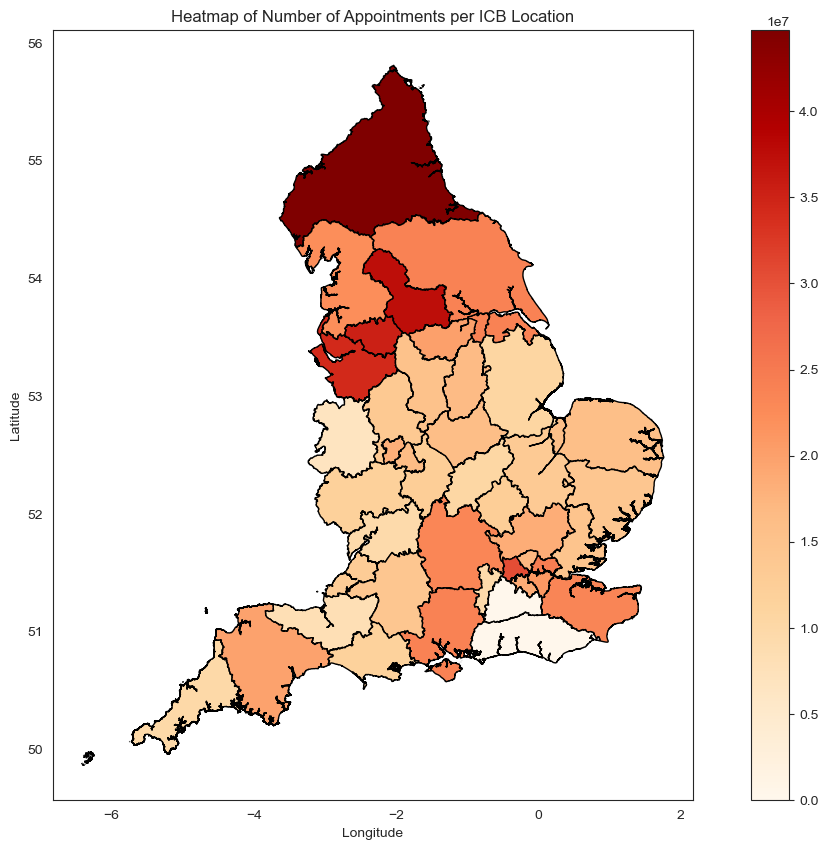

In [170]:
# Visualise the number of appointments per ICB
# Load the GeoJSON file, replace file path with you own.
geojson_path = ('C:\\Users\\beata\\OneDrive\\Beata\\DA Career Accelerator' \
                '\\Assignment 2 -python\\assignment_files_abbreviated_version' \
                '\\icb-boundaries.geojson') # Replace with the path to your GeoJSON file
icb_gdf = gpd.read_file(geojson_path)

# Load the appointments data
ar = pd.read_csv('updated_appointments_regional.csv')

# Ensure data types are correct
icb_gdf['icb23cd'] = icb_gdf['icb23cd'].astype(str)
ar['icb_ons_code'] = ar['icb_ons_code'].astype(str)

# Aggregate the number of appointments by location
ar_agg = ar.groupby('icb_ons_code')['estimated_total_appointments'].sum().reset_index()

# Merge the aggregated data with the GeoDataFrame
icb_gdf = icb_gdf.merge(ar_agg, left_on='icb23cd', right_on='icb_ons_code', how='left')

# Replace NaN values with 0 for visualization
icb_gdf['estimated_total_appointments'] = icb_gdf['estimated_total_appointments'].fillna(0)

# Plot the heatmap
fig, ax = plt.subplots(figsize=(15, 10))
icb_gdf.plot(column='estimated_total_appointments', ax=ax, 
             legend=True, cmap='OrRd', edgecolor='k', linewidth=1)

# Set titles and labels
ax.set_title('Heatmap of Number of Appointments per ICB Location')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
plt.savefig('heatmap_icb_appointments.png')
plt.show()


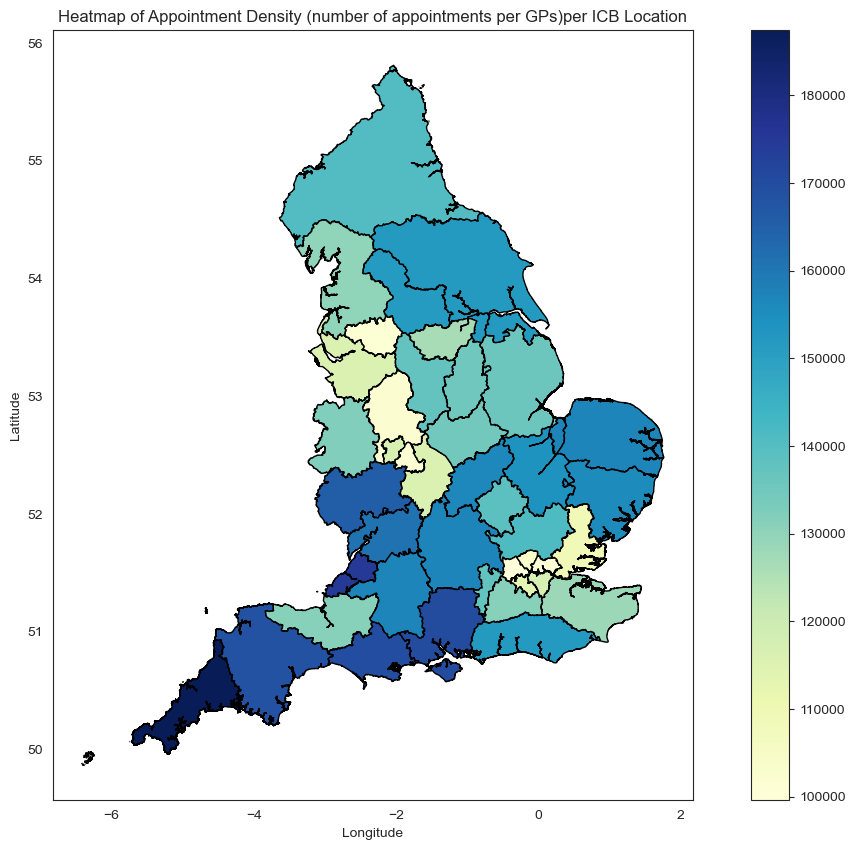

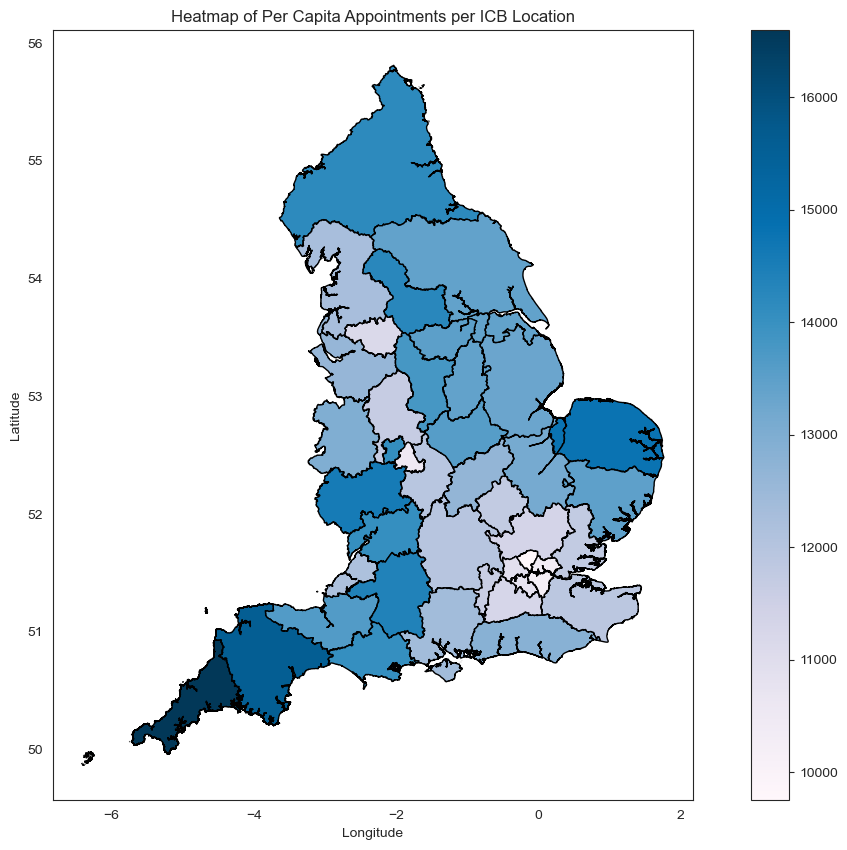

In [171]:
# Visualise appointment density and per capita appointments
# Function to standardize ICB names
def standardize_icb_name(name):
    return name.replace(',', '').replace(' and ', ' ').lower()

# Load the GeoJSON file, replace file path with you own.
geojson_path = ('C:\\Users\\beata\\OneDrive\\Beata\\DA Career Accelerator' \
                '\\Assignment 2 -python\\assignment_files_abbreviated_version' \
                '\\icb-boundaries.geojson') # Replace with the path to your GeoJSON file
icb_gdf = gpd.read_file(geojson_path)

# Replace "Integrated Care Board" with "ICB" in the icb23nm column and standardize names
icb_gdf['icb23nm'] = (
    icb_gdf['icb23nm'].str.replace('Integrated Care Board', 'ICB')
    .apply(standardize_icb_name))

# Standardize the icb_location_name in the appointments_ar DataFrame
ar_icb['icb_location_name'] = ar_icb['icb_location_name'].apply(standardize_icb_name)

# Ensure data types are correct
icb_gdf['icb23cd'] = icb_gdf['icb23cd'].astype(str)
ar_icb['icb_location_name'] = ar_icb['icb_location_name'].astype(str)

# Merge the density data with the GeoDataFrame
icb_gdf_density = icb_gdf.merge(ar_icb[['icb_location_name', 'appointment_density']], 
                                left_on='icb23nm', 
                                right_on='icb_location_name', how='left')

# Replace NaN values with 0 for visualization
icb_gdf_density['appointment_density'] = icb_gdf_density['appointment_density'].fillna(0)

# Plot the heatmap for appointment density
fig, ax = plt.subplots(figsize=(15, 10))
icb_gdf_density.plot(column='appointment_density', 
                     ax=ax, legend=True, cmap='YlGnBu', edgecolor='k', linewidth=1)

# Set titles and labels
ax.set_title('Heatmap of Appointment Density (number of appointments per GPs)'
             'per ICB Location')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
plt.savefig('appointment_density_icb.png')
plt.show()

# Merge the per capita data with the GeoDataFrame
icb_gdf_per_capita = icb_gdf.merge(ar_icb[['icb_location_name', 
                                           'per_capita_appointments']], 
                                   left_on='icb23nm',
                                   right_on='icb_location_name', how='left')

# Replace NaN values with 0 for visualization
icb_gdf_per_capita['per_capita_appointments'] = (
    icb_gdf_per_capita['per_capita_appointments'].fillna(0))

# Plot the heatmap for per capita appointments
fig, ax = plt.subplots(figsize=(15, 10))
icb_gdf_per_capita.plot(column='per_capita_appointments', ax=ax, 
                        legend=True, cmap='PuBu', edgecolor='k', linewidth=1)

# Set titles and labels
ax.set_title('Heatmap of Per Capita Appointments per ICB Location')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
plt.savefig('per_capita_icb.png')
plt.show()

Results: 
##### Number of Appointments per ICB Location:
- High Number: Northern regions (e.g., North East and North Cumbria, Greater Manchester) have a high number of appointments.
- Low Number: Southern and Central regions have a relatively lower number of appointments.
##### Appointment Density per ICB Location:
- High Density: South West regions (e.g., Cornwall) show higher appointment densities.
- Low Density: Central and Northern regions show lower appointment densities.
##### Per Capita Appointments per ICB Location:
- High Per Capita: Regions in the South West and some central areas have higher per capita appointments.
- Low Per Capita: Northern regions show lower per capita appointments.

### Comparison of a selection of rural, urban, London and mixed ICBs
Please note that the rest of the ICBs are likely to fall under the mixed group

Plot saved to Comparison_of_London_ICB.png


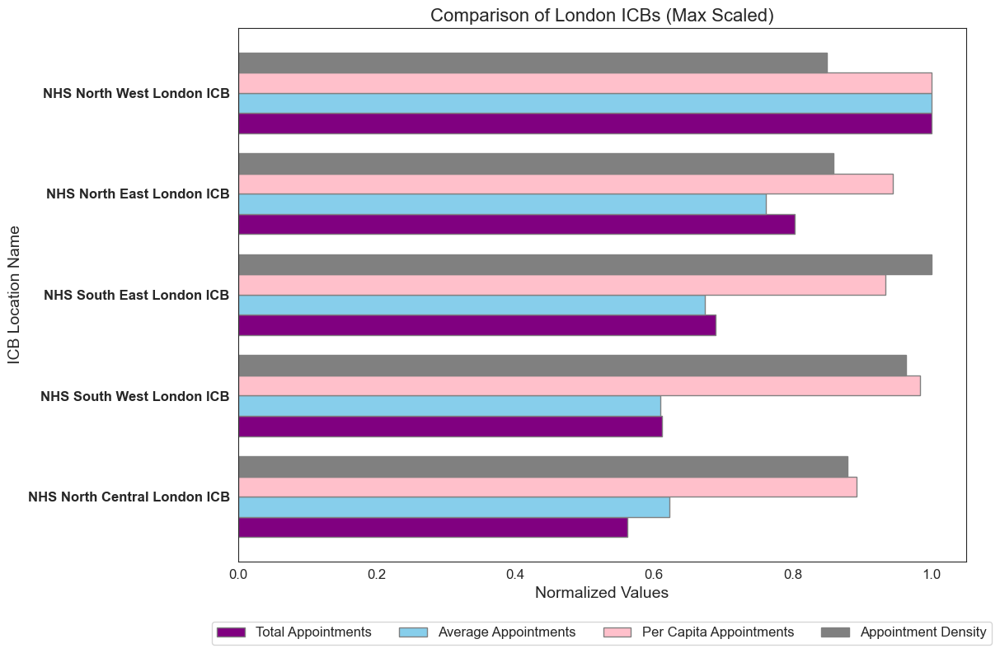

Plot saved to Comparison_of_Urban_ICB.png


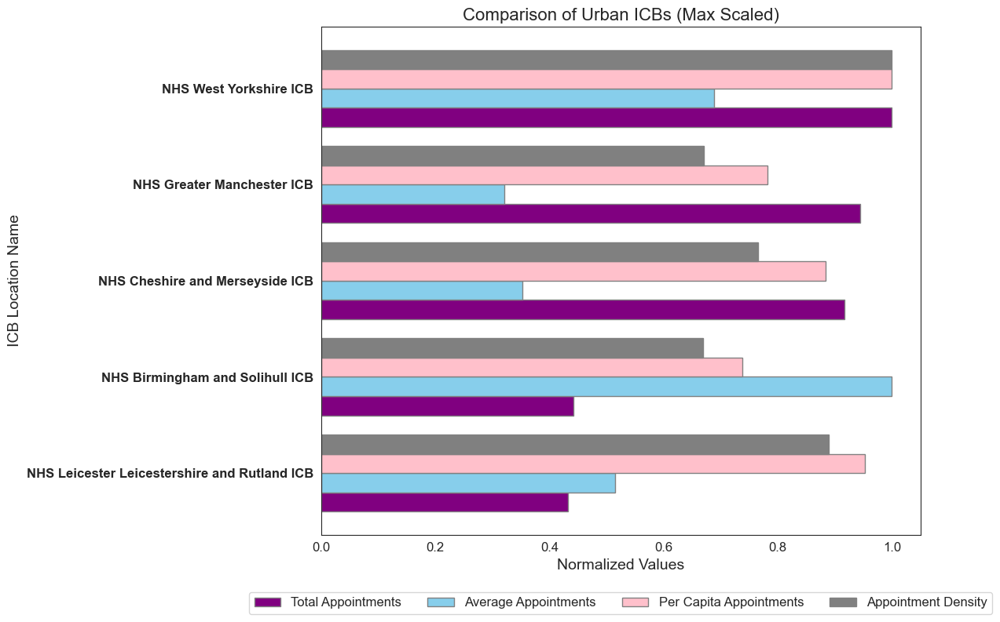

Plot saved to Comparison_of_Rural_ICB.png


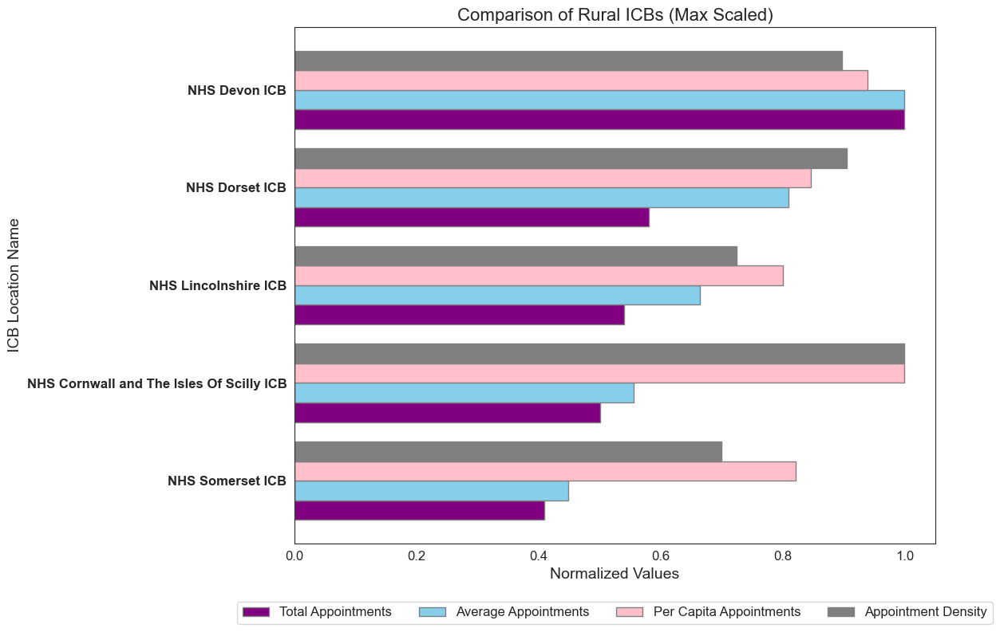

Plot saved to Comparison_of_Mixed_ICB.png


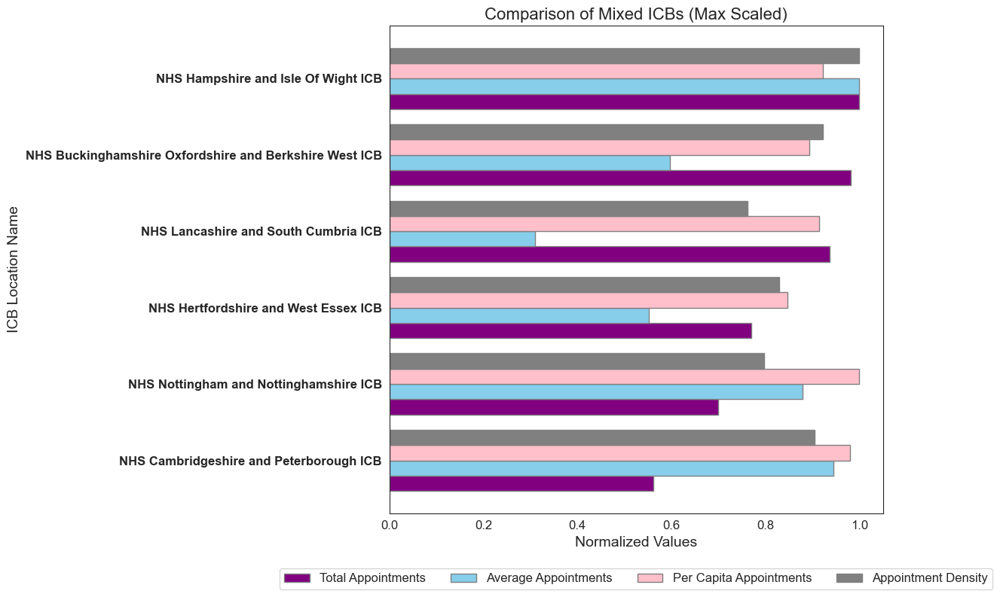

In [174]:
# Load the appointments data
ar_icb = pd.read_csv('ar_icb.csv')

# Define the ICB groups
london_icbs = [
    'NHS North Central London ICB',
    'NHS North East London ICB',
    'NHS North West London ICB',
    'NHS South East London ICB',
    'NHS South West London ICB'
]

urban_icbs = [
    'NHS West Yorkshire ICB',
    'NHS Greater Manchester ICB',
    'NHS Birmingham and Solihull ICB',
    'NHS Leicester Leicestershire and Rutland ICB',
    'NHS Cheshire and Merseyside ICB'
]

rural_icbs = [
    'NHS Cornwall and The Isles Of Scilly ICB',
    'NHS Devon ICB',
    'NHS Lincolnshire ICB',
    'NHS Dorset ICB',
    'NHS Somerset ICB'
]

mixed_icbs = [
    'NHS Cambridgeshire and Peterborough ICB',
    'NHS Hertfordshire and West Essex ICB',
    'NHS Nottingham and Nottinghamshire ICB',
    'NHS Hampshire and Isle Of Wight ICB',
    'NHS Buckinghamshire Oxfordshire and Berkshire West ICB',
    'NHS Lancashire and South Cumbria ICB'
]

# Filter data for each ICB group
london_ar_icb = ar_icb[ar_icb['icb_location_name'].isin(london_icbs)]
urban_ar_icb = ar_icb[ar_icb['icb_location_name'].isin(urban_icbs)]
rural_ar_icb = ar_icb[ar_icb['icb_location_name'].isin(rural_icbs)]
mixed_ar_icb = ar_icb[ar_icb['icb_location_name'].isin(mixed_icbs)]

# Max scaling function
def max_scaling(series):
    return series / series.max()

# Apply max scaling to each ICB group
for df in [london_ar_icb, urban_ar_icb, rural_ar_icb, mixed_ar_icb]:
    df['total_appointments_ar'] = max_scaling(df['total_appointments_ar'])
    df['average_appointments_ar'] = max_scaling(df['average_appointments_ar'])
    df['per_capita_appointments'] = max_scaling(df['per_capita_appointments'])
    df['appointment_density'] = max_scaling(df['appointment_density'])

# Plotting function
def plot_icb_comparison(df, title, filename):
    fig, ax = plt.subplots(figsize=(12, 8))
    bar_width = 0.2
    r1 = range(len(df))
    r2 = [x + bar_width for x in r1]
    r3 = [x + bar_width for x in r2]
    r4 = [x + bar_width for x in r3]

    ax.barh(r1, df['total_appointments_ar'], color='purple',
            height=bar_width, edgecolor='grey',
            label='Total Appointments')
    ax.barh(r2, df['average_appointments_ar'], color='skyblue',
            height=bar_width, edgecolor='grey',
            label='Average Appointments')
    ax.barh(r3, df['per_capita_appointments'], color='pink', 
            height=bar_width, edgecolor='grey', 
            label='Per Capita Appointments')
    ax.barh(r4, df['appointment_density'], color='grey', 
            height=bar_width, edgecolor='grey',
            label='Appointment Density')

    ax.set_yticks([r + 1.5 * bar_width for r in range(len(df))])
    ax.set_yticklabels(df['icb_location_name'], fontsize=12, weight='bold')
    ax.set_title(title, fontsize=16)
    ax.set_xlabel('Normalized Values', fontsize=14)
    ax.set_ylabel('ICB Location Name', fontsize=14)
    plt.xticks(fontsize=12)
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=4, fontsize=12)
    plt.tight_layout()
    save_plot(filename)
    plt.show()

# Plot each ICB group
# Plot each ICB group
plot_icb_comparison(london_ar_icb, 'Comparison of London ICBs (Max Scaled)', 
                    'Comparison_of_London_ICB.png')
plot_icb_comparison(urban_ar_icb, 'Comparison of Urban ICBs (Max Scaled)', 
                    'Comparison_of_Urban_ICB.png')
plot_icb_comparison(rural_ar_icb, 'Comparison of Rural ICBs (Max Scaled)', 
                    'Comparison_of_Rural_ICB.png')
plot_icb_comparison(mixed_ar_icb, 'Comparison of Mixed ICBs (Max Scaled)', 
                    'Comparison_of_Mixed_ICB.png')

Results:
#### London ICBs
- NHS North West London ICB stands out with the highest values across all metrics, indicating a high overall performance.
- NHS North East London ICB and NHS South East London ICB also show strong performance but with slightly lower per capita appointments compared to North West London.
- NHS North Central London ICB shows relatively balanced metrics but lags behind in total and average appointments compared to other London ICBs.
#### Urban ICBs
- NHS West Yorkshire ICB has the highest normalized total appointments, indicating a large volume of appointments overall.
- NHS Greater Manchester ICB and NHS Cheshire and Merseyside ICB show high values for average appointments and appointment density, suggesting a high rate of utilization.
- NHS Birmingham and Solihull ICB and NHS Leicester Leicestershire and Rutland ICB exhibit lower values for per capita appointments, indicating room for improvement in appointment accessibility.
#### Rural ICBs
- NHS Devon ICB and NHS Cornwall and The Isles Of Scilly ICB exhibit the highest appointment density, indicating a well-utilized appointment system despite the rural setting.
- NHS Somerset ICB and NHS Dorset ICB have lower per capita appointments but still maintain a balanced approach across other metrics.
- NHS Lincolnshire ICB shows slightly lower performance across all metrics compared to other rural ICBs.
#### Mixed ICBs
- NHS Cambridgeshire and Peterborough ICB and NHS Buckinghamshire Oxfordshire and Berkshire West ICB show strong performance across all metrics, indicating efficient appointment systems.
- NHS Hertfordshire and West Essex ICB and NHS Nottingham and Nottinghamshire ICB have lower per capita appointments but maintain a high total appointment count.
- NHS Hampshire and Isle Of Wight ICB  exhibit balanced metrics, indicating a well-rounded appointment system.
#### Recommendations
- London ICBs should focus on maintaining high performance while addressing the slight variations in per capita appointments to ensure equitable access.
- Urban ICBs like Birmingham and Solihull should investigate factors contributing to lower per capita appointments and seek to enhance accessibility.
- Rural ICBs should continue leveraging high appointment density but also aim to improve per capita appointments for better service distribution.
- Mixed ICBs should aim to balance the metrics further by focusing on regions with lower per capita appointments to ensure uniform service quality.

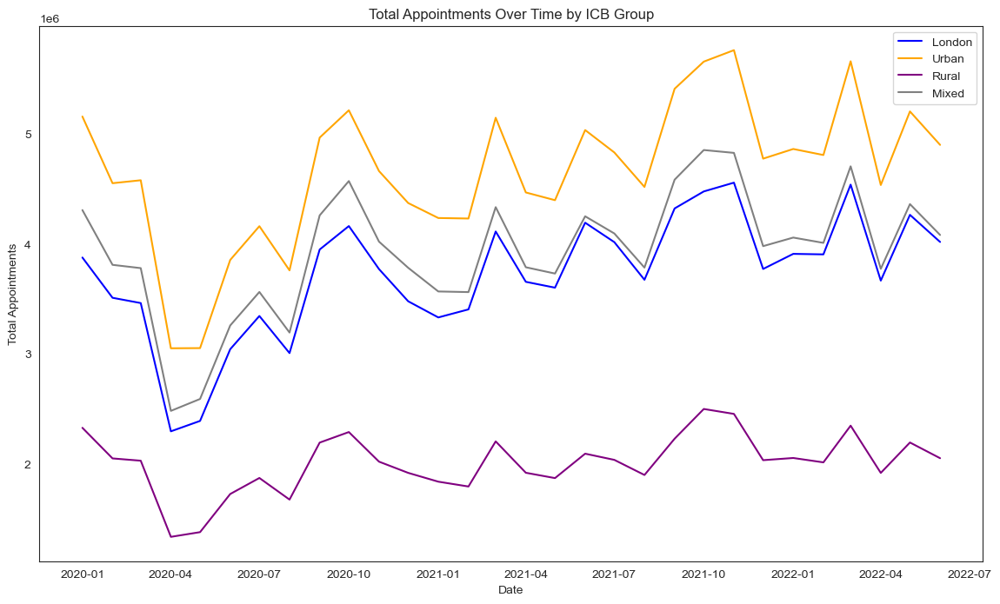

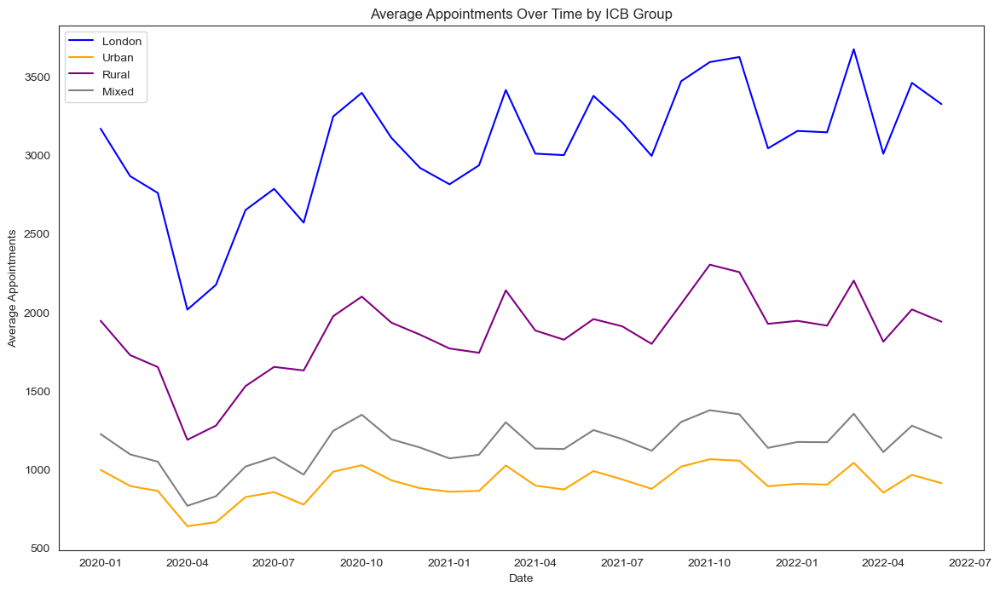

In [176]:
# Visualise total and average appointment trends over time
# Load the appointments data
ar = pd.read_csv('updated_appointments_regional.csv')

# Define the ICB groups
london_icbs = [
    'NHS North Central London ICB',
    'NHS North East London ICB',
    'NHS North West London ICB',
    'NHS South East London ICB',
    'NHS South West London ICB'
]

urban_icbs = [
    'NHS West Yorkshire ICB',
    'NHS Greater Manchester ICB',
    'NHS Birmingham and Solihull ICB',
    'NHS Leicester Leicestershire and Rutland ICB',
    'NHS Cheshire and Merseyside ICB'
]

rural_icbs = [
    'NHS Cornwall and The Isles Of Scilly ICB',
    'NHS Devon ICB',
    'NHS Lincolnshire ICB',
    'NHS Dorset ICB',
    'NHS Somerset ICB'
]

mixed_icbs = [
    'NHS Cambridgeshire and Peterborough ICB',
    'NHS Hertfordshire and West Essex ICB',
    'NHS Nottingham and Nottinghamshire ICB',
    'NHS Hampshire and Isle Of Wight ICB',
    'NHS Buckinghamshire Oxfordshire and Berkshire West ICB',
    'NHS Lancashire and South Cumbria ICB'
]

# Ensure data types are correct
ar['appointment_month'] = pd.to_datetime(ar['appointment_month'])

# Filter and aggregate data by group
def aggregate_by_group(df, icb_list, group_name):
    filtered_df = df[df['icb_location_name'].isin(icb_list)]
    total_agg = (
        filtered_df.groupby('appointment_month')['estimated_total_appointments']
        .sum().reset_index())
    total_agg['group'] = group_name
    avg_agg = (
        filtered_df.groupby('appointment_month')['estimated_total_appointments']
        .mean().reset_index())
    avg_agg['group'] = group_name
    return total_agg, avg_agg

london_total, london_avg = aggregate_by_group(ar, london_icbs, 'London')
urban_total, urban_avg = aggregate_by_group(ar, urban_icbs, 'Urban')
rural_total, rural_avg = aggregate_by_group(ar, rural_icbs, 'Rural')
mixed_total, mixed_avg = aggregate_by_group(ar, mixed_icbs, 'Mixed')

# Combine data for plotting
total_combined = pd.concat([london_total, urban_total, rural_total, mixed_total])
avg_combined = pd.concat([london_avg, urban_avg, rural_avg, mixed_avg])

# Define color palette
colors = {
    'London': 'blue',
    'Urban': 'orange',
    'Rural': 'purple',
    'Mixed': 'grey'
}

# Plot total appointments over time
plt.figure(figsize=(14, 8))
for group in total_combined['group'].unique():
    group_data = total_combined[total_combined['group'] == group]
    plt.plot(group_data['appointment_month'], group_data['estimated_total_appointments'], 
             label=group, color=colors[group])

plt.title('Total Appointments Over Time by ICB Group')
plt.xlabel('Date')
plt.ylabel('Total Appointments')
plt.legend()
plt.savefig('total_appointments_per_ICB_groups.png')
plt.show()

# Plot average appointments over time
plt.figure(figsize=(14, 8))
for group in avg_combined['group'].unique():
    group_data = avg_combined[avg_combined['group'] == group]
    plt.plot(group_data['appointment_month'], group_data['estimated_total_appointments'], 
             label=group, color=colors[group])

plt.title('Average Appointments Over Time by ICB Group')
plt.xlabel('Date')
plt.ylabel('Average Appointments')
plt.legend()
plt.savefig('average_appointments_per_ICB_groups.png')
plt.show()

- Demand Fluctuations: Both total and average appointments show fluctuations over time, which could be linked to factors such as seasonal changes, public health interventions, or pandemic waves.  The initial dip in appointments around early 2020 likely reflects the impact of the COVID-19 pandemic, with subsequent recovery as healthcare services adapted to the situation. The trendlines are similar in each group. With rural areas showing significantly lower total appointments. 

Demand Distribution: The high total appointments in urban areas contrast with the high average appointments in rural areas. This could indicate that urban regions have more healthcare facilities handling smaller loads individually, while rural areas have fewer facilities handling larger loads individually.

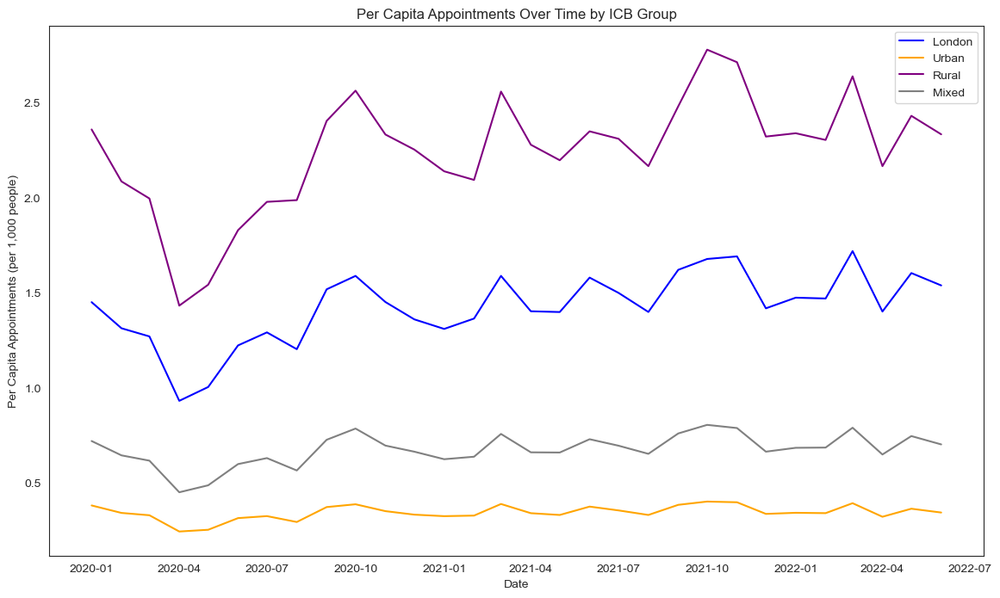

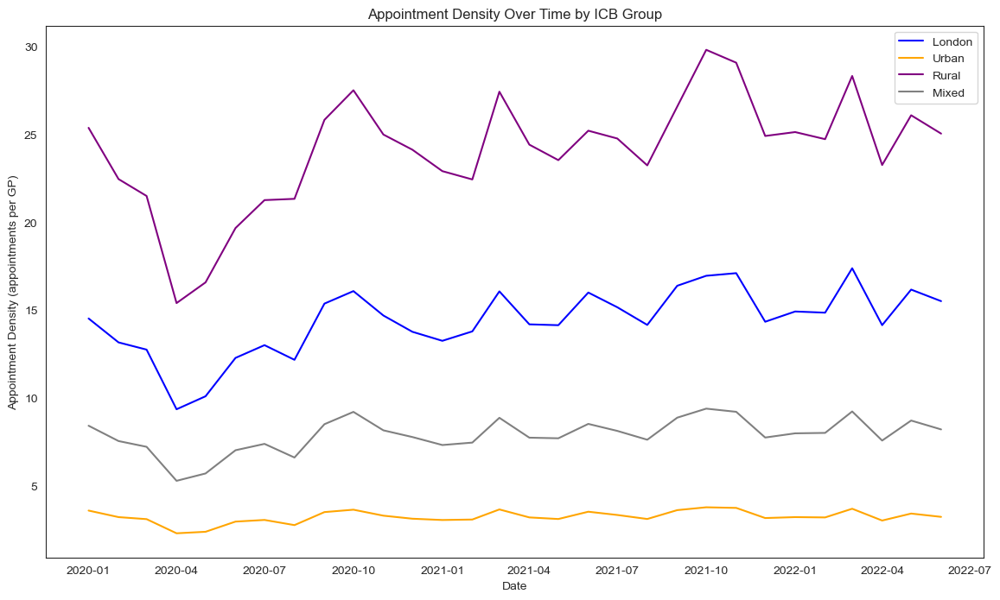

Note: These visualisations are based on population and GP data from 01/08/2022.

In [178]:
# Visualise per capita and appointment dnesity trends over time
# Load the data
ar = pd.read_csv('updated_appointments_regional.csv')
ar_icb = pd.read_csv('ar_icb.csv')

# Merge the monthly appointment data with the total patients and GPs data
ar_combined = ar.merge(ar_icb[['icb_location_name', 'total_patients', 'total_gps']], 
                       on='icb_location_name', how='left')

# Define the ICB groups
london_icbs = [
    'NHS North Central London ICB',
    'NHS North East London ICB',
    'NHS North West London ICB',
    'NHS South East London ICB',
    'NHS South West London ICB'
]

urban_icbs = [
    'NHS West Yorkshire ICB',
    'NHS Greater Manchester ICB',
    'NHS Birmingham and Solihull ICB',
    'NHS Leicester Leicestershire and Rutland ICB',
    'NHS Cheshire and Merseyside ICB'
]

rural_icbs = [
    'NHS Cornwall and The Isles Of Scilly ICB',
    'NHS Devon ICB',
    'NHS Lincolnshire ICB',
    'NHS Dorset ICB',
    'NHS Somerset ICB']
mixed_icbs = [
    'NHS Cambridgeshire and Peterborough ICB',
    'NHS Hertfordshire and West Essex ICB',
    'NHS Nottingham and Nottinghamshire ICB',
    'NHS Hampshire and Isle Of Wight ICB',
    'NHS Buckinghamshire Oxfordshire and Berkshire West ICB',
    'NHS Lancashire and South Cumbria ICB']

# Function to aggregate data over time for each group
def aggregate_data_over_time(df, icb_groups, group_name):
    df_grouped = df[df['icb_location_name'].isin(icb_groups)]
    df_grouped['appointment_month'] = pd.to_datetime(df_grouped['appointment_month'])
    df_grouped = df_grouped.groupby('appointment_month').agg({
        'estimated_total_appointments': 'sum',
        'total_patients': 'sum',
        'total_gps': 'sum'
    }).reset_index()
    df_grouped['per_capita_appointments'] = (
        (df_grouped['estimated_total_appointments'] / 
         df_grouped['total_patients']) * 1000)
    df_grouped['appointment_density'] = (
        df_grouped['estimated_total_appointments'] / df_grouped['total_gps'])
    df_grouped['group'] = group_name
    return df_grouped

# Aggregate data for each group
london_trends = aggregate_data_over_time(ar_combined, london_icbs, 'London')
urban_trends = aggregate_data_over_time(ar_combined, urban_icbs, 'Urban')
rural_trends = aggregate_data_over_time(ar_combined, rural_icbs, 'Rural')
mixed_trends = aggregate_data_over_time(ar_combined, mixed_icbs, 'Mixed')

# Combine data
per_capita_combined = pd.concat([london_trends, urban_trends, rural_trends, mixed_trends])
density_combined = pd.concat([london_trends, urban_trends, rural_trends, mixed_trends])


# Define color palette
colors = {
    'London': 'blue',
    'Urban': 'orange',
    'Rural': 'purple',
    'Mixed': 'grey'
}

# Plot per capita appointments over time
plt.figure(figsize=(14, 8))
for group in per_capita_combined['group'].unique():
    group_data = per_capita_combined[per_capita_combined['group'] == group]
    plt.plot(group_data['appointment_month'], group_data['per_capita_appointments'], 
             label=group, color=colors[group])

plt.title('Per Capita Appointments Over Time by ICB Group')
plt.xlabel('Date')
plt.ylabel('Per Capita Appointments (per 1,000 people)')
plt.legend()
plt.savefig('per_capita_appointments_per_ICB_groups.png')
plt.show()

# Plot appointment density over time
plt.figure(figsize=(14, 8))
for group in density_combined['group'].unique():
    group_data = density_combined[density_combined['group'] == group]
    plt.plot(group_data['appointment_month'], group_data['appointment_density'], 
             label=group, color=colors[group])

plt.title('Appointment Density Over Time by ICB Group')
plt.xlabel('Date')
plt.ylabel('Appointment Density (appointments per GP)')
plt.legend()
plt.savefig('appointments_density_per_ICB_groups.png')
plt.show()

# Adding a note
note = "Note: These visualisations are based on population and GP data from 01/08/2022."
display(Markdown(note))

##### Results:
- Rural areas face a higher workload per GP and per capita, which might highlight challenges in healthcare accessibility and resource allocation.
- London seems to maintain a balanced healthcare service with moderate rates in both metrics.
- Urban areas show a lower workload per GP and per capita, which may reflect a higher number of healthcare providers or better distribution of healthcare services.
##### Potential Actions:
- Resource Allocation: Consider allocating more resources (GPs, clinics) to rural areas to alleviate the high appointment density and ensure better healthcare accessibility.
- Infrastructure Development: In urban areas, continue to monitor the infrastructure to ensure it meets the population's needs without overwhelming the existing GPs.
- Policy Adjustment: Adjust policies to address the specific needs of each region based on their appointment density and per capita appointment trends.

<a id="COVID-19-Insights"></a>
# COVID-19 Data Insights

In [181]:
# Download of Covid-19 related data for England
# URL of the CSV file
url = 'https://covid.ourworldindata.org/data/owid-covid-data.csv'

# Read the CSV file into a DataFrame
df = pd.read_csv(url)

# Filter the DataFrame for the United Kingdom and the desired date range
uk_df = df[df['location'] == 'England']
uk_df['date'] = pd.to_datetime(uk_df['date'])
start_date = '2020-01-01'
end_date = '2022-07-31'
mask = (uk_df['date'] >= start_date) & (uk_df['date'] <= end_date)
filtered_df = uk_df.loc[mask]

# Drop columns that only contain NaN values
filtered_df.dropna(axis=1, how='all', inplace=True)

# Save the filtered DataFrame to a CSV file
filtered_df.to_csv('UK_covid19_data_2020_2022.csv', index=False)

# Optional: Print confirmation message
print("Data has been saved to UK_covid19_data_2020_2022.csv")
filtered_df.tail()

Data has been saved to UK_covid19_data_2020_2022.csv


,iso_code,continent,location,date,icu_patients,icu_patients_per_million,hosp_patients,hosp_patients_per_million,weekly_hosp_admissions,weekly_hosp_admissions_per_million,...,new_vaccinations,new_vaccinations_smoothed,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,total_boosters_per_hundred,new_vaccinations_smoothed_per_million,new_people_vaccinated_smoothed,new_people_vaccinated_smoothed_per_hundred,population
109246,OWID_ENG,Europe,England,2022-07-27,273.0,4.828,11914.0,210.681,9087.0,160.690,...,23436.0,24893.0,223.26,79.85,75.02,59.02,440.0,3001.0,0.005,56550000
109247,OWID_ENG,Europe,England,2022-07-28,268.0,4.739,11437.0,202.246,8702.0,153.882,...,23579.0,24948.0,223.30,79.86,75.04,59.03,441.0,3051.0,0.005,56550000
109248,OWID_ENG,Europe,England,2022-07-29,253.0,4.474,11149.0,197.153,8467.0,149.726,...,21496.0,24222.0,223.34,79.87,75.05,59.04,428.0,3040.0,0.005,56550000
109249,OWID_ENG,Europe,England,2022-07-30,241.0,4.262,10529.0,186.189,8264.0,146.136,...,29101.0,22907.0,223.39,79.87,75.08,59.05,405.0,2895.0,0.005,56550000
109250,OWID_ENG,Europe,England,2022-07-31,232.0,4.103,10431.0,184.456,8095.0,143.148,...,13110.0,22582.0,223.42,79.88,75.09,59.06,399.0,2815.0,0.005,56550000


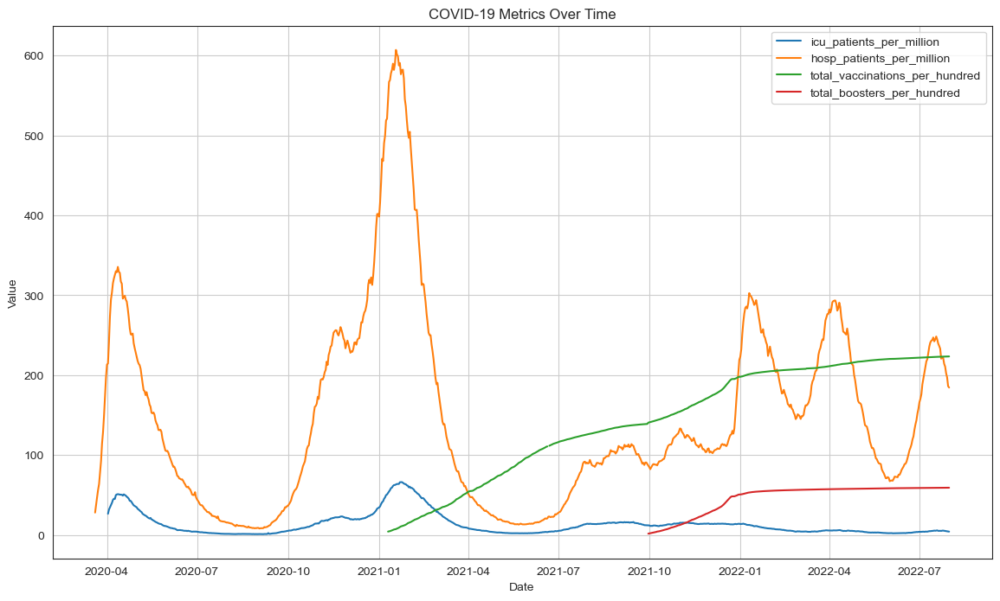

In [182]:
data = pd.read_csv('UK_covid19_data_2020_2022.csv')
# Ensure the date column is in the correct datetime format
data['date'] = pd.to_datetime(data['date'])

# List of columns to plot
columns_to_plot = [
    'icu_patients_per_million',
    'hosp_patients_per_million',
    'total_vaccinations_per_hundred',
    'total_boosters_per_hundred'
]

# Plot each column over time
plt.figure(figsize=(14, 8))

for column in columns_to_plot:
    plt.plot(data['date'], data[column], label=column)

# Set plot title and labels
plt.title('COVID-19 Metrics Over Time')
plt.xlabel('Date')
plt.ylabel('Value')
plt.legend()
plt.grid(True)
plt.show()

Covid19-cases and deaths data from: https://github.com/CSSEGISandData/COVID-19/blob/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv

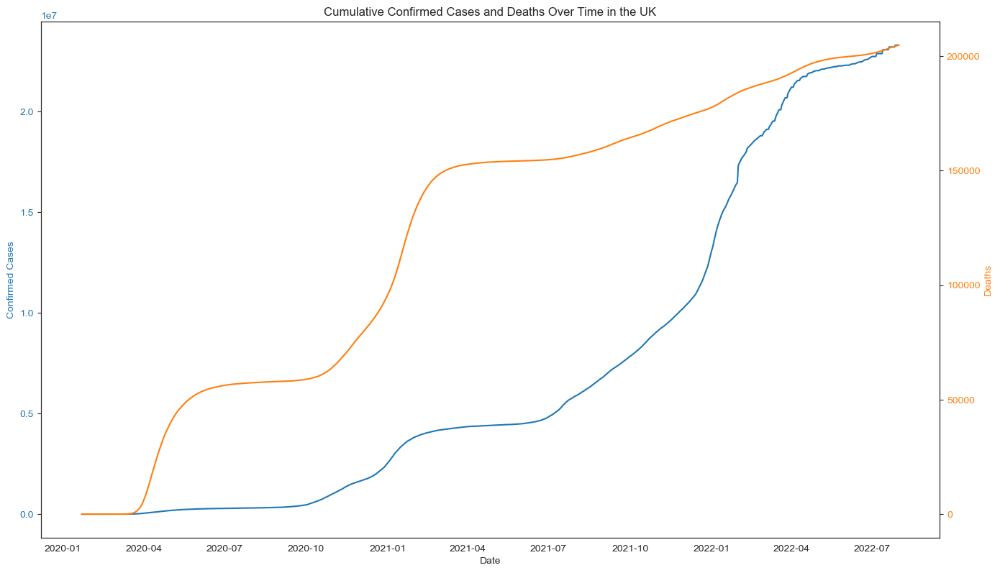

In [184]:
# Visualise the cumulative cases and deaths over time
# Load the datasets
cases = pd.read_csv('time_series_covid19_confirmed_global.csv')
deaths = pd.read_csv('time_series_covid19_deaths_global.csv')

# Filter for the UK data
uk_cases = (
    cases[(cases['Country/Region'] == 'United Kingdom') & 
    (cases['Province/State'].isna())])
uk_deaths = (
    deaths[(deaths['Country/Region'] == 'United Kingdom') & 
    (deaths['Province/State'].isna())])

# Drop unnecessary columns
uk_cases = uk_cases.drop(columns=['Province/State', 'Country/Region', 'Lat', 'Long'])
uk_deaths = uk_deaths.drop(columns=['Province/State', 'Country/Region', 'Lat', 'Long'])

# Transpose the data to have dates as rows
uk_cases = uk_cases.T
uk_deaths = uk_deaths.T

# Convert the index to datetime format
uk_cases.index = pd.to_datetime(uk_cases.index)
uk_deaths.index = pd.to_datetime(uk_deaths.index)

# Rename columns for clarity
uk_cases.columns = ['Confirmed Cases']
uk_deaths.columns = ['Deaths']

# Combine the dataframes
uk_data = uk_cases.join(uk_deaths)

# Limit the date range to up to July 31, 2022
uk_data = uk_data[uk_data.index <= '2022-07-31']

# Plot the cumulative confirmed cases and deaths over time with dual y-axes
fig, ax1 = plt.subplots(figsize=(14, 8))

color = 'tab:blue'
ax1.set_xlabel('Date')
ax1.set_ylabel('Confirmed Cases', color=color)
ax1.plot(uk_data.index, uk_data['Confirmed Cases'], label='Confirmed Cases', color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # Instantiate a second axes that shares the same x-axis
color = 'tab:orange'
ax2.set_ylabel('Deaths', color=color)  # We already handled the x-label with ax1
ax2.plot(uk_data.index, uk_data['Deaths'], label='Deaths', color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # Otherwise, the right y-label is slightly clipped
plt.title('Cumulative Confirmed Cases and Deaths Over Time in the UK')
plt.show()

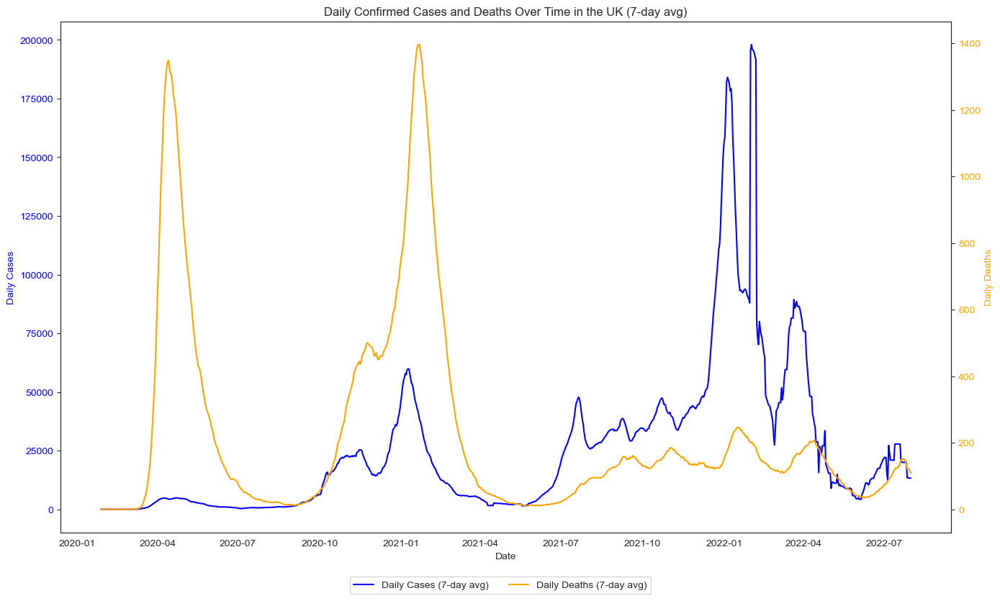

In [185]:
# Create weekly average cases/deaths
# Load the datasets
cases = pd.read_csv('time_series_covid19_confirmed_global.csv')
deaths = pd.read_csv('time_series_covid19_deaths_global.csv')

# Filter for the United Kingdom
cases_uk = cases[cases['Country/Region'] == 'United Kingdom'].drop(columns=['Province/State', 
                                                                            'Country/Region', 'Lat', 'Long'])
deaths_uk = deaths[deaths['Country/Region'] == 'United Kingdom'].drop(columns=['Province/State', 
                                                                               'Country/Region', 'Lat', 'Long'])

# Sum the cases and deaths to get total values
cases_uk = cases_uk.sum().reset_index()
deaths_uk = deaths_uk.sum().reset_index()

# Rename the columns
cases_uk.columns = ['Date', 'Cumulative Cases']
deaths_uk.columns = ['Date', 'Cumulative Deaths']

# Convert 'Date' to datetime format
cases_uk['Date'] = pd.to_datetime(cases_uk['Date'])
deaths_uk['Date'] = pd.to_datetime(deaths_uk['Date'])

# Merge the cases and deaths data on 'Date'
data_uk = pd.merge(cases_uk, deaths_uk, on='Date')

# Calculate daily new cases and deaths
data_uk['Daily Cases'] = data_uk['Cumulative Cases'].diff().fillna(0)
data_uk['Daily Deaths'] = data_uk['Cumulative Deaths'].diff().fillna(0)

# Apply rolling average to smooth the data
data_uk['Daily Cases (7-day avg)'] = data_uk['Daily Cases'].rolling(window=7).mean()
data_uk['Daily Deaths (7-day avg)'] = data_uk['Daily Deaths'].rolling(window=7).mean()

# Filter data up to 31-07-2022
data_uk = data_uk[data_uk['Date'] <= '2022-07-31']

# Plot the data with dual axes
fig, ax1 = plt.subplots(figsize=(14, 8))

# Plot daily cases on the first y-axis
ax1.set_xlabel('Date')
ax1.set_ylabel('Daily Cases', color='blue')
ax1.plot(data_uk['Date'], data_uk['Daily Cases (7-day avg)'], color='blue', 
         label='Daily Cases (7-day avg)')
ax1.tick_params(axis='y', labelcolor='blue')

# Create a second y-axis to plot daily deaths
ax2 = ax1.twinx()
ax2.set_ylabel('Daily Deaths', color='orange')
ax2.plot(data_uk['Date'], data_uk['Daily Deaths (7-day avg)'], color='orange',
         label='Daily Deaths (7-day avg)')
ax2.tick_params(axis='y', labelcolor='orange')

# Title and legend
plt.title('Daily Confirmed Cases and Deaths Over Time in the UK (7-day avg)')
fig.tight_layout()

# Add legend below the chart
fig.legend(loc='upper center', bbox_to_anchor=(0.5, 0), ncol=2)

plt.show()

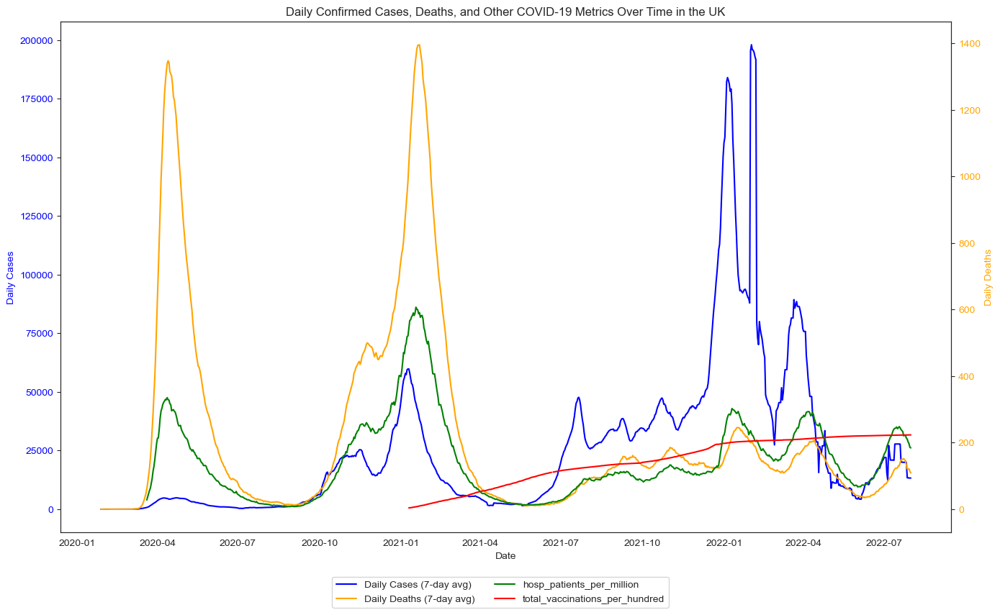

In [186]:
# Combined covid metrics
# Load the datasets
cases = pd.read_csv('time_series_covid19_confirmed_global.csv')
deaths = pd.read_csv('time_series_covid19_deaths_global.csv')
data = pd.read_csv('UK_covid19_data_2020_2022.csv')

# Filter for the United Kingdom
cases_uk = cases[cases['Country/Region'] == 'United Kingdom'].drop(columns=['Province/State', 
                                                                            'Country/Region', 'Lat', 'Long'])
deaths_uk = deaths[deaths['Country/Region'] == 'United Kingdom'].drop(columns=['Province/State', 'Country/Region', 
                                                                               'Lat', 'Long'])

# Sum the cases and deaths to get total values
cases_uk = cases_uk.sum().reset_index()
deaths_uk = deaths_uk.sum().reset_index()

# Rename the columns
cases_uk.columns = ['Date', 'Cumulative Cases']
deaths_uk.columns = ['Date', 'Cumulative Deaths']

# Convert 'Date' to datetime format
cases_uk['Date'] = pd.to_datetime(cases_uk['Date'])
deaths_uk['Date'] = pd.to_datetime(deaths_uk['Date'])

# Merge the cases and deaths data on 'Date'
data_uk = pd.merge(cases_uk, deaths_uk, on='Date')

# Calculate daily new cases and deaths
data_uk['Daily Cases'] = data_uk['Cumulative Cases'].diff().fillna(0)
data_uk['Daily Deaths'] = data_uk['Cumulative Deaths'].diff().fillna(0)

# Apply rolling average to smooth the data
data_uk['Daily Cases (7-day avg)'] = data_uk['Daily Cases'].rolling(window=7).mean()
data_uk['Daily Deaths (7-day avg)'] = data_uk['Daily Deaths'].rolling(window=7).mean()

# Filter data up to 31-07-2022
data_uk = data_uk[data_uk['Date'] <= '2022-07-31']

# Ensure the date column in the additional data is in the correct datetime format
data['date'] = pd.to_datetime(data['date'])

# List of columns to plot
columns_to_plot = [
    'hosp_patients_per_million',
    'total_vaccinations_per_hundred'
]

# Define colors for each metric
colors = {
    'Daily Cases (7-day avg)': 'blue',
    'Daily Deaths (7-day avg)': 'orange',
    'hosp_patients_per_million': 'green',
    'total_vaccinations_per_hundred': 'red'
}

# Plot the data with dual axes
fig, ax1 = plt.subplots(figsize=(14, 8))

# Plot daily cases on the first y-axis
ax1.set_xlabel('Date')
ax1.set_ylabel('Daily Cases', color=colors['Daily Cases (7-day avg)'])
ax1.plot(data_uk['Date'], data_uk['Daily Cases (7-day avg)'], 
         color=colors['Daily Cases (7-day avg)'], 
         label='Daily Cases (7-day avg)')
ax1.tick_params(axis='y', labelcolor=colors['Daily Cases (7-day avg)'])

# Create a second y-axis to plot daily deaths
ax2 = ax1.twinx()
ax2.set_ylabel('Daily Deaths', color=colors['Daily Deaths (7-day avg)'])
ax2.plot(data_uk['Date'], data_uk['Daily Deaths (7-day avg)'], 
         color=colors['Daily Deaths (7-day avg)'], 
         label='Daily Deaths (7-day avg)')
ax2.tick_params(axis='y', labelcolor=colors['Daily Deaths (7-day avg)'])

# Plot each additional column on the second y-axis
for column in columns_to_plot:
    ax2.plot(data['date'], data[column], color=colors[column], label=column)
    
# Title and legend
plt.title('Daily Confirmed Cases, Deaths, and Other COVID-19 Metrics Over Time in the UK')
fig.tight_layout()

# Add legend below the chart
fig.legend(loc='upper center', bbox_to_anchor=(0.5, 0), ncol=2)
plt.savefig('covid_metrics.png')
plt.show()

- Early 2020: Initial wave with high deaths compared to cases, indicating low vaccination rates and possibly less effective treatment.
- Late 2020 to Early 2021: A major wave with high cases and deaths, but the start of vaccinations begins to show effects.
- Mid 2021: Despite a high number of cases, deaths and hospitalizations are relatively lower, indicating the effect of vaccinations.
- Late 2021 to Early 2022: Another significant wave with high cases, but deaths and hospitalizations are significantly lower compared to previous waves.

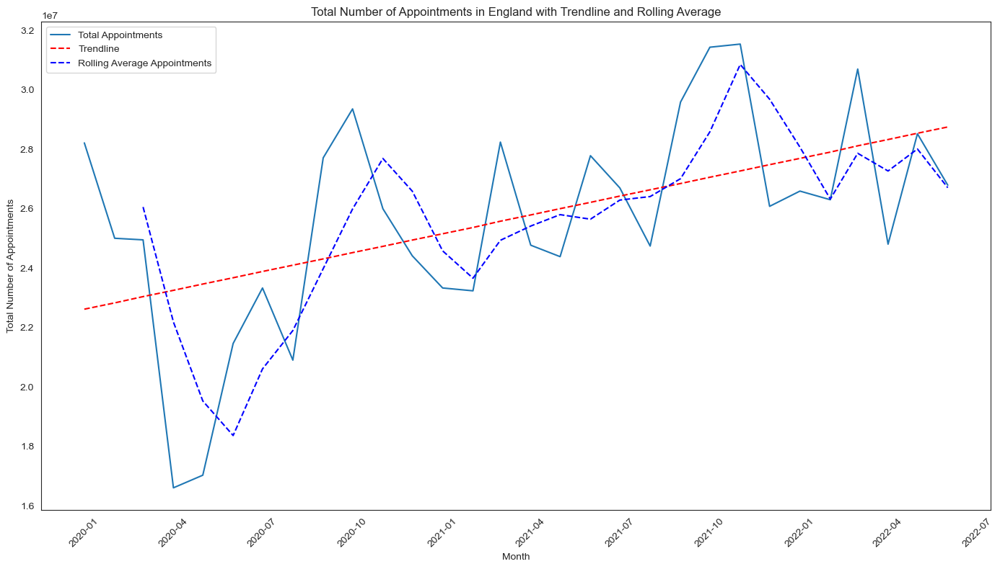

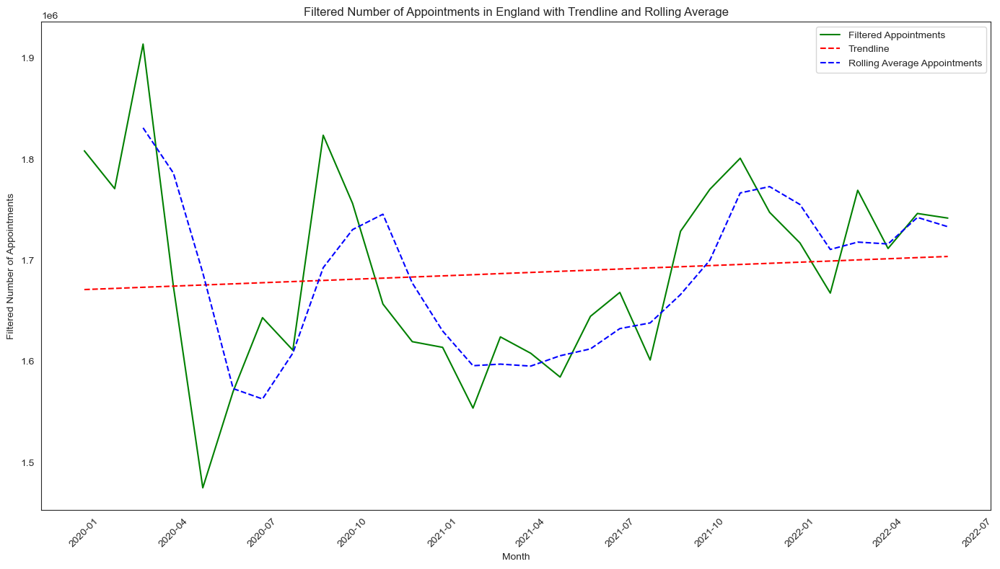

In [188]:
# Compare average and total appointment trends over time
# Load the datasets
ar = pd.read_csv('scaled_appointments_regional.csv')
filtered_ar = pd.read_csv('filtered_appointments_regional.csv')

# Ensure appointment_month is in datetime format for both datasets
ar['appointment_month'] = pd.to_datetime(ar['appointment_month'], format='%Y-%m')
filtered_ar['appointment_month'] = pd.to_datetime(filtered_ar['appointment_month'],
                                                  format='%Y-%m')

# Aggregate the data by month for both datasets
monthly_appointments = (
    ar.groupby('appointment_month')['estimated_total_appointments']
    .sum().reset_index())
filtered_monthly_appointments = (
    filtered_ar.groupby('appointment_month')['estimated_total_appointments']
    .sum().reset_index())

# Prepare data for linear regression
X = np.arange(len(monthly_appointments)).reshape(-1, 1)  # time index as feature

# Fit linear regression model for original data
model_original = LinearRegression()
model_original.fit(X, monthly_appointments['estimated_total_appointments'].values)
trendline_original = model_original.predict(X)

# Fit linear regression model for filtered data
model_filtered = LinearRegression()
model_filtered.fit(X, filtered_monthly_appointments['estimated_total_appointments'].values)
trendline_filtered = model_filtered.predict(X)

# Calculate rolling average (e.g., 3-month window) for both datasets
monthly_appointments['rolling_avg'] = (
    monthly_appointments['estimated_total_appointments'].rolling(window=3).mean())
filtered_monthly_appointments['rolling_avg'] = (
    filtered_monthly_appointments['estimated_total_appointments'].rolling(window=3).mean())

# Plot the total number of appointments over time with trendline and rolling average
plt.figure(figsize=(14, 8))
sns.lineplot(data=monthly_appointments, x='appointment_month', 
             y='estimated_total_appointments',
             label='Total Appointments')
plt.plot(monthly_appointments['appointment_month'], trendline_original, color='red', 
         linestyle='--', label='Trendline')
sns.lineplot(data=monthly_appointments, x='appointment_month', y='rolling_avg', 
             label='Rolling Average Appointments', color='blue', linestyle='--')
plt.title('Total Number of Appointments in England with Trendline and Rolling Average')
plt.xlabel('Month')
plt.ylabel('Total Number of Appointments')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.savefig('total_appointments_with trendline.png')
plt.show()

# Plot the outlier-filtered appointments over time with trendline and rolling average
plt.figure(figsize=(14, 8))
sns.lineplot(data=filtered_monthly_appointments, x='appointment_month', 
             y='estimated_total_appointments', label='Filtered Appointments', 
             color='green')
plt.plot(filtered_monthly_appointments['appointment_month'], trendline_filtered, 
         color='red', linestyle='--', label='Trendline')
sns.lineplot(data=filtered_monthly_appointments, x='appointment_month', y='rolling_avg', 
             label='Rolling Average Appointments', color='blue', linestyle='--')
plt.title('Filtered Number of Appointments in England with Trendline and Rolling Average')
plt.xlabel('Month')
plt.ylabel('Filtered Number of Appointments')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.savefig('filtered_appointment_trends.png')
plt.show()


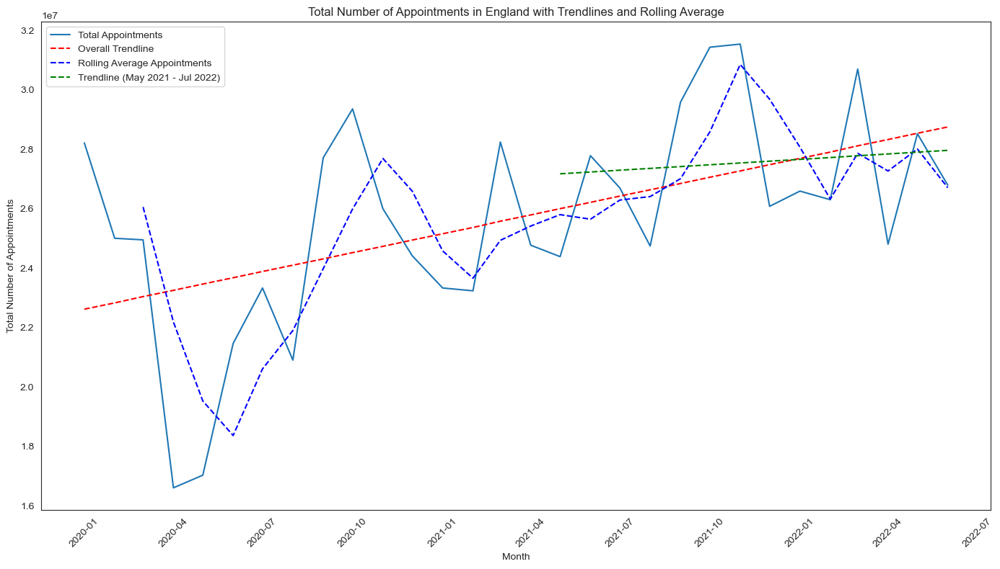

In [189]:
# Add an additional linear regression line for the last year of the appointment data
# Load the datasets
ar = pd.read_csv('scaled_appointments_regional.csv')
filtered_ar = pd.read_csv('filtered_appointments_regional.csv')

# Ensure appointment_month is in datetime format for both datasets
ar['appointment_month'] = pd.to_datetime(ar['appointment_month'], format='%Y-%m')
filtered_ar['appointment_month'] = pd.to_datetime(filtered_ar['appointment_month'], format='%Y-%m')

# Aggregate the data by month for both datasets
monthly_appointments = (
    ar.groupby('appointment_month')['estimated_total_appointments']
    .sum().reset_index())
filtered_monthly_appointments = (
    filtered_ar.groupby('appointment_month')['estimated_total_appointments']
    .sum().reset_index())

# Prepare data for linear regression
X = np.arange(len(monthly_appointments)).reshape(-1, 1)  # time index as feature

# Fit linear regression model for original data
model_original = LinearRegression()
model_original.fit(X, monthly_appointments['estimated_total_appointments'].values)
trendline_original = model_original.predict(X)

# Fit linear regression model for filtered data
model_filtered = LinearRegression()
model_filtered.fit(X, filtered_monthly_appointments['estimated_total_appointments'].values)
trendline_filtered = model_filtered.predict(X)

# Filter data for the specific date range (June 2021 to July 2022)
mask = (monthly_appointments['appointment_month'] >= '2021-05-01') & (monthly_appointments['appointment_month'] <= '2022-07-31')
X_range = np.arange(len(monthly_appointments[mask])).reshape(-1, 1)
model_range = LinearRegression()
model_range.fit(X_range, monthly_appointments[mask]['estimated_total_appointments'].values)
trendline_range = model_range.predict(X_range)

# Calculate rolling average (e.g., 3-month window) for both datasets
monthly_appointments['rolling_avg'] = (
    monthly_appointments['estimated_total_appointments'].rolling(window=3).mean())
filtered_monthly_appointments['rolling_avg'] = (
    filtered_monthly_appointments['estimated_total_appointments'].rolling(window=3).mean())

# Plot the total number of appointments over time with trendline and rolling average
plt.figure(figsize=(14, 8))
sns.lineplot(data=monthly_appointments, x='appointment_month', 
             y='estimated_total_appointments',
             label='Total Appointments')
plt.plot(monthly_appointments['appointment_month'], trendline_original, color='red', 
         linestyle='--', label='Overall Trendline')
sns.lineplot(data=monthly_appointments, x='appointment_month', y='rolling_avg', 
             label='Rolling Average Appointments', color='blue', linestyle='--')

# Plot the second trendline for the date range (June 2021 to July 2022)
plt.plot(monthly_appointments[mask]['appointment_month'], trendline_range, color='green', 
         linestyle='--', label='Trendline (May 2021 - Jul 2022)')

plt.title('Total Number of Appointments in England with Trendlines and Rolling Average')
plt.xlabel('Month')
plt.ylabel('Total Number of Appointments')
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.savefig('total_appointments_with_trendlines.png')
plt.show()


Combined insights with GP appointment trends
- The upward trend in GP appointments indicates a recovery and adjustment phase in the healthcare system as it deals with COVID-19. When the final year is examined the trendline is stagnant, which was also visible in the regional decomposition analysis.
- The fluctuations in GP appointments can be partially attributed to the impact of COVID-19 waves and subsequent public health responses.
- The data suggests that while the pandemic posed significant challenges, the healthcare system has shown resilience and adaptability, leading to an overall increase in appointments over time.

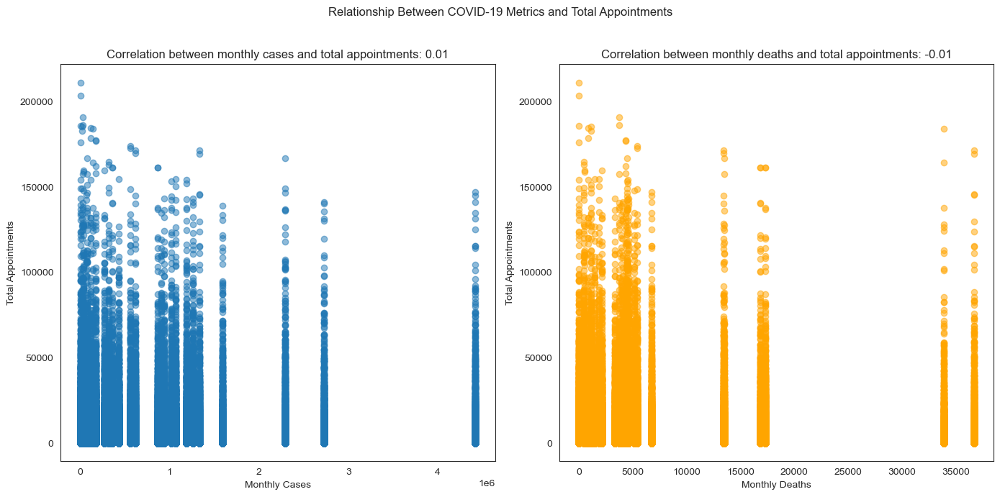

In [191]:
# Finding correlation between COVID-metrics and Total appointments in ar dataset
# Load the datasets
cases = pd.read_csv('time_series_covid19_confirmed_global.csv')
deaths = pd.read_csv('time_series_covid19_deaths_global.csv')
appointments = pd.read_csv('scaled_appointments_regional.csv')

# Filter for the United Kingdom
cases_uk = cases[cases['Country/Region'] == 'United Kingdom'].drop(columns=['Province/State', 
                                                                            'Country/Region', 'Lat', 'Long'])
deaths_uk = deaths[deaths['Country/Region'] == 'United Kingdom'].drop(columns=['Province/State', 
                                                                               'Country/Region', 'Lat', 'Long'])

# Sum the cases and deaths to get total values
cases_uk = cases_uk.sum().reset_index()
deaths_uk = deaths_uk.sum().reset_index()

# Rename the columns
cases_uk.columns = ['Date', 'Cumulative Cases']
deaths_uk.columns = ['Date', 'Cumulative Deaths']

# Convert 'Date' to datetime format
cases_uk['Date'] = pd.to_datetime(cases_uk['Date'])
deaths_uk['Date'] = pd.to_datetime(deaths_uk['Date'])

# Calculate daily new cases and deaths
cases_uk['Daily Cases'] = cases_uk['Cumulative Cases'].diff().fillna(0)
deaths_uk['Daily Deaths'] = deaths_uk['Cumulative Deaths'].diff().fillna(0)

# Aggregate daily data to monthly data
cases_uk['Month'] = cases_uk['Date'].dt.to_period('M')
deaths_uk['Month'] = deaths_uk['Date'].dt.to_period('M')

monthly_cases = cases_uk.groupby('Month')['Daily Cases'].sum().reset_index()
monthly_deaths = deaths_uk.groupby('Month')['Daily Deaths'].sum().reset_index()

# Ensure the date column in the appointments data is in the correct datetime format
appointments['appointment_month'] = pd.to_datetime(appointments['appointment_month'], 
                                                   format='%Y-%m')

# Merge the monthly aggregated data with the appointment data
merged_data = pd.merge(monthly_cases, monthly_deaths, left_on='Month', right_on='Month', 
                       how='inner')
merged_data = pd.merge(merged_data, appointments, left_on='Month', 
                       right_on=appointments['appointment_month'].dt.to_period('M'), 
                       how='inner')

# Calculate the correlations
correlation_cases_appointments = (
    merged_data['Daily Cases'].corr(merged_data['count_of_appointments']))
correlation_deaths_appointments = (
    merged_data['Daily Deaths'].corr(merged_data['count_of_appointments']))

# Plot the scatter plots
fig, axes = plt.subplots(1, 2, figsize=(14, 7))

# Scatter plot for Monthly Cases vs Total Appointments
axes[0].scatter(merged_data['Daily Cases'], merged_data['count_of_appointments'],
                alpha=0.5)
axes[0].set_title(
    f'Correlation between monthly cases and total appointments: '
    f'{correlation_cases_appointments:.2f}')
axes[0].set_xlabel('Monthly Cases')
axes[0].set_ylabel('Total Appointments')

# Scatter plot for Monthly Deaths vs Total Appointments
axes[1].scatter(merged_data['Daily Deaths'], merged_data['count_of_appointments'], alpha=0.5, color='orange')
axes[1].set_title(f'Correlation between monthly deaths and total appointments: {correlation_deaths_appointments:.2f}')
axes[1].set_xlabel('Monthly Deaths')
axes[1].set_ylabel('Total Appointments')

plt.suptitle('Relationship Between COVID-19 Metrics and Total Appointments')
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


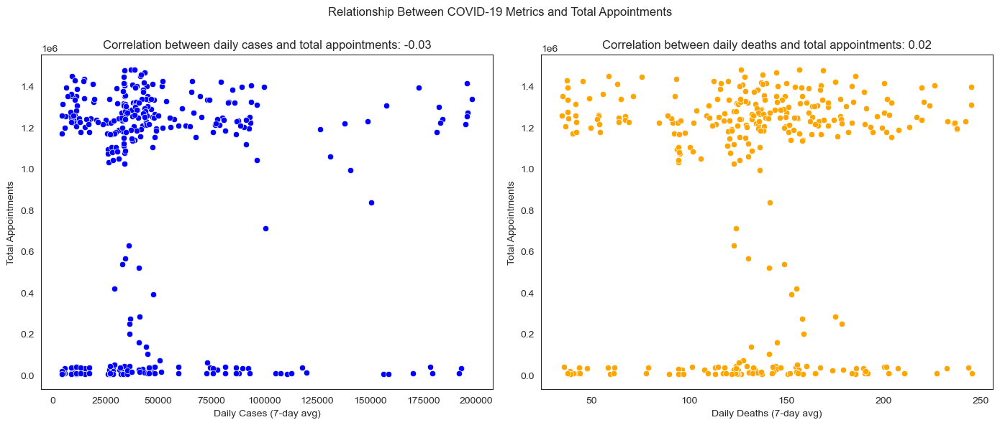

Correlation between daily cases and total appointments: -0.028086259454960225
Correlation between daily deaths and total appointments: 0.021075456221924395


In [198]:
# Finding correlation between COVID metrics and total daily appointments in nc
# Load the datasets
nc = pd.read_csv('updated_national_categories.csv')
cases = pd.read_csv('time_series_covid19_confirmed_global.csv')
deaths = pd.read_csv('time_series_covid19_deaths_global.csv')

# Ensure 'appointment_date' is in datetime format
nc['appointment_date'] = pd.to_datetime(nc['appointment_date'])

# Filter for the United Kingdom
cases_uk = cases[cases['Country/Region'] == 'United Kingdom'].drop(columns=['Province/State', 
                                                                            'Country/Region', 'Lat', 'Long'])
deaths_uk = deaths[deaths['Country/Region'] == 'United Kingdom'].drop(columns=['Province/State', 
                                                                               'Country/Region', 'Lat', 'Long'])

# Sum the cases and deaths to get total values
cases_uk = cases_uk.sum().reset_index()
deaths_uk = deaths_uk.sum().reset_index()

# Rename the columns
cases_uk.columns = ['Date', 'Cumulative Cases']
deaths_uk.columns = ['Date', 'Cumulative Deaths']

# Convert 'Date' to datetime format
cases_uk['Date'] = pd.to_datetime(cases_uk['Date'])
deaths_uk['Date'] = pd.to_datetime(deaths_uk['Date'])

# Merge the cases and deaths data on 'Date'
data_uk = pd.merge(cases_uk, deaths_uk, on='Date')

# Calculate daily new cases and deaths
data_uk['Daily Cases'] = data_uk['Cumulative Cases'].diff().fillna(0)
data_uk['Daily Deaths'] = data_uk['Cumulative Deaths'].diff().fillna(0)

# Apply rolling average to smooth the data
data_uk['Daily Cases (7-day avg)'] = data_uk['Daily Cases'].rolling(window=7).mean()
data_uk['Daily Deaths (7-day avg)'] = data_uk['Daily Deaths'].rolling(window=7).mean()

# Filter data up to 31-07-2022
data_uk = data_uk[data_uk['Date'] <= '2022-07-31']

# Filter the nc data for the specified date range
filtered_nc = nc[
    (nc['appointment_date'] >= '2021-07-01') & 
    (nc['appointment_date'] <= '2022-07-31')]

# Calculate daily total appointments
daily_appointments = (
    filtered_nc.groupby('appointment_date')['count_of_appointments']
    .sum().reset_index())

# Merge with the COVID-19 data
merged_data = pd.merge(data_uk, daily_appointments, left_on='Date', 
                       right_on='appointment_date', how='inner')

# Calculate correlations
cases_appointments_corr = (
    merged_data['Daily Cases (7-day avg)'].corr(merged_data['count_of_appointments']))
    
deaths_appointments_corr = (
    merged_data['Daily Deaths (7-day avg)'].corr(merged_data['count_of_appointments']))

# Plot the relationships
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

# Plot for cases vs appointments
sns.scatterplot(ax=axes[0], x='Daily Cases (7-day avg)',
                y='count_of_appointments', data=merged_data, color='blue')
axes[0].set_title(
    f'Correlation between daily cases and total appointments: '
    f'{cases_appointments_corr:.2f}')
axes[0].set_xlabel('Daily Cases (7-day avg)')
axes[0].set_ylabel('Total Appointments')

# Plot for deaths vs appointments
sns.scatterplot(ax=axes[1], x='Daily Deaths (7-day avg)', 
                y='count_of_appointments', data=merged_data, color='orange')
axes[1].set_title(
    f'Correlation between daily deaths and total appointments: '
    f'{deaths_appointments_corr:.2f}')
axes[1].set_xlabel('Daily Deaths (7-day avg)')
axes[1].set_ylabel('Total Appointments')

plt.suptitle('Relationship Between COVID-19 Metrics and Total Appointments')
plt.tight_layout()
plt.show()

print(f'Correlation between daily cases and total appointments: {cases_appointments_corr}')
print(f'Correlation between daily deaths and total appointments: {deaths_appointments_corr}')

Results: No strong relationship was found between COVID-19 metrics and total appointments. It would have been useful to have daily data of time between booking and appointments to see if there was relationship between the same day appointments or missed appointments as a result of COVID metrics.

<a id="Weather-analysis"></a>
# Weather analysis

Weather analysis. Unfortunately due to restrictions I was not able to get historical weather data through the openweather API. Also tried https://www.visualcrossing.com/weather/weather-data-services#, where only limited data is available in a single request. I was able to get London and Birmingham weather data between 01/07/2021 and 31/07/2022 from https://www.noaa.gov/ by completing two separate requests. Tried other cities, such as Bristol, Norwich, Exeter, Manchester, however these were not available. The data acquired were in Farenheit. Data was converted to Celsius in Excel. There were some missing values for the London data.

In [205]:
# Load the weather data
london_temp = pd.read_csv('london_temp.csv')
birmingham_temp = pd.read_csv('birmingham_temp.csv')

london_temp = london_temp[['location', 'date', 'average_c', 'max_c', 'min_c']]
london_temp.head()

,location,date,average_c,max_c,min_c
0,London,01/07/2021,17.2,#VALUE!,12.2
1,London,02/07/2021,18.9,#VALUE!,#VALUE!
2,London,03/07/2021,18.3,#VALUE!,#VALUE!
3,London,04/07/2021,16.7,#VALUE!,#VALUE!
4,London,05/07/2021,16.1,#VALUE!,13.9


In [207]:
birmingham_temp = birmingham_temp[['location', 'date', 'average_c', 'max_c', 'min_c']]
birmingham_temp.head()

,location,date,average_c,max_c,min_c
0,Birmingham,01/07/2021,16.1,22.2,10.0
1,Birmingham,02/07/2021,16.7,21.1,12.2
2,Birmingham,03/07/2021,17.5,20.6,14.4
3,Birmingham,04/07/2021,16.9,19.4,14.4
4,Birmingham,05/07/2021,15.6,18.3,12.8


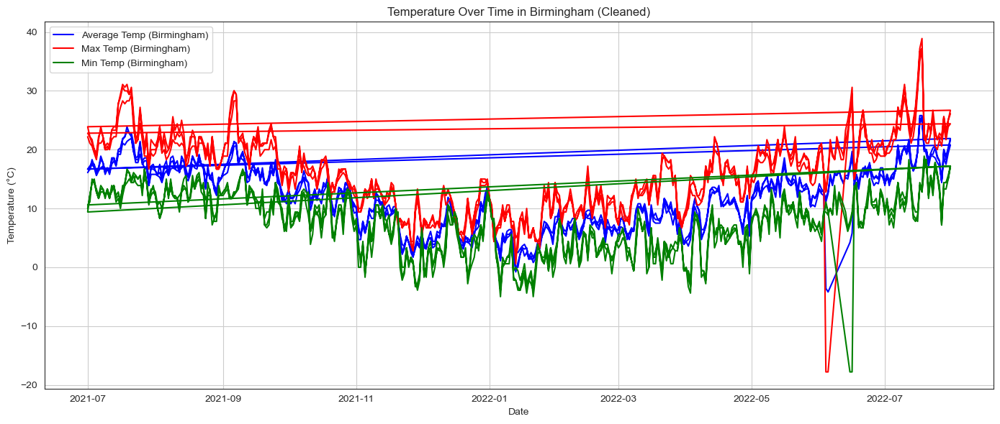

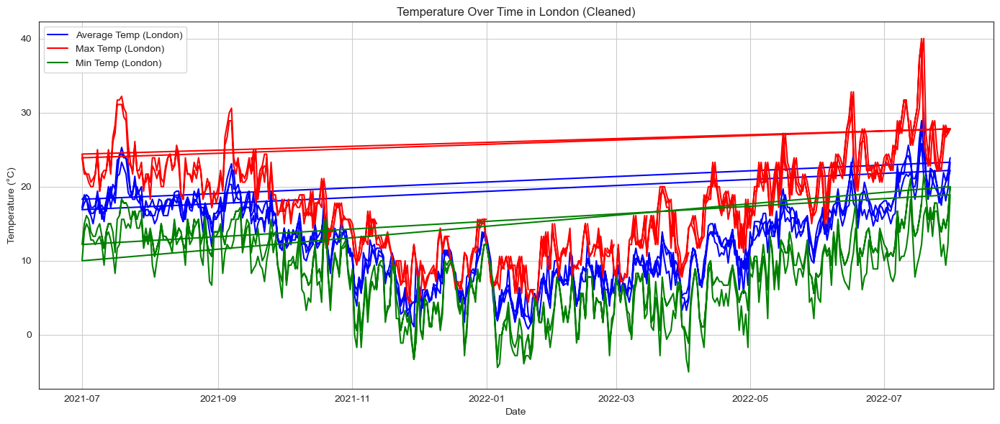

In [209]:
# Analyse the weather data
# Load your data
birmingham_temp = pd.read_csv('birmingham_temp.csv')
london_temp = pd.read_csv('london_temp.csv')

# Replace '#VALUE!' with NaN and convert columns to numeric
london_temp.replace('#VALUE!', pd.NA, inplace=True)
london_temp[['average_c', 'max_c', 'min_c']] = (
    london_temp[['average_c','max_c', 'min_c']]
    .apply(pd.to_numeric, errors='coerce')
)
# Ensure date columns are in datetime format
birmingham_temp['date'] = pd.to_datetime(birmingham_temp['date'], dayfirst=True)
london_temp['date'] = pd.to_datetime(london_temp['date'], dayfirst=True)

# Plot the cleaned data for Birmingham
plt.figure(figsize=(14, 6))
plt.plot(birmingham_temp['date'], birmingham_temp['average_c'],
         label='Average Temp (Birmingham)', color='blue')
plt.plot(birmingham_temp['date'], birmingham_temp['max_c'], 
         label='Max Temp (Birmingham)', color='red')
plt.plot(birmingham_temp['date'], birmingham_temp['min_c'], 
         label='Min Temp (Birmingham)', color='green')
plt.title('Temperature Over Time in Birmingham (Cleaned)')
plt.xlabel('Date')
plt.ylabel('Temperature (°C)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot the cleaned data for London
plt.figure(figsize=(14, 6))
plt.plot(london_temp['date'], london_temp['average_c'], 
         label='Average Temp (London)', color='blue')
plt.plot(london_temp['date'], london_temp['max_c'], 
         label='Max Temp (London)', color='red')
plt.plot(london_temp['date'], london_temp['min_c'], 
         label='Min Temp (London)', color='green')
plt.title('Temperature Over Time in London (Cleaned)')
plt.xlabel('Date')
plt.ylabel('Temperature (°C)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


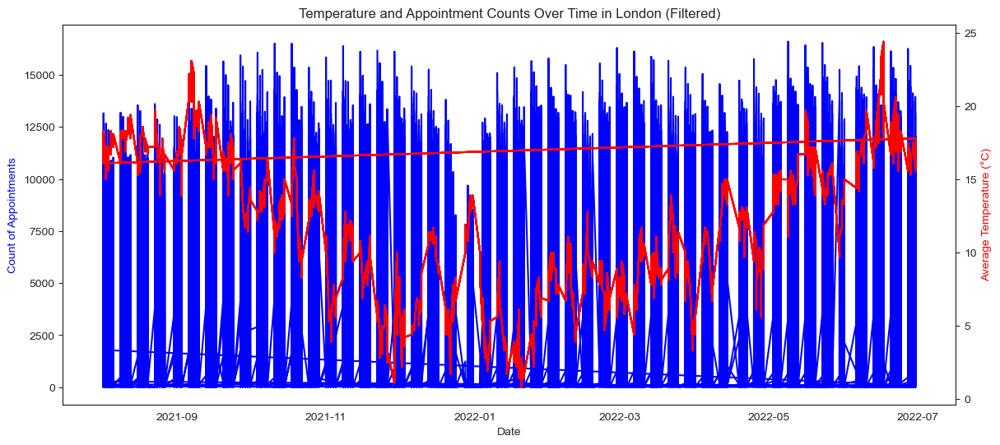

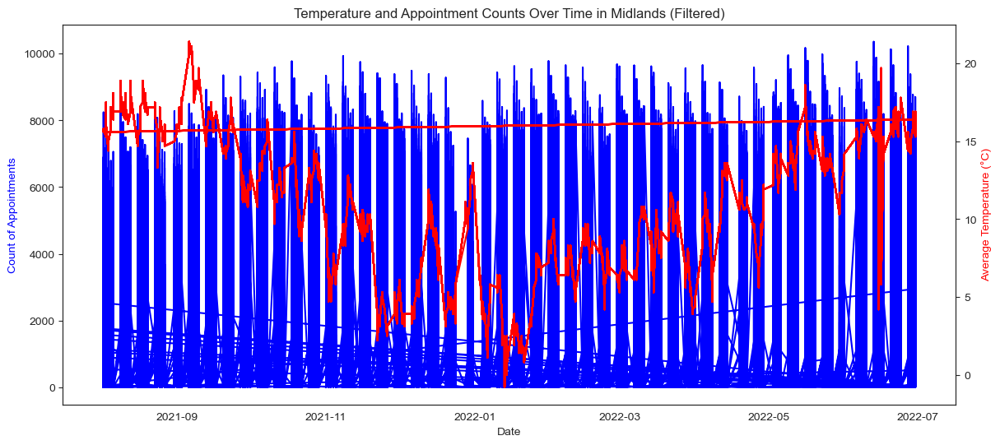

In [211]:
# Checking for relationship between temperature data and appointment numbers in London and Birmingham
#focusing on the weekday data
# Load your updated national category data
nc = pd.read_csv('updated_national_categories.csv')

# Ensure the appointment_date column is in datetime format
nc['appointment_date'] = pd.to_datetime(nc['appointment_date'])

# Filter for London and Midlands regions
london_appointments = nc[nc['region_name'] == 'London']
midlands_appointments = nc[nc['region_name'] == 'Midlands']

# Ensure the date columns in weather data are in datetime format
birmingham_temp['date'] = pd.to_datetime(birmingham_temp['date'])
london_temp['date'] = pd.to_datetime(london_temp['date'])

# Merge the weather data with the appointment data on the date column
london_appointments = london_appointments.merge(london_temp, 
                                                left_on='appointment_date',
                                                right_on='date', how='left')
midlands_appointments = midlands_appointments.merge(birmingham_temp, 
                                                    left_on='appointment_date',
                                                    right_on='date', how='left')

# List of UK bank holidays
uk_bank_holidays = [
    '2021-01-01', '2021-04-02', '2021-04-05', '2021-05-03', '2021-05-31', '2021-08-30',
    '2021-12-25', '2021-12-26', '2021-12-27', '2022-01-01', '2022-04-15', '2022-04-18',
    '2022-05-02', '2022-06-02', '2022-06-03', '2022-08-29', '2022-12-25', '2022-12-26'
]

# Convert bank holidays to datetime
uk_bank_holidays = pd.to_datetime(uk_bank_holidays)

# Function to filter out weekends and bank holidays
def filter_weekends_and_holidays(df):
    df['day_of_week'] = df['appointment_date'].dt.dayofweek
    return df[(df['day_of_week'] < 5) & (~df['appointment_date'].isin(uk_bank_holidays))]

# Apply the filter function
london_appointments_filtered = filter_weekends_and_holidays(london_appointments)
midlands_appointments_filtered = filter_weekends_and_holidays(midlands_appointments)

# Plotting temperature and appointment counts over time for London
fig, ax1 = plt.subplots(figsize=(14, 6))
ax1.plot(london_appointments_filtered['appointment_date'],
         london_appointments_filtered['count_of_appointments'],
         color='blue', label='Appointments')
ax1.set_xlabel('Date')
ax1.set_ylabel('Count of Appointments', color='blue')
ax2 = ax1.twinx()
ax2.plot(london_appointments_filtered['appointment_date'], 
         london_appointments_filtered['average_c'],
         color='red', label='Temperature')
ax2.set_ylabel('Average Temperature (°C)', color='red')
plt.title('Temperature and Appointment Counts Over Time in London (Filtered)')
plt.show()

# Plotting temperature and appointment counts over time for Midlands
fig, ax1 = plt.subplots(figsize=(14, 6))
ax1.plot(midlands_appointments_filtered['appointment_date'], 
         midlands_appointments_filtered['count_of_appointments'],
         color='blue', label='Appointments')
ax1.set_xlabel('Date')
ax1.set_ylabel('Count of Appointments', color='blue')
ax2 = ax1.twinx()
ax2.plot(midlands_appointments_filtered['appointment_date'], 
         midlands_appointments_filtered['average_c'], 
         color='red', label='Temperature')
ax2.set_ylabel('Average Temperature (°C)', color='red')
plt.title('Temperature and Appointment Counts Over Time in Midlands (Filtered)')
plt.show()


Correlation between temperature and appointments in London: 0.0010192250688967248
Correlation between temperature and appointments in Midlands: 0.002548957148294061


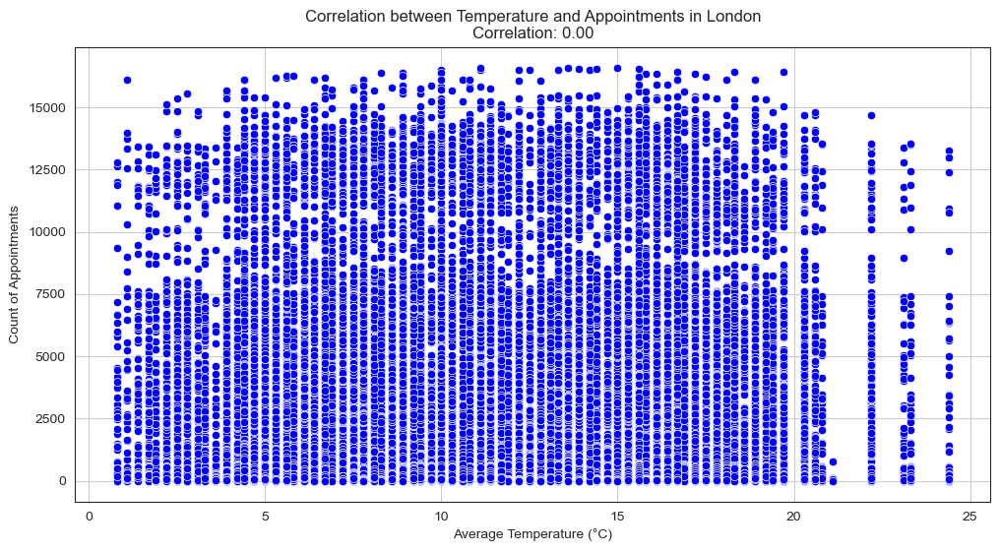

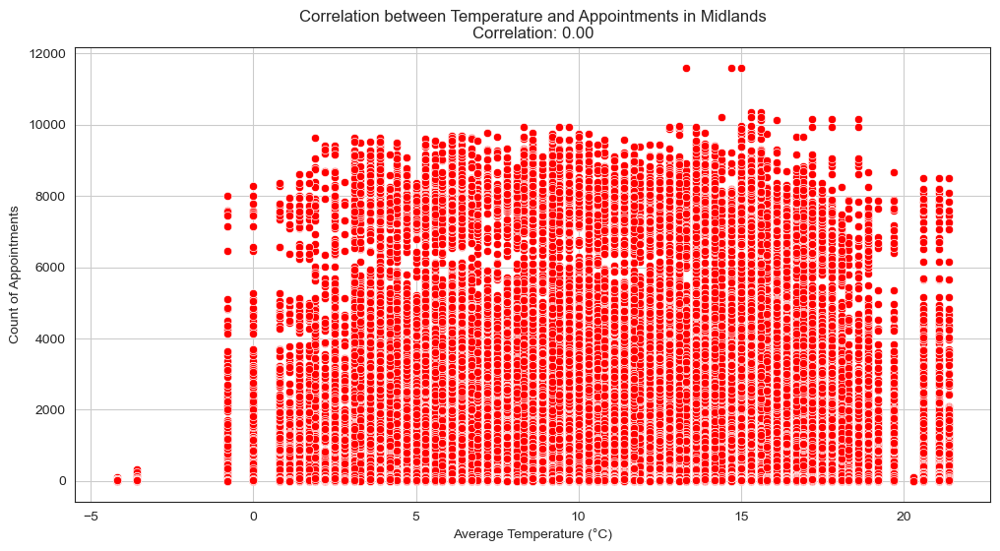

In [212]:
# Checking for correlation betweeen weather data and appointments
# Load your updated national category data
nc = pd.read_csv('updated_national_categories.csv')

# Ensure the appointment_date column is in datetime format
nc['appointment_date'] = pd.to_datetime(nc['appointment_date'])

# Filter for London and Midlands regions
london_appointments = nc[nc['region_name'] == 'London']
midlands_appointments = nc[nc['region_name'] == 'Midlands']

# Ensure the date columns in weather data are in datetime format
birmingham_temp['date'] = pd.to_datetime(birmingham_temp['date'])
london_temp['date'] = pd.to_datetime(london_temp['date'])

# Merge the weather data with the appointment data on the date column
london_appointments = london_appointments.merge(london_temp, 
                                                left_on='appointment_date', 
                                                right_on='date', how='left')
midlands_appointments = midlands_appointments.merge(birmingham_temp, 
                                                    left_on='appointment_date', 
                                                    right_on='date', how='left')

# Calculate correlation for London
london_corr = (
    london_appointments[['count_of_appointments', 'average_c']]
    .corr().iloc[0, 1]
)
print(f"Correlation between temperature and appointments in London: {london_corr}")

# Calculate correlation for Midlands
midlands_corr = midlands_appointments[['count_of_appointments', 
                                       'average_c']].corr().iloc[0, 1]
print(f"Correlation between temperature and appointments in Midlands: {midlands_corr}")

# Plotting correlation for London
plt.figure(figsize=(12, 6))
sns.scatterplot(x=london_appointments['average_c'], 
                y=london_appointments['count_of_appointments'], color='blue')
plt.title(f'Correlation between Temperature and Appointments in London\nCorrelation: {london_corr:.2f}')
plt.xlabel('Average Temperature (°C)')
plt.ylabel('Count of Appointments')
plt.grid(True)
plt.show()

# Plotting correlation for Midlands
plt.figure(figsize=(12, 6))
sns.scatterplot(x=midlands_appointments['average_c'],
                y=midlands_appointments['count_of_appointments'], color='red')
plt.title(f'Correlation between Temperature and Appointments in Midlands\nCorrelation: {midlands_corr:.2f}')
plt.xlabel('Average Temperature (°C)')
plt.ylabel('Count of Appointments')
plt.grid(True)
plt.show()


Results: No strong relationship was found betweeen temperature and total appointments in London and Birmingham Regions. It is not within the scope of this assignment to further explore this relationship. It would have been useful to have daily data of time between booking and appointments and missed appointments to see if there was relationship between the same day appointments in extreme weather conditions or missed appointments as a result. Or further analysis of what type of appointments are not attended as a result 

<a id="Recommendations"></a>
# Recommendations
#### Service improvement recommendations:
1.	Staff Allocation: NHS should allocate more staffing on busier days, months, and seasons. This proactive measure will ensure that resources are available when demand is highest.
2.	Systematic Resource Management: Conduct a detailed review of current resource allocation to identify areas where improvements or additional staffing can mitigate overall service demand. This includes analysing local demands and setting targeted staffing levels accordingly.
3.	Long Appointment Management: Investigate the reasons for extended appointment durations and explore strategies to manage these more efficiently, potentially reducing staffing demands without compromising care quality.
4.	Data Mapping and Reporting: Provide additional staff education or implement system improvements to eliminate unmapped or inconsistently mapped appointment data. Accurate data is crucial for making informed decisions.
5.	Regional Staffing Adjustments: Regions like London, with lower staff-to-patient ratios and high appointment density, require staffing improvements. Additionally, London’s high rate of missed appointments suggests the need for targeted interventions.
6.	Resilience Building: Enhance resilience to major outbreaks by learning from COVID-19’s impact on appointment handling, ensuring that future crises do not overwhelm the system.
7.	Telehealth and Online Appointments: Continue improving telehealth and online appointment services to offer patients more flexible options and potentially reduce in-person demand.
8.	Strain on Services: Recognize that increased appointment volumes correlate with reduced appointment times and longer wait periods, suggesting that under strain, staff may rush through appointments, and patients face longer wait times.
9.	Proactive Follow-Up Systems: Implement automated reminders (e.g., SMS, email) for upcoming appointments, especially those scheduled far in advance, to reduce DNA rates. Investigate the high rate of missed same-day or next-day appointments to understand if patients seek alternatives like A&E.
10.	Streamlined Data Collection: Enhance data collection and reporting processes, providing daily data on missed appointments before monthly aggregation, enabling more granular analysis of missed appointments’ causes.
11.	Appointment Length Management: Integrate data on the planned versus actual appointment length to better understand staff strain.
12.	Waiting time reduction
13.	Capacity Clarification: Clarify the 1.2 million appointment threshold’s context, determining whether it also represents the planned appointments or just the NHS's maxitisfaction with the service received.



#### Further analysis recommendations
1.	Service Overutilization: Explore the causes of service overutilization beyond the suggested 1.2 million England baseline, setting more localized and specific targets.
2.	Seasonal and External Factors: Investigate the impact of seasonal illnesses or other external factors on GP appointments, particularly how these influence demand.
3.	Integration of Patient and Staffing Metrics: Whilst this analysis added patient data from 08/2022 and staffing levels from 07/2022 considering  variations over the reporting period was not within the scope of this analysis.  For future analysis, it would be useful for the NHS to consider patient metrics and staffing metrics alongside the appointment data. Reliable, original data sources would enhance the robustness of this and future analysis.
4.	Longitudinal Analysis: Compare actual appointment trends from 2022/23 with ARIMA and SARIMA predictions to evaluate these models' reliability and consider using alternative models like X11 for future forecasts.
5.	Local Performance Analysis: Conduct focused analyses on specific GPs and ICBs to gain deeper insights into local performance, identifying high-performing areas and leveraging these insights to uplift lower-performing surgeries. This could be further discussed with stakeholders.

#### Suggestions for further analysis metrics to be considered for the NHS
1. No-Show Rate
This metric tracks the percentage of patients who fail to turn up for their appointments without notifying the clinic or hospital.
2. Cancellation Rate
Measures the percentage of scheduled appointments that are cancelled by the patient before the appointment date.
 3.Utilization Rate
Indicates how effectively appointment slots are being used. It's calculated by dividing the number of attended appointments by the total number of available appointment slots.
4. Lead Time for Appointments
Reflects the average time between the day an appointment is booked and the actual appointment date. This metric helps understand how far in advance patients need to book to get an appointment.
 5. Patient Scheduling Efficiency
Calculated by assessing how closely the actual appointment lengths match the scheduled times, indicating how accurately the clinic can schedule appointments.
6. Rate of Follow-Up Appointments
This metric calculates the percentage of appointments that result in a follow-up appointment, which can indicate the complexity of care or patient retention.
7. Patient Satisfaction Scores
Collected through surveys post-appointment to assess various aspects like the ease of booking, clarity of information provided, and overall satisfaction with the service received.

<a id="Version-log"></a>
# Version log

version 1.0.0 - Completed sections of:
- Setting up the Notebook workflow
- Imports
    - Configuration settings and constants
    - Functions to load and save data
    - Sense Checking Raw Data
- Data Cleaning
- Exploratory Data Analysis (EDA), Statistics, data normalisation and standardisation
- Data Visualizations
- Exploratory Data Visualization
- Data Visualization of the-normalised standardised data
- Answering all requested business questions
- Geographical analysis of NHS Regions and ICBs
- COVID-19 Insights
- Version log

<a id="Conclusion"></a>
# Conclusion

<a id="References"></a>
# References

ISO 8000-1:2022 - Data quality: https://cdn.standards.iteh.ai/samples/81745/8297300701de4336bc72fea9ab655a1e/ISO-8000-1-2022.pdf

DAMADMBOK: Data Management Body of Knowledge: Provides comprehensive guidance on data management practices, including data quality management.https://dama.org/content/body-knowledge

Gartner Data Quality Framework - https://www.gartner.com/smarterwithgartner/how-to-improve-your-data-quality

https://covid.ourworldindata.org/data/owid-covid-data.csv

Covid19-cases and deaths data from: https://github.com/CSSEGISandData/COVID-19/blob/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv

https://digital.nhs.uk/data-and-information/publications/statistical/general-and-personal-medical-services/31-july-2022

https://www.kaggle.com/datasets/gpreda/covid19-tweets?resource=download

https://digital.nhs.uk/data-and-information/publications/statistical/patients-registered-at-a-gp-practice

https://geoportal.statistics.gov.uk/datasets/0867d40e053441e582e538aca3a0c59b_0/explore